In [1]:
import scipy
import os
import numpy as np
import matplotlib.pyplot as plt
seq_dim=(6,6)

In [2]:
font={'family':'serif',
      # 'style':'italic',  # 斜体
      'weight':'normal',
      # 'color':'red',
      'size': 16
}  
def setfigform_simple(xlabel, ylabel=None, xlimit = (None,None), ylimit = (None, None), xticks=None, yticks=None):
    # plt.legend(fontsize = 16, frameon=False),
    plt.xlabel(xlabel, fontdict = font)
    plt.ylabel(ylabel, fontdict = font)
    plt.xlim(xlimit)
    plt.ylim(ylimit)
    if xticks is not None:
      plt.xticks([])
    else:
      plt.xticks(fontsize = font['size'], fontname = "serif")
    if yticks is not None:
      plt.yticks([])
    else:
      plt.yticks(fontsize = font['size'], fontname = "serif")
    plt.tick_params(direction="in")

In [6]:
import torch
import seaborn as sns
from torch.autograd import grad as torchgrad

In [7]:

def HMCwithAccept(energy,x,length,steps,epsilon):
    shape = [i if no==0 else 1 for no,i in enumerate(x.shape)]
    def grad(z):
        return torchgrad(energy(z),z,grad_outputs=z.new_ones(z.shape[0]))[0]

    torch.set_grad_enabled(False)
    E = energy(x)
    torch.set_grad_enabled(True)
    g = grad(x.requires_grad_())
    torch.set_grad_enabled(False)
    g = g.detach()
    for l in range(length):
        p = x.new_empty(size=x.size()).normal_()
        H = ((0.5*p*p).reshape(p.shape[0], -1).sum(dim=1) + E)
        xnew = x
        gnew = g
        for _ in range(steps):
            p = p- epsilon* gnew/2.
            xnew = (xnew + epsilon * p)
            torch.set_grad_enabled(True)
            gnew = grad(xnew.requires_grad_())
            torch.set_grad_enabled(False)
            xnew = xnew.detach()
            gnew = gnew.detach()
            p = p- epsilon* gnew/2.
        Enew = energy(xnew)
        Hnew = (0.5*p*p).reshape(p.shape[0], -1).sum(dim=1) + Enew
        diff = H-Hnew
        accept = (diff.exp() >= diff.uniform_()).to(x)

        E = accept*Enew + (1.-accept)*E
        acceptMask = accept.reshape(shape)
        x = acceptMask*xnew + (1.-acceptMask)*x
        g = acceptMask*gnew + (1.-acceptMask)*g
    torch.set_grad_enabled(True)

    return x, accept

def HMC(*args,**kwargs):
    x, _ = HMCwithAccept(*args,**kwargs)
    return x

class Lattice:
    def __init__(self,L, d, BC='periodic'):
        self.L = L 
        self.d = d
        self.shape = [L]*d 
        self.Nsite = L**d 
        self.BC = BC

    def move(self, idx, d, shift):
        coord = self.index2coord(idx)
        coord[d] += shift

        if self.BC != 'periodic':
            if (coord[d]>=self.L) or (coord[d]<0):
                return None
        #wrap around because of the PBC
        if (coord[d]>=self.L): coord[d] -= self.L; 
        if (coord[d]<0): coord[d] += self.L; 

        return self.coord2index(coord)

    def index2coord(self, idx):
        coord = np.zeros(self.d, int) 
        for d in range(self.d):
            coord[self.d-d-1] = idx%self.L;
            idx /= self.L
        return coord 

    def coord2index(self, coord):
        idx = coord[0]
        for d in range(1, self.d):
            idx *= self.L; 
            idx += coord[d]
        return idx 

class Hypercube(Lattice):
    def __init__(self,L, d, BC='periodic'):
        super(Hypercube, self).__init__(L, d, BC)
        self.Adj = np.zeros((self.Nsite,self.Nsite), int)
        for i in range(self.Nsite):
            for d in range(self.d):
                j = self.move(i, d, 1)

                if j is not None:
                    self.Adj[i, j] = 1.0
                    self.Adj[j, i] = 1.0

from scipy.linalg import eigh, inv, det 
import math
class Ising:
    def __init__(self,L,d,beta,name = None):
        if name is None:
            name = "Ising_l"+str(L)+"_d" +str(d)+"_beta"+str(beta)
        self.beta = beta
        self.lattice = Hypercube(L, d, 'periodic')
        self.K = self.lattice.Adj*beta
    
        w, v = eigh(self.K)    
        offset = 0.1-w.min()
        # print("offset", offset)
        self.K += np.eye(w.size)*offset
        sign, logdet = np.linalg.slogdet(self.K)
        #print (sign)
        #print (0.5*self.nvars[0] *(np.log(4.)-offset - np.log(2.*np.pi)) - 0.5*logdet)
        self.Kinv = torch.from_numpy(inv(self.K)).to(torch.float32)
        self.nvars = [L**d]

    def energy(self,x):
        assert len(x.shape) == 2
        return -(-0.5*(torch.mm(x.reshape(-1, self.nvars[0]),self.Kinv) * x.reshape(-1, self.nvars[0])).sum(dim=1) \
        + (torch.nn.Softplus()(2.*x.reshape(-1, self.nvars[0])) - x.reshape(-1, self.nvars[0]) - math.log(2.)).sum(dim=1))

    def lnZ(self,x):
        e = self.energy(x)
        Z = (torch.exp(-e)).sum()
        return torch.log(Z)


    def sample(self, batchSize, thermalSteps = 50, interSteps=5, epsilon=0.1, initial = None):
        return self._sampleWithHMC(batchSize,thermalSteps,interSteps, epsilon, initial)


    def _sampleWithHMC(self,batchSize,thermalSteps = 50, interSteps = 5, epsilon=0.1, initial = None):
        if initial is None:
            initial = torch.randn([batchSize]+self.nvars,requires_grad=True).to(torch.float32)
        initial = HMC(self.energy,initial,thermalSteps,interSteps,epsilon)
        return initial.detach()



# Diffusion

In [17]:

def DiffusionwithDrift(energy,lnZ,x,D,length,epsilon,decay=0.9):
    shape = [i if no==0 else 1 for no,i in enumerate(x.shape)]
    def grad(z):
        return torchgrad(energy(z),z,grad_outputs=z.new_ones(z.shape[0]))[0]
    epsilon = torch.tensor(epsilon)
    epsilon.requires_grad_(False)

    g = -grad(x.requires_grad_())*(torch.exp(-energy(x))/torch.exp(lnZ(x)))[:,None]

    g = g.detach()
    x = x.detach()
    x_t = []
    x_t.append(x)
    '''
    plt.figure(figsize=(17,5))
    plt.subplot(131)
    _ = plt.hist2d(x.reshape(-1,36)[:,0], x.reshape(-1,36)[:,1], bins=100)
    plt.colorbar()
    plt.subplot(132)
    _ = plt.hist(x.reshape(-1,36).sum(-1), bins=100, edgecolor='black', histtype='step', label="x")
    _ = plt.hist(g.reshape(-1,36).sum(-1), bins=100, edgecolor='red', histtype='step', label="$Grad_x(P)$")
    plt.legend()
    plt.subplot(133)
    _ = plt.scatter(x.reshape(-1), g.reshape(-1), s=5)
    plt.xlabel("x")
    plt.ylabel("$Grad_x(P)$")
    '''

    for l in range(1, length+1):
        z = torch.normal(0,1,size=x.size())
        x = x + 0.5 * epsilon * g * D + epsilon.sqrt() * z
        # x = x + 0.5 * epsilon * g
        g = -grad(x.requires_grad_())*(torch.exp(-energy(x))/torch.exp(lnZ(x)))[:,None]
        x = x.detach()
        g = g.detach()
        epsilon*=decay
        

        if l %100 == 0:
            plt.figure(figsize=(17,5))
            plt.subplot(131)
            _ = plt.hist2d(x.reshape(-1,36)[:,0], x.reshape(-1,36)[:,1], bins=100)
            plt.colorbar()
            plt.subplot(132)
            _ = plt.hist(x.reshape(-1,36).sum(-1), bins=100, edgecolor='black', histtype='step', label="x")
            _ = plt.hist(g.reshape(-1,36).sum(-1), bins=100, edgecolor='red', histtype='step', label="$Grad_x(P)$")
            plt.legend()
            plt.subplot(133)
            _ = plt.scatter(x.reshape(-1), g.reshape(-1), s=5)
            plt.xlabel("x")
            plt.ylabel("$Grad_x(P)$")

        x_t.append(x)
    return x_t


- Start distribution: N(0,1)
- End distribution: $k_BT=2.5J$
- Diffusion coeffient = 
    [0.00087473 0.00089455 0.00101424 0.00095392 0.00078433 0.00082617
     0.00078793 0.00121703 0.0008083  0.00076017 0.00064152 0.00078268
     0.00080268 0.00104615 0.0007548  0.00079117 0.00098635 0.00104748
     0.00099374 0.00086931 0.00081431 0.00067292 0.00089971 0.001025
     0.00094306 0.00090339 0.00100088 0.00083922 0.00086348 0.00085764
     0.00102415 0.000671   0.00067592 0.00078063 0.00068504 0.00080133]

In [ ]:
ising = Ising(6,2,0.4)
initial = torch.randn([10000]+ising.nvars,requires_grad=True)
thermolength = 1000
epsilon = 0.1
D = np.array([0.00087473, 0.00089455, 0.00101424, 0.00095392, 0.00078433, 0.00082617,
              0.00078793, 0.00121703, 0.0008083 , 0.00076017, 0.00064152, 0.00078268,
              0.00080268, 0.00104615, 0.0007548 , 0.00079117, 0.00098635, 0.00104748,
              0.00099374, 0.00086931, 0.00081431, 0.00067292, 0.00089971, 0.001025,
              0.00094306, 0.00090339, 0.00100088, 0.00083922, 0.00086348, 0.00085764,
              0.00102415, 0.000671  , 0.00067592, 0.00078063, 0.00068504, 0.00080133])
x_t = DiffusionwithDrift(ising.energy, ising.lnZ, initial, torch.from_numpy(D).to(torch.float32), thermolength, epsilon)

line_color = [plt.colormaps["gnuplot"](float(i)/float(thermolength+1)) for i in range(thermolength+1)]
plt.figure()
epsilon = 0.01
t=0
for i in range(0, len(x_t), 100):
    plt.hist(x_t[i].reshape(-1,36).sum(-1), bins=200, edgecolor=line_color[i], histtype='step', label="Time=%f, $\epsilon$=%f"%(t,epsilon))
    t+=epsilon
    epsilon*=0.9
plt.legend()

xx = x_t[-1]
plt.figure(figsize=(17, 5))
plt.subplot(131)
_ = plt.hist2d(xx.reshape(-1,36)[:,0], xx.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
plt.subplot(132)
_ = plt.hist(xx.reshape(-1), bins=100)
plt.subplot(133)
_ = plt.hist(xx.reshape(-1,36).sum(-1), bins=100)


# Implicit score matching

In [ ]:
# \psi(x), x is 2D
import torch
import torch.nn as nn
import torch.optim as optim
model_psi = nn.Sequential(
    nn.Linear(36, 128), nn.Softplus(),
    nn.Linear(128, 128), nn.Softplus(),
    nn.Linear(128, 36)
)

optimizer = optim.Adam(model_psi.parameters(), lr=3e-3)

In [ ]:
# Implicit score matching loss: L_{ISM}(\psi) = tr(\nabla_x \psi(x)) + \frac{1}{2}||\psi(x)||^2
def ism_loss(model, samples, train=False):
    samples.requires_grad_(True)
    logp = model(samples)
    norm_loss = torch.norm(logp, dim=-1) ** 2/2
    jacob_mat = jacobian(model, samples)
    tr_jacobian_loss = torch.diagonal(jacob_mat, dim1=-2, dim2=-1).sum(-1)
    return (tr_jacobian_loss + norm_loss).mean(-1)

In [ ]:
dataset = xx3
def sample_batch_torch(size):
    idx = torch.randint(0, len(dataset), (size,))
    return dataset[idx]

In [ ]:
l_curve = []
print('[Training step, loss value]')
for training_step in range(5000):
    dataset = torch.tensor(sample_batch(3*10**2)).float()
    # Compute the loss.
    loss = ism_loss(model_psi, dataset)
    # Before the backward pass, zero all of the network gradients
    optimizer.zero_grad()
    # Backward pass: compute gradient of the loss with respect to parameters
    loss.backward()
    # Calling the step function to update the parameters
    optimizer.step()
    if ((training_step % 10) == 0):
        l_curve.append([training_step, loss.item()])
    if ((training_step % 500) == 0):
        print([training_step, loss.item()])

In [ ]:
n_steps=9
eps=1e-2
decay=.9
temperature=1.0

xx =  torch.normal(0, 1, size=(10**5,36))
xx_t = []
xx_t.append(xx.detach().numpy())

for ii in range(n_steps):
    z_t = torch.rand(xx.size())
    xx = xx + (eps / 2) * model_psi(xx) + (np.sqrt(eps) * temperature * z_t)
    eps *= decay
    xx_t.append(xx.detach().numpy())
xx_t = np.array(xx_t)

fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(15, 6))

for ii in range(n_steps+1):
    ii_y = ii % 5
    ii_x = ii // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii))
    axes[ii_x,ii_y].hist2d(xx_t[ii,:,0], xx_t[ii,:,:],bins=100, cmap='Blues',range=np.array([(-1.5, 2.0), (-1.5, 2.0)]))
    axes[ii_x,ii_y].set_xlim([-1.5,2])
    axes[ii_x,ii_y].set_ylim([-1.5,2])
plt.show()

In [ ]:

fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(15, 6))

for ii in range(n_steps+1):
    ii_y = ii % 5
    ii_x = ii // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii))
    axes[ii_x,ii_y].hist2d(xx_t[ii,:,0], xx_t[ii,:,1],bins=100, cmap='Blues')

plt.show()

In [ ]:

fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(15, 6))

for ii in range(n_steps+1):
    ii_y = ii % 5
    ii_x = ii // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii))
    axes[ii_x,ii_y].hist(xx_t[ii,:,:].sum(-1),bins=100)

plt.show()

# Flow matching with Gaussian probability path

In [ ]:
dataset = xx3.detach().numpy()
def sample_batch(size):
    # idx = torch.randint(0, len(dataset), (size,))
    # return dataset[idx]
    idx = np.random.choice(np.arange(len(dataset)))
    return dataset[idx]

In [ ]:
sigma_0 = 1
mu_0 = 0
sigma_min = 0.0001

#在格点上产生数据
NT = 10
NS = 1000
NS_xxtilde = 1000
xx_t = np.zeros((NT+1, NS, 36))
xx_t[0,:,:] = np.random.normal(size=(NS,36))

p_t_xx_xxtilde = np.zeros((NT, NS, NS_xxtilde))
p_t_xx = np.zeros((NT, NS))
u_t_xx_xxtilde = np.zeros((NT, NS, NS_xxtilde, 36))
u_t_xx = np.zeros((NT, NS, 36))

for tt in range(NT):
    print('Step: ' + str(tt))
    sigma_tt = 1 - (1-sigma_min) * tt / NT
    xxtilde = sample_batch(NS_xxtilde)
    for ii in range(NS):
        p_t_xx_xxtilde[tt,ii,:] = np.exp(-np.sum((xx_t[tt,ii,:].reshape(-1, 36)-xxtilde*tt/NT)**2,axis=1)/(2*sigma_tt**2))/((2*np.pi)**18*sigma_tt**36)
        u_t_xx_xxtilde[tt,ii,:,:] = (xxtilde - (1-sigma_min)*xx_t[tt,ii,:].reshape(-1, 36)) / sigma_tt
    p_t_xx[tt, :] = np.mean(p_t_xx_xxtilde[tt, :, :], axis = 1)
    for ii in range(NS):
        for jj in range(36):
            u_t_xx[tt,ii,jj] = np.mean(p_t_xx_xxtilde[tt,ii,:] * u_t_xx_xxtilde[tt,ii,:,jj] / p_t_xx[tt,ii])
    xx_t[tt+1,:,:] = xx_t[tt,:,:] + u_t_xx[tt,:,:] * 0.1

Step: 0
Step: 1
Step: 2
Step: 3
Step: 4
Step: 5
Step: 6
Step: 7


/tmp/ipykernel_1873410/3291082697.py:27: RuntimeWarning: invalid value encountered in divide
  u_t_xx[tt,ii,jj] = np.mean(p_t_xx_xxtilde[tt,ii,:] * u_t_xx_xxtilde[tt,ii,:,jj] / p_t_xx[tt,ii])


Step: 8
Step: 9


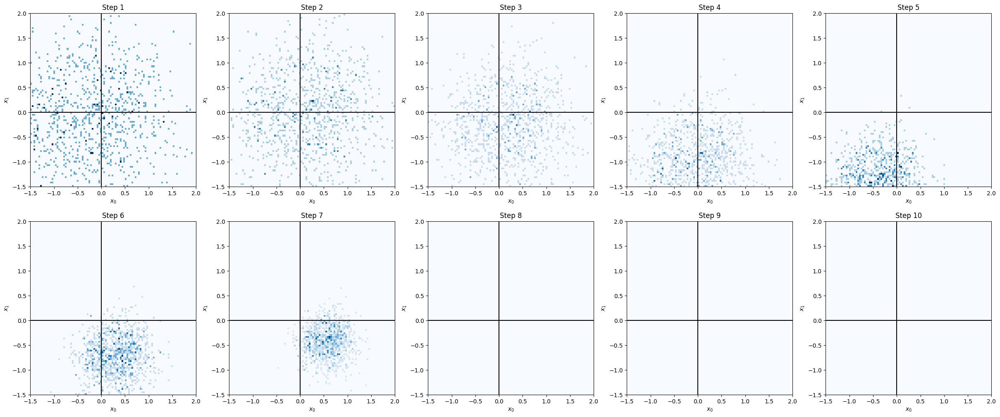

In [ ]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))

for ii in range(10):
    ii_y = ii % 5
    ii_x = ii // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii+1))
    axes[ii_x,ii_y].hist2d(xx_t[(ii+1)*1,:,0], xx_t[ii+1,:,1],bins=100, cmap='Blues',range=np.array([(-1.5, 2.0), (-1.5, 2.0)]))
    axes[ii_x,ii_y].set_xlim([-1.5,2])
    axes[ii_x,ii_y].set_ylim([-1.5,2]) 
    axes[ii_x,ii_y].axhline(0, c="k")
    axes[ii_x,ii_y].axvline(0, c="k")
    axes[ii_x,ii_y].set_xlabel("$x_{0}$")
    axes[ii_x,ii_y].set_ylabel("$x_{1}$")
plt.show()

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/matplotlib/axes/_axes.py:6763: RuntimeWarning: All-NaN slice encountered
  xmin = min(xmin, np.nanmin(xi))
/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/matplotlib/axes/_axes.py:6764: RuntimeWarning: All-NaN slice encountered
  xmax = max(xmax, np.nanmax(xi))


ValueError: autodetected range of [nan, nan] is not finite

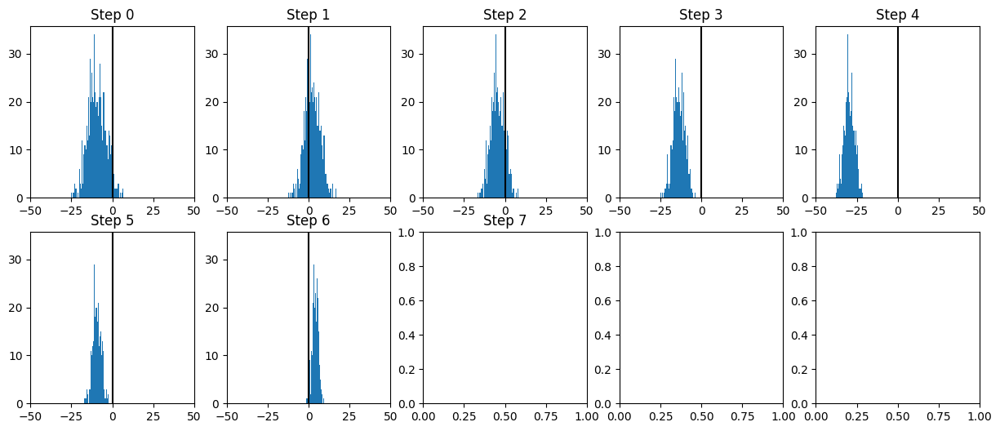

In [ ]:

fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(15, 6))

for ii in range(10):
    ii_y = ii % 5
    ii_x = ii // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii))
    axes[ii_x,ii_y].hist(xx_t[(ii+1)*1,:,:].sum(-1),bins=100)
    axes[ii_x,ii_y].axvline(0, c="k")
    axes[ii_x,ii_y].set_xlim((-50,50))
plt.show()

# CFM by Gaussian probability path

In [13]:
def cfm_loss(model, samples, u_t_label, train=False):
    samples.requires_grad_(True)
    u_t_model = model(samples)
    # Compute the norm loss
    norm_loss = torch.norm(u_t_label - u_t_model, dim = -1) ** 2 / 2.
    return norm_loss.mean(-1)

In [12]:
dataset = xx3.detach().numpy()
def sample_batch(size):
    # idx = torch.randint(0, len(dataset), (size,))
    # return dataset[idx]
    idx = np.random.choice(np.arange(len(dataset)), size=size)
    return dataset[idx]

In [13]:
dataset_prior = xx0.detach().numpy()
def sample_batch_prior(size):
    # idx = torch.randint(0, len(dataset), (size,))
    # return dataset[idx]
    idx = np.random.choice(np.arange(len(dataset_prior)), size=size)
    return dataset_prior[idx]

## Trainning OT model

In [118]:
import torch
import torch.nn as nn
import torch.optim as optim


model_u_t = nn.Sequential(
    nn.Linear(37, 128), nn.Softplus(),
    nn.Linear(128, 128), nn.Softplus(),
    nn.Linear(128, 36)
)



optimizer = optim.Adam(model_u_t.parameters(), lr=3e-3)

sigma_0 = 1
mu_0 = 0
sigma_min = 0.0001


l_curve = []
l_curve_score = []
ising_tilde = Ising(6,2,0.4)
sample_size = 10**3
print('[Time step, loss value]')
for training_step in range(10000):
    sample_x_tilde = sample_batch(sample_size).reshape([-1,36])
    sample_t = 1 - np.random.rand(sample_size).reshape([-1,1])
    sigma_t =  1 - (1-sigma_min) * sample_t 
    # sample_x = np.random.normal(size=(sample_size,36))
    sample_x = sample_batch_prior(size=sample_size).reshape([-1,36])
    sample_x *= sigma_t
    sample_x += sample_t * sample_x_tilde
    samples = np.concatenate([sample_t, sample_x], axis = 1)
    u_t_xx = (sample_x_tilde - (1 - sigma_min)*sample_x) / sigma_t
    u_t_label = torch.tensor(u_t_xx).float()

    loss = cfm_loss(model_u_t, torch.tensor(samples).float(), u_t_label)
    # Before the backward pass, zero all of the network gradients
    optimizer.zero_grad()
    # Backward pass: compute gradient of the loss with respect to parameters
    loss.backward()
    # Calling the step function to update the parameters
    optimizer.step()
    
    if ((training_step % 20) == 0):
        l_curve.append([training_step,loss.item()])
    if ((training_step % 200) == 0):
        print([training_step,loss.item()])

[Time step, loss value]
[0, 194.0878143310547]
[200, 77.36135864257812]
[400, 75.4742660522461]
[600, 73.55197143554688]
[800, 73.29769897460938]
[1000, 70.57963562011719]
[1200, 69.73945617675781]
[1400, 68.3053207397461]
[1600, 65.89979553222656]
[1800, 69.79181671142578]
[2000, 66.23778533935547]
[2200, 67.23304748535156]
[2400, 66.23809051513672]
[2600, 65.82383728027344]
[2800, 66.93923950195312]
[3000, 62.69169998168945]
[3200, 61.50334167480469]
[3400, 63.73610305786133]
[3600, 66.59622955322266]
[3800, 64.02175903320312]
[4000, 65.15782165527344]
[4200, 62.52488327026367]
[4400, 67.06570434570312]
[4600, 59.80403137207031]
[4800, 64.2645492553711]
[5000, 64.39279174804688]
[5200, 63.12382507324219]
[5400, 62.20055389404297]
[5600, 63.690216064453125]
[5800, 62.753074645996094]
[6000, 62.034019470214844]
[6200, 63.40601348876953]
[6400, 66.18702697753906]
[6600, 66.09662628173828]
[6800, 61.2072639465332]
[7000, 64.04631805419922]
[7200, 63.155059814453125]
[7400, 62.81400680541

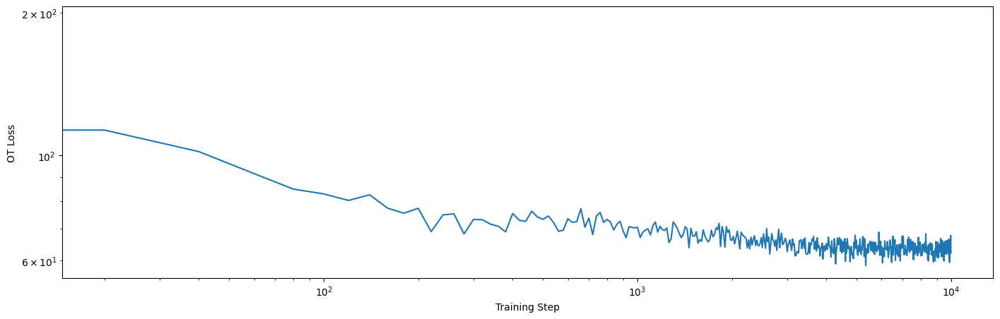

In [119]:
l_curve_fm = np.array(l_curve)
plt.loglog(l_curve_fm[:,0],l_curve_fm[:,1])
plt.xlabel('Training Step')
plt.ylabel('OT Loss')
plt.show()

## Trainning score model by $\nabla lnp$

In [32]:
from torch.autograd.functional import jacobian
def batch_jacobian(func, x):
  # x in shape (Batch, Length)
  def _func_sum(x):
    return func(x).sum(dim=0)
  return jacobian(_func_sum, x)

In [35]:


model_s_t = nn.Sequential(
    nn.Linear(37, 128), nn.Softplus(),
    nn.Linear(128, 128), nn.Softplus(),
    nn.Linear(128, 36)
)

optimizer_s = optim.Adam(model_s_t.parameters(), lr=3e-3)

sigma_0 = 1
mu_0 = 0
sigma_min = 0.0001


l_curve_score = []
ising_tilde = Ising(6,2,0.4)
sample_size = 10**3
print('[Time step, loss value]')
for training_step in range(10000):
    sample_x_tilde = sample_batch(sample_size).reshape([-1,36])
    sample_t = 1 - np.random.rand(sample_size).reshape([-1,1])
    sigma_t =  1 - (1-sigma_min) * sample_t 
    # sample_x = np.random.normal(size=(sample_size,36))
    sample_x = sample_batch_prior(size=sample_size).reshape([-1,36])
    sample_x *= sigma_t
    sample_x += sample_t * sample_x_tilde
    samples = np.concatenate([sample_t, sample_x], axis = 1)
    # score_label = jacobian(ising_tilde.energy, torch.from_numpy(sample_x))
    # score_label = torch.stack([jacobian(ising_tilde.energy, torch.from_numpy(x).reshape(1,36)).ravel() for x in sample_x], axis=0)
    score_label = batch_jacobian(ising_tilde.energy, torch.from_numpy(sample_x))
    # plt.figure(figsize=(23,5))
    # plt.subplot(141)
    # plt.hist(sample_x.sum(-1), bins=100)
    # plt.subplot(142)
    # plt.hist2d(sample_x[:,0], sample_x[:,1], cmap="Blues", bins=100, range=[[-5,5], [-5,5]])
    # plt.subplot(143)
    # plt.hist(score_label.sum(-1), bins=100)
    # plt.subplot(144)
    # plt.hist2d(score_label[:,0], score_label[:,1], cmap="Blues", bins=100, range=[[-5,5], [-5,5]])
    # plt.show()

    # loss = cfm_loss(model_u_t, torch.tensor(samples).float(), u_t_label)
    score_loss = cfm_loss(model_s_t, torch.tensor(samples).float(), score_label)
    # Before the backward pass, zero all of the network gradients
    optimizer_s.zero_grad()
    # Backward pass: compute gradient of the loss with respect to parameters
    score_loss.backward()
    # Calling the step function to update the parameters
    optimizer_s.step()
    
    if ((training_step % 20) == 0):
        l_curve_score.append([training_step,score_loss.item()])
    if ((training_step % 200) == 0):
        print([training_step, score_loss.item()])

[Time step, loss value]
[0, 11.575148582458496]
[200, 1.5401755571365356]
[400, 1.3245893716812134]
[600, 1.1412018537521362]
[800, 1.0780655145645142]
[1000, 0.9713603258132935]
[1200, 0.8961968421936035]
[1400, 0.8736280798912048]
[1600, 0.797215461730957]
[1800, 0.8060128688812256]
[2000, 0.8332050442695618]
[2200, 0.7090574502944946]
[2400, 0.6852381825447083]
[2600, 0.6312187314033508]
[2800, 0.6132118701934814]
[3000, 0.5747621655464172]
[3200, 0.5574451088905334]
[3400, 0.5093859434127808]
[3600, 0.5088063478469849]
[3800, 0.46933820843696594]
[4000, 0.4453522264957428]
[4200, 0.4288051724433899]
[4400, 0.410024493932724]
[4600, 0.3910832405090332]
[4800, 0.33924686908721924]
[5000, 0.3664292097091675]
[5200, 0.28730151057243347]
[5400, 0.32938334345817566]
[5600, 0.2626804709434509]
[5800, 0.25385910272598267]
[6000, 0.2526218295097351]
[6200, 0.207828089594841]
[6400, 0.17732788622379303]
[6600, 0.17571516335010529]
[6800, 0.14545907080173492]
[7000, 0.13535559177398682]
[7200

In [38]:
print('[Time step, loss value]')
l_curve_score = list(l_curve_score)
for training_step in range(10000, 15000):
    sample_x_tilde = sample_batch(sample_size).reshape([-1,36])
    sample_t = 1 - np.random.rand(sample_size).reshape([-1,1])
    sigma_t =  1 - (1-sigma_min) * sample_t 
    # sample_x = np.random.normal(size=(sample_size,36))
    sample_x = sample_batch_prior(size=sample_size).reshape([-1,36])
    sample_x *= sigma_t
    sample_x += sample_t * sample_x_tilde
    samples = np.concatenate([sample_t, sample_x], axis = 1)
    # score_label = jacobian(ising_tilde.energy, torch.from_numpy(sample_x))
    # score_label = torch.stack([jacobian(ising_tilde.energy, torch.from_numpy(x).reshape(1,36)).ravel() for x in sample_x], axis=0)
    score_label = batch_jacobian(ising_tilde.energy, torch.from_numpy(sample_x))
    # plt.figure(figsize=(23,5))
    # plt.subplot(141)
    # plt.hist(sample_x.sum(-1), bins=100)
    # plt.subplot(142)
    # plt.hist2d(sample_x[:,0], sample_x[:,1], cmap="Blues", bins=100, range=[[-5,5], [-5,5]])
    # plt.subplot(143)
    # plt.hist(score_label.sum(-1), bins=100)
    # plt.subplot(144)
    # plt.hist2d(score_label[:,0], score_label[:,1], cmap="Blues", bins=100, range=[[-5,5], [-5,5]])
    # plt.show()

    # loss = cfm_loss(model_u_t, torch.tensor(samples).float(), u_t_label)
    score_loss = cfm_loss(model_s_t, torch.tensor(samples).float(), score_label)
    # Before the backward pass, zero all of the network gradients
    optimizer_s.zero_grad()
    # Backward pass: compute gradient of the loss with respect to parameters
    score_loss.backward()
    # Calling the step function to update the parameters
    optimizer_s.step()
    
    if ((training_step % 20) == 0):
        l_curve_score.append([training_step,score_loss.item()])
    if ((training_step % 200) == 0):
        print([training_step, score_loss.item()])

[Time step, loss value]
[10000, 0.0659019872546196]
[10200, 0.09053083509206772]
[10400, 0.04566692188382149]
[10600, 0.04403812810778618]
[10800, 0.12081831693649292]
[11000, 0.034545354545116425]
[11200, 0.06902024894952774]
[11400, 0.06072520837187767]
[11600, 0.035977549850940704]
[11800, 0.10682042688131332]
[12000, 0.03048364259302616]
[12200, 0.05398136004805565]
[12400, 0.04211374744772911]
[12600, 0.07049286365509033]
[12800, 0.036643922328948975]
[13000, 0.04107579216361046]
[13200, 0.02954147197306156]
[13400, 0.02166661061346531]
[13600, 0.06131308898329735]
[13800, 0.030691450461745262]
[14000, 0.044011738151311874]
[14200, 0.048120368272066116]
[14400, 0.02525760605931282]
[14600, 0.027530411258339882]
[14800, 0.0328558087348938]


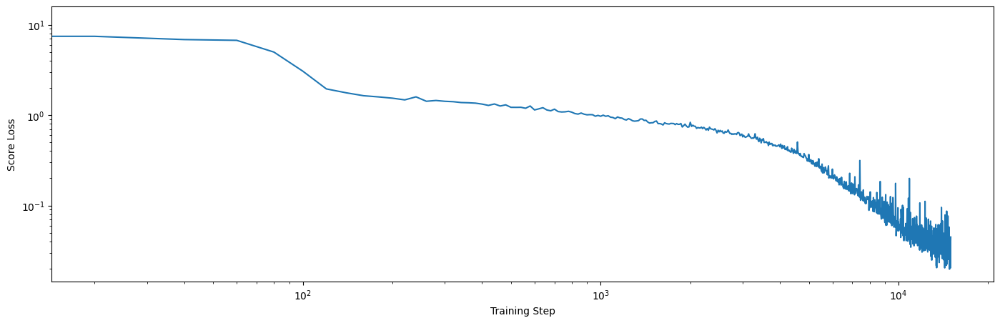

In [39]:
l_curve_score = np.array(l_curve_score)
plt.loglog(l_curve_score[:,0],l_curve_score[:,1])
plt.xlabel('Training Step')
plt.ylabel('Score Loss')
plt.show()

## Make a dataset of Boltzmann path with score: $s=\nabla lnp$

In [14]:
sigma_min=0.0001
def sample_path(size, samplesize_per_beta=100):
    t = 1.-np.linspace(0,1,size//samplesize_per_beta)**2
    print("idx_t, t, beta")
    for idx_t in range(len(t)):
        sigma_t =  1 - (1-sigma_min) * t[idx_t]
        sample_x_tilde = sample_batch(size=samplesize_per_beta).reshape([-1,36])
        sample_x_ot_t = sample_batch_prior(size=samplesize_per_beta).reshape([-1,36])
        sample_x_ot_t *= sigma_t
        sample_x_ot_t += t[idx_t] * sample_x_tilde
        if idx_t == 0:
            sample_x_ot = sample_x_ot_t
        else:
            sample_x_ot = np.concatenate([sample_x_ot, sample_x_ot_t], axis=0)
        beta = 1./(10.-7.5/(1-sigma_min)*t[idx_t])
        ising_t = Ising(6,2,beta)
        if idx_t == 0:
            sample_x_t = ising_t.sample(samplesize_per_beta, thermalSteps=1000).reshape([-1,36]).detach().numpy()
            # score_label_t = batch_jacobian(ising_t.energy, torch.from_numpy(sample_x_t))
            sample_x = sample_x_t
            sample_t = np.ones([samplesize_per_beta,1])*t[idx_t]
            # score_label = score_label_t
        else:
            sample_x_t = ising_t.sample(samplesize_per_beta, thermalSteps=100, initial=torch.from_numpy(sample_x_t)).reshape([-1,36]).detach().numpy()
            # score_label_t = batch_jacobian(ising_t.energy, torch.from_numpy(sample_x_t))
            sample_x = np.concatenate([sample_x, sample_x_t], axis=0)
            sample_t = np.concatenate([sample_t, np.ones([samplesize_per_beta,1])*t[idx_t]], axis=0)
            # score_label = torch.cat([score_label, score_label_t])

        print(idx_t, t[idx_t], beta)
    return sample_t, sample_x, sample_x_ot

In [15]:
dataset_t, dataset_path, dataset_ot = sample_path(100000)
print(dataset_t.shape, dataset_path.shape, dataset_ot.shape)

idx_t, t, beta
0 1.0 0.4001200480192077
1 0.999998997996996 0.4001188447770576
2 0.999995991987984 0.4001152350940274
3 0.999990981972964 0.40010921910037445
4 0.9999839679519359 0.4001007970131807
5 0.9999749499248999 0.40008996913633343
6 0.9999639278918558 0.40007673586049847
7 0.9999509018528038 0.40006109766308356
8 0.9999358718077437 0.40004305510819693
9 0.9999188377566756 0.40002260884659513
10 0.9998997996995995 0.3999997596156255
11 0.9998787576365153 0.3999745082391581
12 0.9998557115674233 0.3999468556275135
13 0.9998306614923231 0.3999168027773793
14 0.999803607411215 0.39988435077172063
15 0.9997745493240989 0.39984950077968345
16 0.9997434872309747 0.3998122540564878
17 0.9997104211318426 0.39977261194331665
18 0.9996753510267024 0.399730575867194
19 0.9996382769155542 0.3996861473408571
20 0.999599198798398 0.39963932796262047
21 0.9995581166752338 0.39959011941623235
22 0.9995150305460616 0.39953852347072344
23 0.9994699404108813 0.39948454198024813
24 0.99942284626969

In [16]:

def sample_batch_path(size):
    # idx = torch.randint(0, len(dataset), (size,))
    # return dataset[idx]
    idx = np.random.choice(np.arange(len(dataset_path)), size=size)
    return dataset_t[idx], dataset_path[idx], dataset_ot[idx]

# Training geodesic model by distances between data and OT path

In [38]:
def g_land(x, x_dataset, sigma=0.5, epsilon=0.01):
    assert len(x.shape) == 2, len(x_dataset.shape) == 2
    batchsize = x.shape[0]
    dim = x.shape[1]
    h_x = torch.zeros(x.shape)
    for i in range(len(x_dataset)):
        h_x += (x-x_dataset[i])**2*torch.exp(-((x-x_dataset[i])**2).sum(-1)[:,None]/2/(sigma**2))
    g_x = torch.inverse(h_x[:, :, None] * torch.eye(dim) + epsilon * torch.eye(dim).repeat(batchsize, 1, 1))
    return g_x

## Geodesic metric by RBF

In [45]:
from sklearn.cluster import KMeans
import torch.nn as nn
import torch.optim as optim
class RBFN(nn.Module):

    def __init__(self, hidden_shape, n_features = 36, kappa=0.5):
        """ radial basis function network
        # Arguments
            input_shape: dimension of the input data
            e.g. scalar functions have should have input_dimension = 1
            hidden_shape: the number
            hidden_shape: number of hidden radial basis functions,
            also, number of centers.
        """
        super(RBFN, self).__init__()
        self.hidden_shape = hidden_shape
        self.centers = None
        # self.weights = nn.Parameter(torch.ones([hidden_shape, n_features]))
        self.model_weights = nn.Sequential(
            nn.Linear(1, 64), nn.Softplus(),
            nn.Linear(64, 64), nn.Softplus(),
            nn.Linear(64, hidden_shape*n_features)
        )
        self.n_features = n_features
        self.kappa = torch.ones(n_features)*kappa
        self.optimizer = optim.Adam(self.parameters(), lr=3e-3)
        self.epoch = 0

    def _kernel_function(self, center, data_point, center_lambda):
        return torch.exp(-center_lambda/2.*torch.norm(center-data_point)**2)

    def _calculate_interpolation_matrix(self, X):
        """ Calculates interpolation matrix using a kernel_function
        # Arguments
            X: Training data
        # Input shape
            (num_data_samples, input_shape)
        # Returns
            G: Interpolation matrix
        """
        G = torch.zeros((len(X), self.hidden_shape, self.n_features))
        for data_point_arg, data_point in enumerate(X):
            for center_arg, center in enumerate(self.centers):
                G[data_point_arg, center_arg] = self._kernel_function(
                        center, data_point, self.cluster_lambda[center_arg])
        return G


    def _select_centers(self, X):
        # random_args = np.random.choice(len(X), self.hidden_shape)
        # centers = X[random_args]
        kmeans = KMeans(n_clusters=self.hidden_shape, random_state=0, n_init="auto").fit(X)
        assert X.shape[1] == kmeans.cluster_centers_.shape[1]
        # plt.figure(figsize=(11,5))
        # plt.subplot(121)
        # plt.hist2d(X[:,0], X[:,1], cmap="Blues", range=[[-5,5],[-5,5]], bins=100)
        # plt.subplot(122)
        # plt.hist2d(kmeans.cluster_centers_[:,0], kmeans.cluster_centers_[:,1], cmap="Blues", range=[[-5,5],[-5,5]], bins=100)
        self.cluster_lambda = torch.zeros([self.hidden_shape, self.n_features])
        for ii in range(self.hidden_shape):
            idx_X = torch.from_numpy(np.where(kmeans.labels_==ii)[0])
            self.cluster_lambda[ii] = 0.5* 1./((((torch.from_numpy(X)[idx_X]-torch.from_numpy(kmeans.cluster_centers_)[ii])**2).sum(-1).sum(0)/len(idx_X)*self.kappa)**2 )
        return torch.from_numpy(kmeans.cluster_centers_)

    def fit(self, X, Y, t, lr=3e-3):
        # scheduler = torch.optim.lr_scheduler.StepLR(self.optimizer, step_size=10, gamma=0.35)
        for param_group in self.optimizer.param_groups:
            param_group['lr'] = lr 
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(self.optimizer, mode='min', factor=0.5, patience=3, verbose=True)
        print(">>> Optimizing $\omega$ parameters of RBF")
        print("    step loss          LR")
        for training_step in range(50):
            loss = self.forward(X,Y,t)
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
            scheduler.step(loss)
            if training_step % 10 == 0:
                print("    %d %f %f"%(training_step+self.epoch, loss.item(), scheduler.get_last_lr()[0]))
            if scheduler.get_last_lr()[0] < 1e-4:
                break
        self.epoch += training_step
        self.save_model(loss.item())
        

    def forward(self, X, Y, t):
        """ Fits weights using linear regression
        # Arguments
            X: training samples
            Y: targets
        # Input shape
            X: (num_data_samples, input_shape)
            Y: (num_data_samples, input_shape)
        """
        self.centers = self._select_centers(X)
        G = self._calculate_interpolation_matrix(torch.from_numpy(Y))
        # predictions = (G*self.weights[None, :, :]).sum(1)
        predictions = (G*self.model_weights(t).reshape(-1,self.hidden_shape,self.n_features)).sum(1)
        loss = ((1.-predictions)**2).sum(0)
        assert len(loss.shape) == 1 and loss.shape[0]==self.n_features
        return loss.sum()

    def predict(self, X, t):
        """
        # Arguments
            X: test data
        # Input shape
            (num_test_samples, input_shape)
        """
        G = self._calculate_interpolation_matrix(X)
        # predictions = (G*self.weights[None, :, :]).sum(1)
        predictions = (G*self.model_weights(t).reshape(-1,self.hidden_shape,self.n_features)).sum(1)
        return predictions

    def save_model(self, loss):
        torch.save(self.state_dict(), f'checkpoint_omegas-epoch{self.epoch}.pth')
        torch.save(self.optimizer.state_dict(), f"checkpoint_omegas_optimizer-epoch{self.epoch}.pth")
        torch.save({"epoch": self.epoch, "loss": loss}, f"checkpoint_omegas_loss-epoch{self.epoch}.pth")
        torch.save(self.state_dict(), 'checkpoint_omegas.pth')
        torch.save(self.optimizer.state_dict(), "checkpoint_omegas_optimizer.pth")
        torch.save({"epoch": self.epoch, "loss": loss}, "checkpoint_omegas_loss.pth")
    
    def load_model(self, ckpt_model_path, ckpt_optimizer_path, ckpt_loss_path):
        # Restore the model and optimizer state dictionaries
        self.load_state_dict(torch.load(ckpt_model_path))
        self.optimizer.load_state_dict(torch.load(ckpt_optimizer_path))
        # Restore other variables
        loss_dict = torch.load(ckpt_loss_path)
        self.epoch = loss_dict["epoch"]
        loss = loss_dict["loss"]
        return self.epoch, loss

In [48]:
rbfn = RBFN(100, 36)
# epoch, loss = rbfn.load_model(f'checkpoint_omegas.pth', 'checkpoint_omegas_optimizer.pth', 'checkpoint_omegas_loss.pth')
# print("epoch: %d  loss: %f"%(epoch, loss))

In [49]:

def g_land_rbf(x, x_dataset, t, epsilon=0.0001, plot_h = False):
    assert len(x.shape) == 2, len(x_dataset.shape) == 2
    batchsize = x.shape[0]
    dim = x.shape[1]
    rbfn.fit(x_dataset.detach().numpy(), x.detach().numpy(), t)
    h_x = rbfn.predict(x.detach().numpy(), t)
    if plot_h:
        plt.figure(figsize=(17,5))
        plt.subplot(131)
        plt.hist(x.detach().numpy().sum(-1), bins=100, density=True)
        # plt.hist2d(x.detach().numpy()[:,0], x.detach().numpy()[:,1], bins=100, cmap="Blues", range=[[-5,5],[-5,5]])
        plt.title("x")
        plt.subplot(132)
        # plt.hist2d(x_dataset.detach().numpy()[:,0], x.detach().numpy()[:,1], bins=100, cmap="Blues", range=[[-5,5],[-5,5]])
        plt.hist(x_dataset.sum(-1), bins=100, density=True)
        plt.title("path data")
        plt.subplot(133)
        plt.hist(h_x.detach().numpy().sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True)
        # plt.hist2d(h_x[:,0], h_x[:,1], bins=100, cmap="Blues", range=[[-1,1],[-1,1]])
        plt.title("h(x)")
    g_x = torch.inverse(h_x[:, :, None] * torch.eye(dim) + epsilon * torch.eye(dim).repeat(batchsize, 1, 1)).to(torch.float32)
    return g_x

In [51]:
import torch
import torch.nn as nn
import torch.optim as optim

'''
model_u_t = nn.Sequential(
    nn.Linear(37, 128), nn.Softplus(),
    nn.Linear(128, 128), nn.Softplus(),
    nn.Linear(128, 36)
)



optimizer = optim.Adam(model_u_t.parameters(), lr=3e-3)
'''
model_s_t = nn.Sequential(
    nn.Linear(37, 128), nn.Softplus(),
    nn.Linear(128, 128), nn.Softplus(),
    nn.Linear(128, 36)
)

optimizer_s = optim.Adam(model_s_t.parameters(), lr=3e-3)

In [25]:
model_s_t.load_state_dict(torch.load("checkpoint_geointerpolant.pth"))
optimizer_s.load_state_dict(torch.load("checkpoint_geointerpolant_optimizer.pth"))
start_epoch = 0

[Time step, score_loss, otflow_loss]
>>> Optimizing $\omega$ parameters of RBF
    step loss          LR


/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


    577 9400.799805 0.003000
    587 1506.635620 0.001500
    597 513.708801 0.001500
    607 314.922668 0.001500
    617 159.071136 0.000750
[0, 422167648.0]


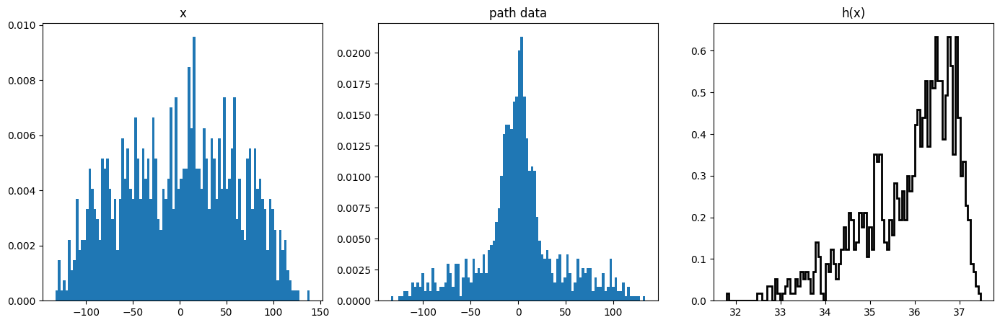

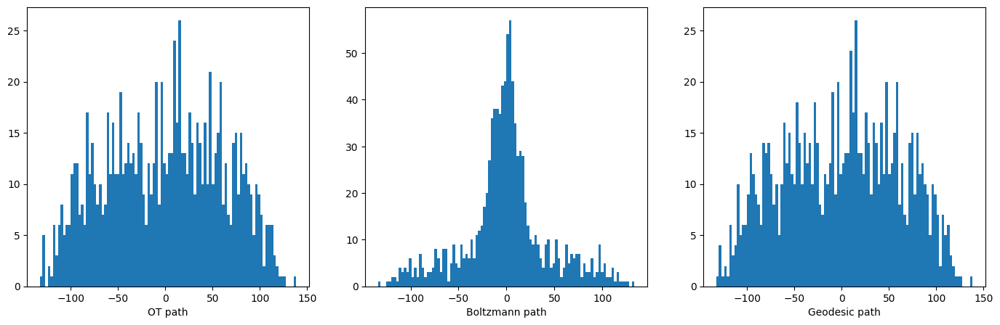

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    626 27211.447266 0.003000
    636 1422.144287 0.001500
    646 656.169495 0.000375
    656 307.721191 0.000188
[1, 189426256.0]


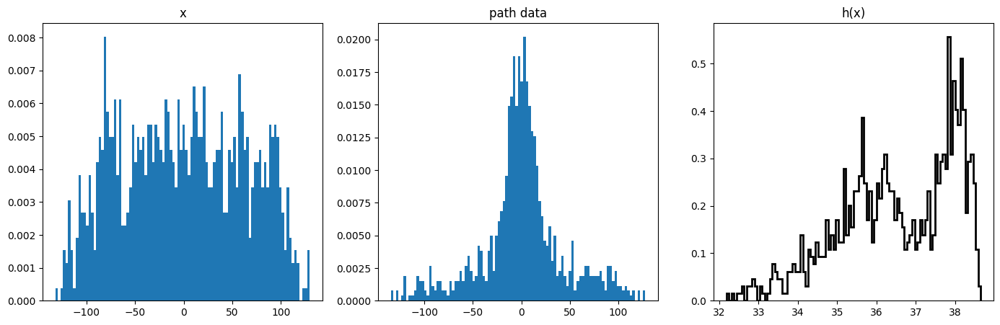

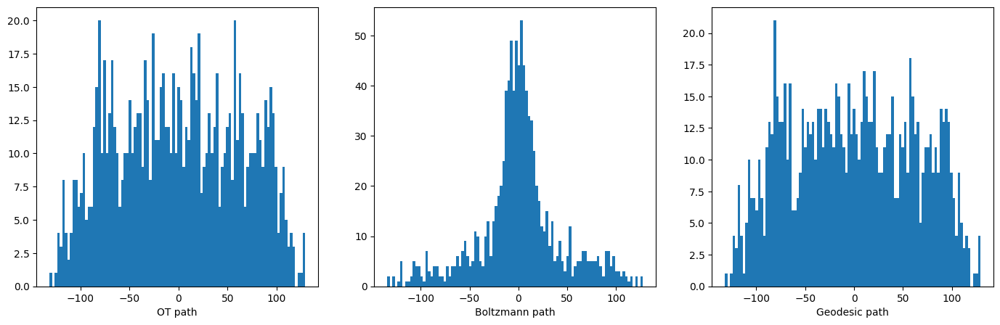

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    660 5246.595703 0.003000
    670 461.937439 0.001500
    680 248.163391 0.000750
    690 244.284332 0.000188
    700 168.974228 0.000188
[2, 219181424.0]


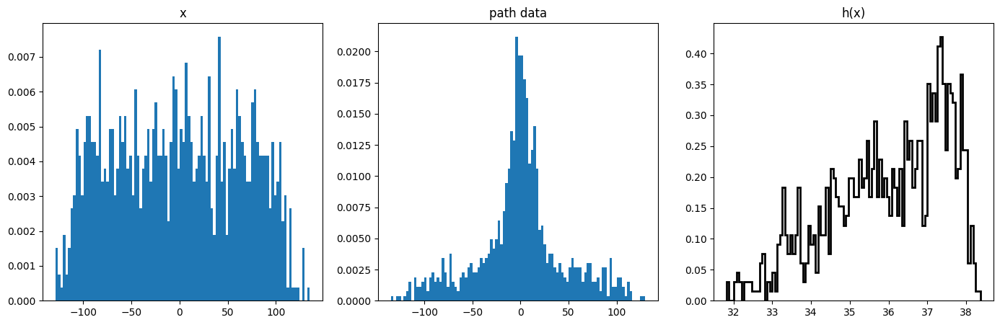

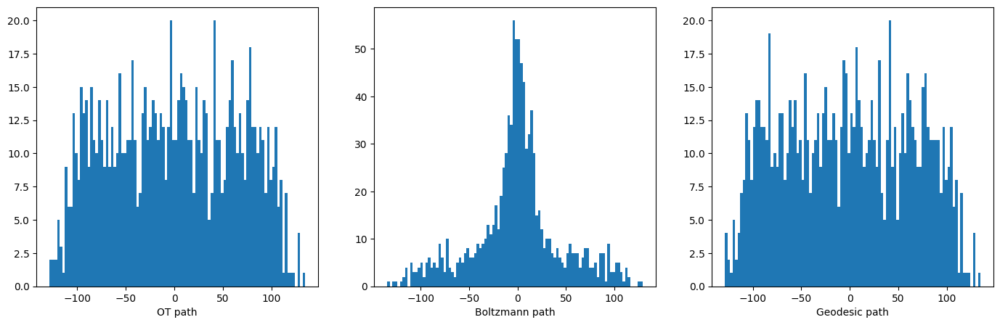

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    709 4872.083496 0.003000
    719 255.014847 0.001500
    729 196.100433 0.000375
    739 161.921249 0.000188
[3, 306300896.0]


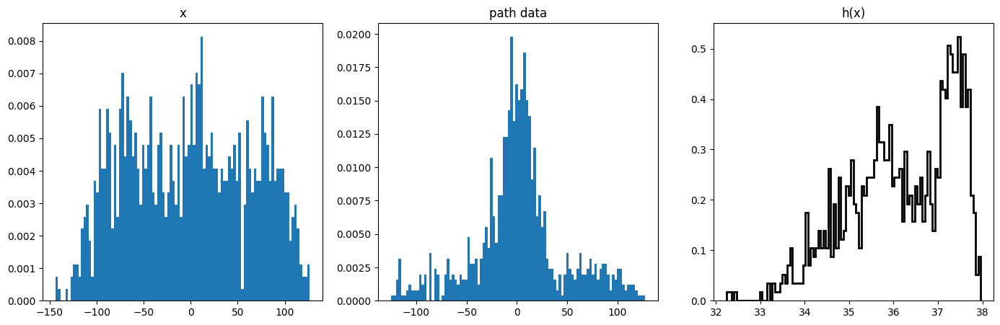

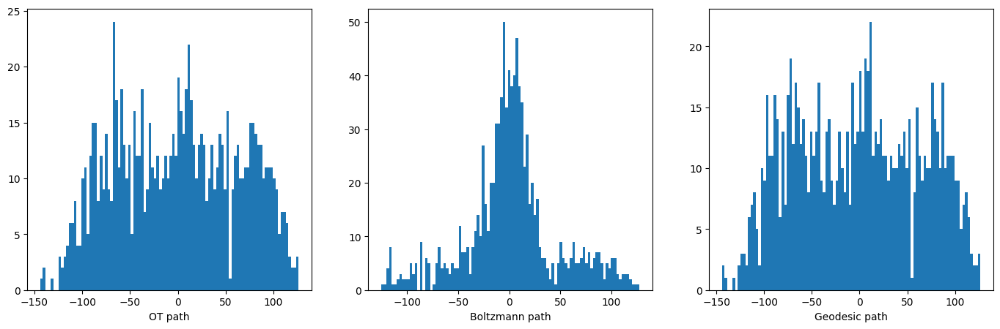

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    741 6886.455078 0.003000
    751 608.057983 0.001500
    761 302.804626 0.000375
    771 221.602280 0.000188
    781 178.094345 0.000188
[4, 336713568.0]


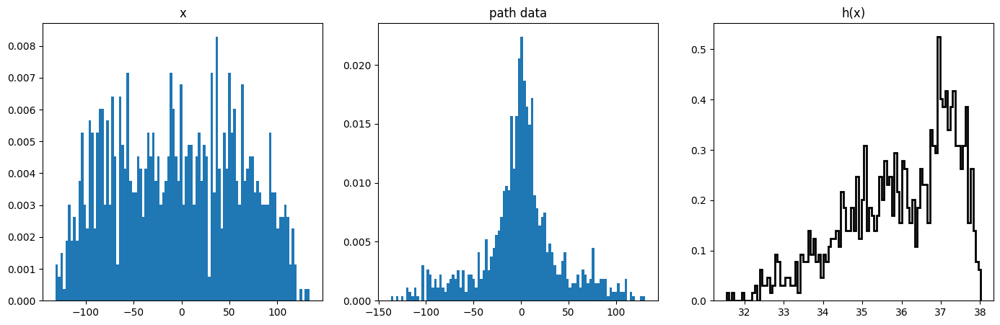

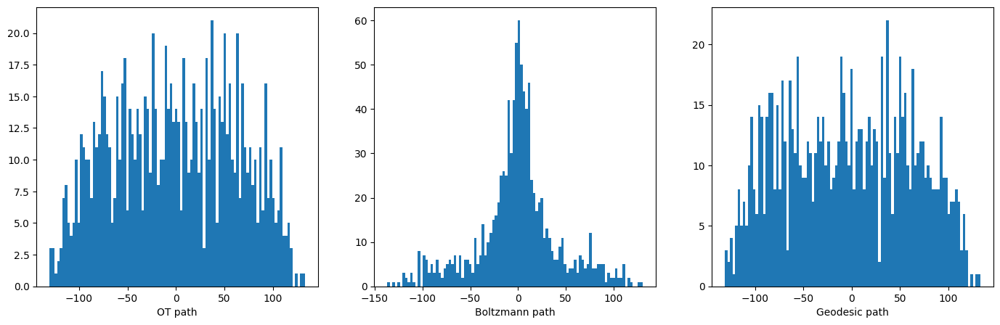

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    790 6515.496094 0.003000
    800 312.900970 0.001500
    810 226.266724 0.000375
    820 176.351410 0.000188
[5, 405297792.0]


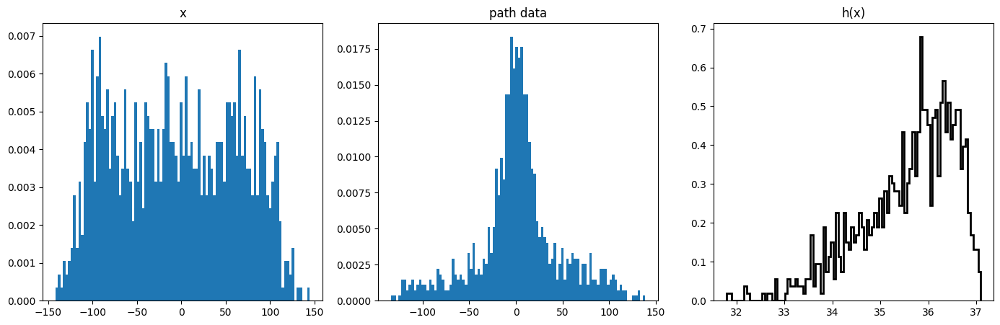

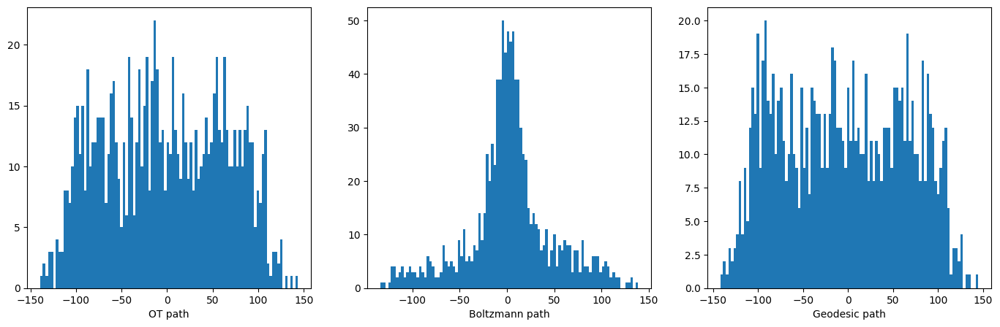

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    822 5762.302734 0.003000
    832 254.978394 0.001500
    842 277.232422 0.000375
    852 158.864578 0.000188
[6, 194316128.0]


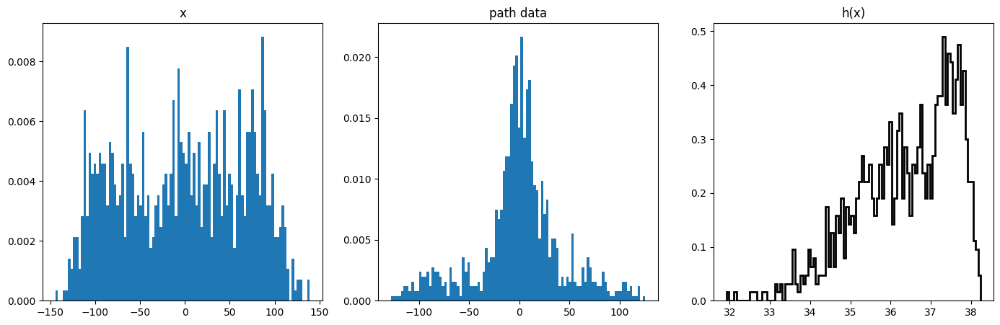

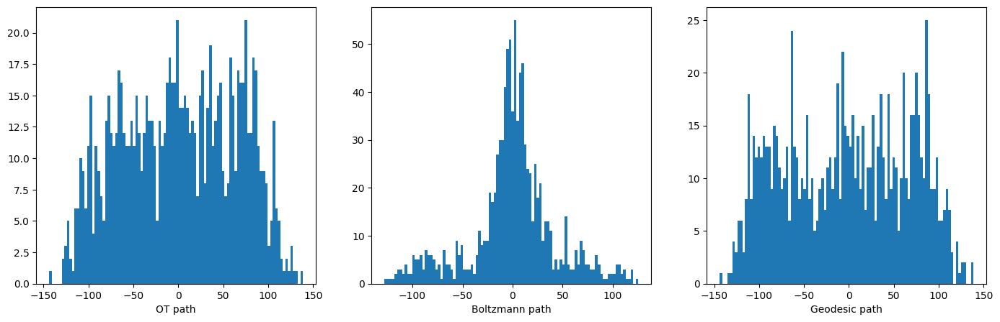

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    856 9174.859375 0.003000
    866 420.509735 0.001500
    876 496.118713 0.000188
[7, 163315344.0]


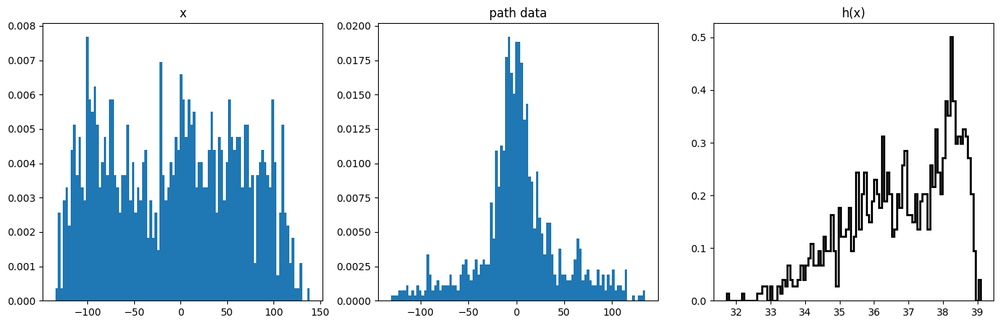

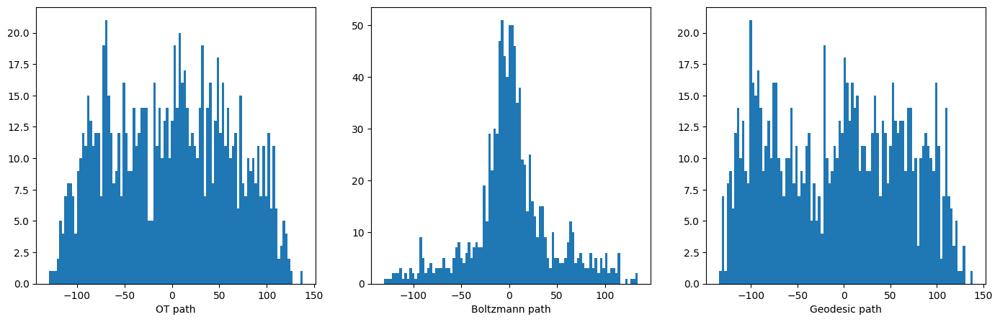

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    879 2574.230225 0.003000
    889 795.254395 0.003000
    899 364.517181 0.003000
    909 201.527084 0.003000
    919 108.171890 0.003000
[8, 292760960.0]


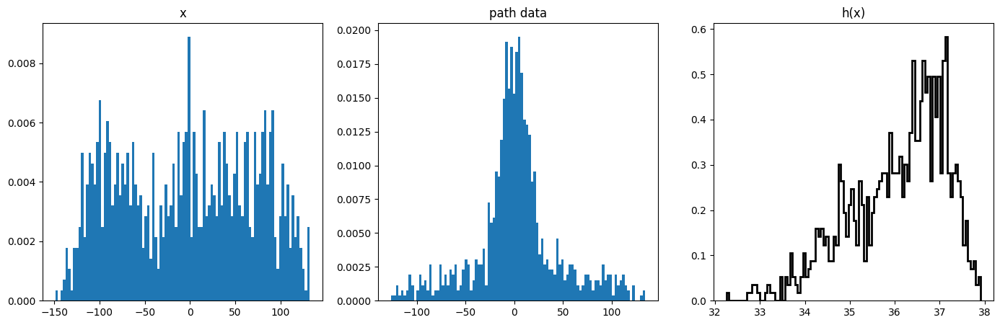

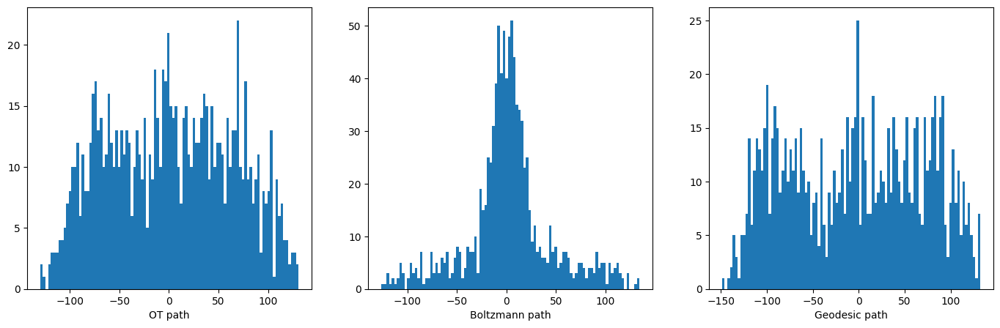

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    928 4301.264160 0.003000
    938 345.628845 0.001500
    948 369.534851 0.000188
[9, 297159040.0]


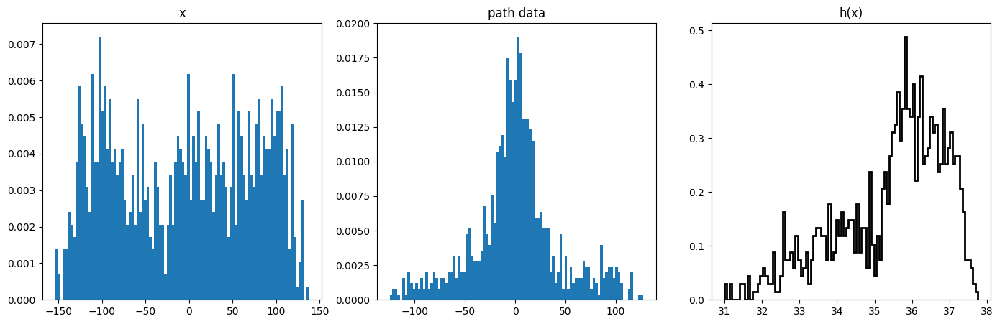

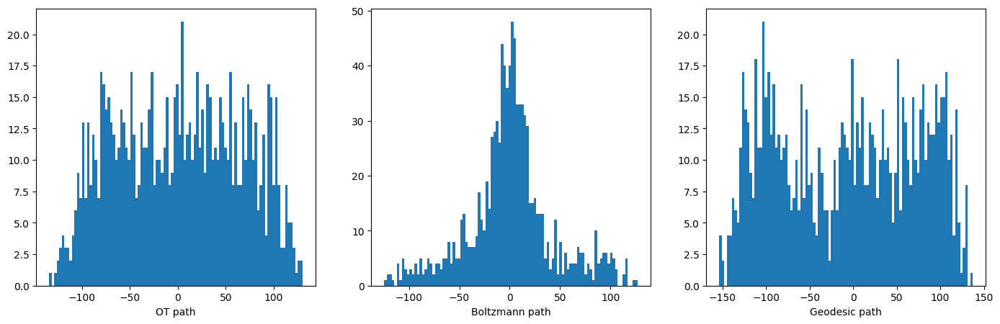

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    951 4475.750488 0.003000
    961 495.241882 0.001500
    971 339.155731 0.000375
    981 176.764587 0.000375
[10, 274586752.0]


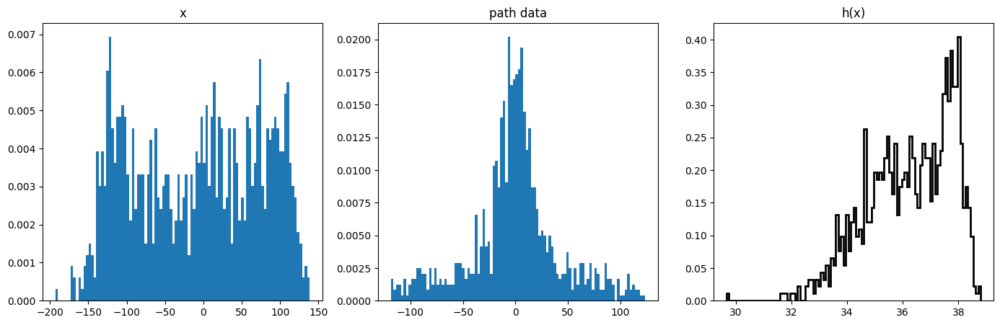

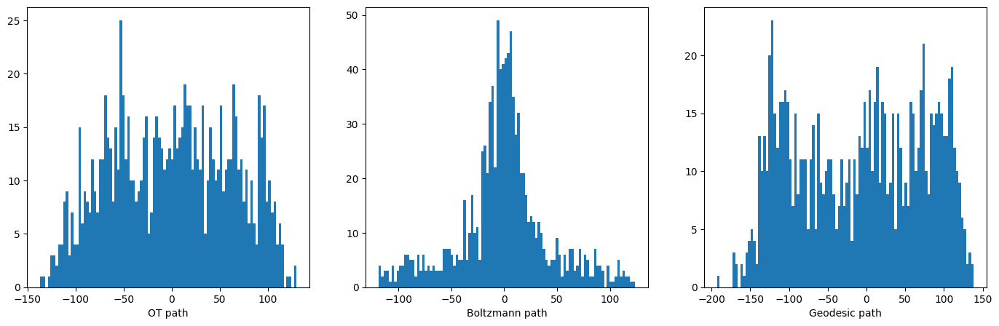

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    987 4458.364258 0.003000
    997 625.668518 0.001500
    1007 536.757812 0.000375
    1017 307.376923 0.000375
[11, 398151264.0]


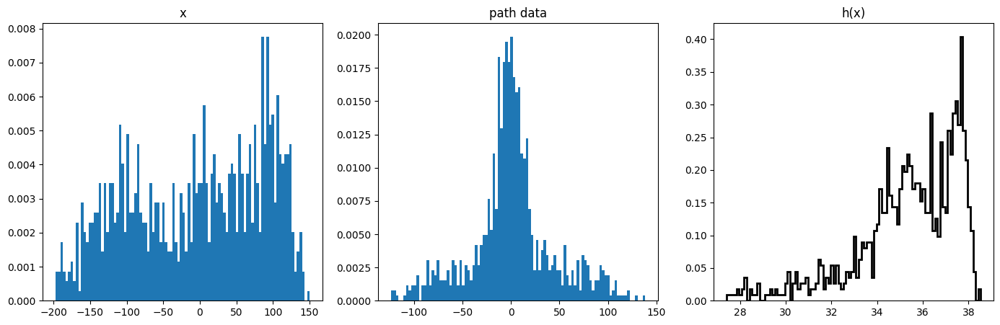

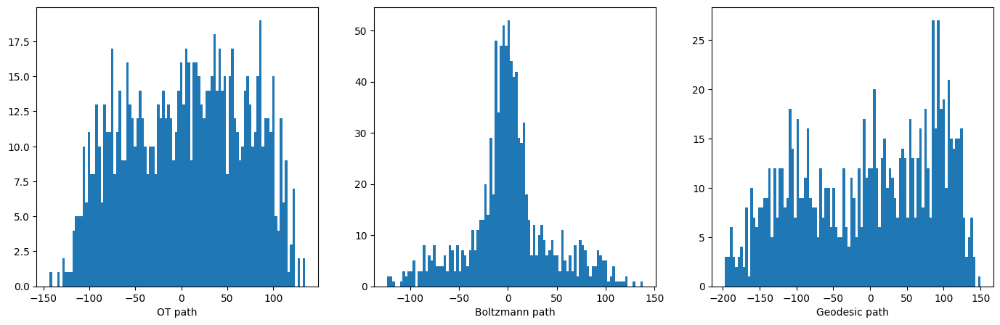

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1024 4835.336914 0.003000
    1034 528.051880 0.001500
    1044 448.399170 0.000188
    1054 290.069855 0.000188
    1064 266.587372 0.000188
[12, 131255152.0]


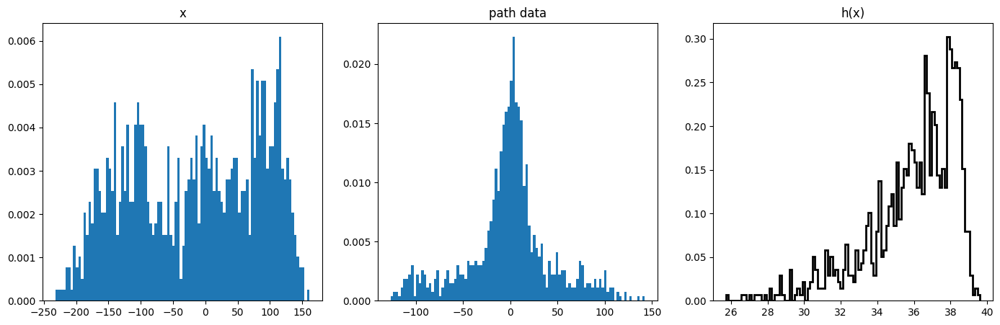

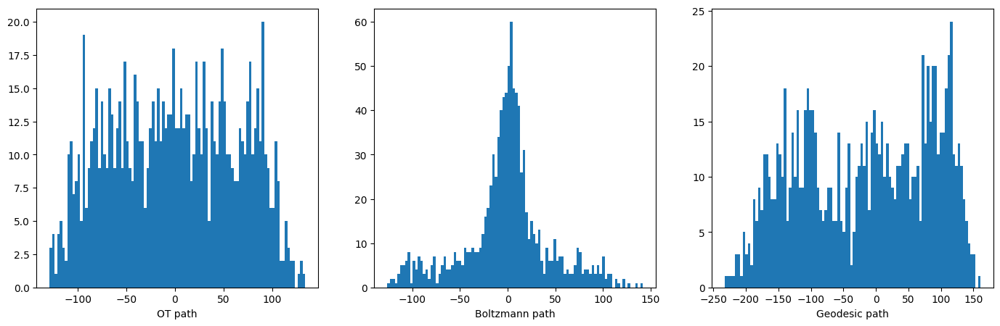

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1066 3792.941895 0.003000
    1076 821.728882 0.001500
    1086 660.918945 0.000375
    1096 419.984161 0.000375
[13, 270136096.0]


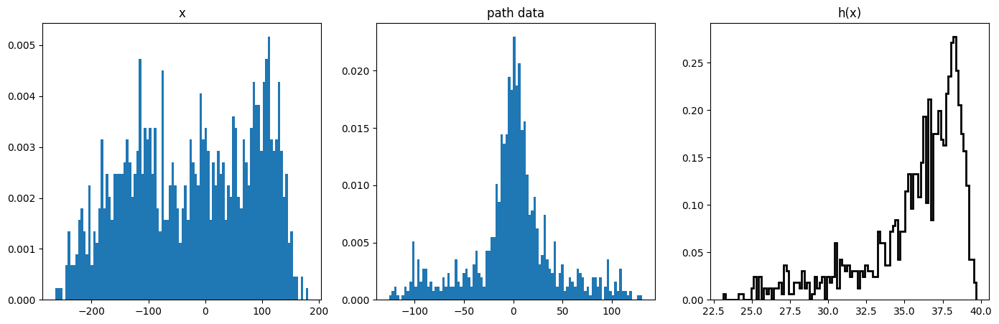

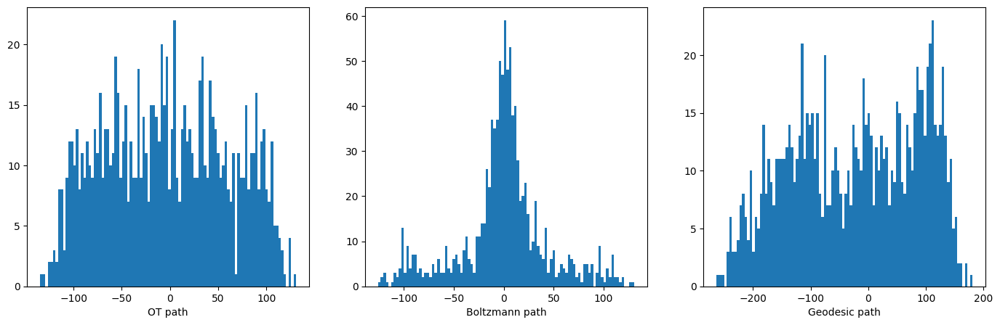

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1105 4674.551758 0.003000
    1115 832.237671 0.001500
    1125 664.581970 0.000188
    1135 513.328003 0.000188
    1145 475.112183 0.000188
[14, 273927712.0]


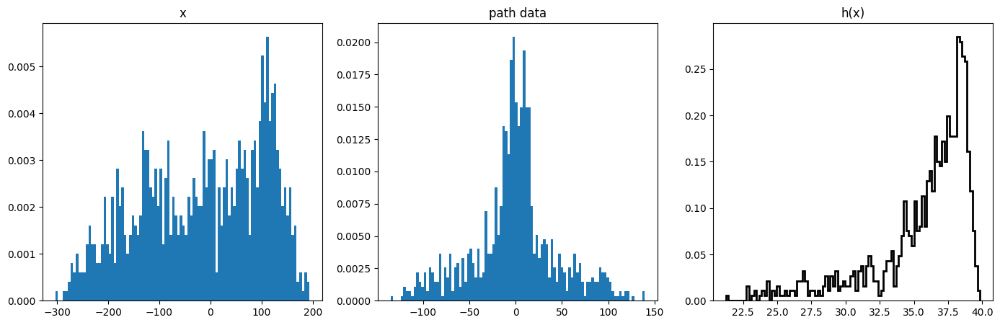

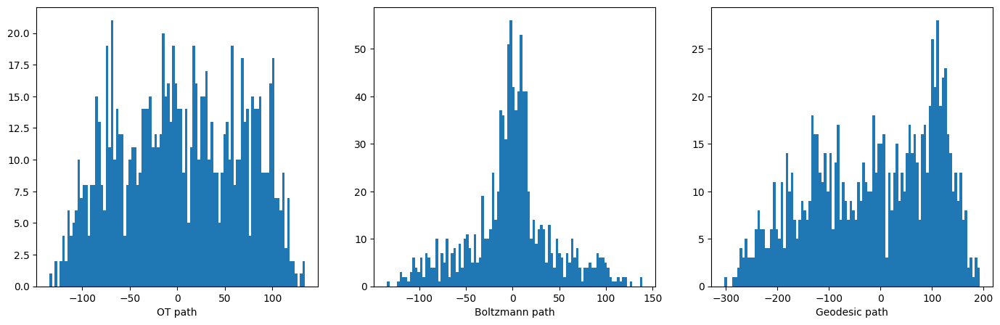

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1154 4267.863281 0.003000
    1164 1444.453369 0.001500
    1174 1030.025635 0.000375
[15, 136226992.0]


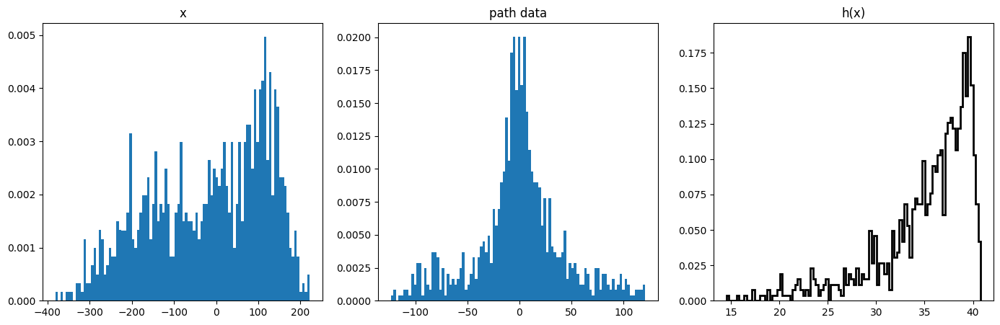

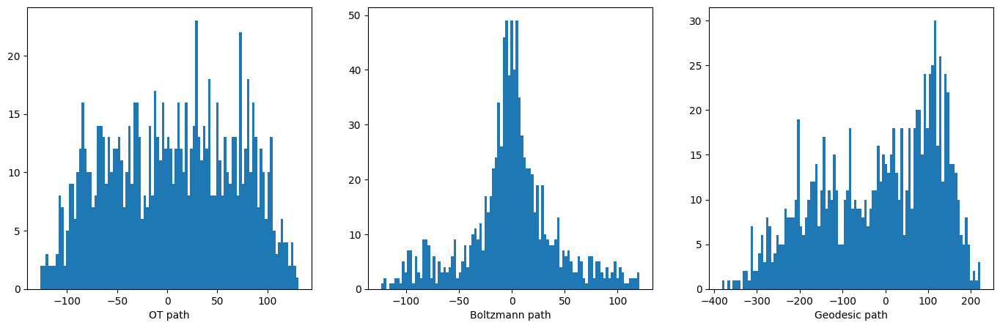

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1180 4344.091797 0.003000
    1190 1849.074097 0.001500
    1200 1487.967407 0.000750
    1210 1156.658691 0.000375
    1220 1131.894165 0.000375
[16, 248320432.0]


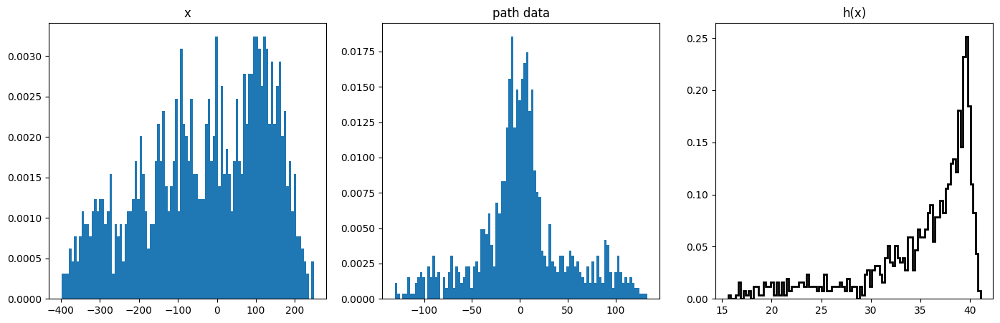

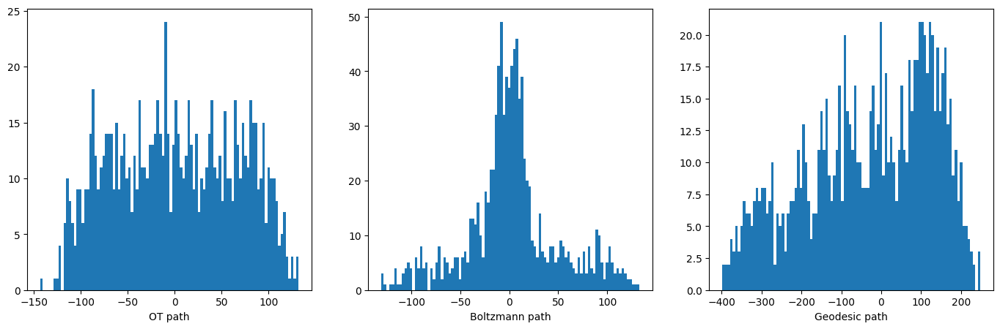

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1229 5512.195312 0.003000
    1239 2497.330811 0.001500
    1249 1988.473877 0.000750
    1259 1643.727051 0.000750
    1269 1522.013184 0.000750
[17, 268906112.0]


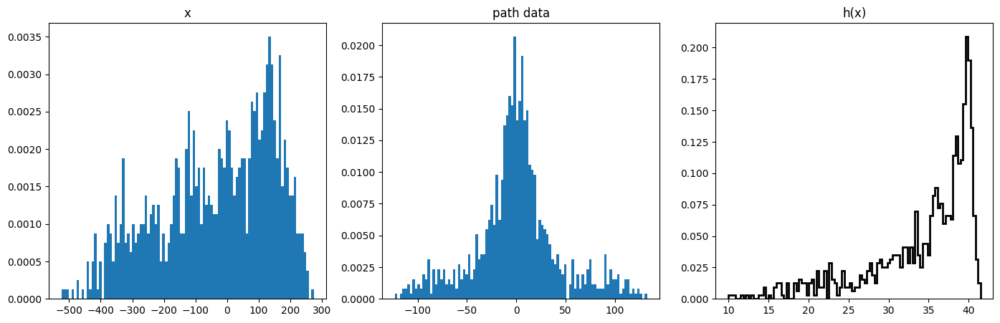

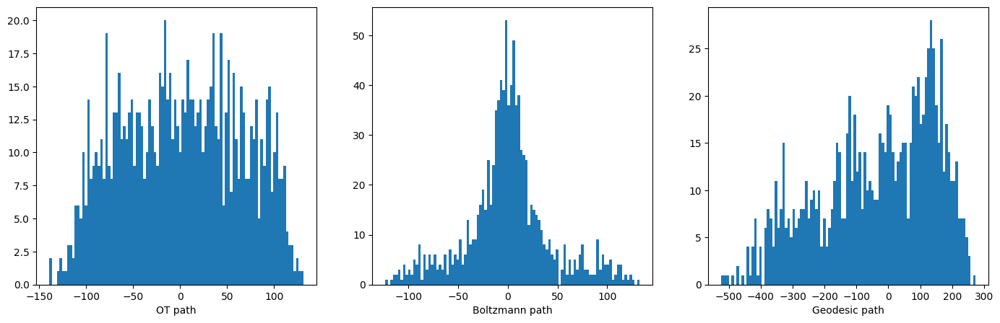

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1278 7293.174805 0.003000
    1288 3643.255615 0.001500
    1298 2891.680664 0.000750
    1308 2434.028320 0.000375
    1318 2341.643799 0.000375
[18, 218784416.0]


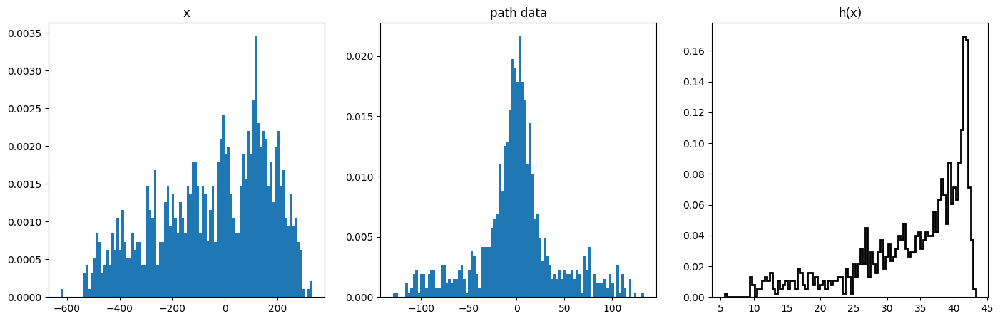

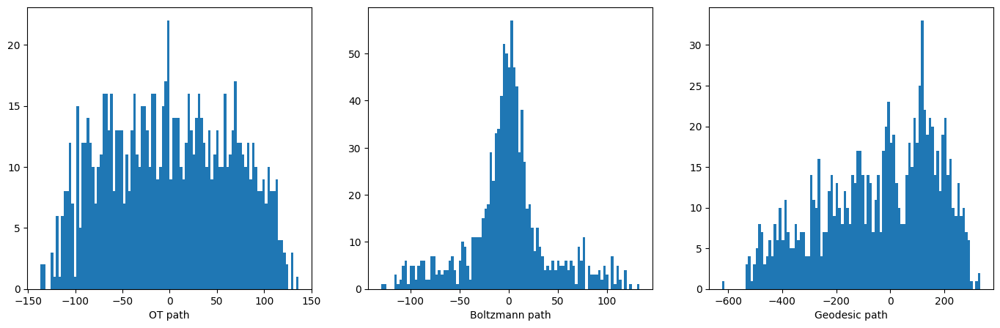

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1327 6440.546387 0.003000
    1337 3715.501221 0.001500
    1347 2912.048828 0.000750
    1357 2479.812500 0.000750
    1367 2341.322021 0.000750
[19, 258742608.0]


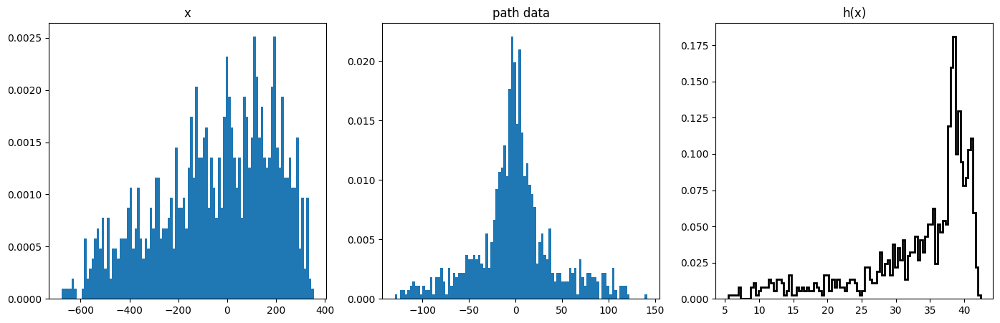

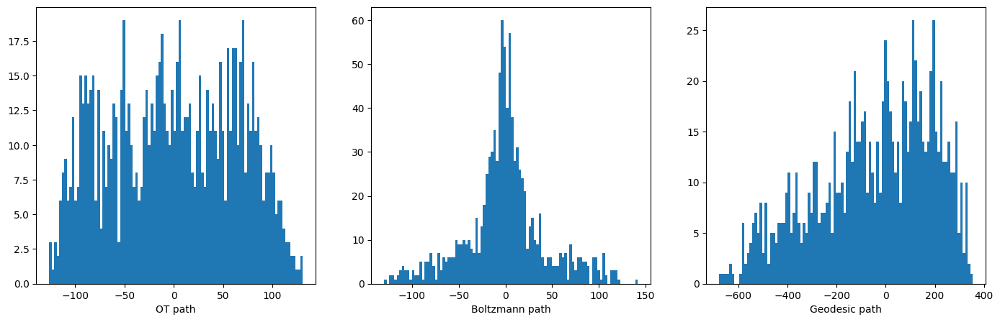

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1376 7476.719238 0.003000
    1386 5175.688477 0.001500
    1396 4459.442383 0.001500
    1406 3829.790039 0.001500
    1416 3331.223633 0.001500
[20, 361603200.0]


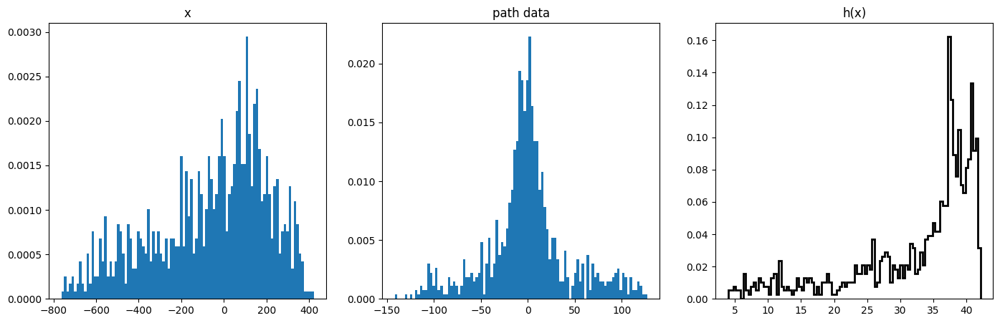

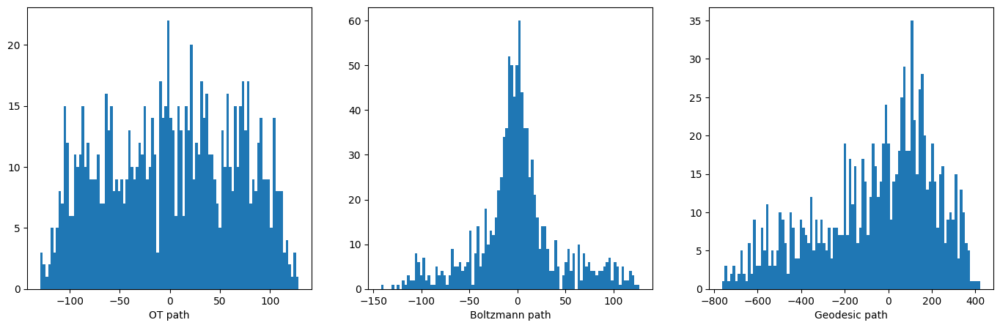

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1425 9257.249023 0.003000
    1435 6809.456543 0.001500
    1445 5751.769043 0.001500
    1455 4850.176758 0.001500
    1465 4156.242188 0.001500
[21, 234504864.0]


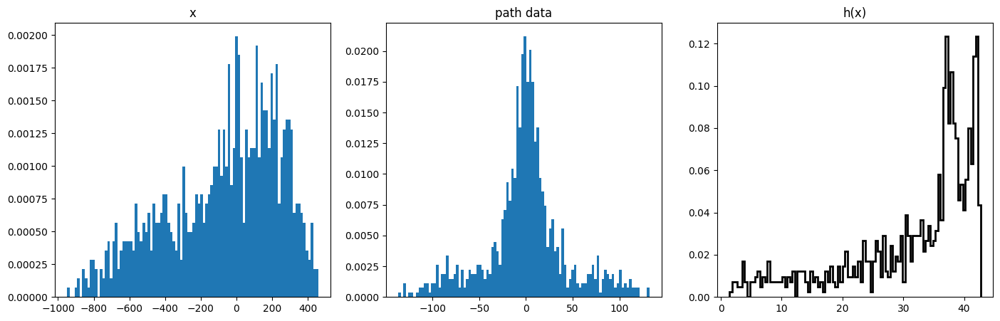

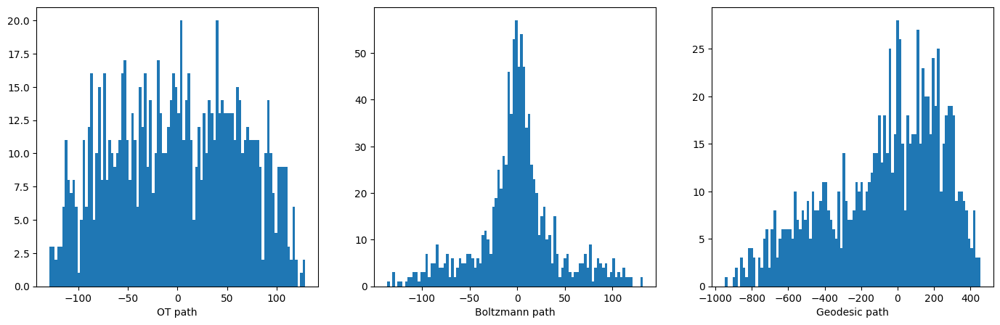

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1474 16511.626953 0.003000
    1484 8228.993164 0.001500
    1494 6564.016602 0.000750
    1504 5572.890625 0.000375
    1514 5368.221191 0.000375
[22, 256841392.0]


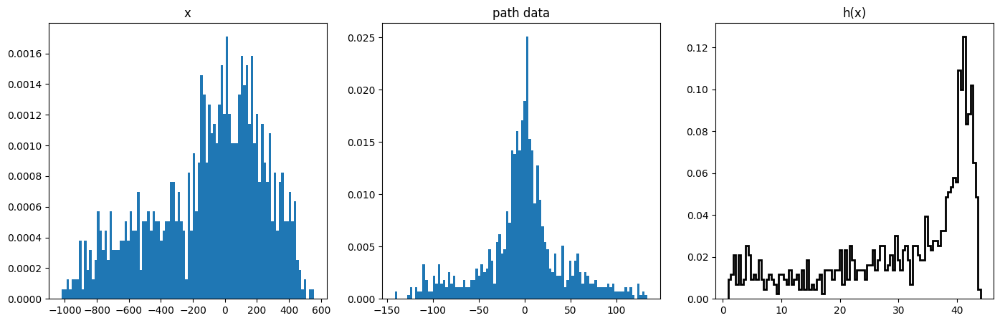

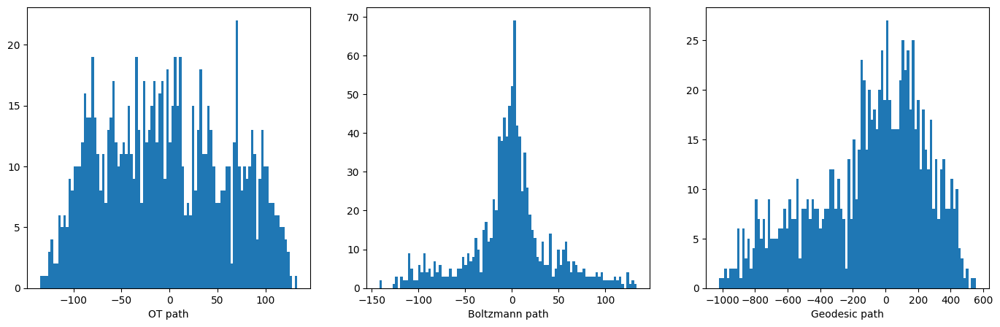

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1523 11542.193359 0.003000
    1533 9423.294922 0.001500
    1543 8339.548828 0.001500
    1553 7564.925781 0.001500
    1563 6975.017090 0.001500
[23, 238348912.0]


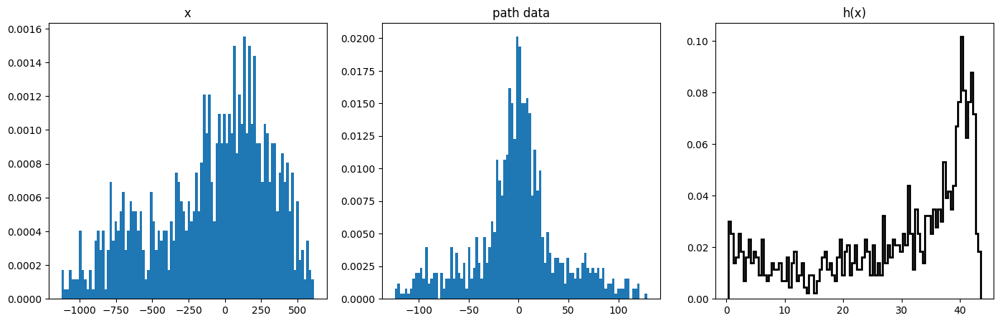

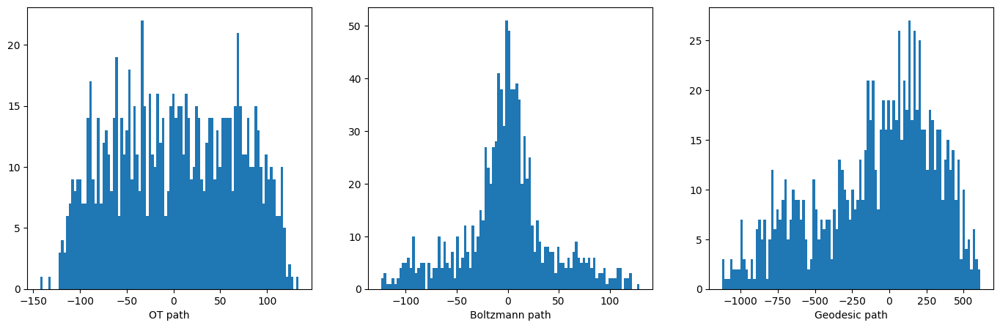

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1572 12020.248047 0.003000
    1582 9951.032227 0.001500
    1592 8915.100586 0.001500
    1602 8160.500977 0.001500
    1612 7614.983887 0.001500
[24, 174988528.0]


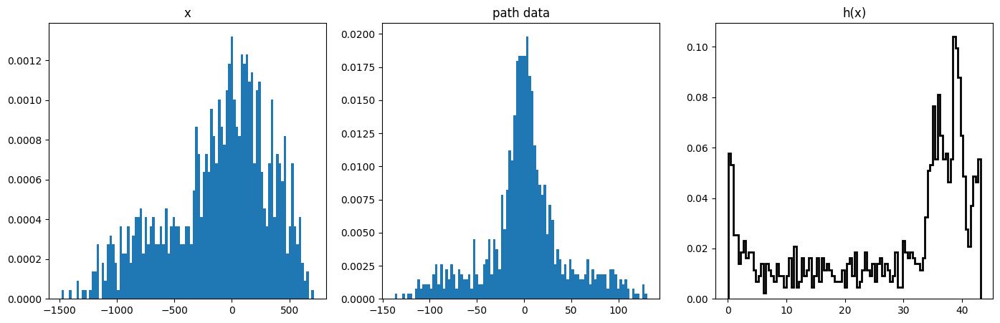

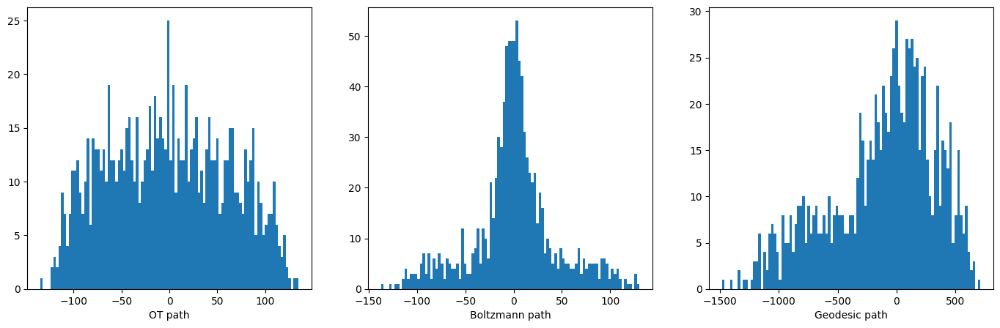

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1621 13590.732422 0.003000
    1631 11480.687500 0.001500
    1641 10511.496094 0.001500
    1651 9681.883789 0.001500
    1661 9030.641602 0.001500
[25, 319269120.0]


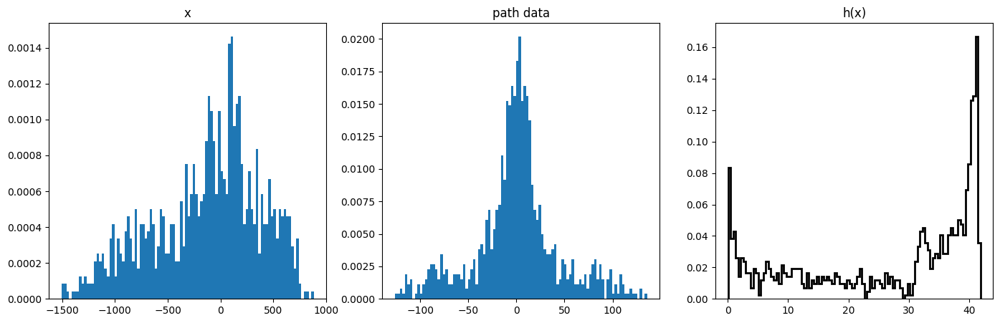

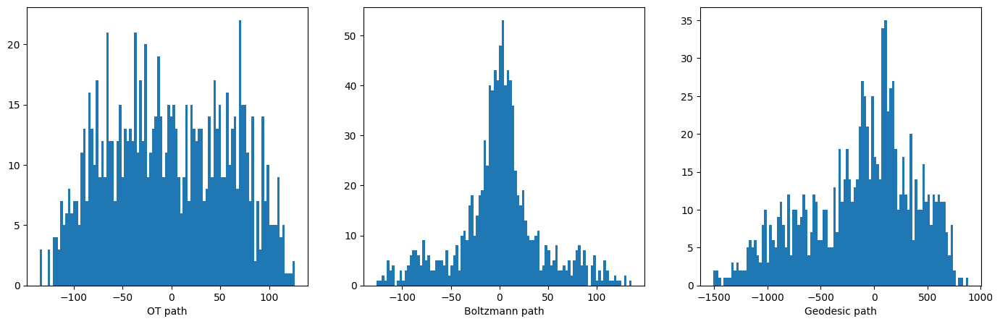

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1670 19194.314453 0.003000
    1680 14248.156250 0.001500
    1690 12639.570312 0.001500
    1700 11244.570312 0.001500
    1710 10140.676758 0.001500
[26, 322318336.0]


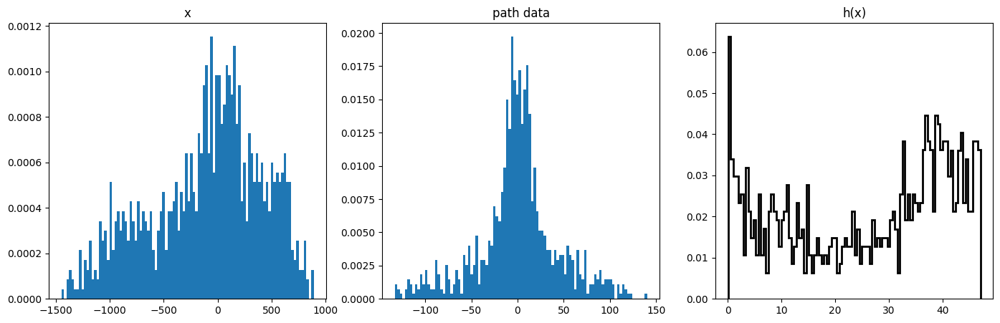

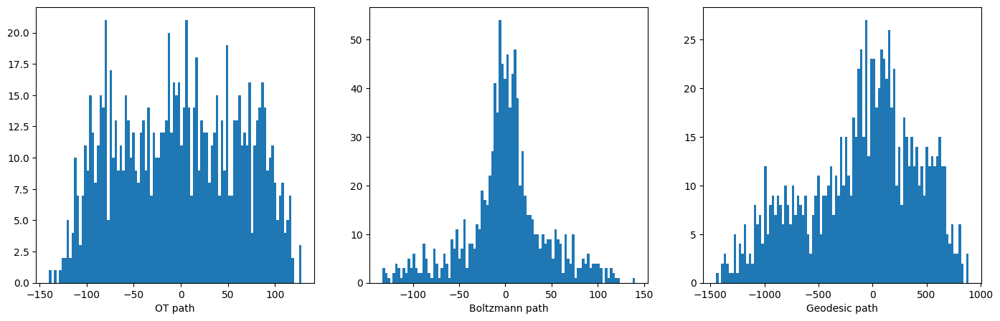

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1719 14893.317383 0.003000
    1729 12009.480469 0.003000
    1739 9764.200195 0.003000
    1749 8171.488770 0.003000
    1759 7298.826660 0.003000
[27, 310128640.0]


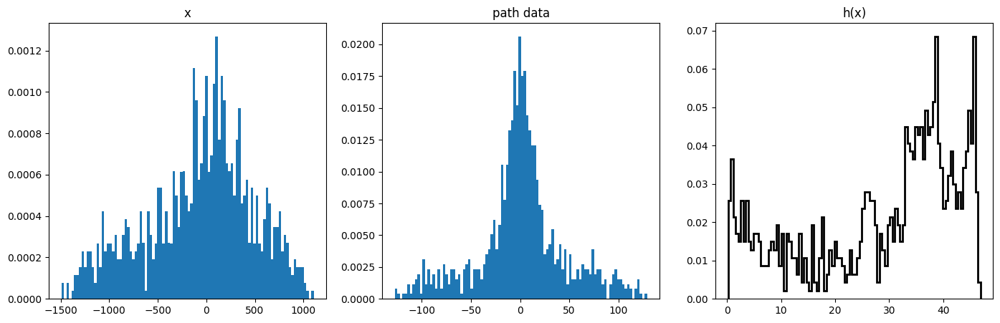

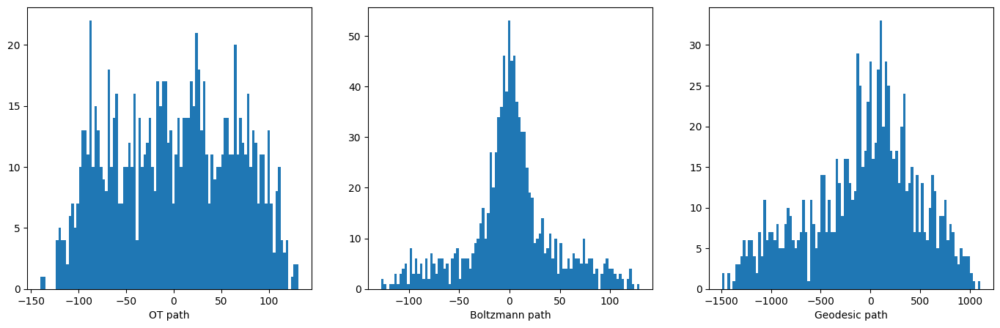

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1768 20561.871094 0.003000
    1778 14765.985352 0.003000
    1788 11641.774414 0.003000
    1798 9447.025391 0.003000
    1808 8666.825195 0.003000
[28, 349099456.0]


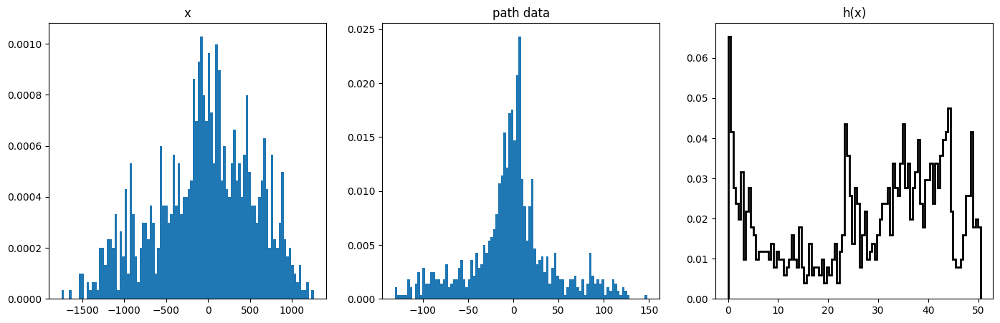

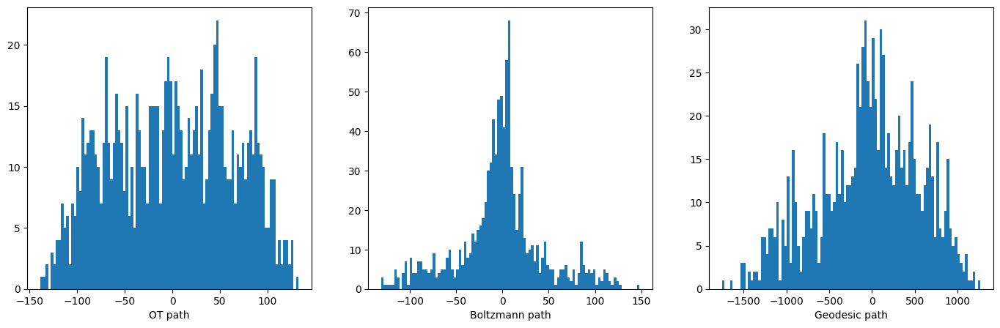

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1817 65627.164062 0.003000
    1827 20074.593750 0.001500
    1837 14188.408203 0.000750
[29, 268920832.0]


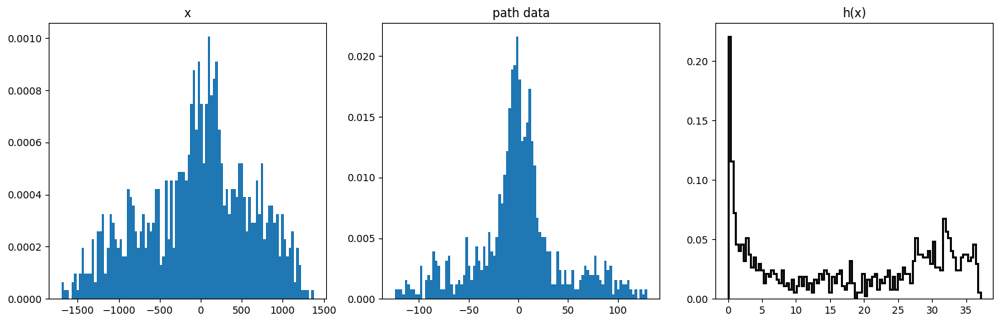

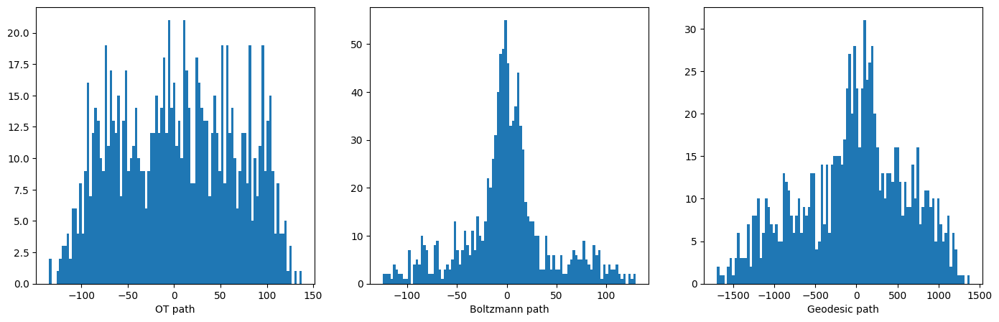

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1846 18330.984375 0.003000
    1856 16694.689453 0.003000
    1866 14915.283203 0.003000
    1876 13479.475586 0.003000
    1886 12424.195312 0.003000
[30, 381396704.0]


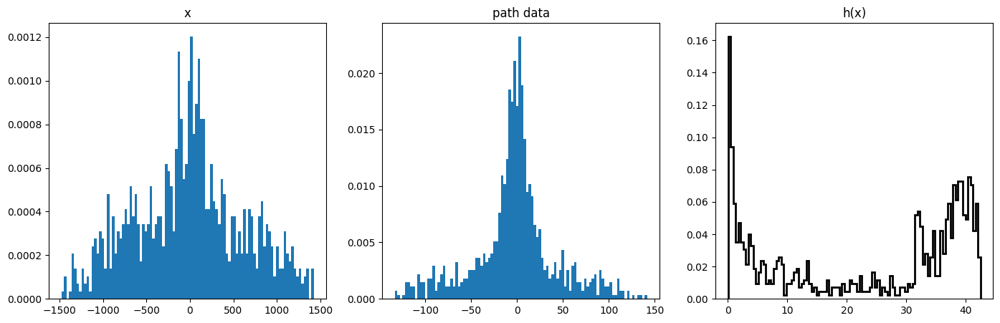

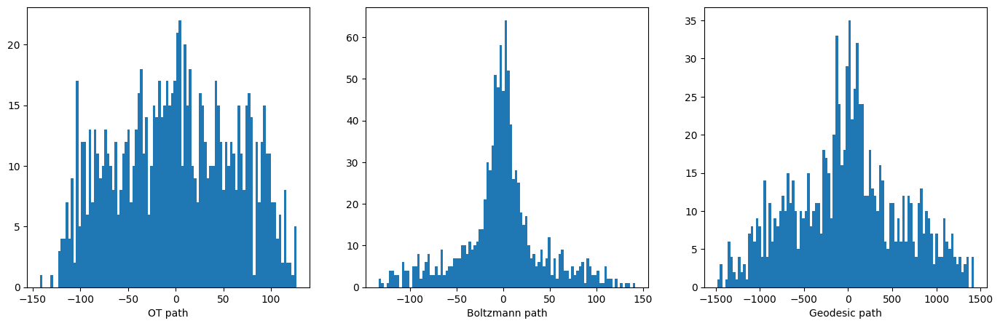

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1895 20380.285156 0.003000
    1905 17061.123047 0.003000
    1915 14222.541016 0.003000
    1925 12306.272461 0.003000
    1935 11098.378906 0.003000
[31, 300891552.0]


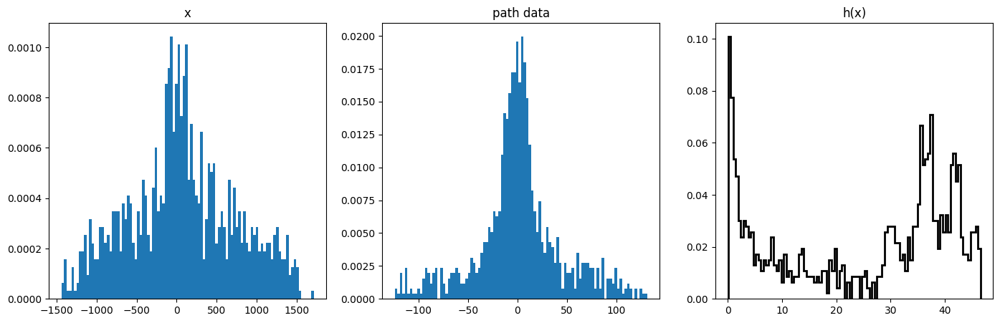

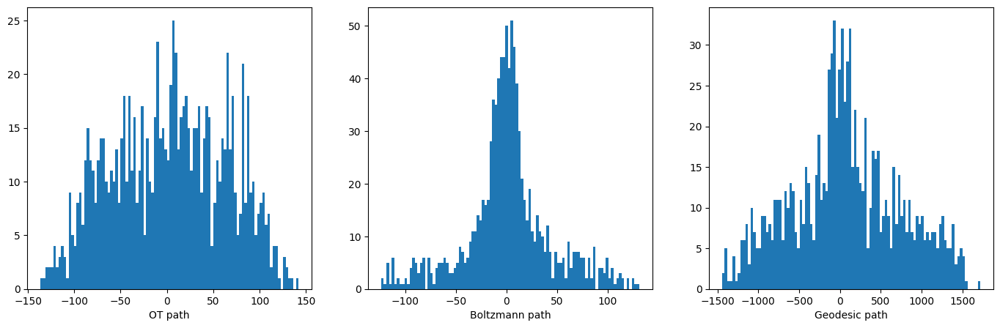

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1944 19190.205078 0.003000
    1954 14322.612305 0.001500
    1964 13488.822266 0.000750
    1974 12876.664062 0.000750
    1984 12486.556641 0.000750
[32, 381583456.0]


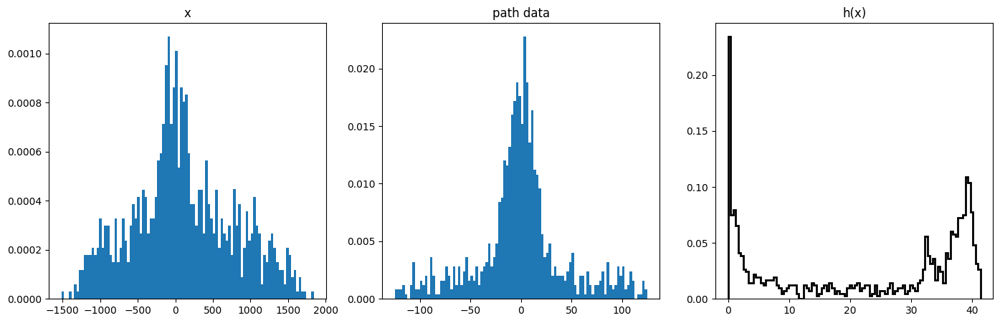

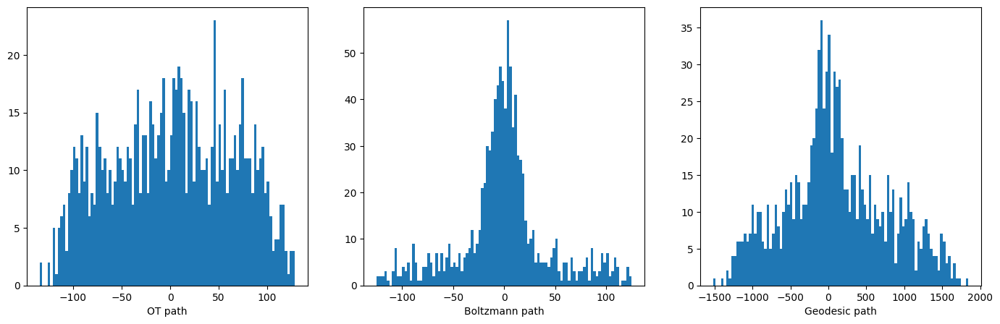

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    1993 24790.384766 0.003000
    2003 18582.556641 0.003000
    2013 15126.109375 0.003000
    2023 12466.734375 0.003000
    2033 11349.054688 0.003000
[33, 234720752.0]


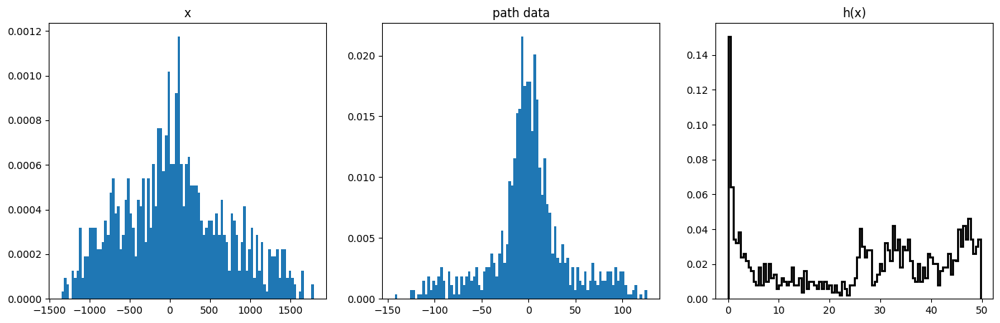

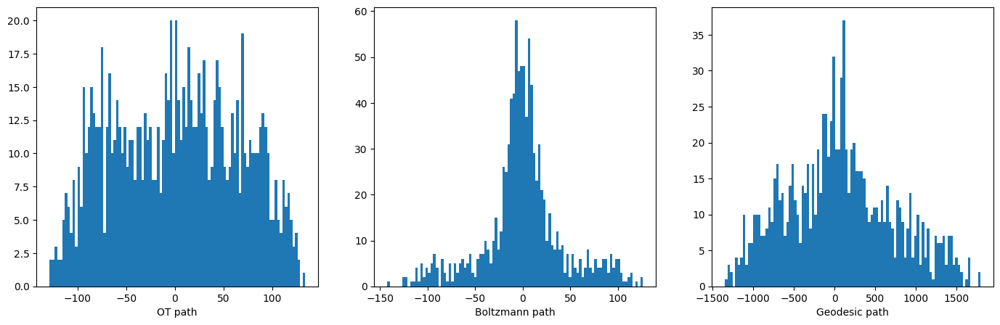

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2042 19328.896484 0.003000
    2052 11529.880859 0.001500
    2062 11130.204102 0.000750
    2072 10821.401367 0.000750
    2082 10482.617188 0.000750
[34, 348281376.0]


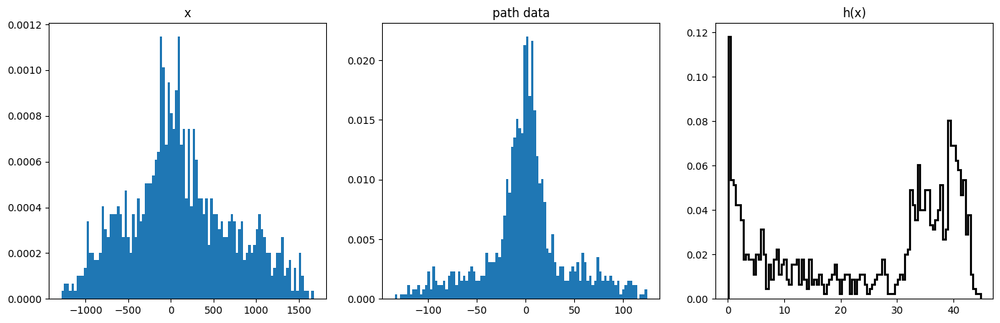

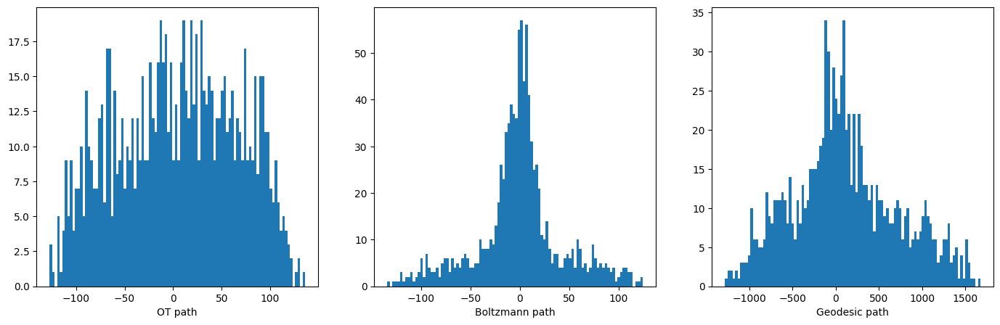

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2091 22958.394531 0.003000
    2101 13593.794922 0.001500
    2111 12706.486328 0.000750
    2121 12030.230469 0.000750
    2131 11331.809570 0.000750
[35, 347082976.0]


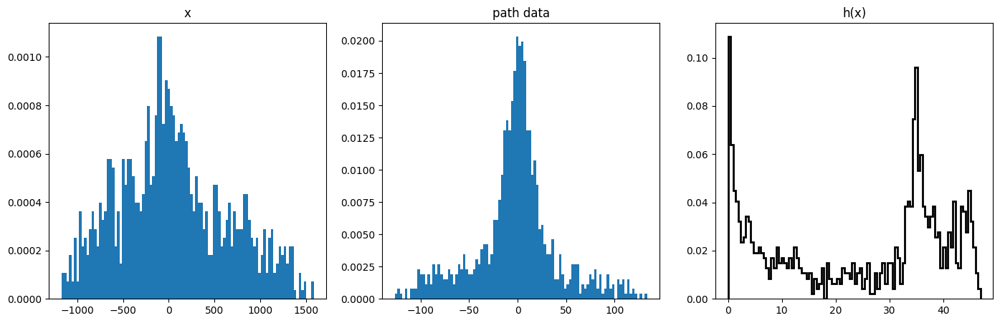

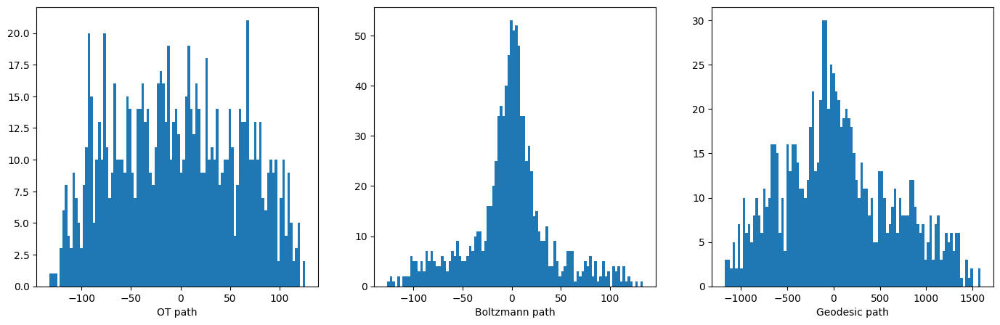

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2140 18215.386719 0.003000
    2150 13183.088867 0.003000
    2160 10082.776367 0.003000
    2170 7938.419434 0.003000
    2180 7140.570801 0.003000
[36, 442883584.0]


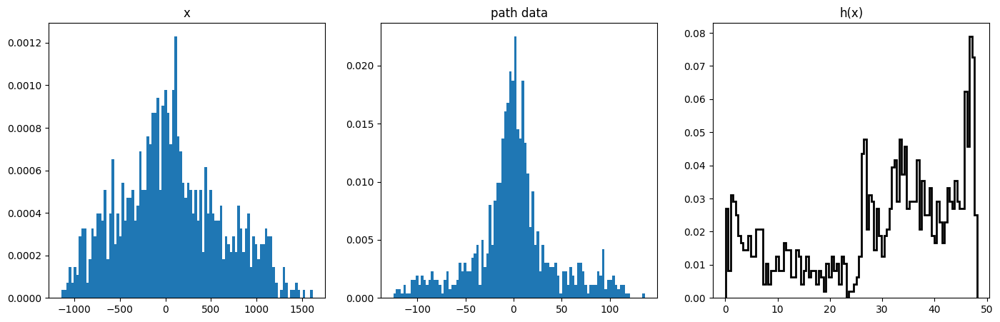

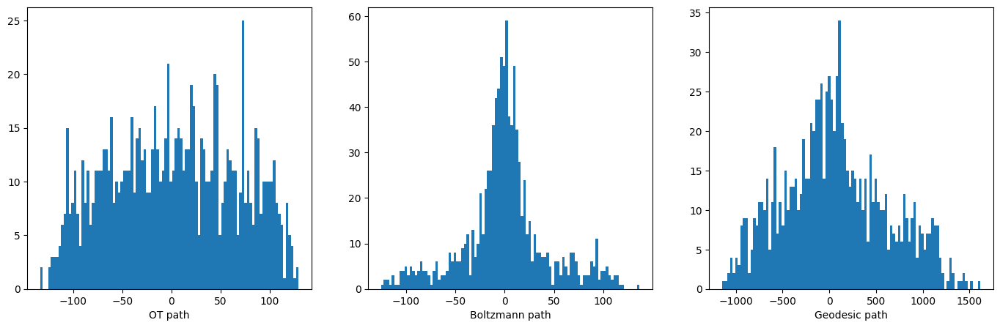

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2189 73180.867188 0.003000
    2199 14737.581055 0.001500
    2209 15576.365234 0.000375
    2219 14045.927734 0.000188
    2229 13491.422852 0.000188
[37, 358886944.0]


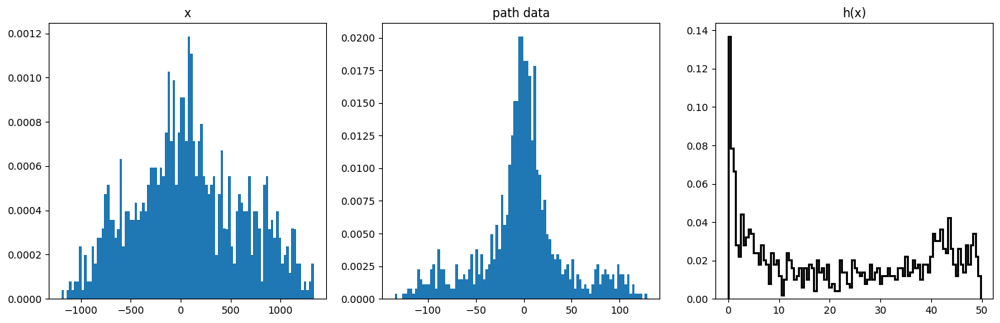

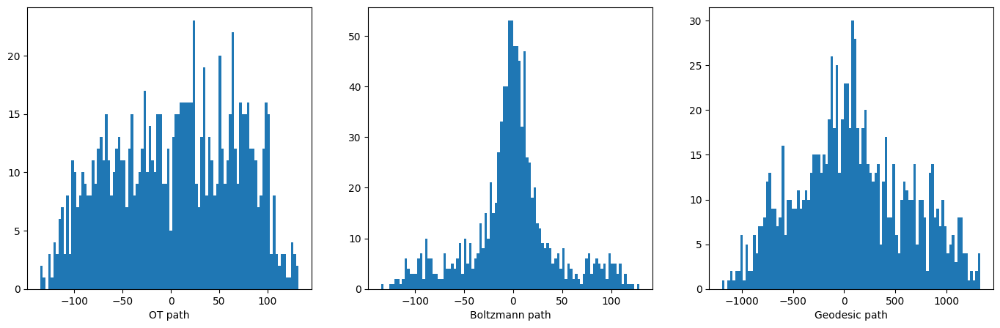

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2238 12256.111328 0.003000
    2248 10628.607422 0.003000
    2258 8997.432617 0.003000
    2268 7838.749023 0.003000
    2278 7189.301758 0.003000
[38, 224159168.0]


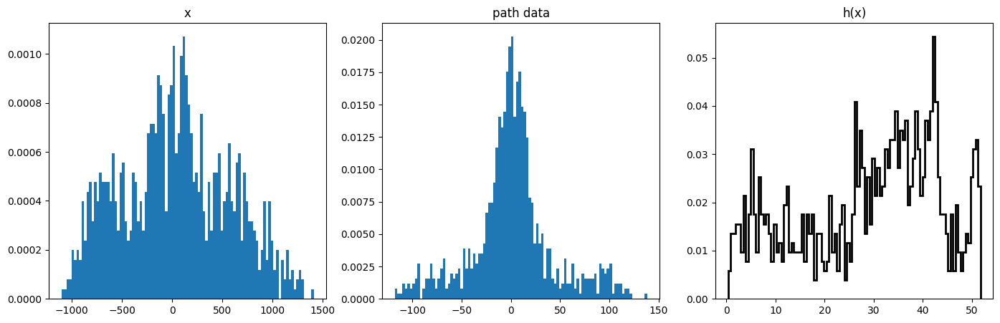

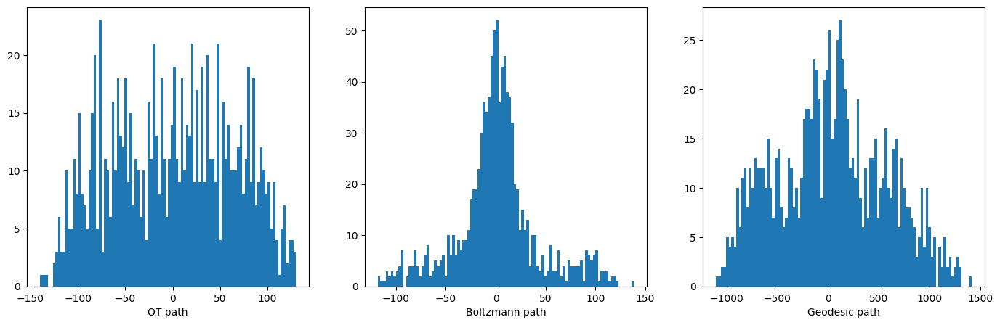

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2287 11463.451172 0.003000
    2297 8597.972656 0.003000
    2307 6681.809570 0.003000
    2317 6369.983887 0.003000
    2327 5998.941406 0.003000
[39, 275458912.0]


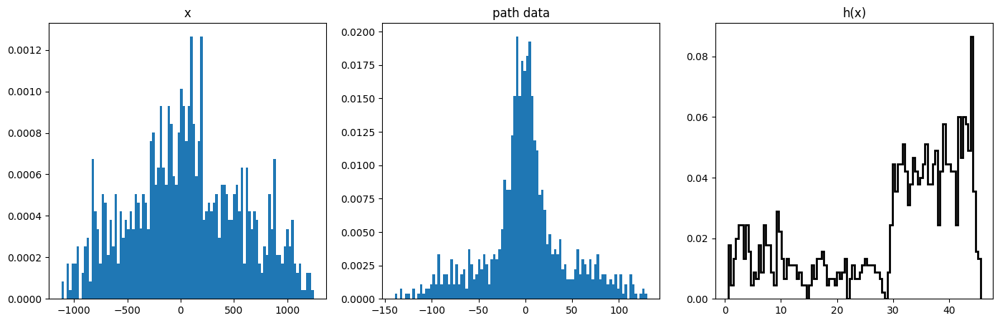

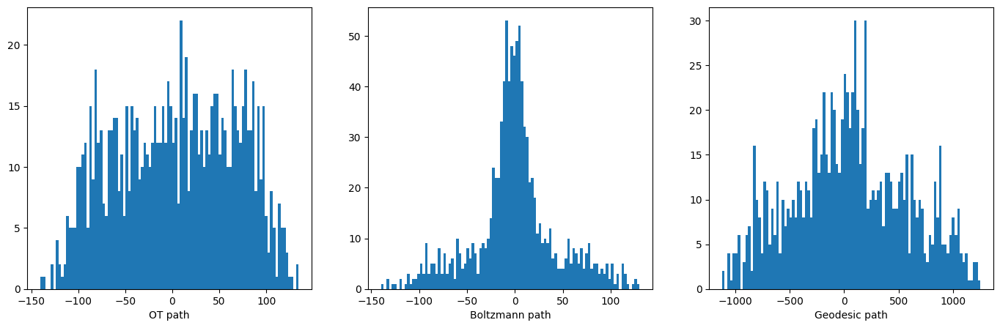

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2336 25420.716797 0.003000
    2346 9847.846680 0.001500
    2356 6693.527344 0.000750
    2366 6150.044922 0.000375
    2376 5778.345215 0.000375
[40, 481043200.0]


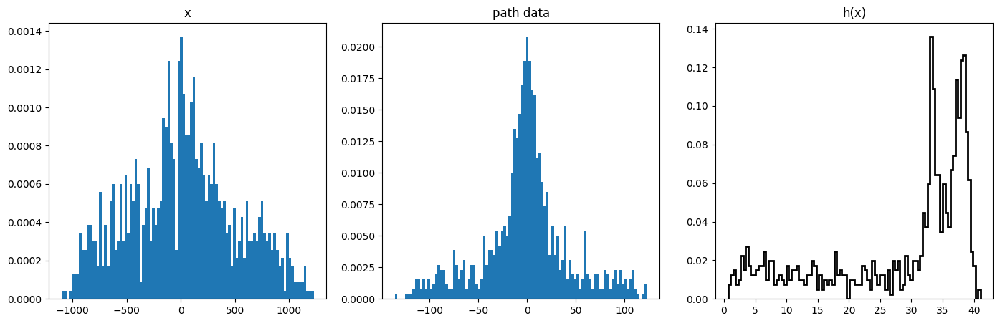

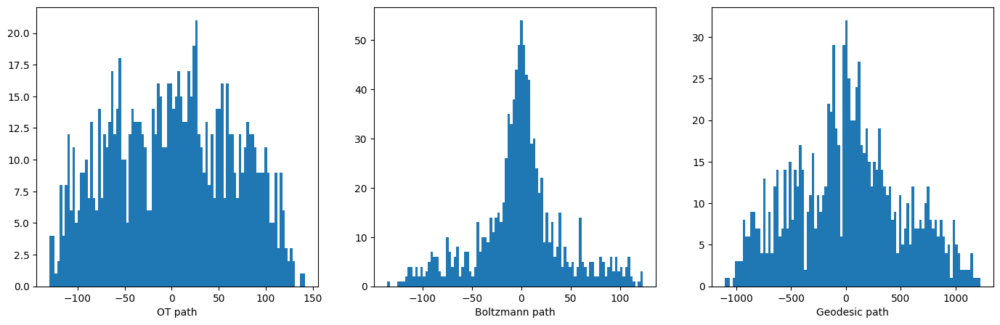

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2385 31161.828125 0.003000
    2395 9449.291992 0.001500
    2405 8612.833984 0.000750
    2415 7994.749512 0.000375
    2425 7374.360352 0.000375
[41, 373495872.0]


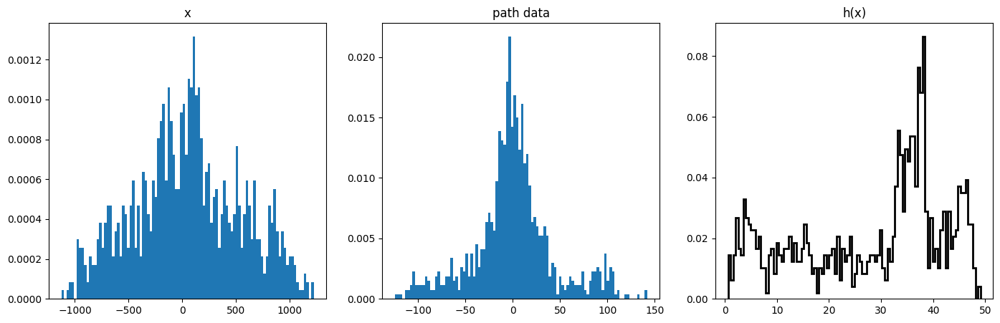

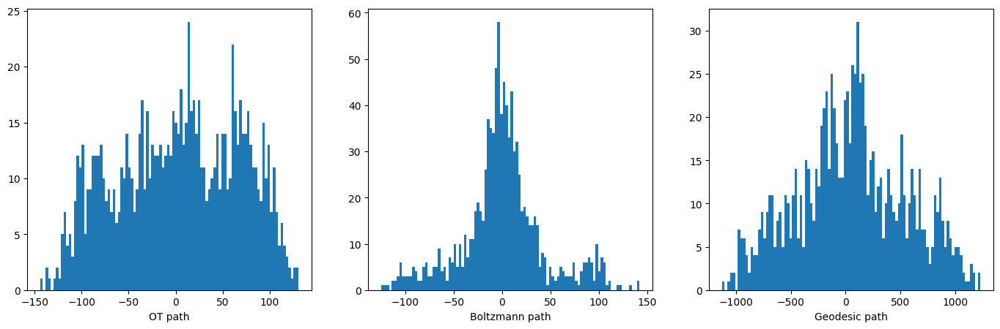

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2434 49834.828125 0.003000
    2444 18749.429688 0.001500
    2454 15799.837891 0.000750
    2464 13471.990234 0.000375
    2474 12736.644531 0.000375
[42, 125895648.0]


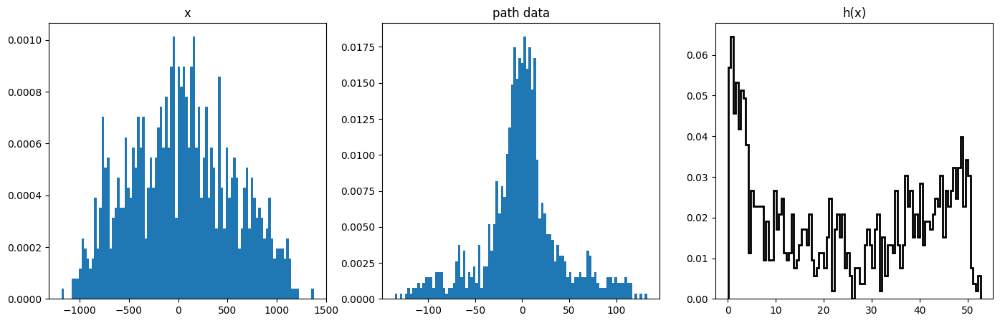

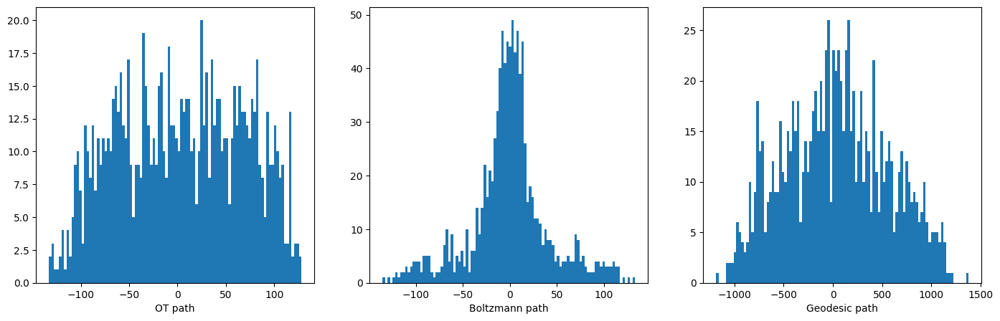

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2483 18272.683594 0.003000
    2493 14727.091797 0.003000
    2503 11743.462891 0.003000
    2513 9890.377930 0.003000
    2523 8800.618164 0.003000
[43, 238378496.0]


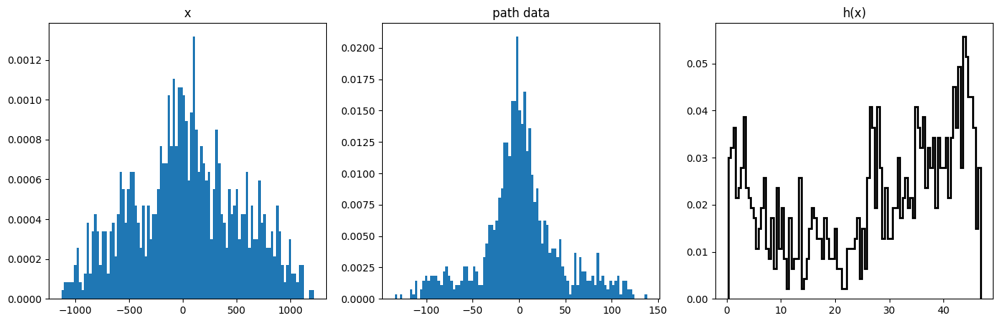

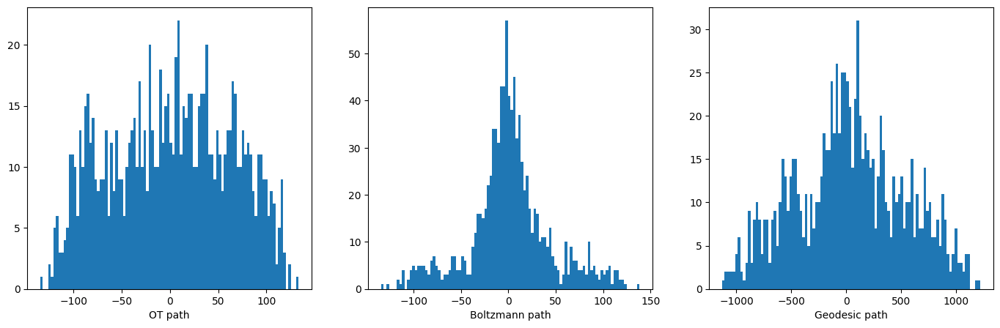

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2532 16175.300781 0.003000
    2542 11683.850586 0.001500
    2552 9808.225586 0.000750
    2562 9018.242188 0.000750
    2572 8706.958008 0.000750
[44, 198101328.0]


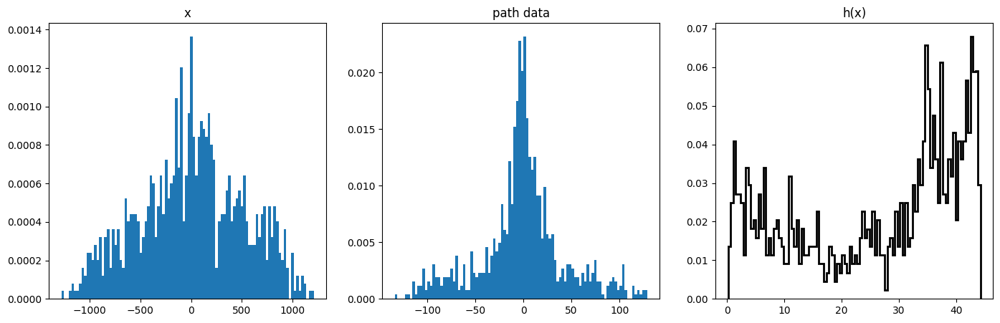

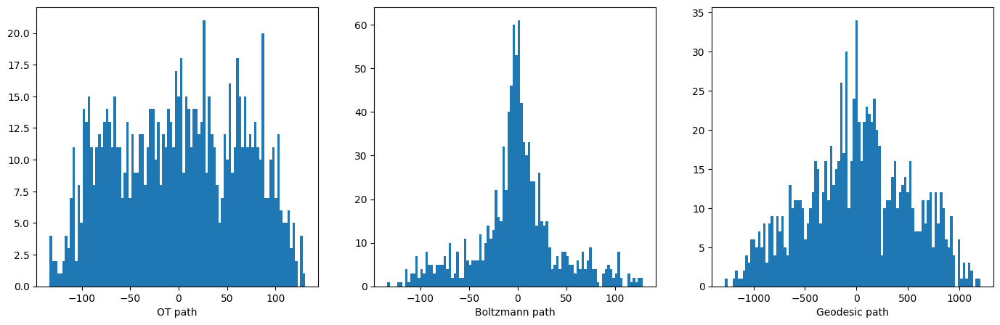

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2581 14365.462891 0.003000
    2591 10936.820312 0.001500
    2601 9763.974609 0.000750
    2611 9064.539062 0.000750
    2621 8795.487305 0.000750
[45, 179722400.0]


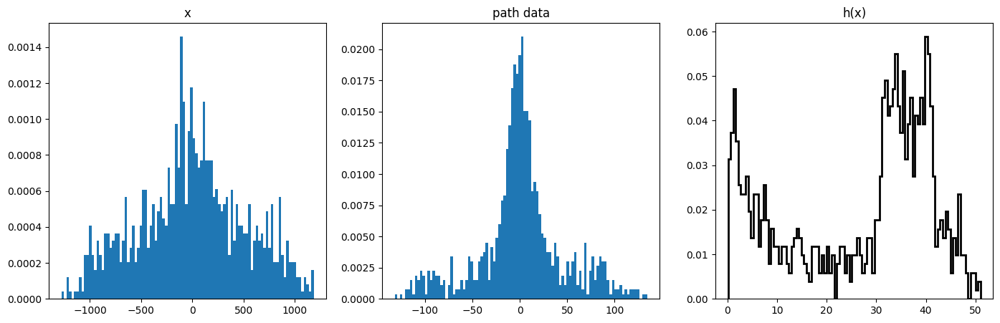

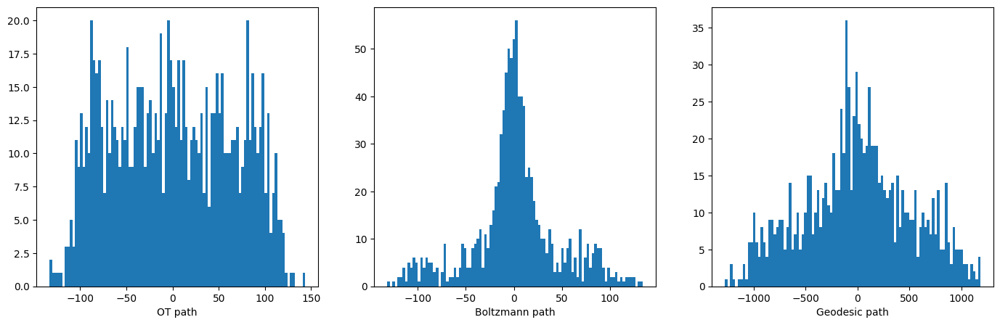

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2630 21929.681641 0.003000
    2640 13706.642578 0.001500
    2650 12156.554688 0.000750
    2660 10962.765625 0.000750
    2670 10476.691406 0.000750
[46, 303437824.0]


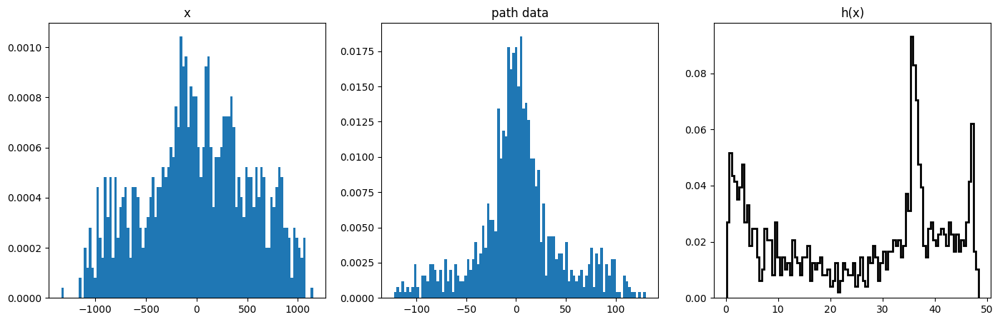

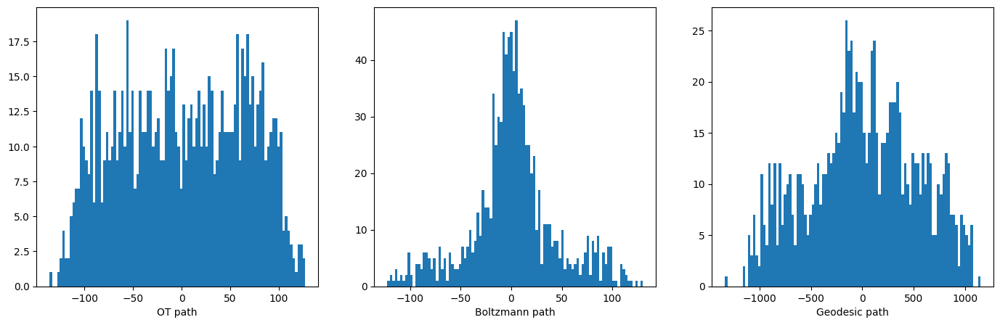

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2679 63778.324219 0.003000
    2689 17674.236328 0.001500
    2699 11397.757812 0.000375
[47, 212605488.0]


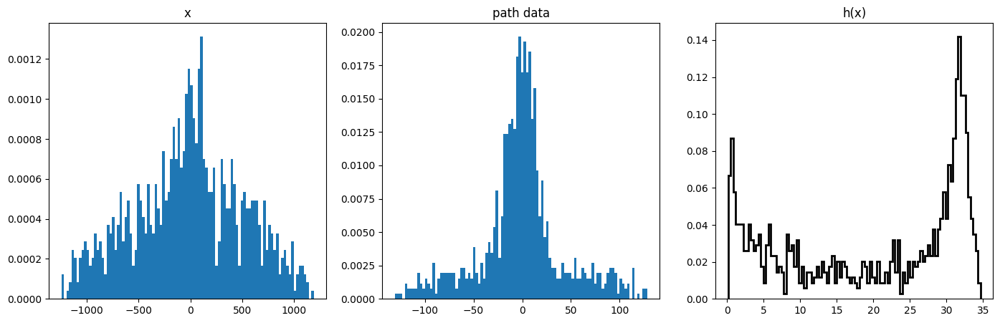

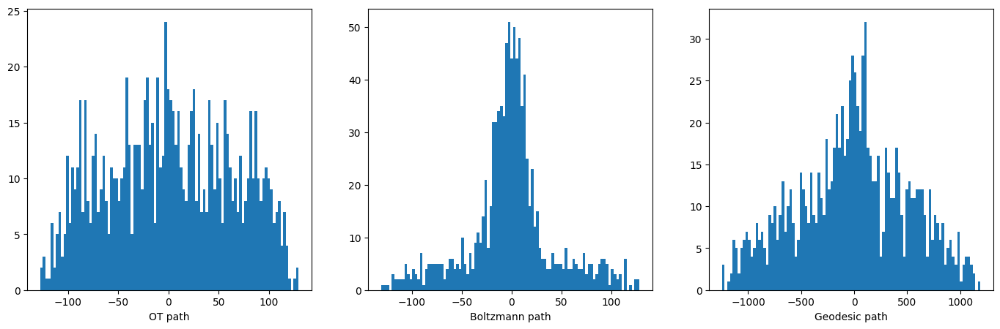

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2707 18444.710938 0.003000
    2717 15905.320312 0.001500
    2727 14115.590820 0.001500
    2737 12793.349609 0.001500
    2747 11906.203125 0.001500
[48, 186260944.0]


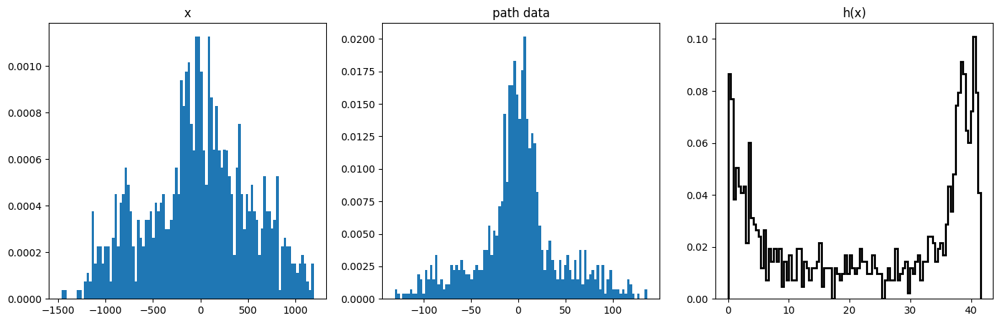

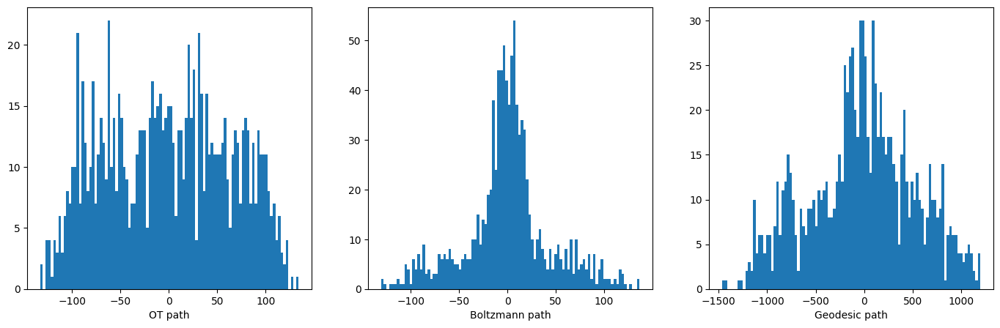

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2756 17811.312500 0.003000
    2766 15203.240234 0.001500
    2776 13562.875000 0.001500
    2786 12764.654297 0.001500
    2796 12059.852539 0.001500
[49, 278322400.0]


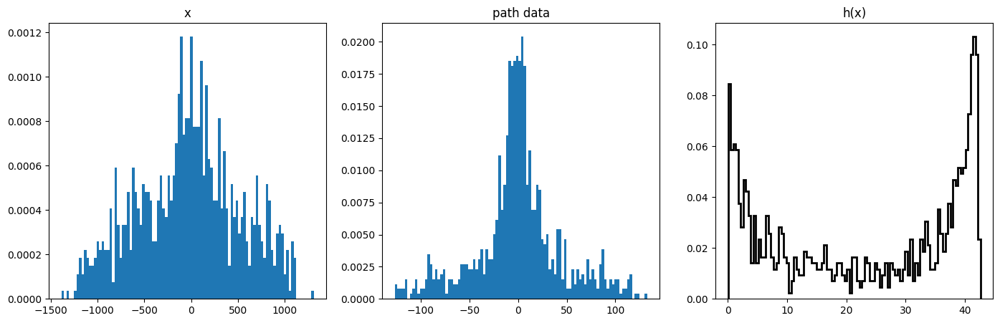

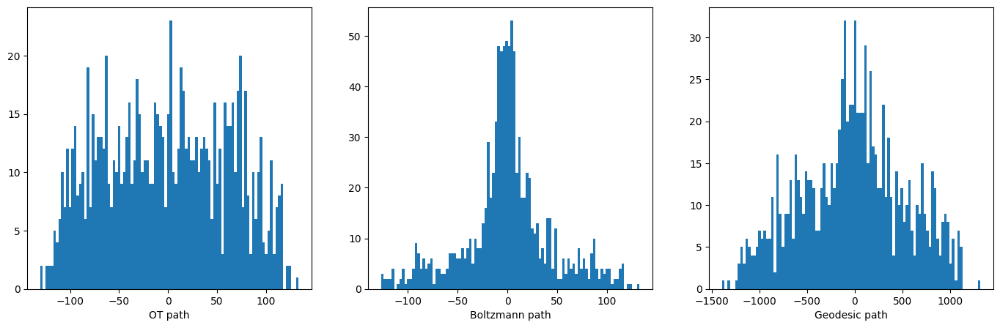

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2805 22621.027344 0.003000
    2815 15487.526367 0.001500
    2825 11779.834961 0.000750
    2835 11689.355469 0.000375
    2845 11315.951172 0.000375
[50, 244758496.0]


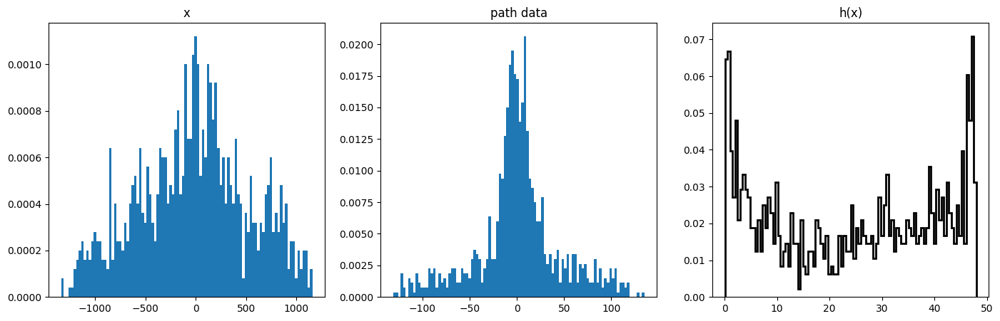

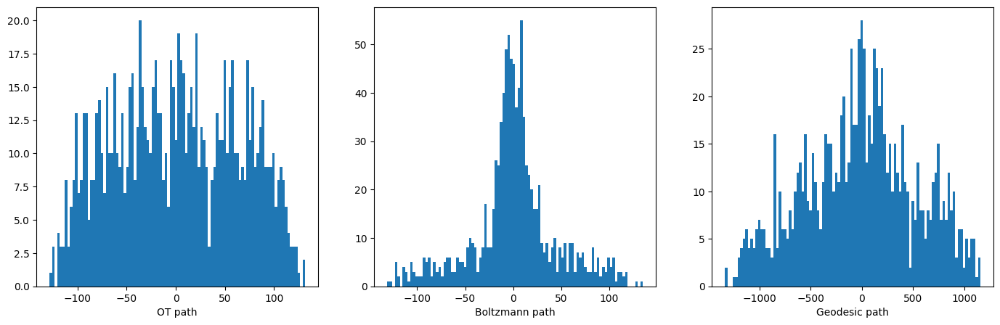

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2854 17104.556641 0.003000
    2864 13977.779297 0.001500
    2874 12191.570312 0.001500
    2884 11356.238281 0.001500
    2894 10740.339844 0.001500
[51, 361120352.0]


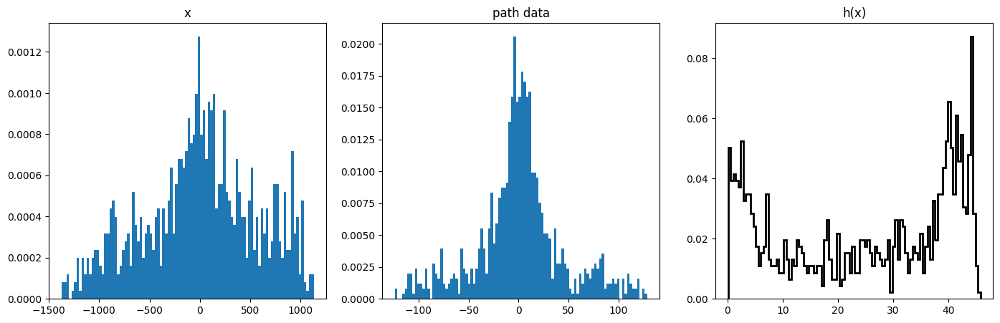

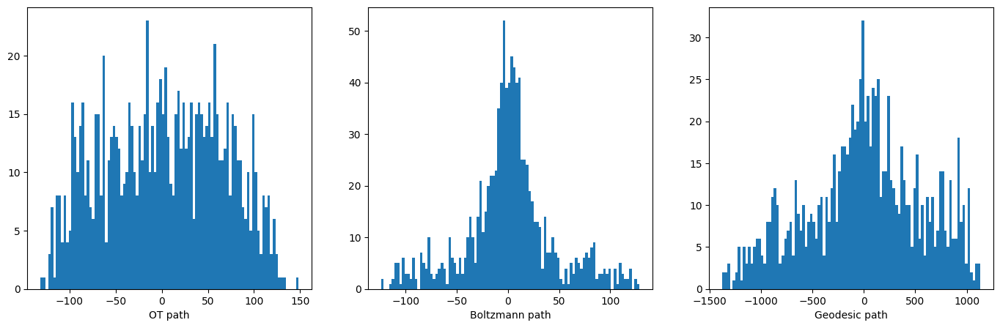

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2903 17384.814453 0.003000
    2913 15690.678711 0.003000
    2923 13658.689453 0.003000
    2933 12061.595703 0.003000
    2943 10947.235352 0.003000
[52, 368271840.0]


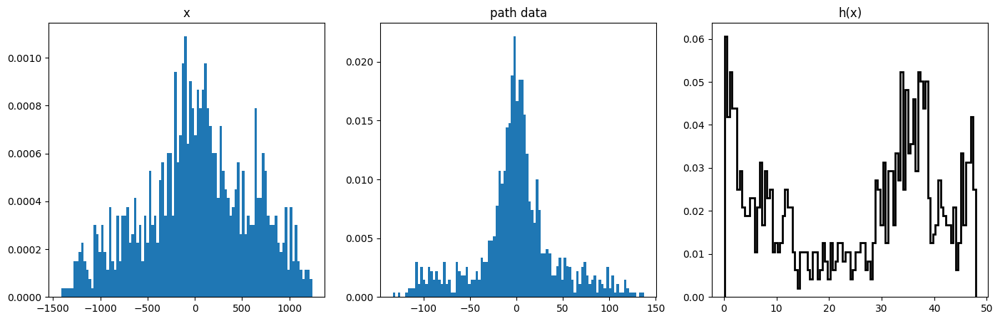

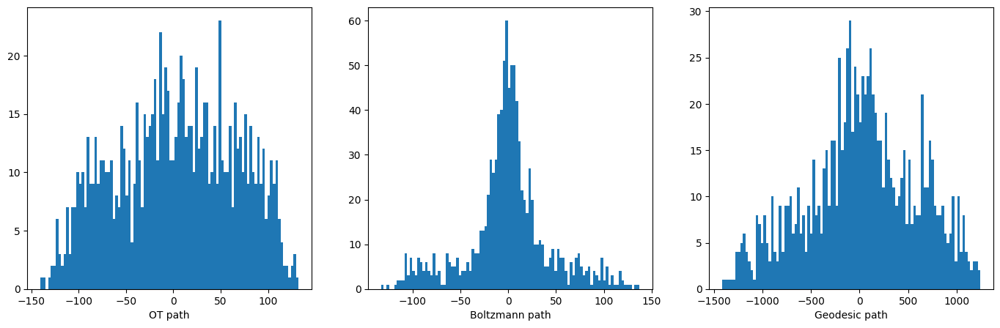

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    2952 20836.382812 0.003000
    2962 15761.780273 0.001500
    2972 13927.087891 0.000750
    2982 13013.925781 0.000750
    2992 12602.267578 0.000750
[53, 183968288.0]


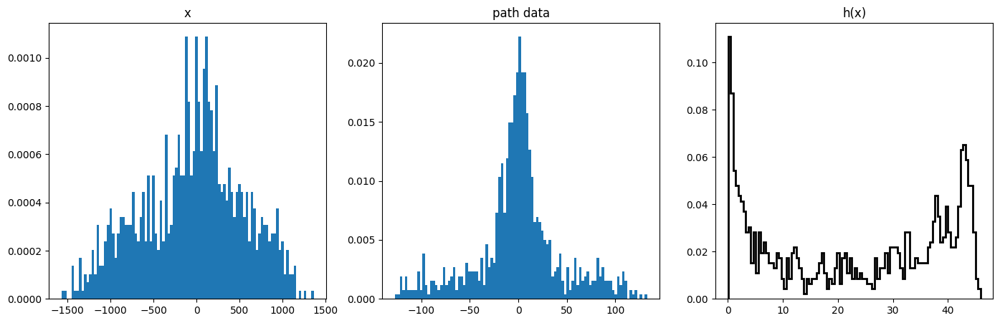

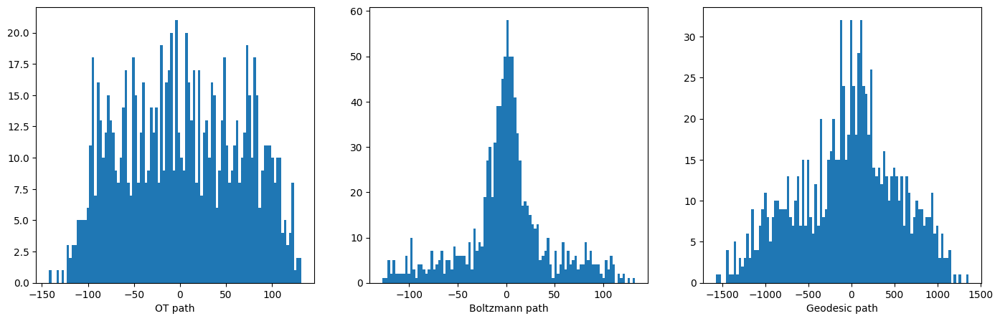

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3001 17256.390625 0.003000
    3011 13386.383789 0.001500
    3021 11368.221680 0.000750
    3031 11342.251953 0.000188
    3041 11193.947266 0.000188
[54, 224204976.0]


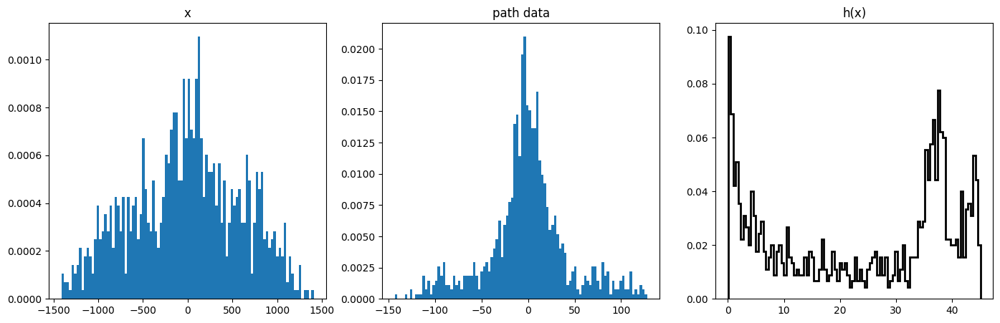

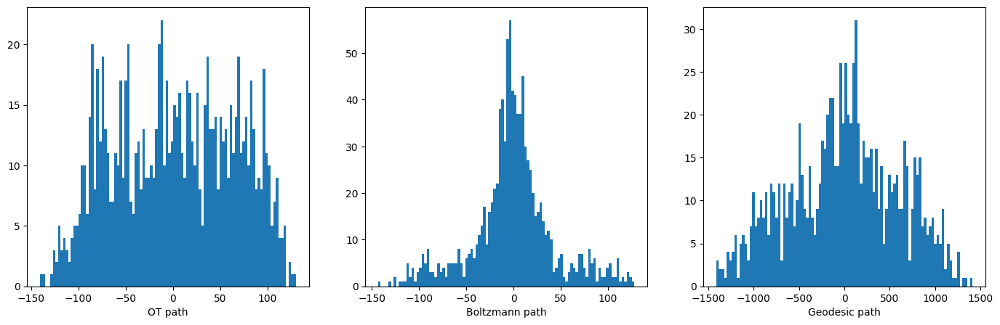

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3050 23442.433594 0.003000
    3060 20422.726562 0.003000
    3070 16664.035156 0.003000
    3080 13987.384766 0.003000
    3090 12098.462891 0.003000
[55, 204504832.0]


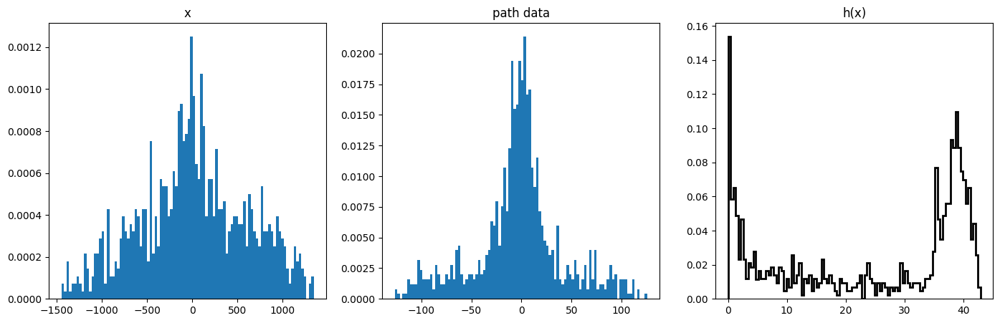

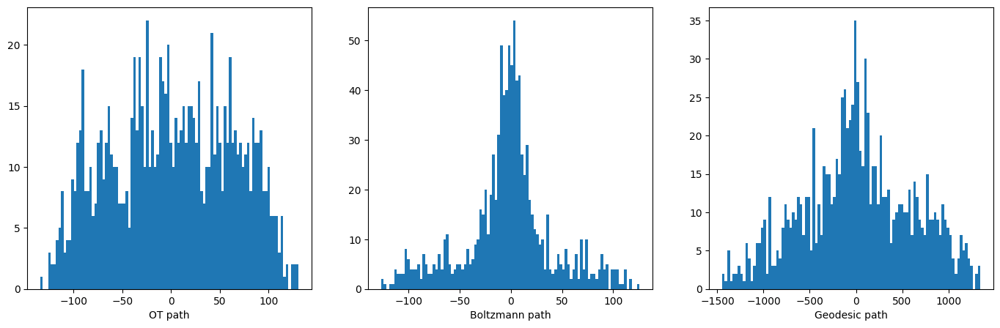

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3099 92505.296875 0.003000
    3109 29751.644531 0.001500
    3119 16515.437500 0.000375
[56, 124036792.0]


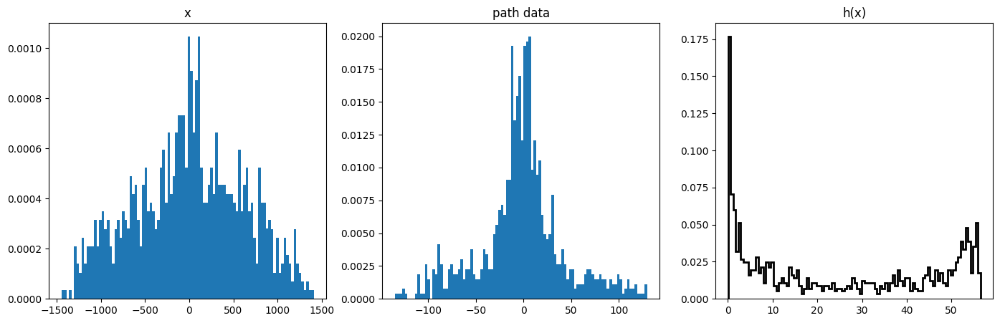

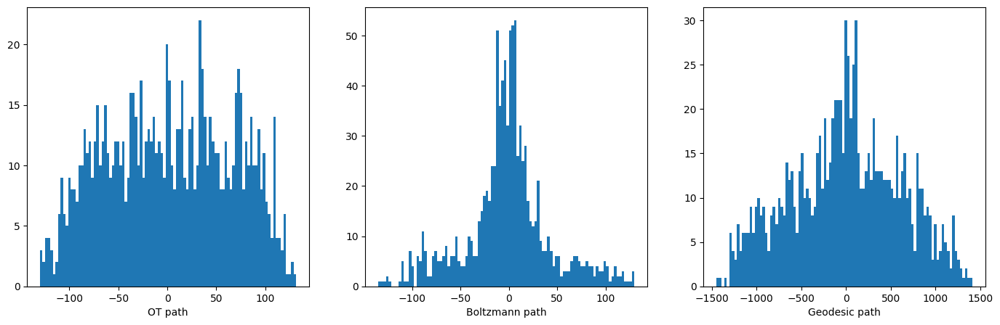

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3124 28931.964844 0.003000
    3134 23350.216797 0.001500
    3144 18280.886719 0.000375
    3154 17044.472656 0.000375
    3164 16774.359375 0.000375
[57, 223684976.0]


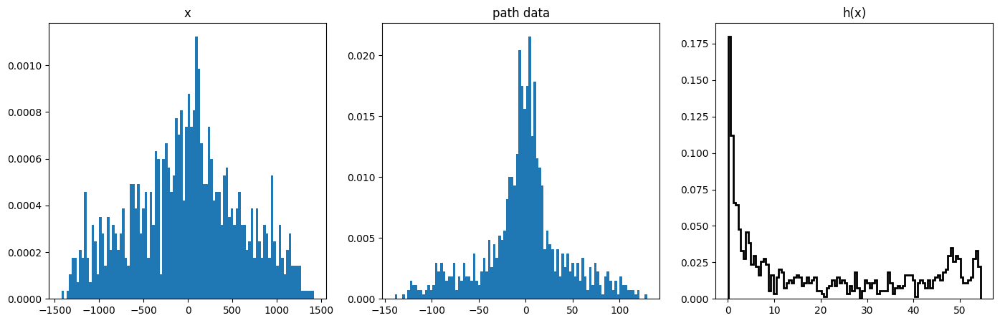

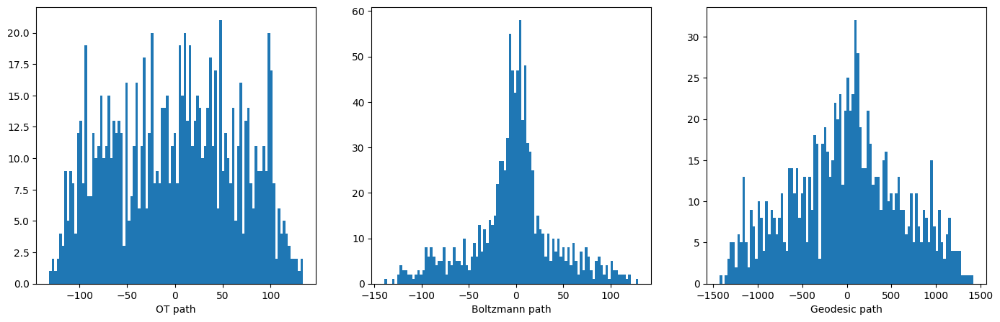

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3173 18877.994141 0.003000
    3183 16904.132812 0.003000
    3193 15071.606445 0.003000
    3203 13640.744141 0.003000
    3213 12526.345703 0.003000
[58, 298475328.0]


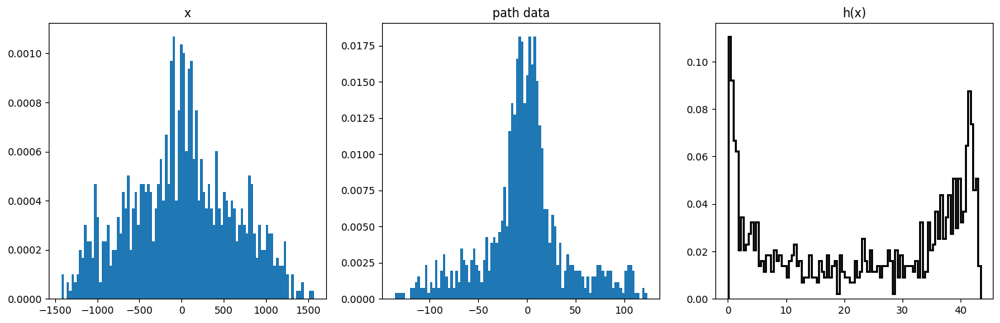

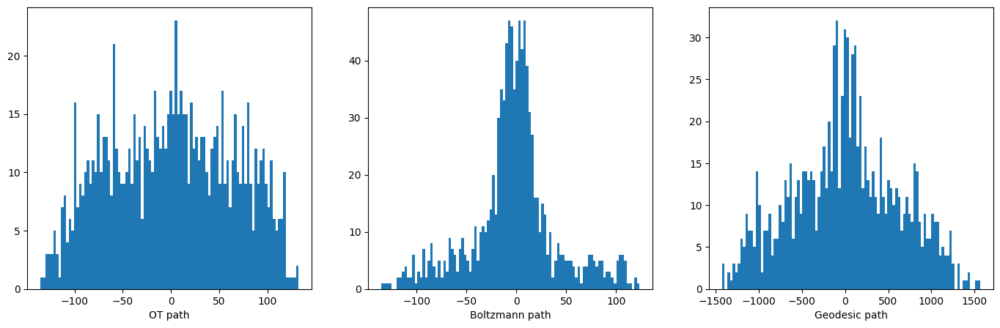

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3222 15675.436523 0.003000
    3232 14340.206055 0.003000
    3242 13621.015625 0.001500
    3252 13276.511719 0.001500
    3262 12861.845703 0.001500
[59, 281219584.0]


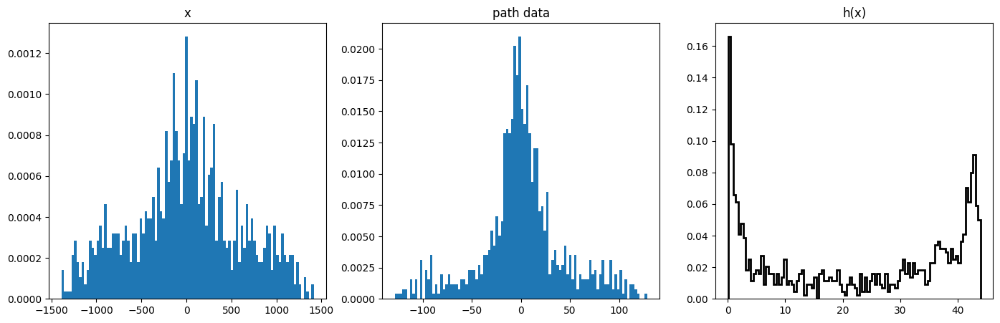

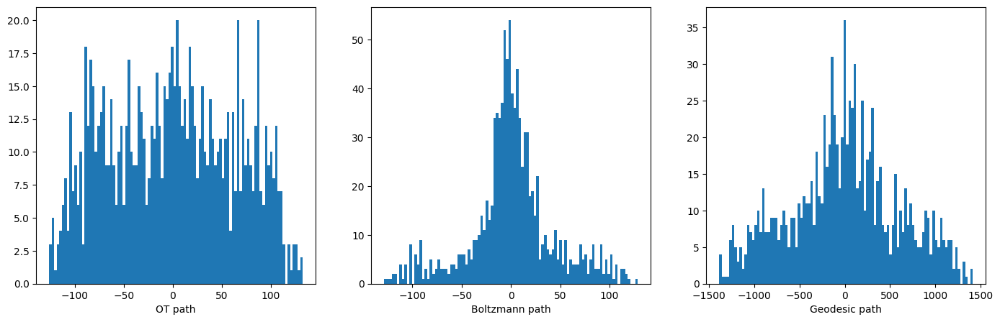

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3271 14370.998047 0.003000
    3281 12803.978516 0.003000
    3291 12071.952148 0.001500
    3301 11796.980469 0.001500
    3311 11429.799805 0.001500
[60, 260657072.0]


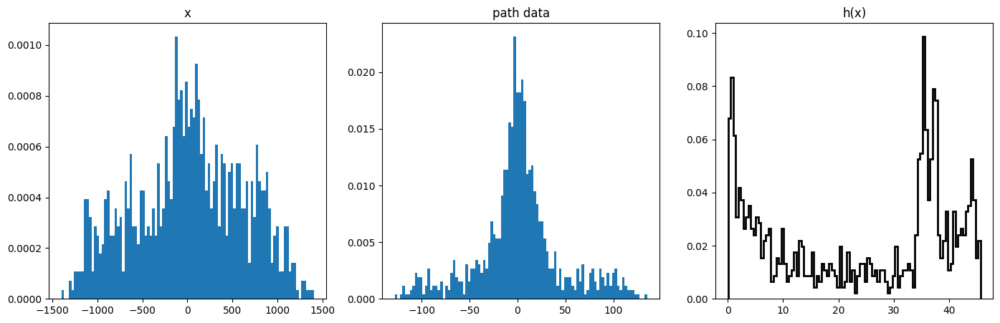

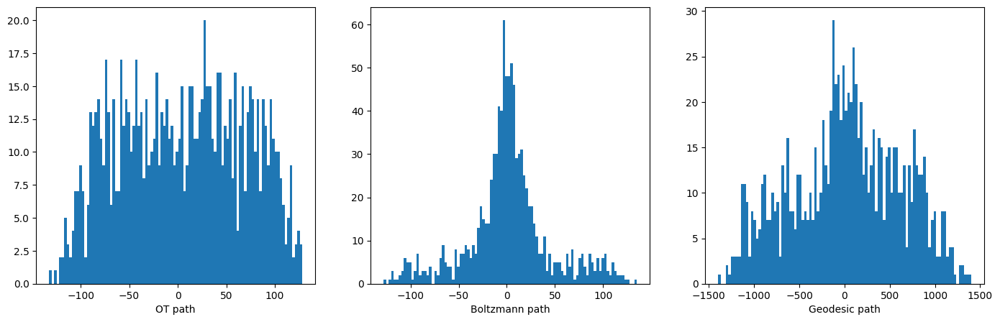

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3320 33706.199219 0.003000
    3330 21501.701172 0.001500
    3340 17516.158203 0.000375
    3350 16455.185547 0.000375
    3360 16215.167969 0.000375
[61, 250164336.0]


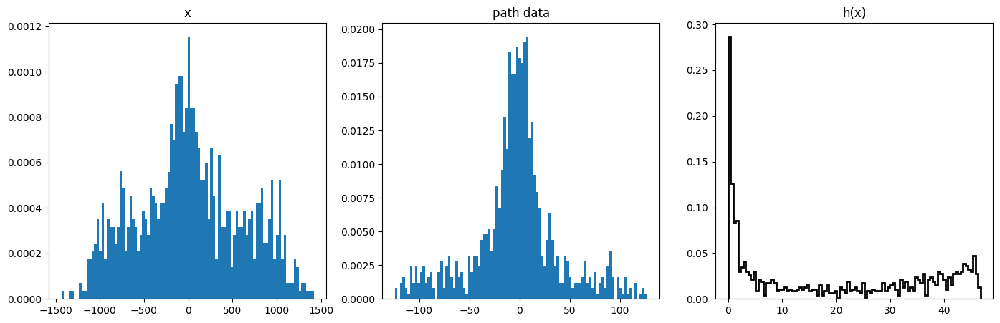

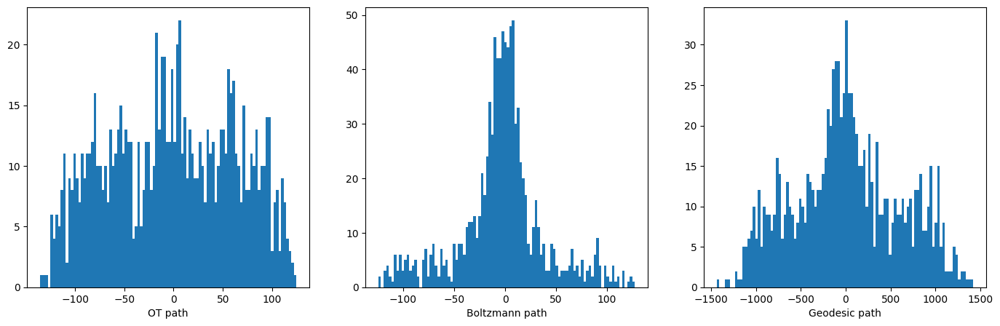

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3369 15468.385742 0.003000
    3379 13686.028320 0.001500
    3389 12772.460938 0.001500
    3399 12471.483398 0.001500
    3409 12069.543945 0.001500
[62, 99215360.0]


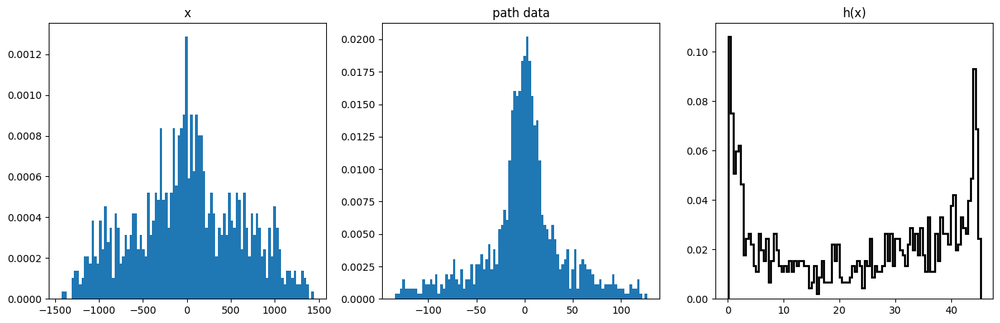

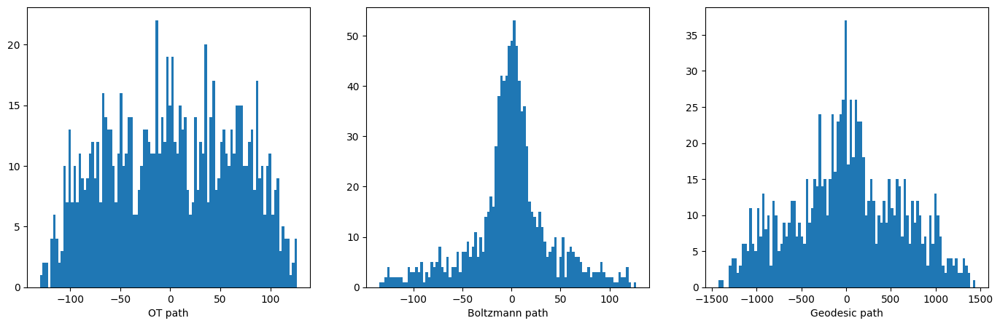

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3418 23032.761719 0.003000
    3428 20026.230469 0.003000
    3438 16776.082031 0.003000
    3448 14233.148438 0.003000
    3458 12419.391602 0.003000
[63, 292256992.0]


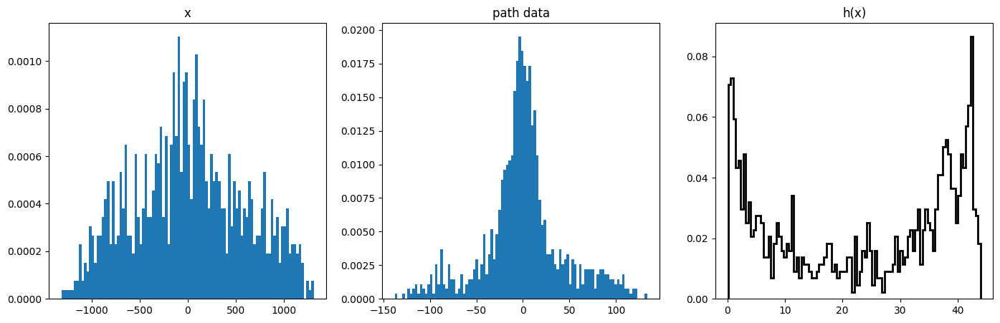

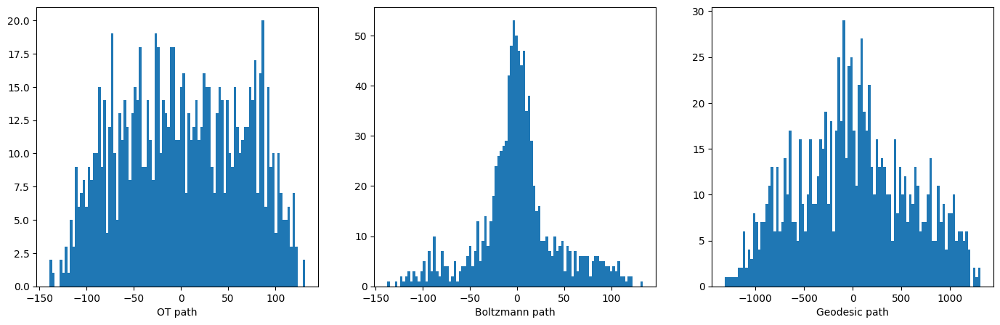

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3467 17333.714844 0.003000
    3477 14544.248047 0.003000
    3487 13042.827148 0.001500
    3497 12451.996094 0.001500
    3507 11729.212891 0.001500
[64, 311963296.0]


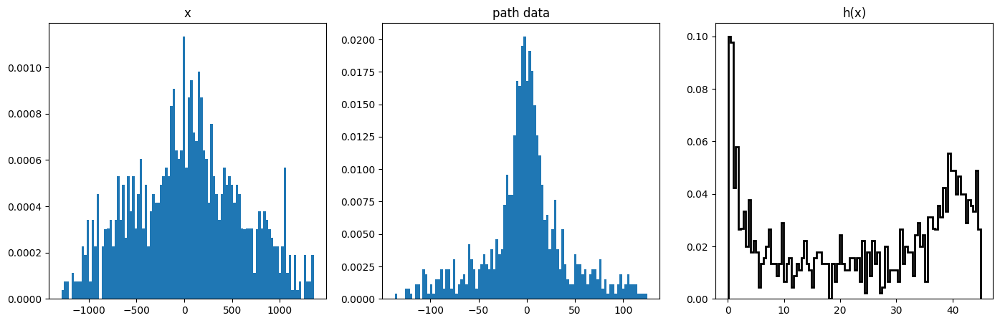

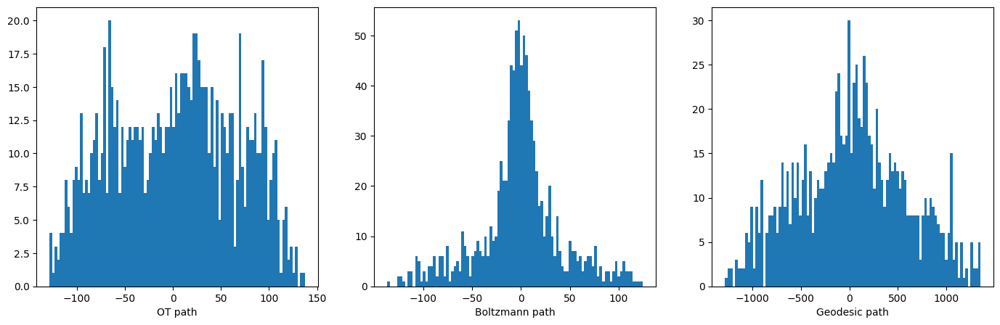

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3516 16554.759766 0.003000
    3526 15193.611328 0.003000
    3536 14001.129883 0.003000
    3546 13037.345703 0.003000
    3556 12274.445312 0.003000
[65, 344117728.0]


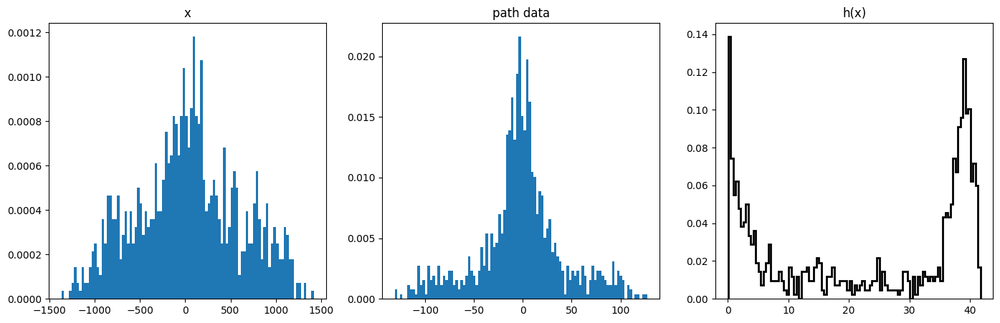

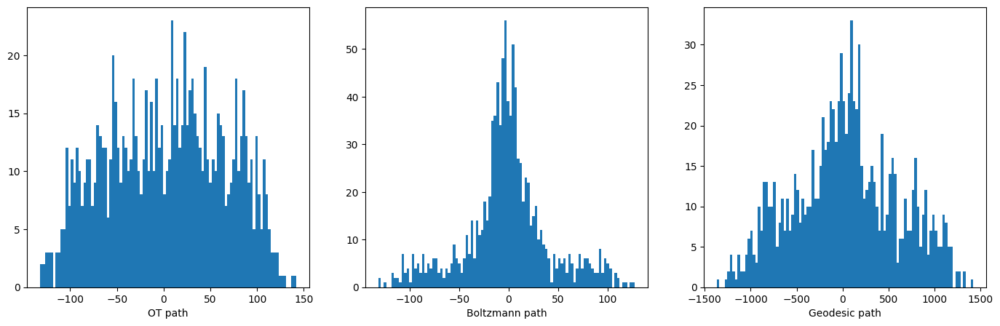

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3565 30820.535156 0.003000
    3575 19978.074219 0.001500
    3585 15520.718750 0.000750
    3595 14712.335938 0.000750
    3605 14155.284180 0.000750
[66, 216668336.0]


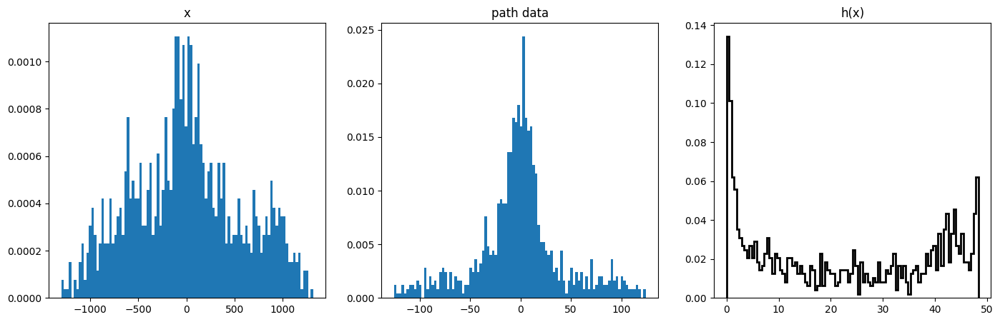

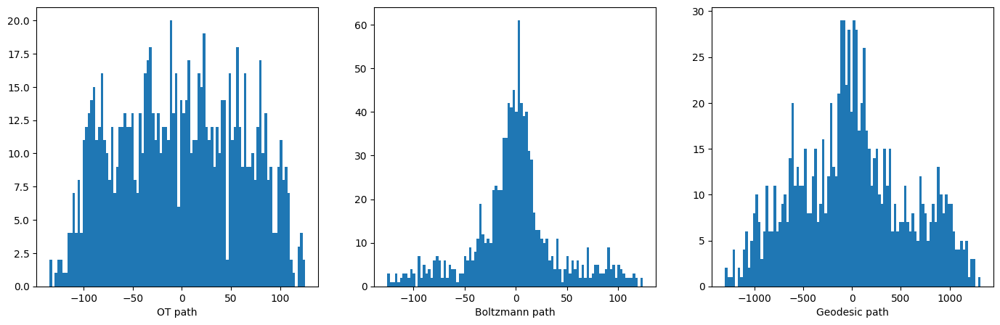

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3614 18267.421875 0.003000
    3624 15794.062500 0.003000
    3634 14332.990234 0.001500
    3644 13668.166016 0.001500
    3654 12916.687500 0.001500
[67, 235612448.0]


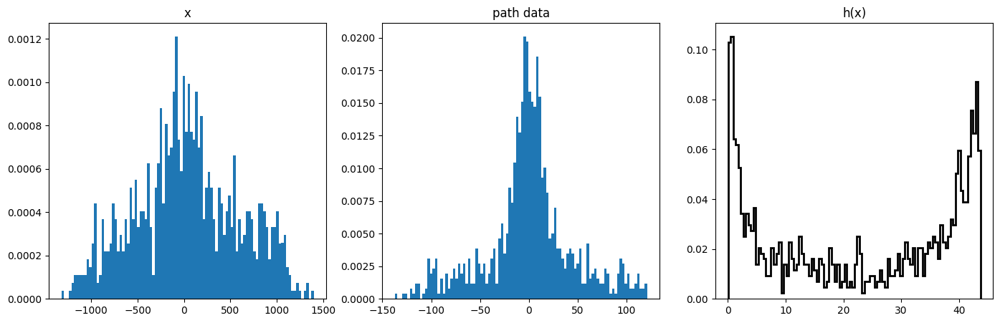

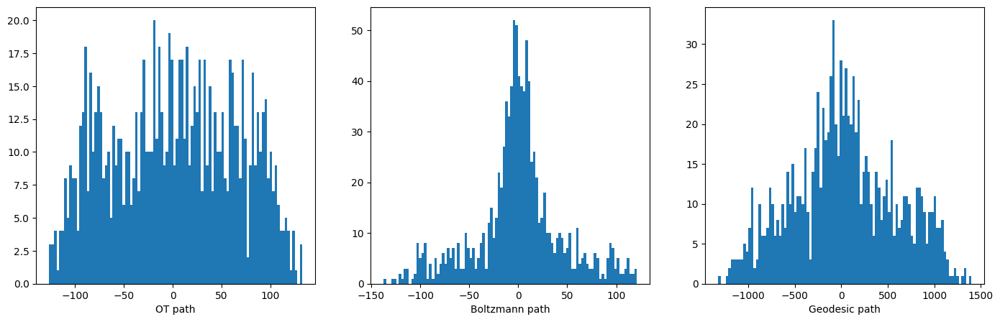

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3663 17456.453125 0.003000
    3673 15097.959961 0.001500
    3683 13584.262695 0.001500
    3693 12875.880859 0.001500
    3703 12155.107422 0.001500
[68, 327853632.0]


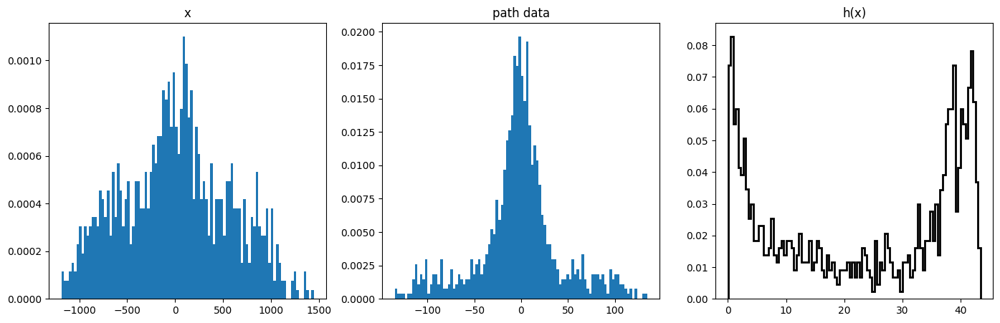

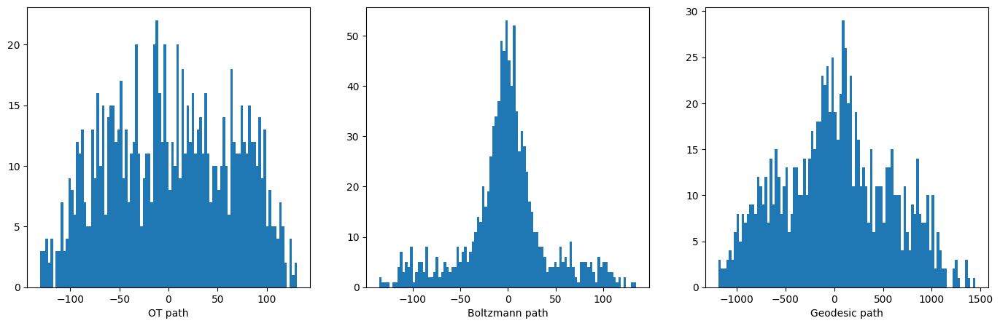

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3712 12948.434570 0.003000
    3722 12074.051758 0.003000
    3732 11134.697266 0.003000
    3742 10316.082031 0.003000
    3752 9655.423828 0.003000
[69, 267207968.0]


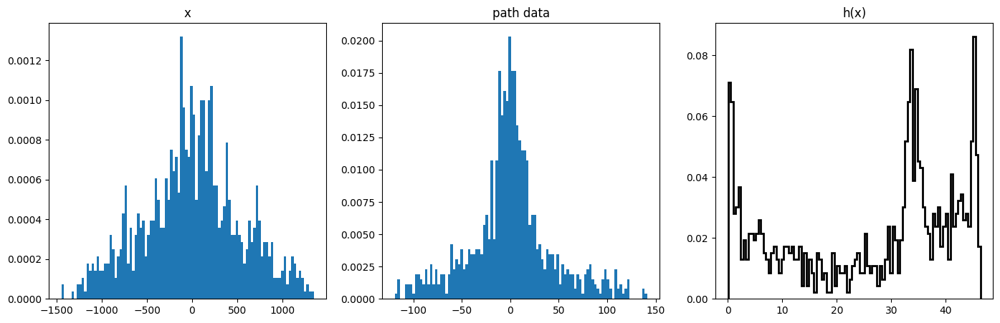

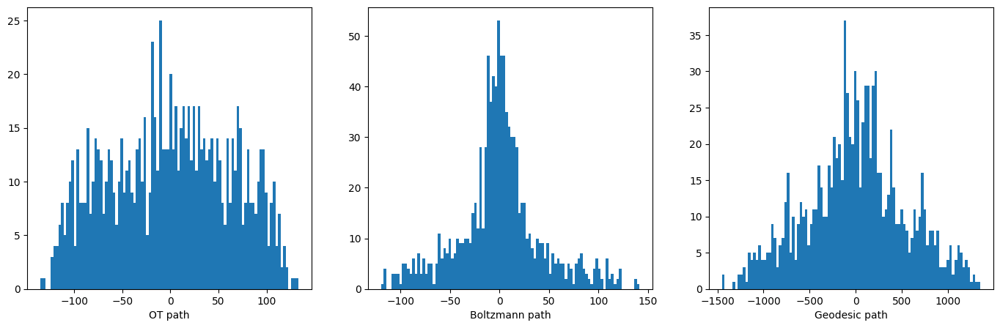

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3761 17588.128906 0.003000
    3771 14566.075195 0.003000
    3781 12912.287109 0.001500
    3791 12281.851562 0.001500
    3801 11514.788086 0.001500
[70, 181934640.0]


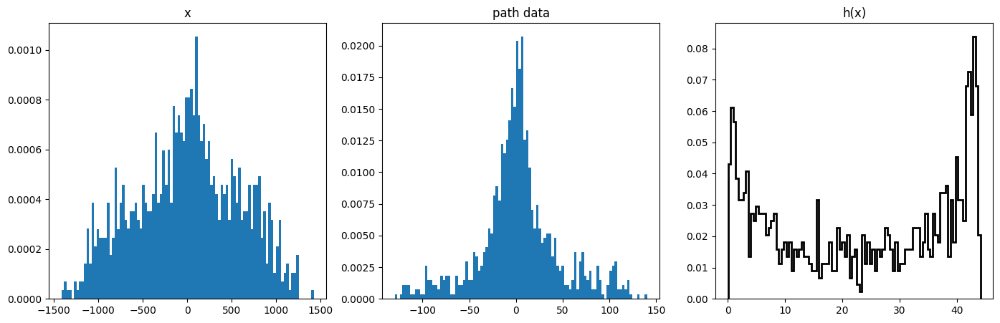

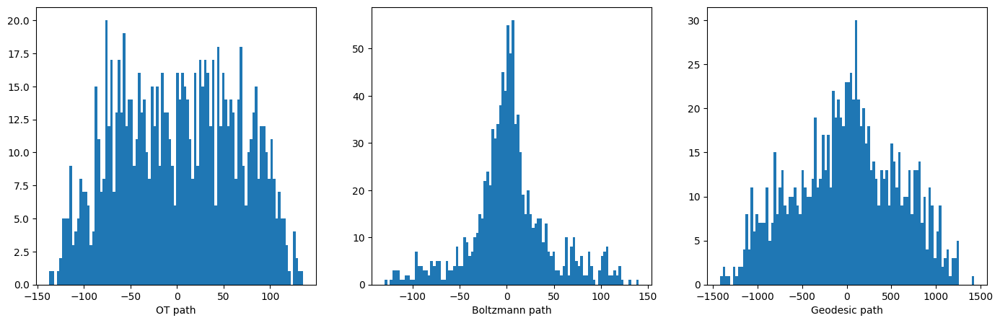

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3810 15323.058594 0.003000
    3820 13134.562500 0.001500
    3830 12106.489258 0.000750
    3840 11936.020508 0.000750
    3850 11743.860352 0.000750
[71, 250536048.0]


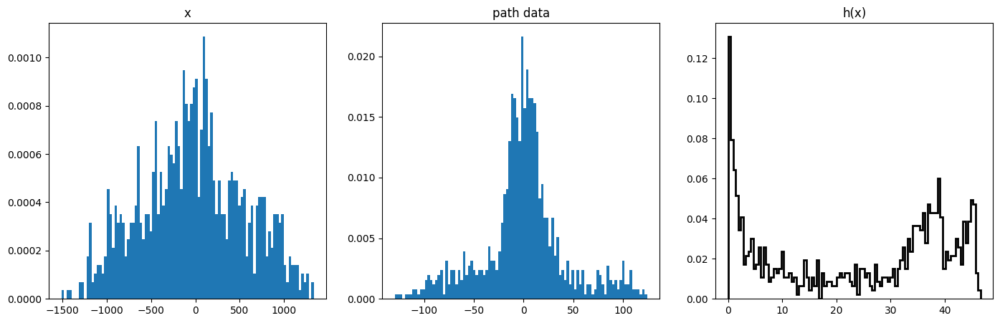

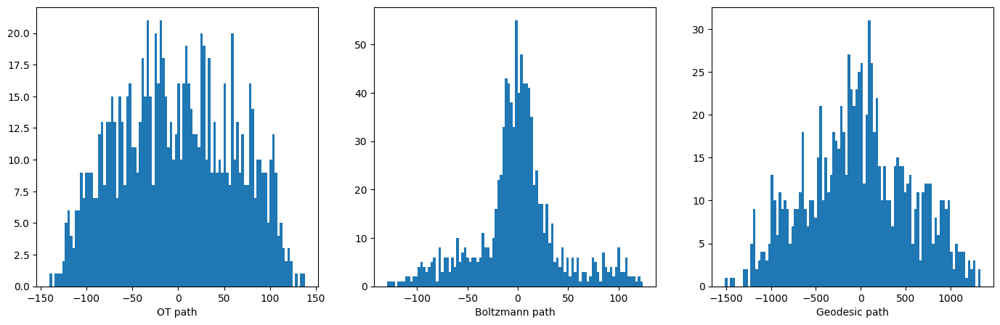

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3859 31337.152344 0.003000
    3869 23211.056641 0.001500
    3879 19376.138672 0.000750
    3889 18846.738281 0.000750
    3899 17985.628906 0.000750
[72, 267859728.0]


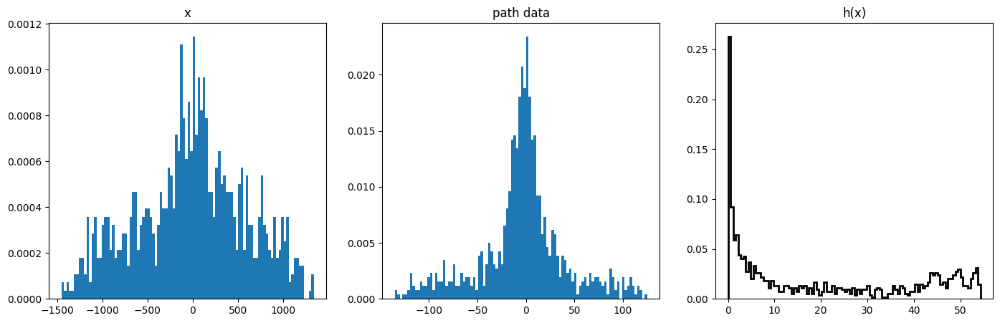

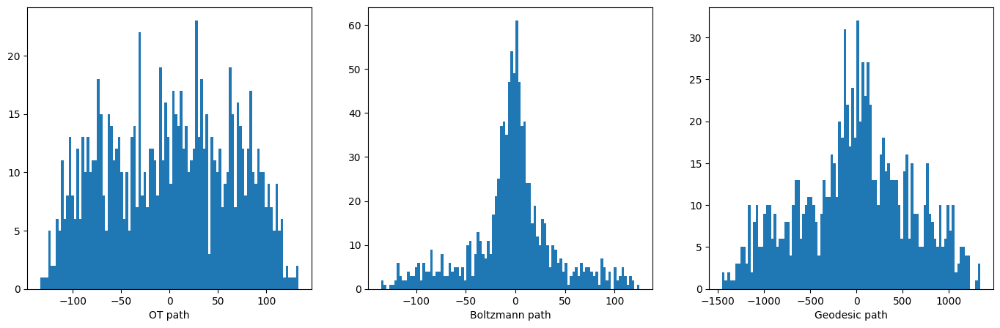

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3908 16616.019531 0.003000
    3918 15076.000977 0.003000
    3928 13400.254883 0.003000
    3938 12003.434570 0.003000
    3948 10942.280273 0.003000
[73, 309132608.0]


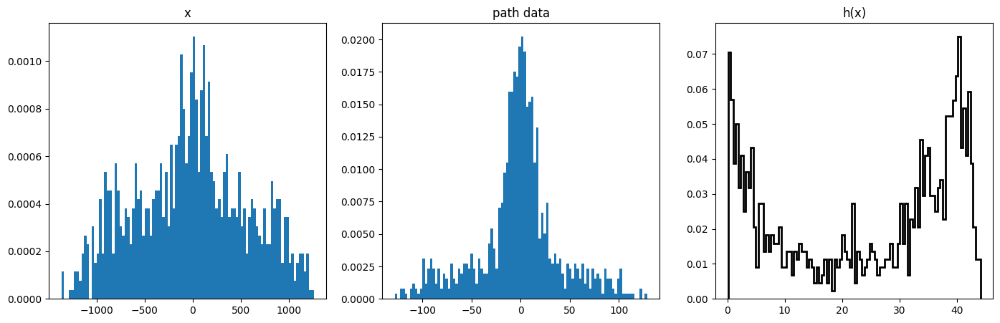

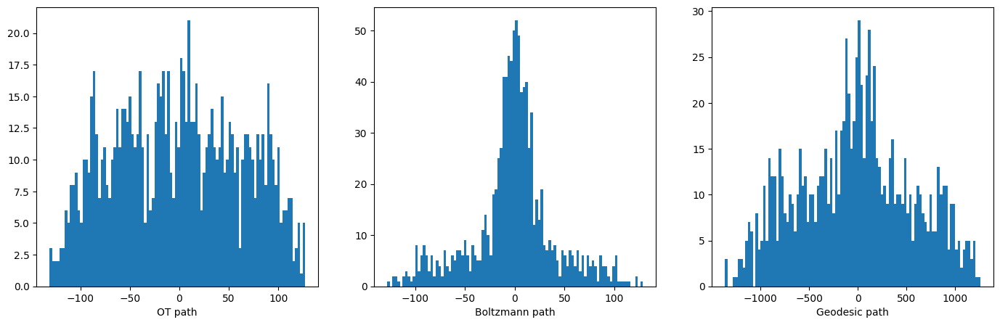

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    3957 27768.546875 0.003000
    3967 21258.189453 0.001500
    3977 17942.566406 0.000750
    3987 17297.859375 0.000750
    3997 16444.171875 0.000750
[74, 213411824.0]


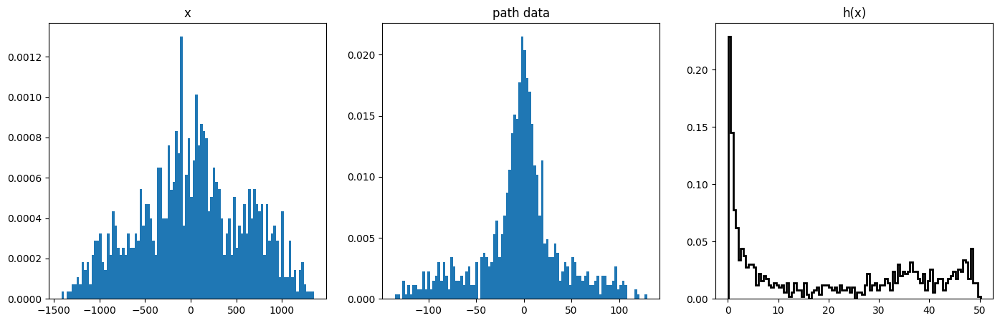

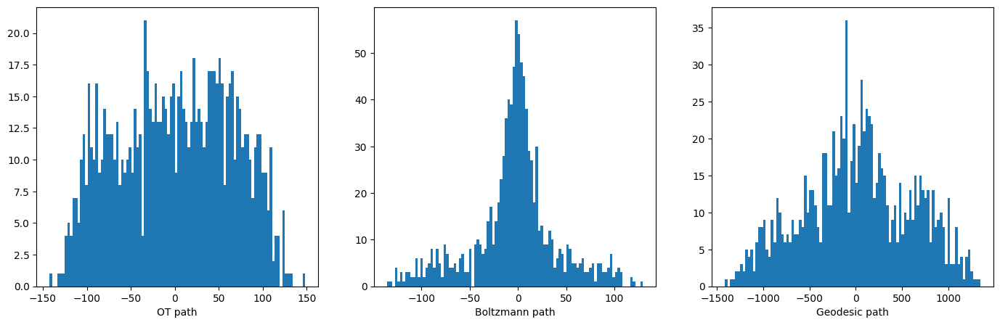

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4006 28379.257812 0.003000
    4016 19705.820312 0.001500
    4026 15191.024414 0.000750
    4036 14935.990234 0.000750
    4046 14178.848633 0.000750
[75, 295899520.0]


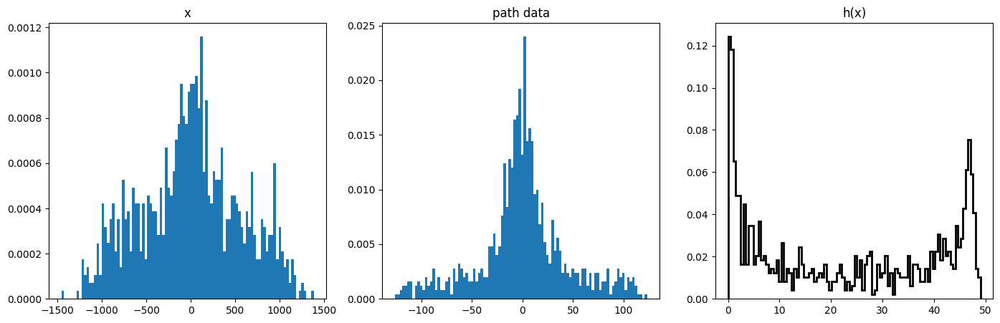

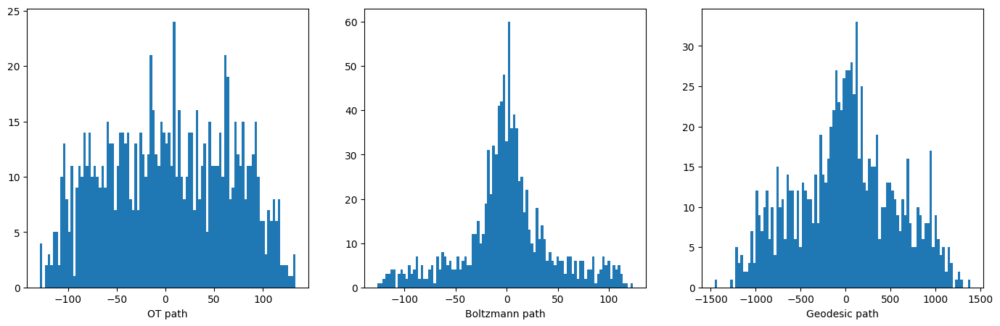

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4055 14157.794922 0.003000
    4065 13263.870117 0.001500
    4075 12639.694336 0.001500
    4085 12279.806641 0.001500
    4095 11907.877930 0.001500
[76, 299716384.0]


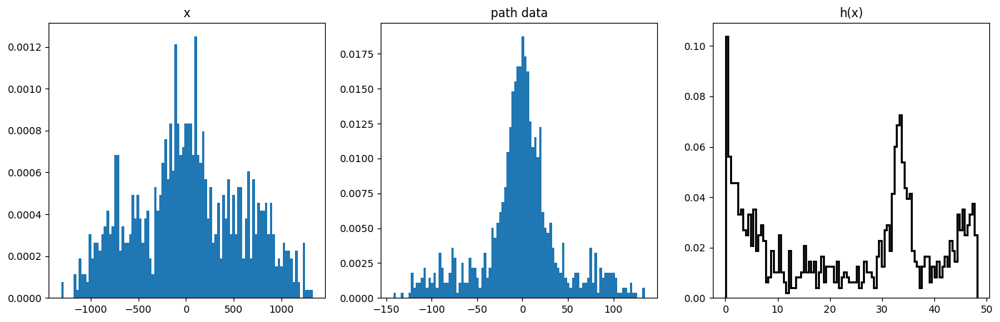

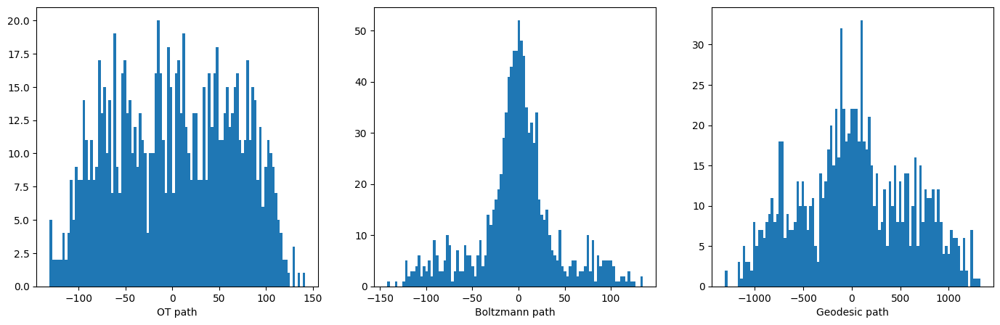

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4104 18823.099609 0.003000
    4114 16323.485352 0.003000
    4124 13897.445312 0.003000
    4134 11769.430664 0.003000
    4144 9225.445312 0.003000
[77, 137753136.0]


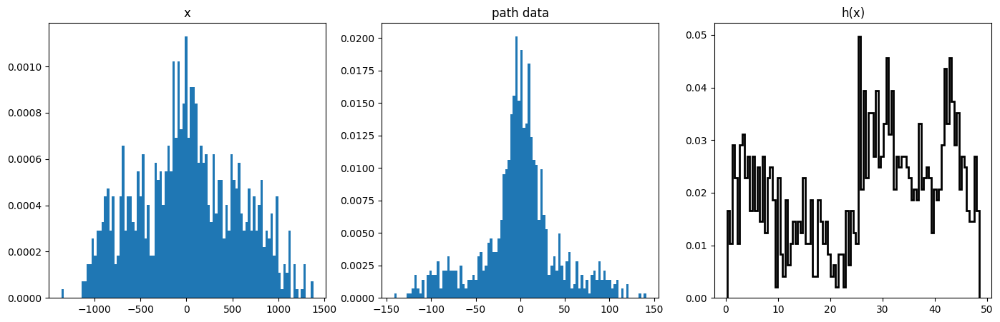

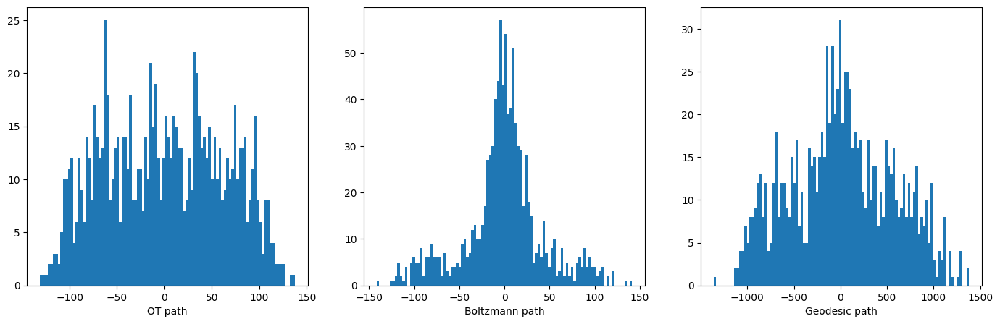

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4153 36218.453125 0.003000
    4163 16699.156250 0.003000
    4173 14588.525391 0.003000
    4183 12785.243164 0.003000
    4193 11427.746094 0.003000
[78, 368459648.0]


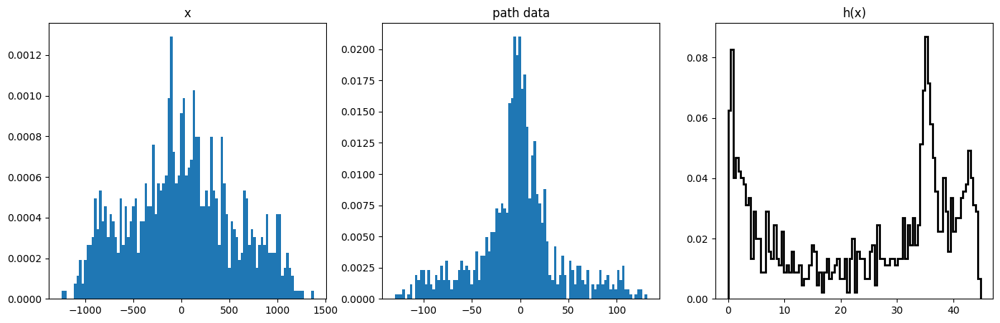

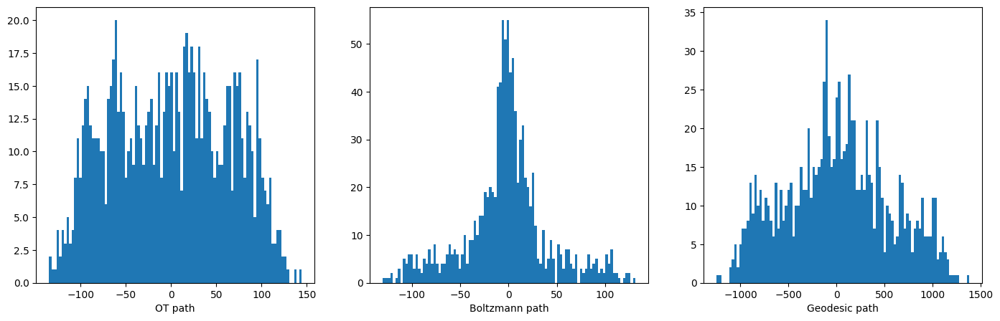

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4202 14029.936523 0.003000
    4212 12481.641602 0.003000
    4222 10985.386719 0.003000
    4232 9824.498047 0.003000
    4242 8998.454102 0.003000
[79, 238266512.0]


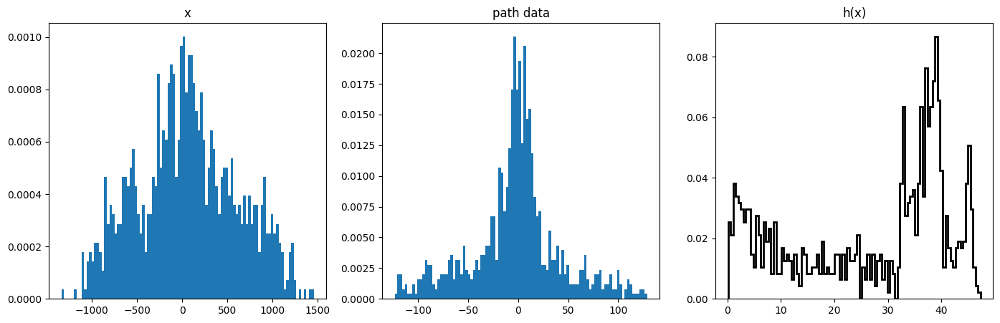

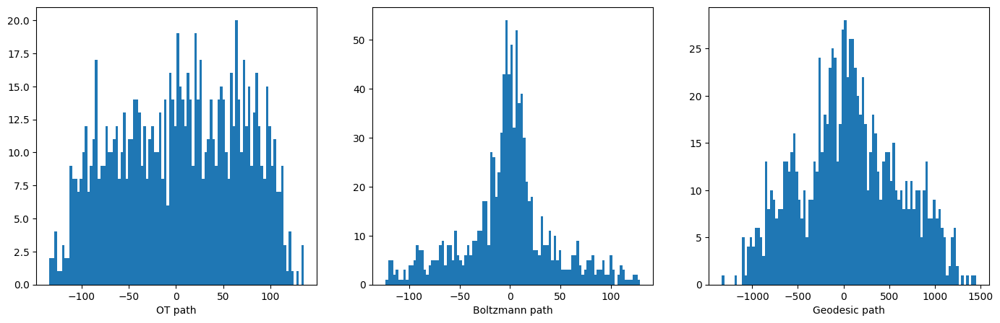

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4251 16520.787109 0.003000
    4261 14263.398438 0.001500
    4271 12817.964844 0.001500
    4281 12179.037109 0.001500
    4291 11559.106445 0.001500
[80, 235931408.0]


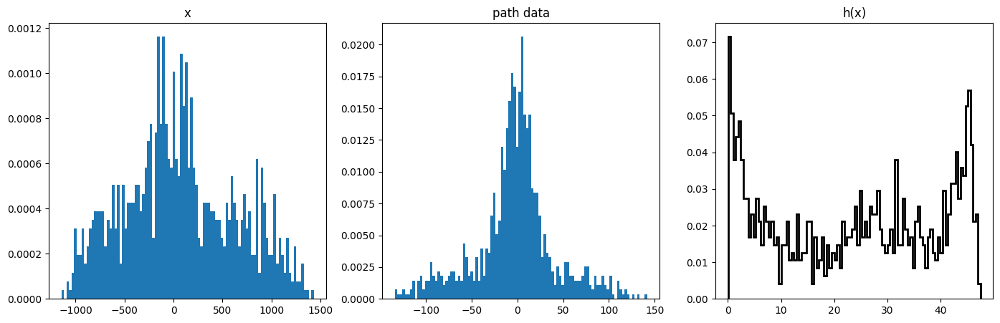

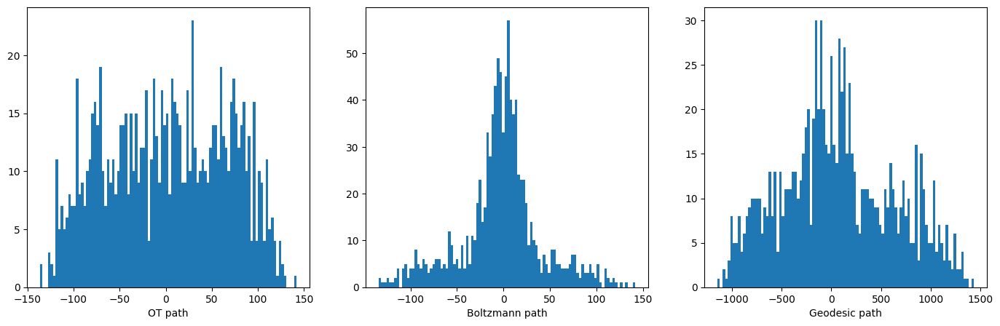

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4300 22971.353516 0.003000
    4310 18941.822266 0.001500
    4320 16462.166016 0.001500
    4330 15251.282227 0.001500
    4340 14272.523438 0.001500
[81, 201129344.0]


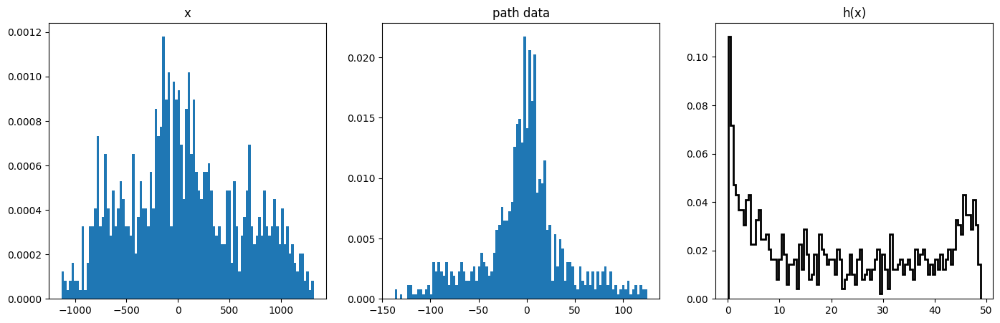

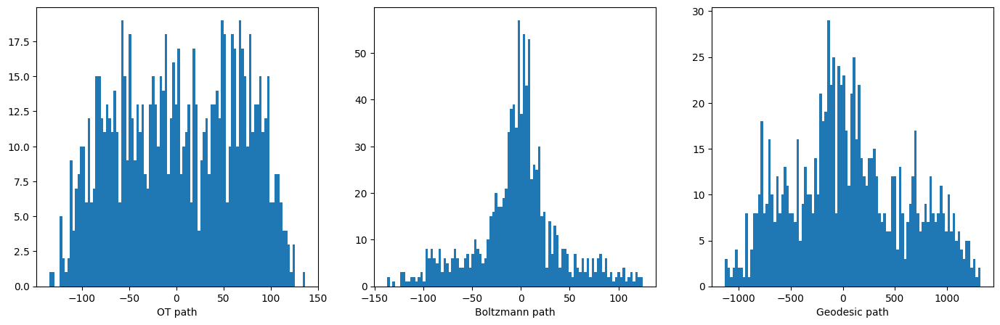

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4349 13580.289062 0.003000
    4359 12329.460938 0.003000
    4369 10947.077148 0.003000
    4379 9833.917969 0.003000
    4389 9037.842773 0.003000
[82, 308806432.0]


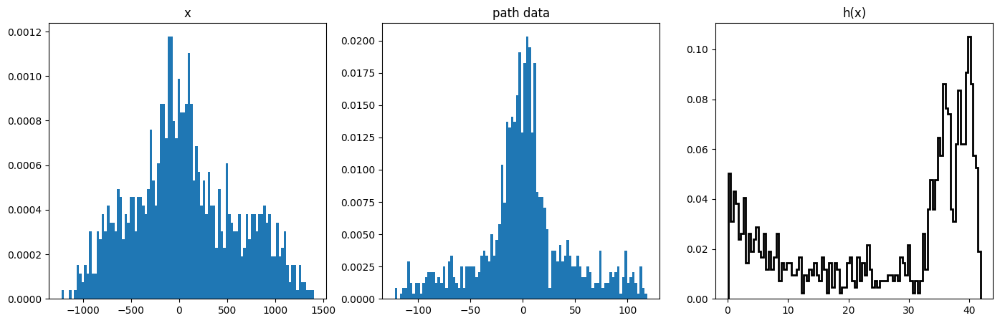

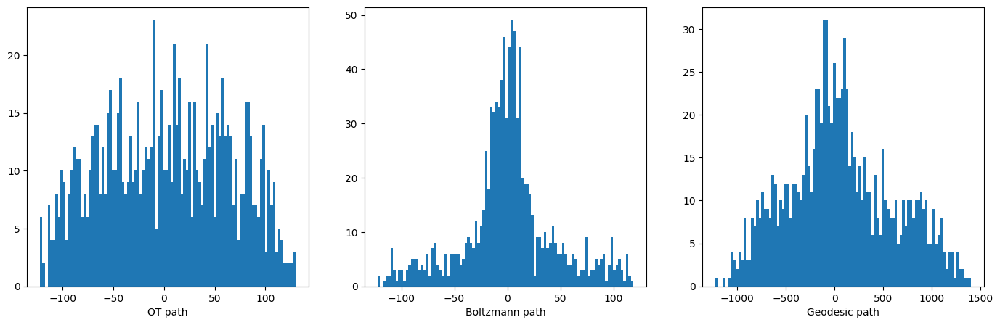

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4398 16619.707031 0.003000
    4408 14625.600586 0.003000
    4418 12504.218750 0.003000
    4428 10792.790039 0.003000
    4438 9544.651367 0.003000
[83, 231559248.0]


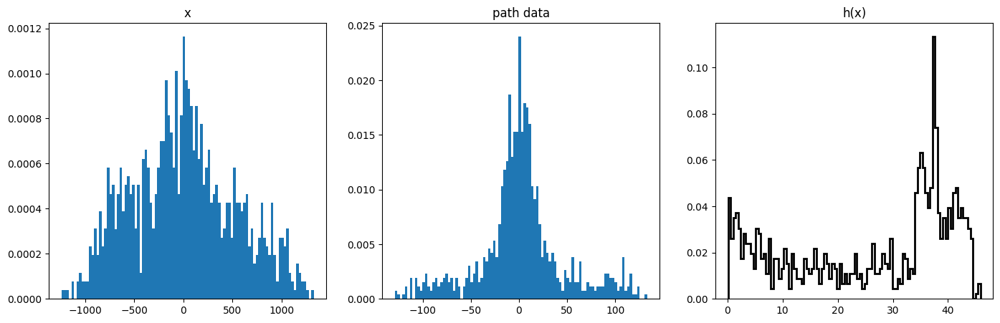

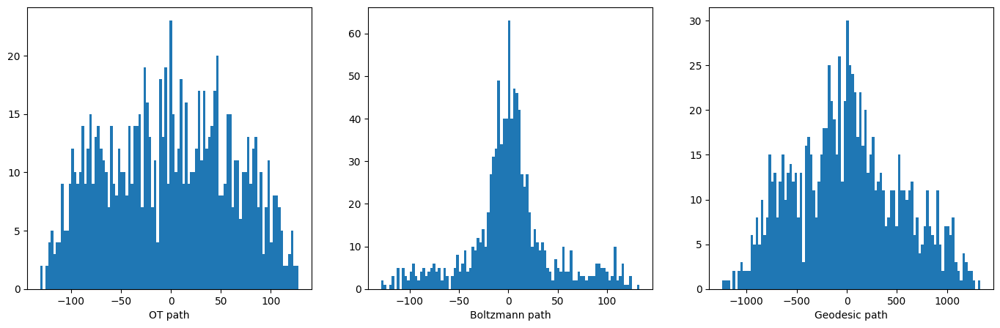

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4447 18088.277344 0.003000
    4457 13101.625000 0.001500
    4467 11646.565430 0.000750
    4477 10801.362305 0.000750
    4487 10566.206055 0.000750
[84, 179519520.0]


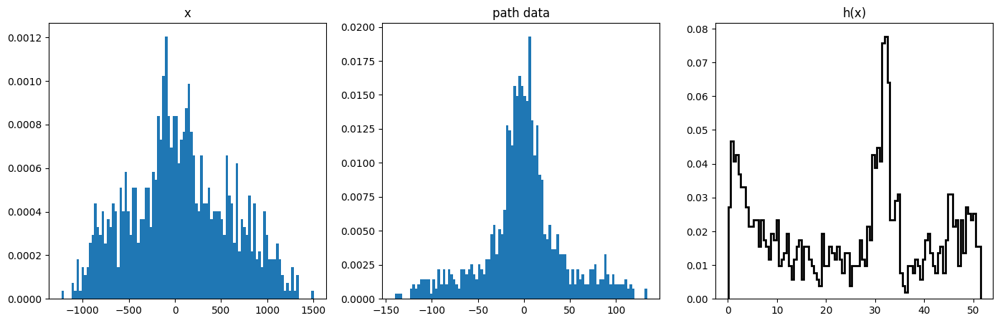

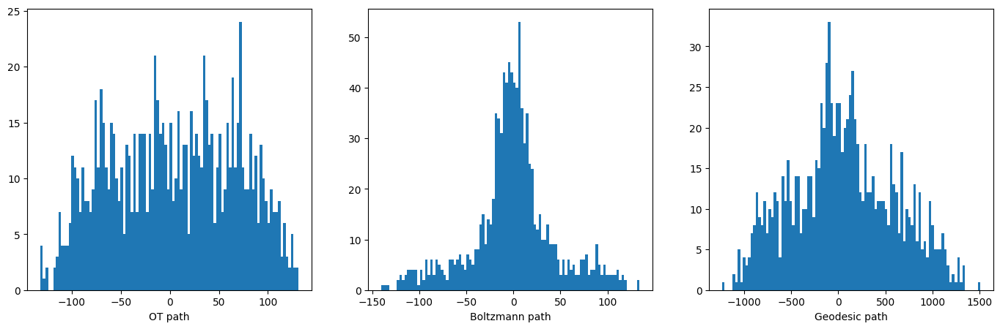

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4496 15701.580078 0.003000
    4506 14512.963867 0.003000
    4516 12945.595703 0.003000
    4526 11635.143555 0.003000
    4536 10627.101562 0.003000
[85, 337092416.0]


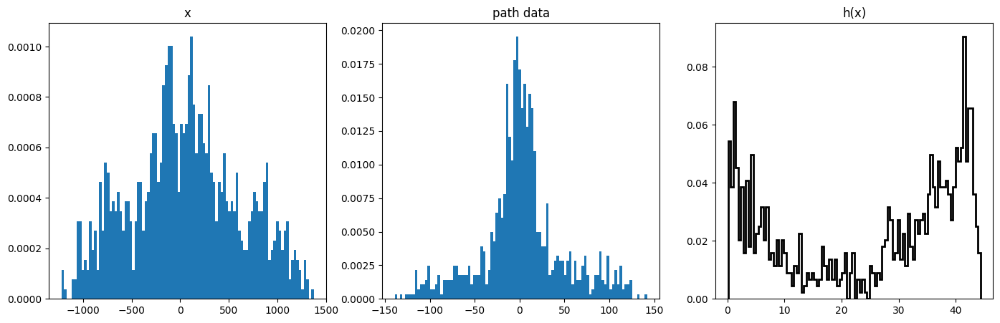

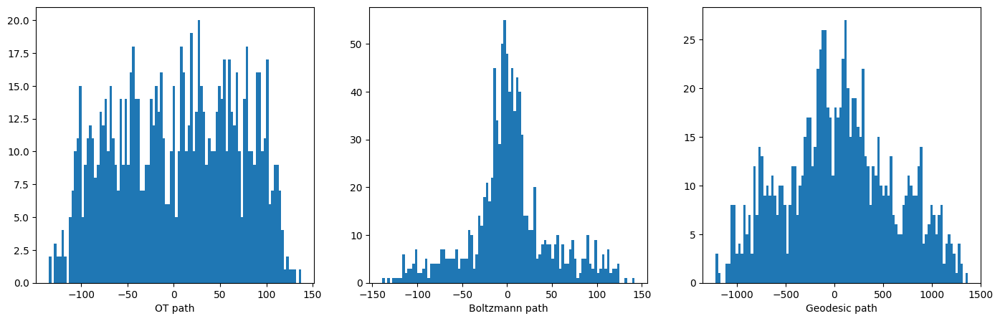

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4545 19167.851562 0.003000
    4555 13374.105469 0.001500
    4565 12453.843750 0.001500
    4575 11396.243164 0.001500
    4585 10387.764648 0.001500
[86, 327999232.0]


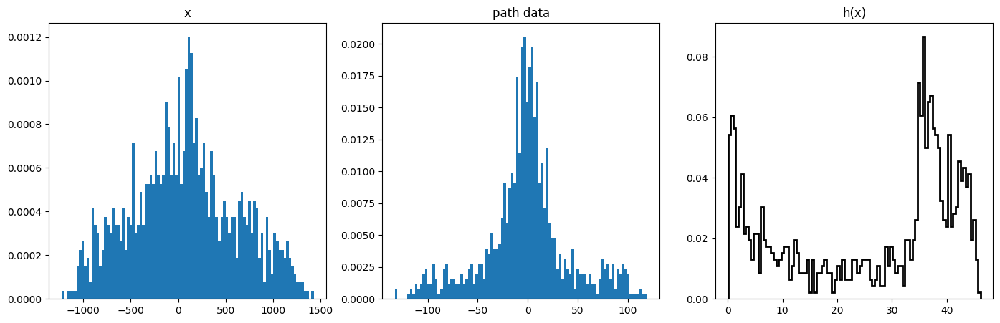

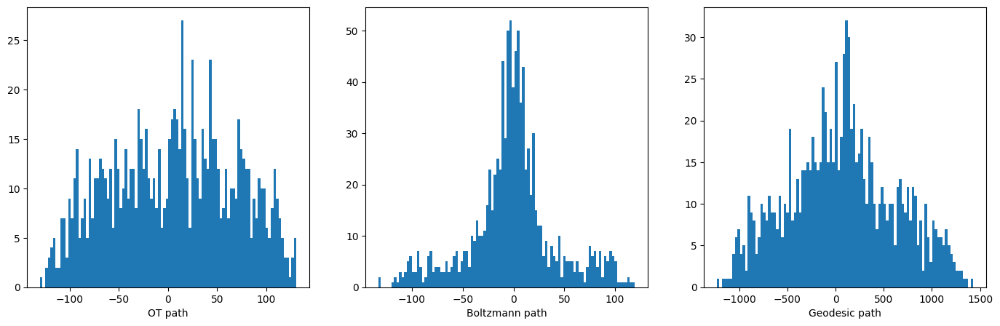

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4594 26365.365234 0.003000
    4604 13049.820312 0.001500
    4614 12558.130859 0.000750
    4624 11685.389648 0.000750
    4634 11142.815430 0.000750
[87, 511669728.0]


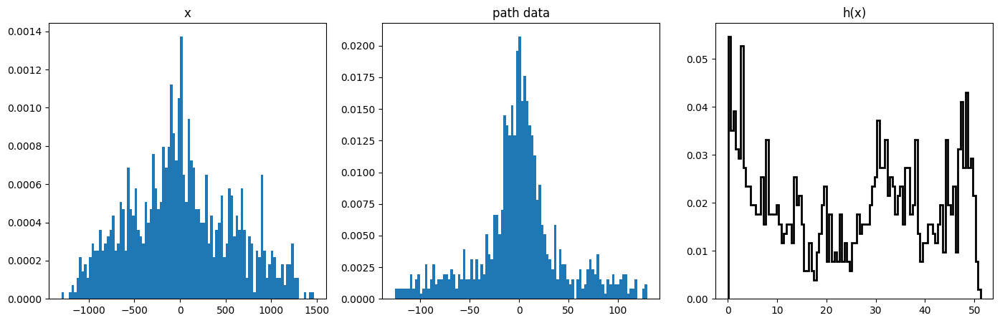

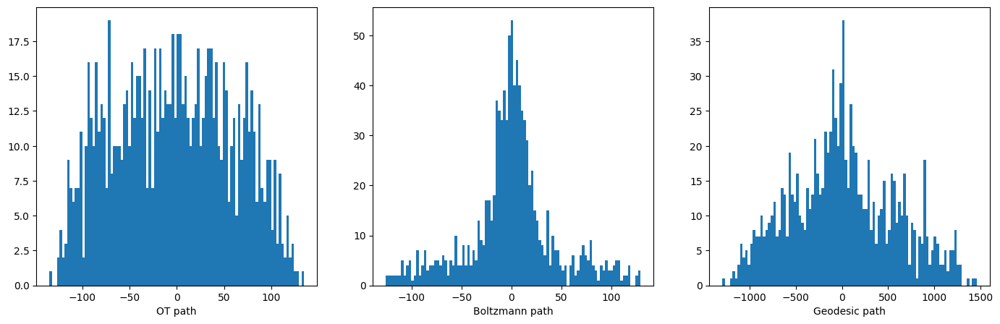

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4643 39368.089844 0.003000
    4653 20515.109375 0.001500
    4663 15146.754883 0.000750
    4673 15122.258789 0.000094
[88, 167793952.0]


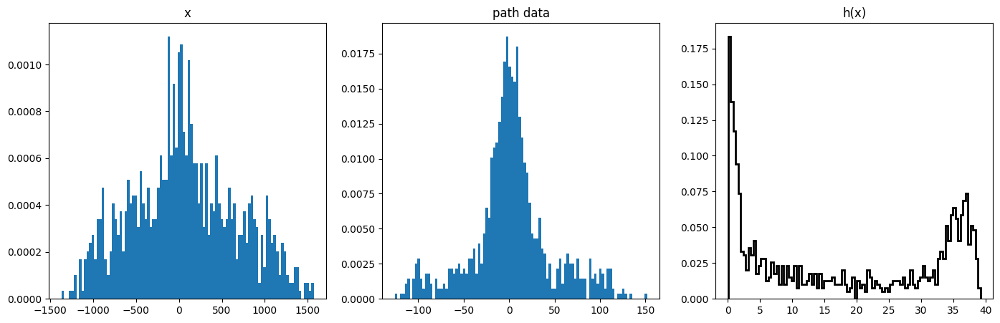

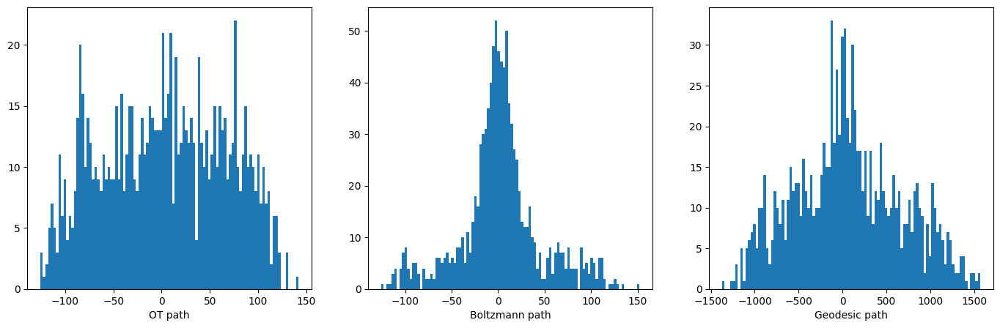

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4673 19019.457031 0.003000
    4683 17227.613281 0.003000
    4693 15044.823242 0.003000
    4703 13213.611328 0.003000
    4713 11839.013672 0.003000
[89, 236602672.0]


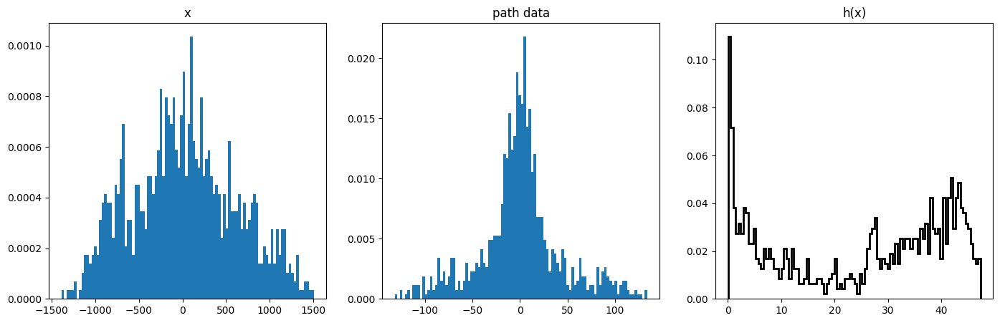

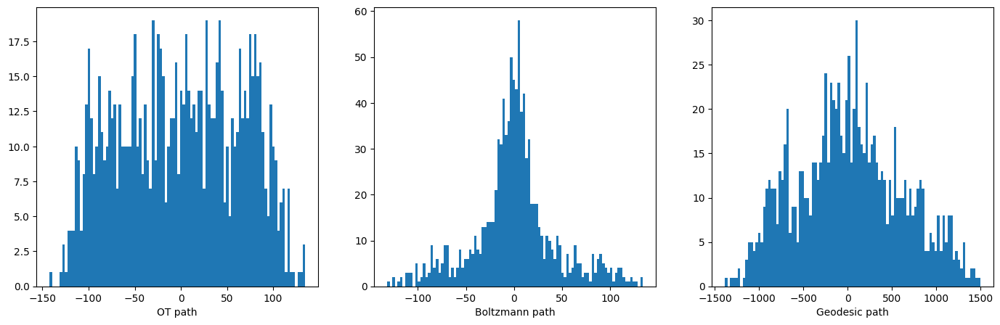

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4722 21672.554688 0.003000
    4732 14186.294922 0.001500
    4742 13357.652344 0.000750
    4752 12715.764648 0.000750
    4762 12438.434570 0.000750
[90, 207726224.0]


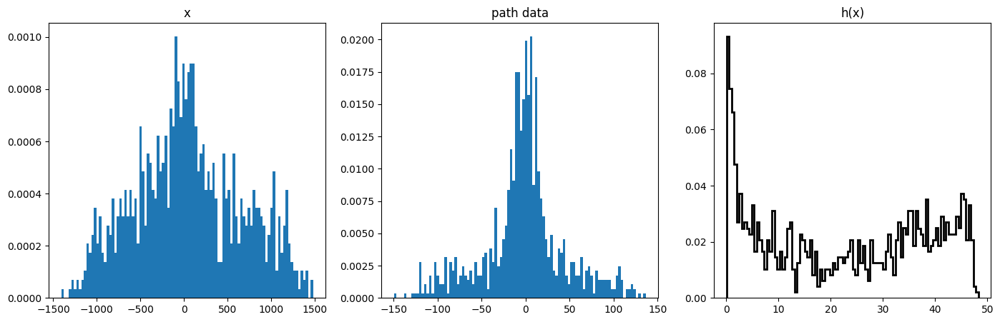

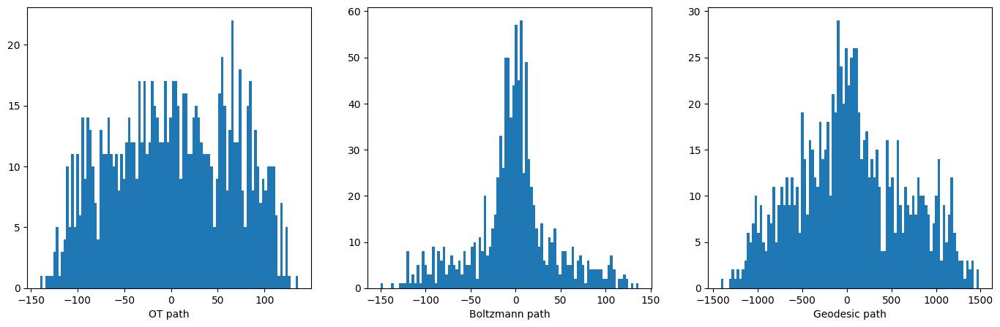

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4771 25529.437500 0.003000
    4781 15955.531250 0.001500
    4791 11929.848633 0.000750
    4801 11963.287109 0.000188
[91, 364804672.0]


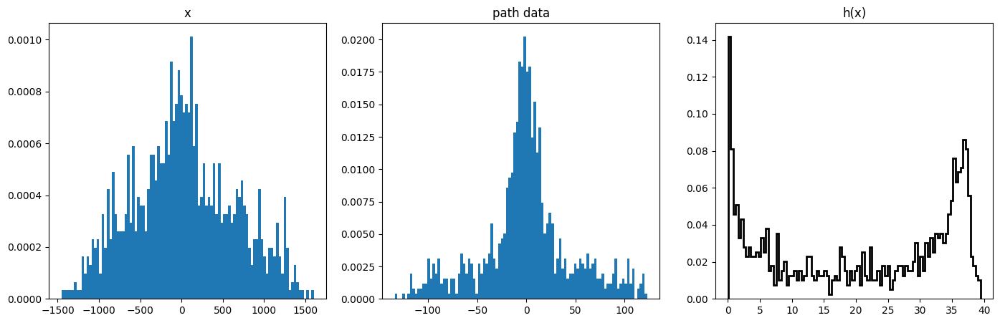

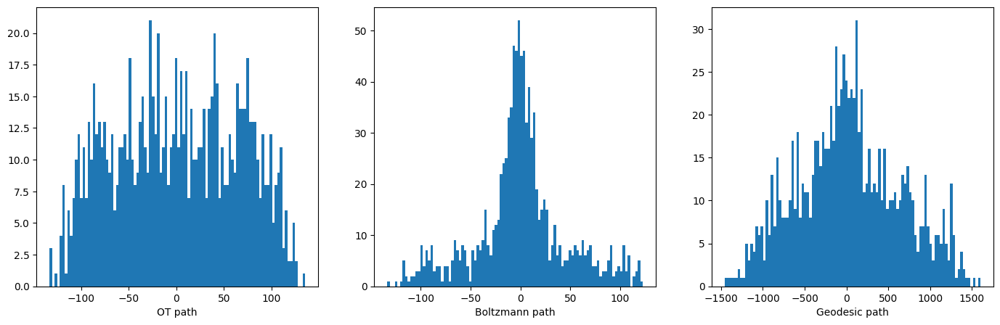

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4802 31315.363281 0.003000
    4812 20936.941406 0.001500
    4822 15830.988281 0.000750
    4832 15446.109375 0.000375
    4842 15018.576172 0.000375
[92, 184424144.0]


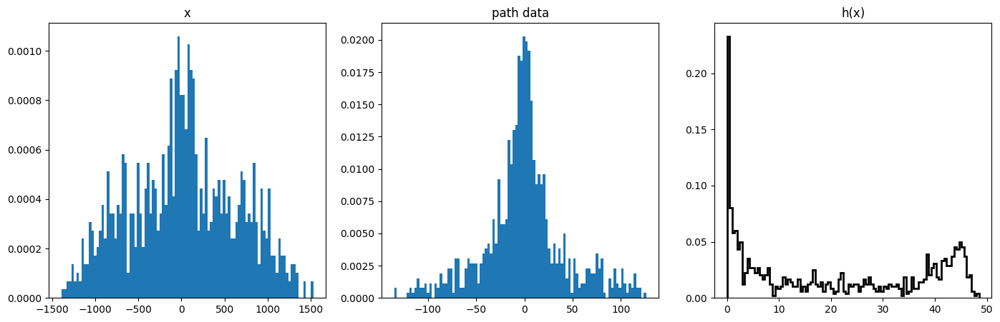

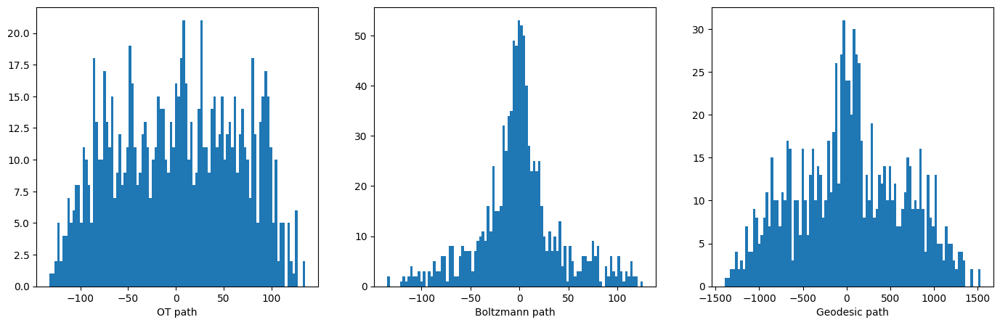

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4851 21372.064453 0.003000
    4861 17206.000000 0.001500
    4871 14888.913086 0.001500
    4881 14321.537109 0.000750
    4891 14012.530273 0.000750
[93, 343570880.0]


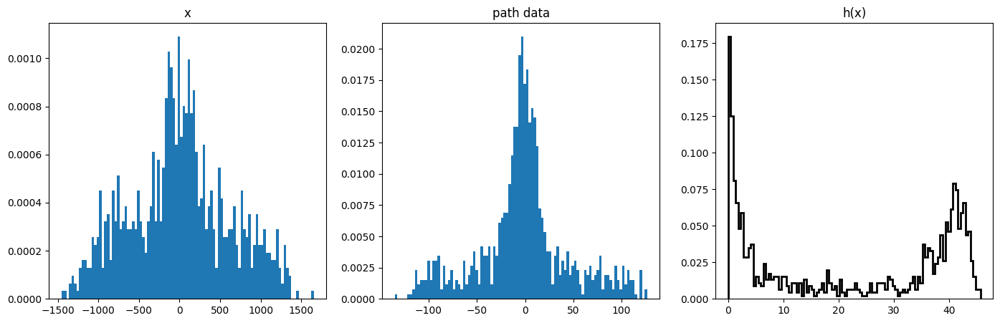

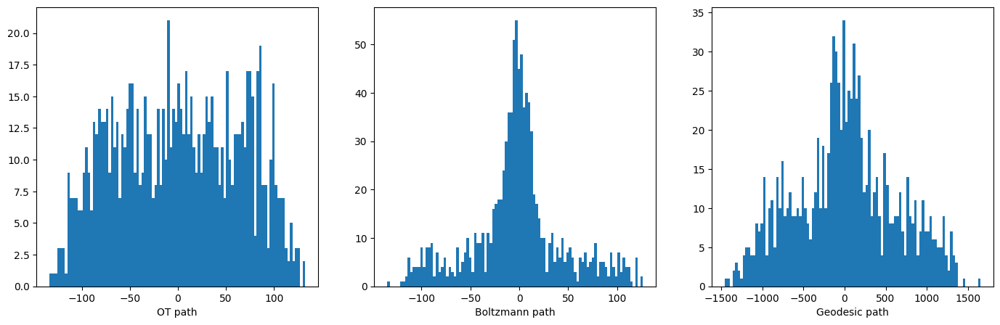

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4900 30043.281250 0.003000
    4910 23185.625000 0.001500
    4920 19419.419922 0.000750
    4930 18812.515625 0.000750
    4940 17783.855469 0.000750
[94, 228943504.0]


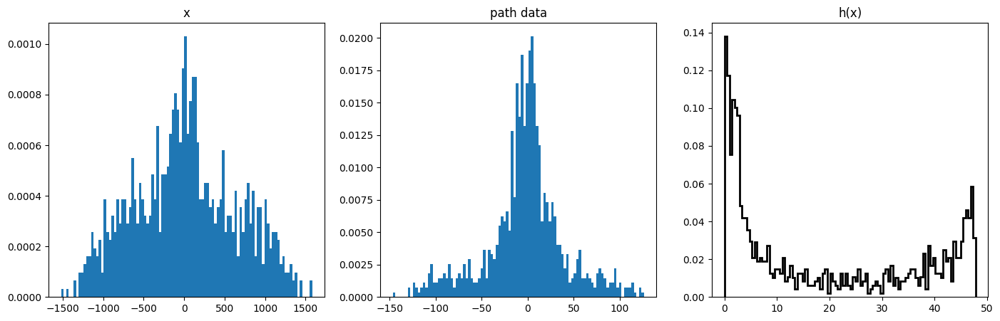

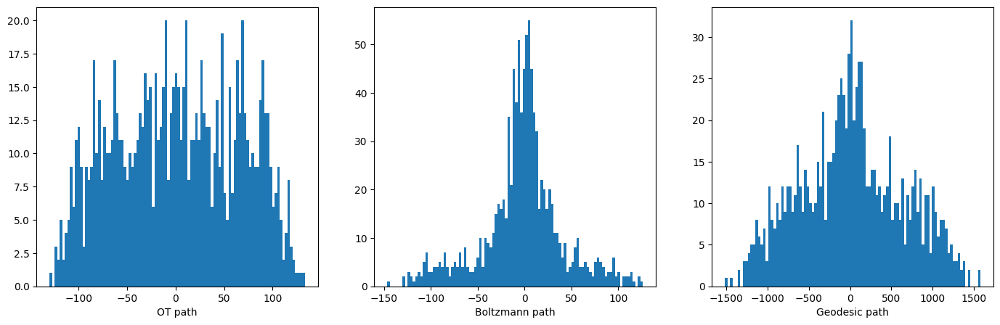

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4949 36694.542969 0.003000
    4959 21464.496094 0.001500
    4969 14244.878906 0.000750
    4979 14363.174805 0.000188
[95, 191772096.0]


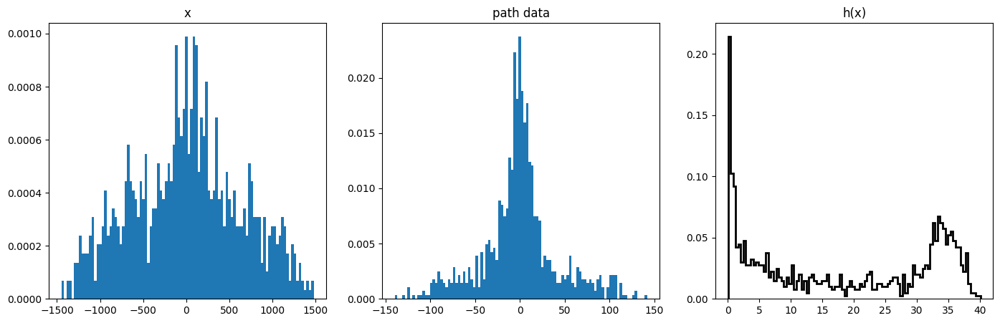

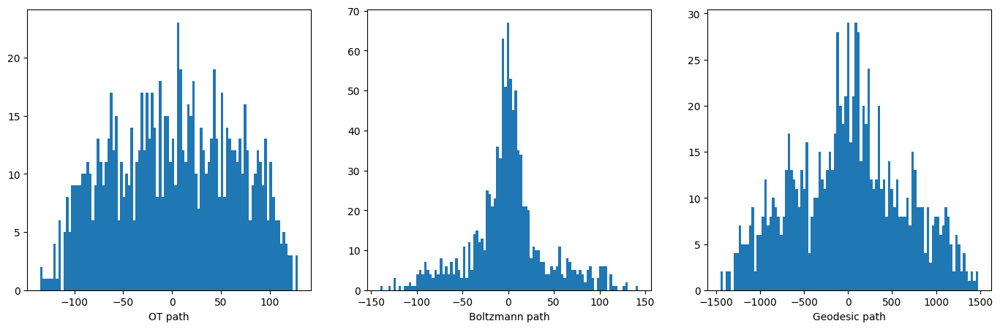

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    4982 20328.654297 0.003000
    4992 16406.070312 0.001500
    5002 14225.345703 0.000750
    5012 14204.635742 0.000188
    5022 14118.452148 0.000188
[96, 393764032.0]


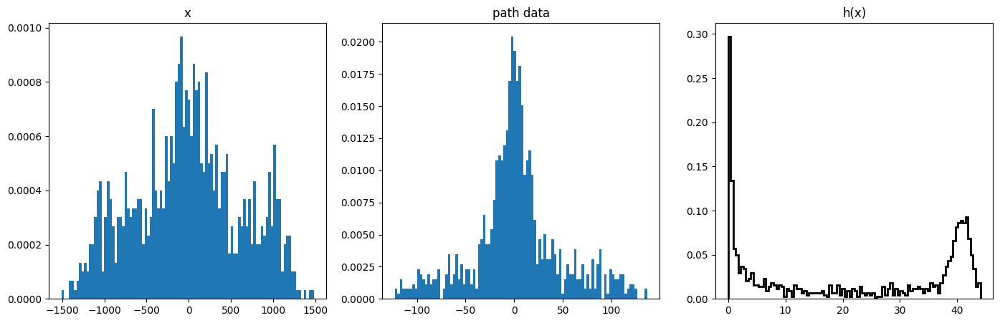

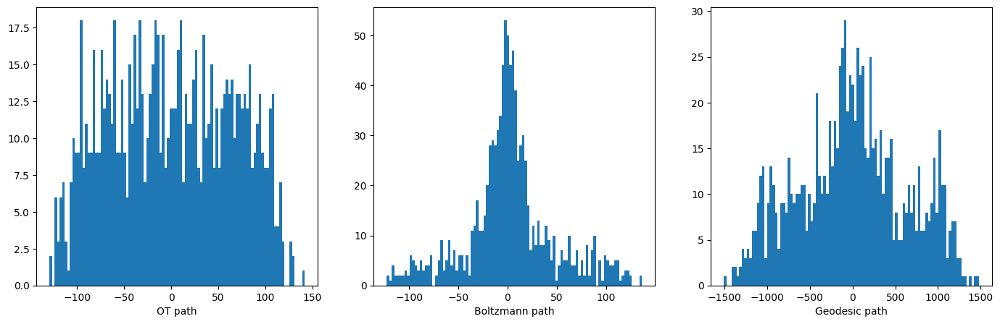

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5031 34353.289062 0.003000
    5041 23284.310547 0.001500
    5051 17522.251953 0.000750
    5061 17193.359375 0.000750
    5071 16171.644531 0.000750
[97, 261478928.0]


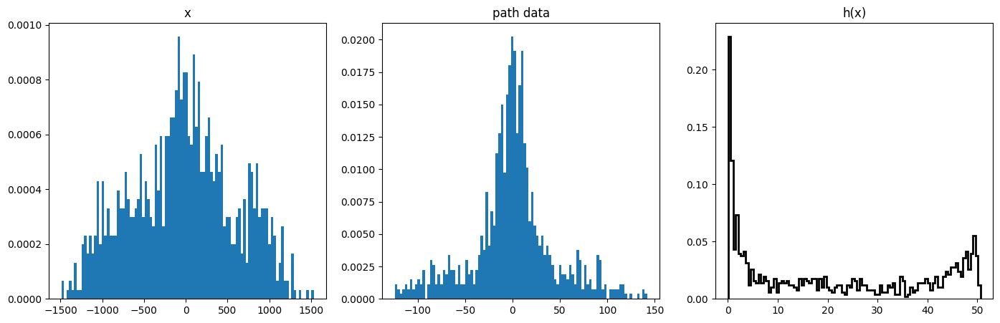

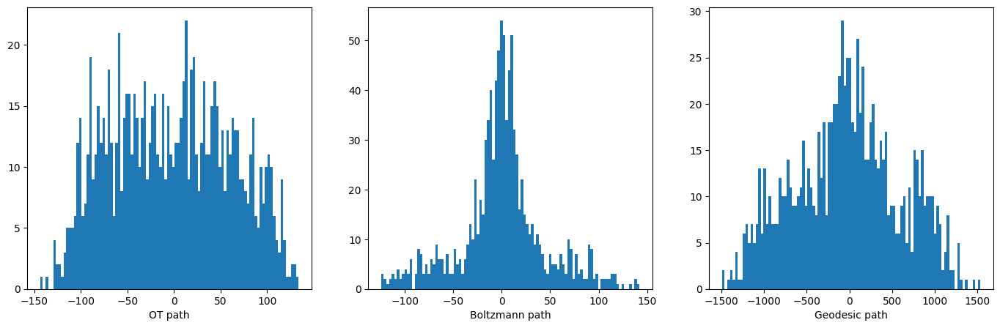

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5080 16377.167969 0.003000
    5090 13884.763672 0.001500
    5100 12529.328125 0.001500
    5110 11786.464844 0.001500
    5120 11279.894531 0.001500
[98, 351254464.0]


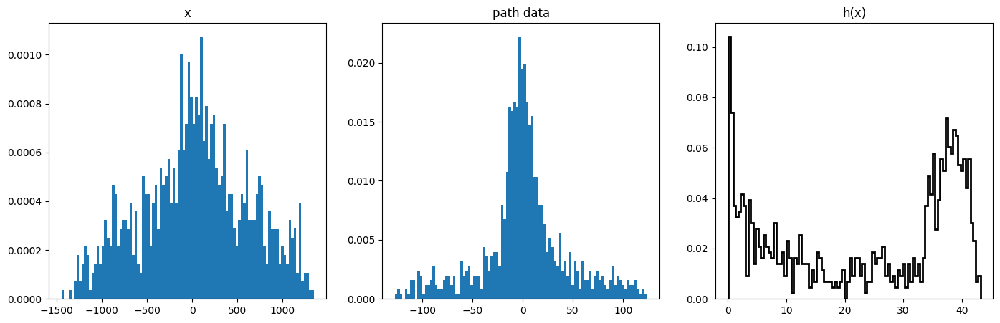

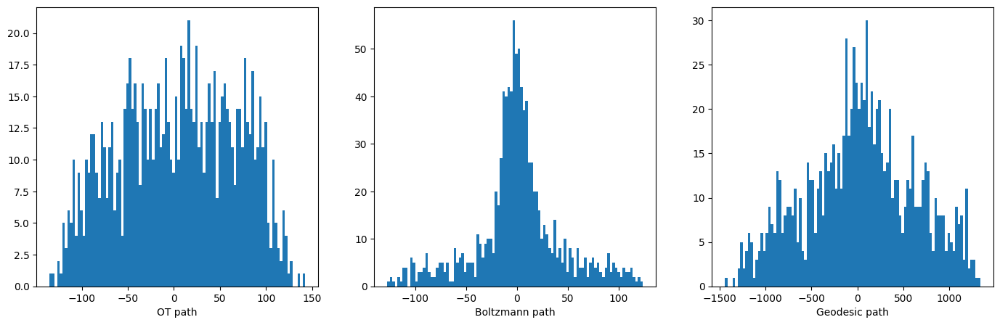

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5129 28488.246094 0.003000
    5139 20517.435547 0.003000
    5149 15860.351562 0.003000
    5159 12890.523438 0.003000
    5169 10972.460938 0.003000
[99, 210332544.0]


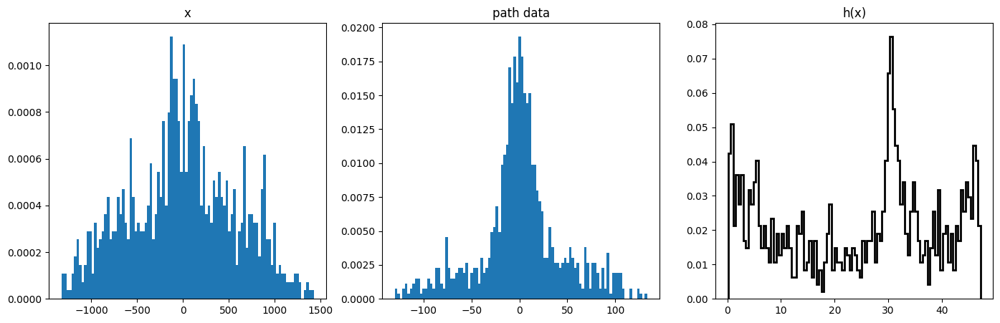

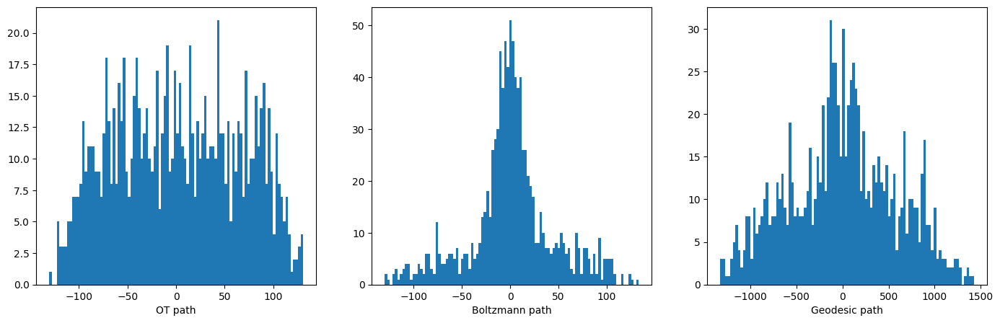

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5178 20257.810547 0.003000
    5188 13335.091797 0.001500
    5198 9808.347656 0.000375
    5208 9624.000000 0.000375
    5218 9602.209961 0.000188
[100, 200221248.0]


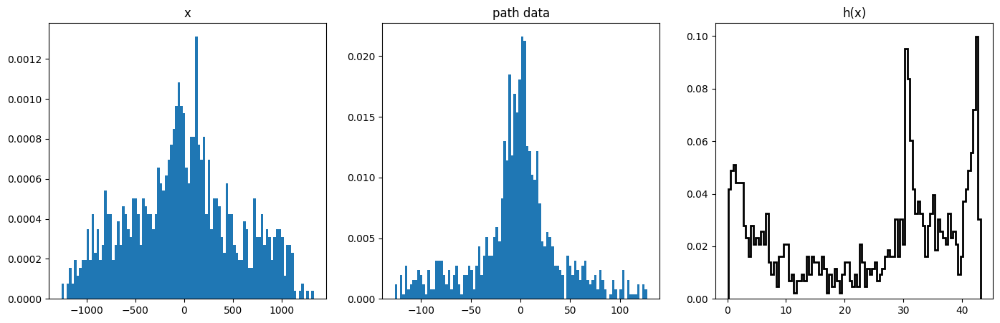

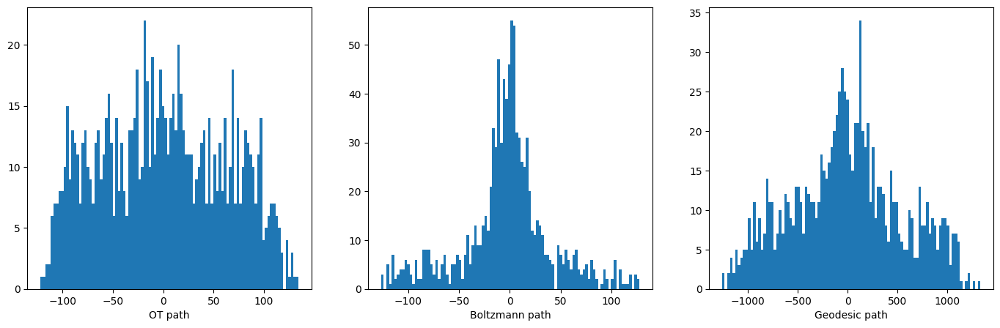

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5227 26355.957031 0.003000
    5237 23466.089844 0.003000
    5247 18979.933594 0.003000
    5257 15252.438477 0.003000
    5267 12666.041016 0.003000
[101, 247906784.0]


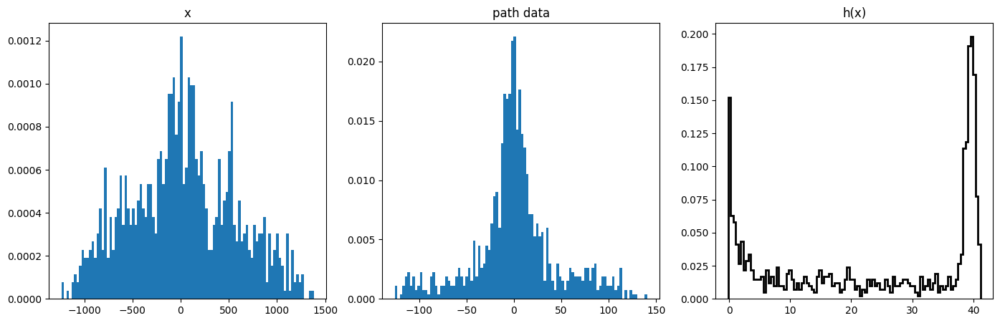

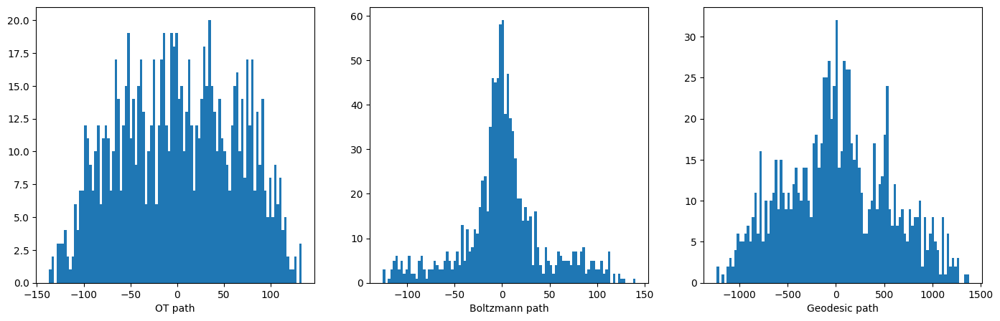

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5276 12299.864258 0.003000
    5286 11055.238281 0.001500
    5296 10350.013672 0.001500
    5306 10153.411133 0.001500
    5316 9930.574219 0.001500
[102, 196937456.0]


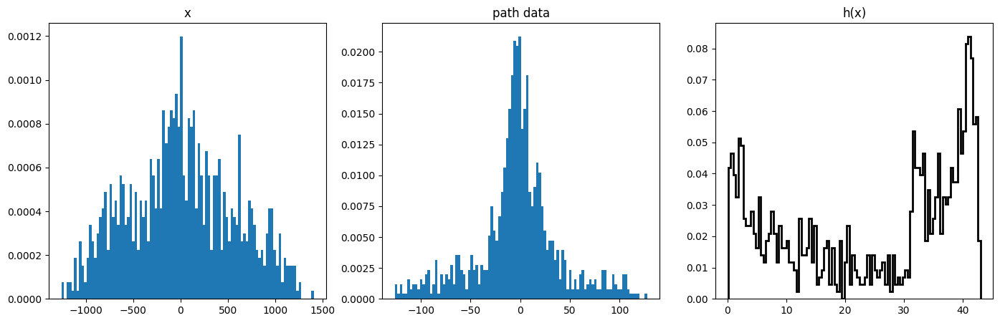

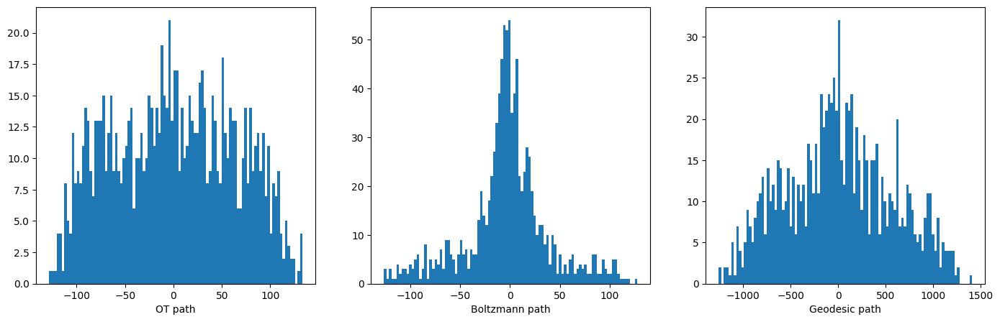

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5325 41322.011719 0.003000
    5335 28287.414062 0.001500
    5345 21606.251953 0.000750
    5355 20638.943359 0.000750
    5365 19102.554688 0.000750
[103, 184453280.0]


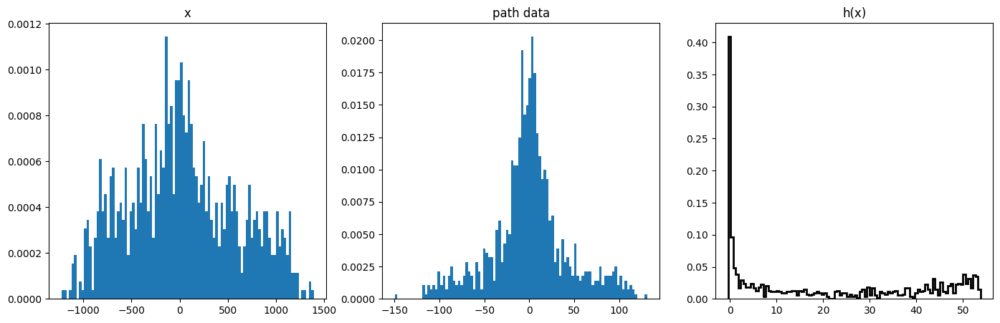

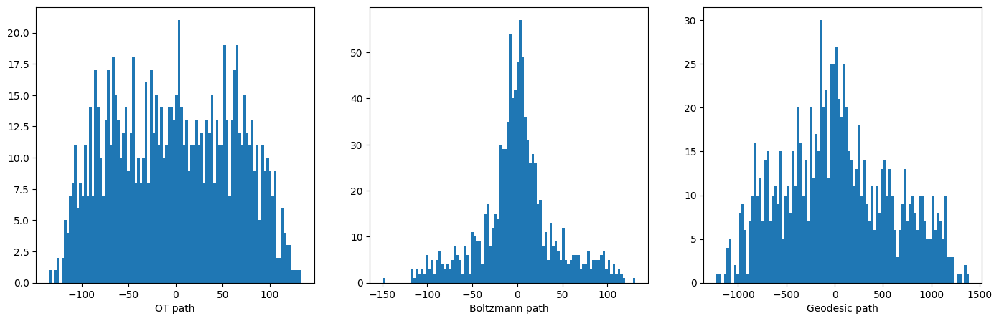

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5374 21722.439453 0.003000
    5384 17080.527344 0.001500
    5394 14478.077148 0.000750
    5404 14158.005859 0.000750
    5414 13560.518555 0.000750
[104, 169379552.0]


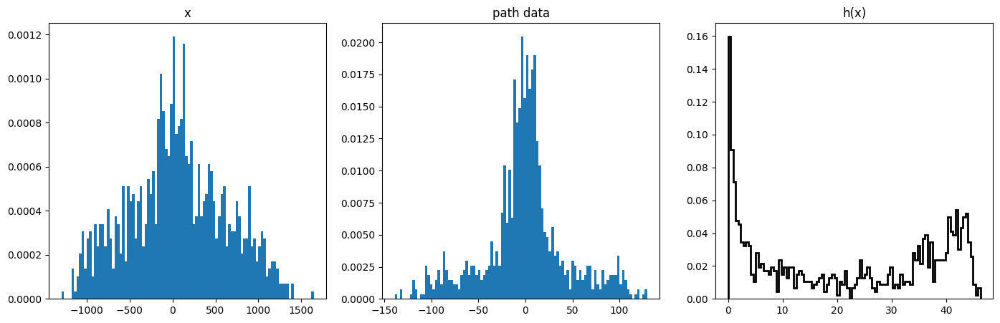

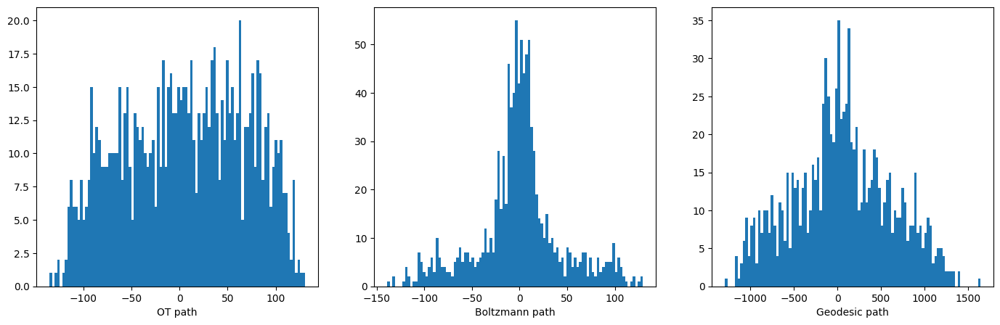

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5423 10377.026367 0.003000
    5433 9662.263672 0.001500
    5443 9288.372070 0.000750
    5453 9257.757812 0.000750
    5463 9182.699219 0.000750
[105, 503927104.0]


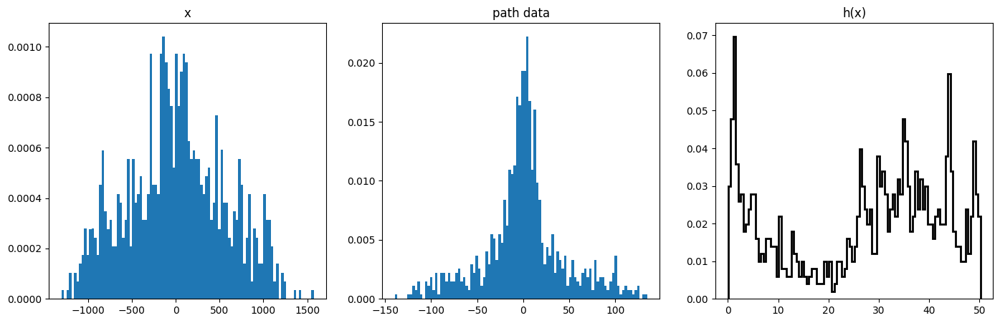

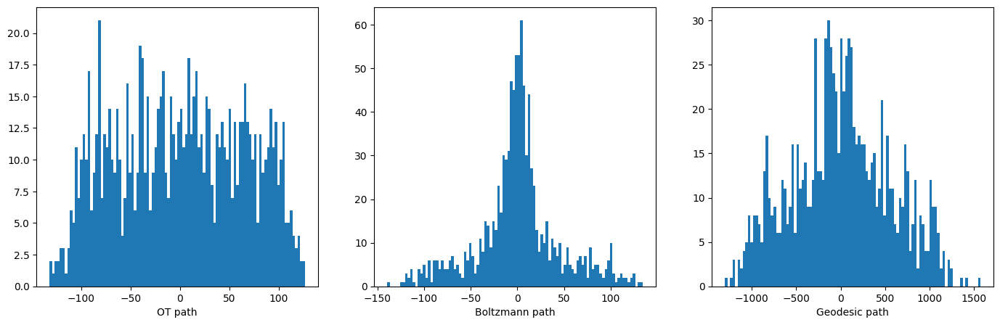

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5472 21830.130859 0.003000
    5482 18882.136719 0.003000
    5492 15841.494141 0.003000
    5502 13380.361328 0.003000
    5512 11574.877930 0.003000
[106, 272007200.0]


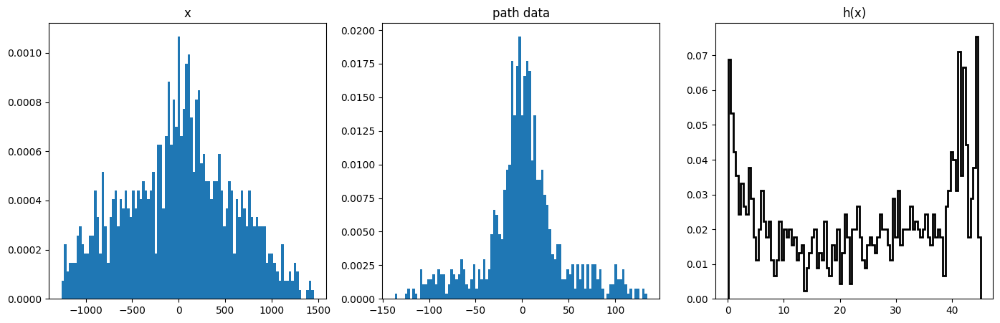

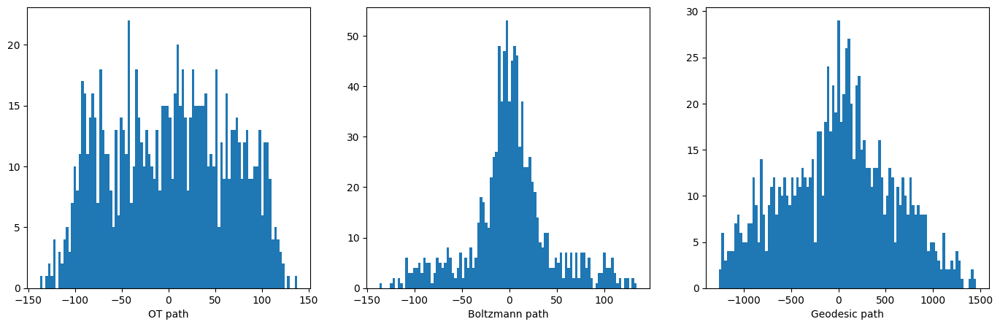

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5521 35854.234375 0.003000
    5531 23059.873047 0.001500
    5541 16620.816406 0.000750
    5551 16266.474609 0.000375
    5561 15791.864258 0.000375
[107, 180068608.0]


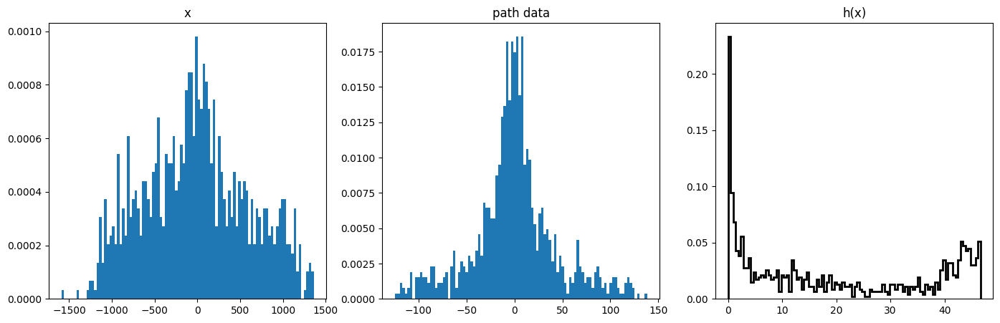

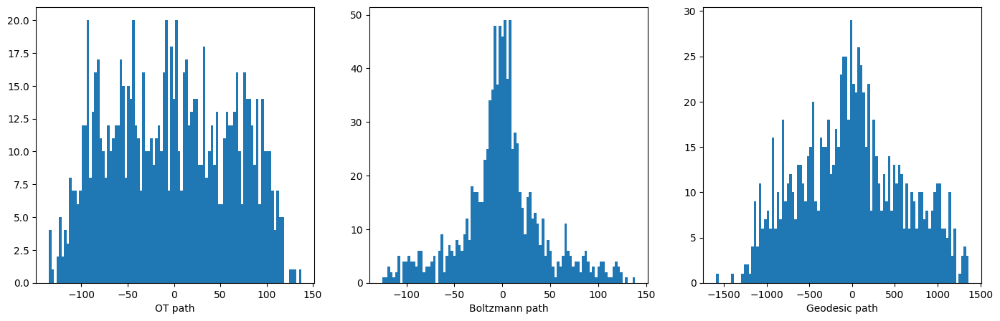

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5570 22762.476562 0.003000
    5580 20129.207031 0.001500
    5590 18208.654297 0.001500
    5600 16939.425781 0.001500
    5610 15862.349609 0.001500
[108, 211368240.0]


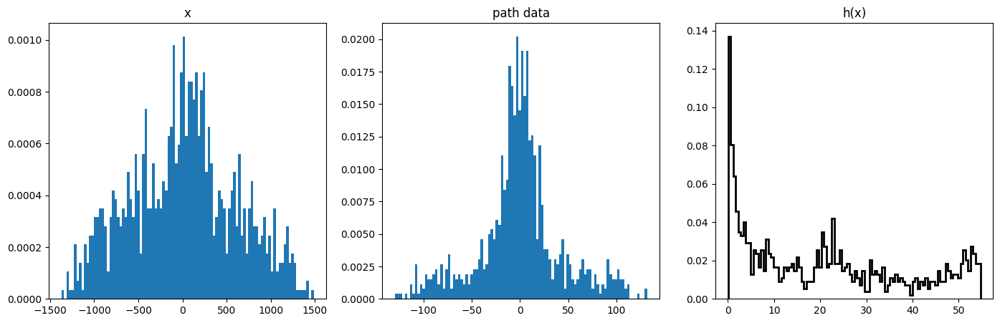

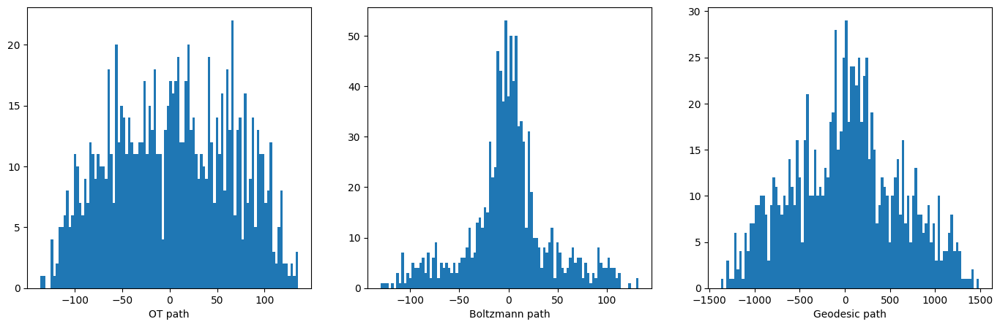

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5619 18509.511719 0.003000
    5629 16861.761719 0.003000
    5639 15209.691406 0.003000
    5649 13877.486328 0.003000
    5659 12891.869141 0.003000
[109, 293601664.0]


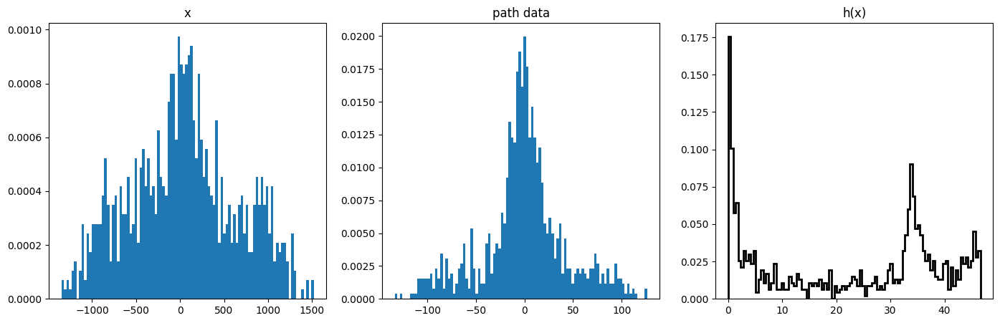

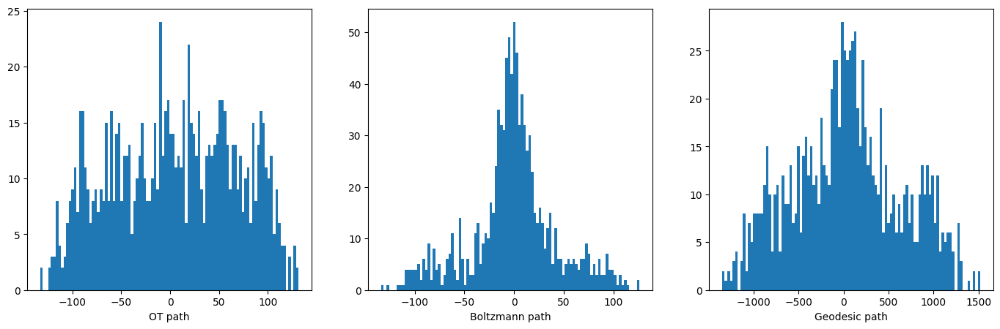

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5668 70319.890625 0.003000
    5678 32867.097656 0.001500
    5688 16504.062500 0.000375
    5698 14803.994141 0.000188
    5708 14463.238281 0.000188
[110, 257939056.0]


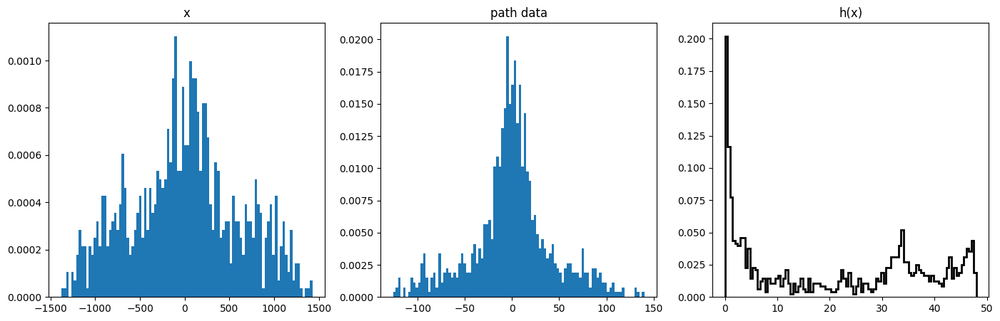

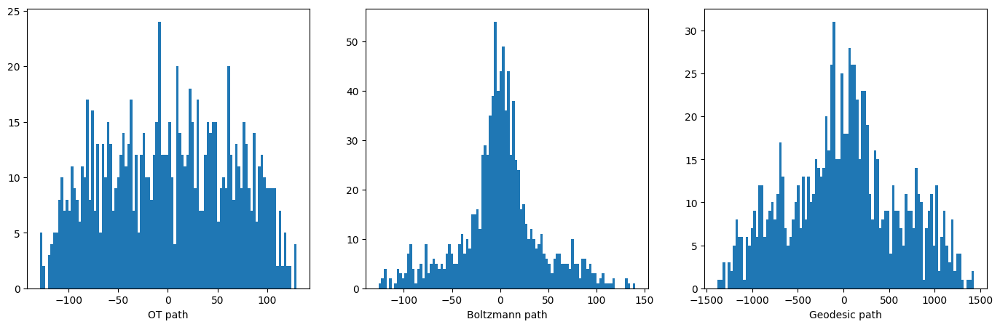

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5717 31807.925781 0.003000
    5727 20337.503906 0.001500
    5737 14963.700195 0.000375
    5747 14224.136719 0.000375
    5757 14141.021484 0.000375
[111, 218676992.0]


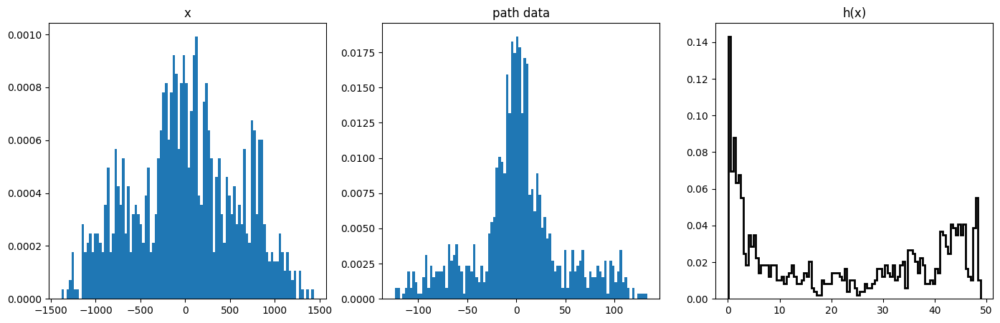

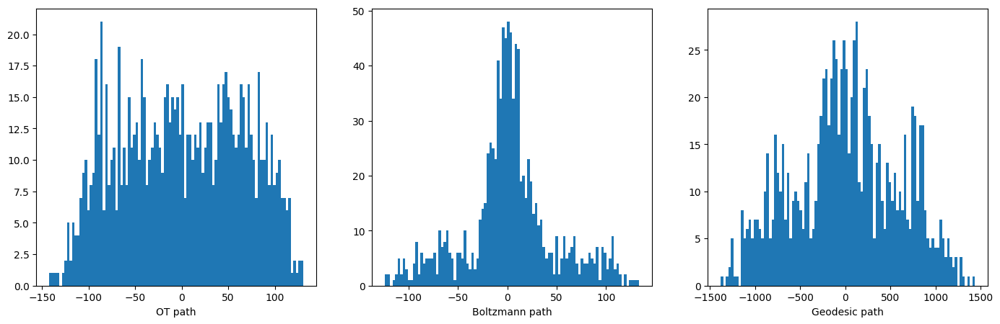

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5766 15255.234375 0.003000
    5776 13852.451172 0.001500
    5786 12966.223633 0.001500
    5796 12507.223633 0.001500
    5806 12120.191406 0.001500
[112, 181735664.0]


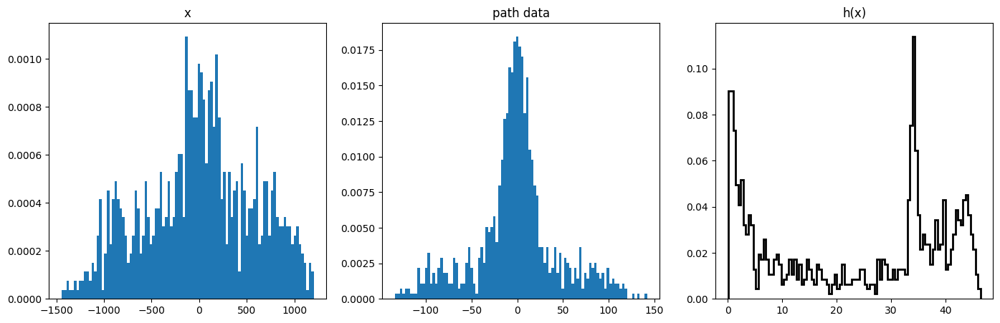

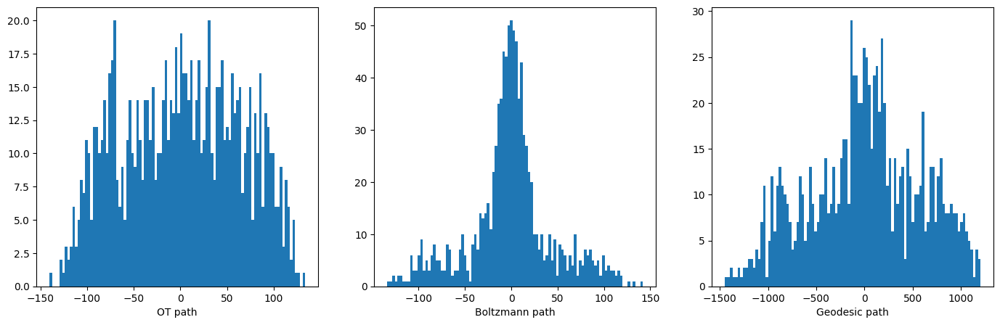

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5815 70757.875000 0.003000
    5825 32332.927734 0.001500
    5835 16707.183594 0.000375
    5845 14650.768555 0.000375
    5855 14530.016602 0.000375
[113, 276161024.0]


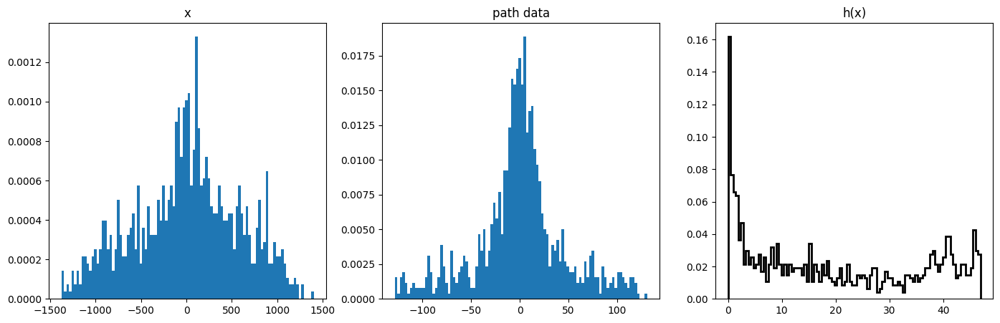

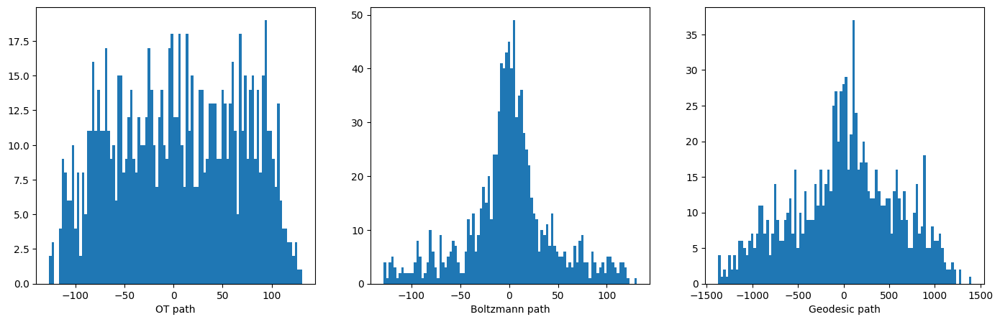

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5864 41297.617188 0.003000
    5874 24396.296875 0.001500
    5884 18590.255859 0.000750
    5894 16843.804688 0.000750
    5904 16097.596680 0.000750
[114, 196961424.0]


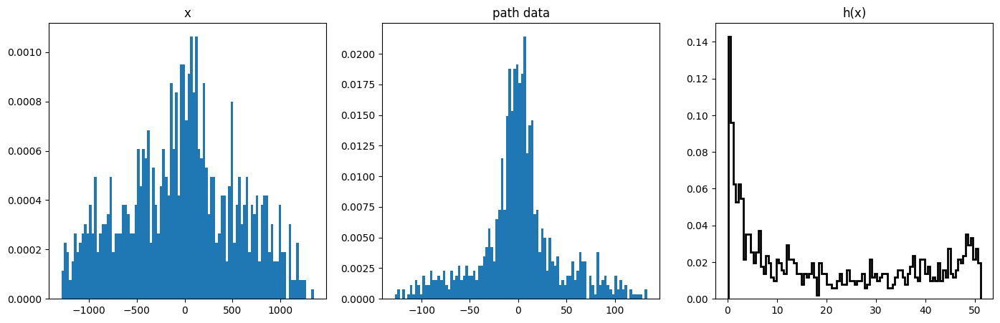

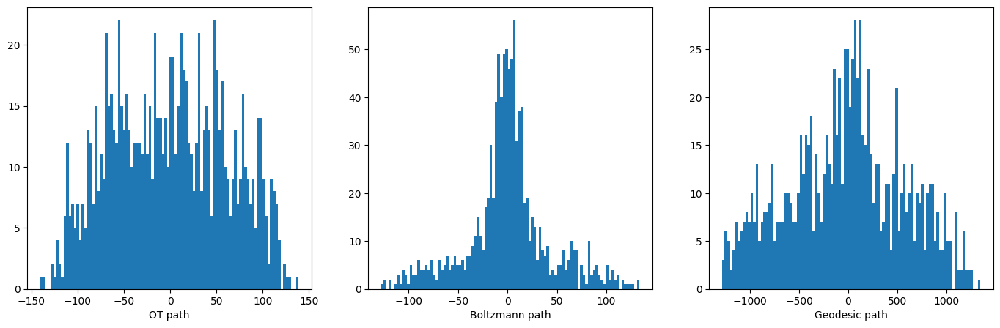

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5913 12720.096680 0.003000
    5923 11384.635742 0.003000
    5933 10770.894531 0.001500
    5943 10569.060547 0.001500
    5953 10251.417969 0.001500
[115, 241784896.0]


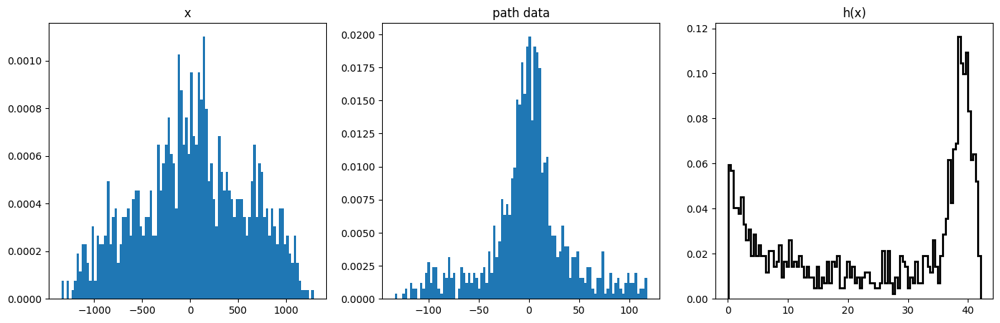

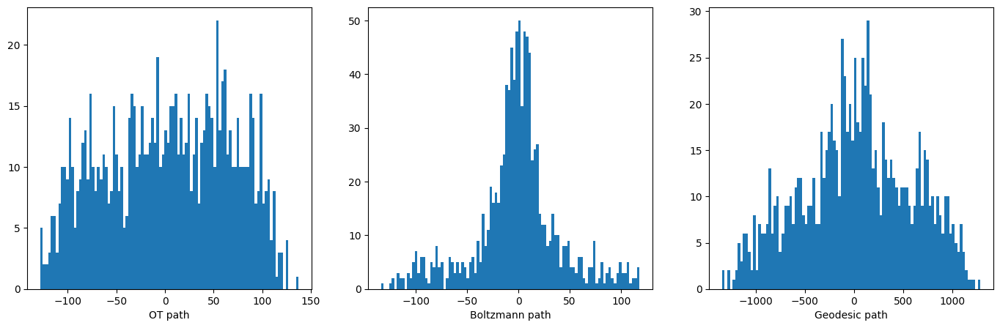

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    5962 16736.937500 0.003000
    5972 15454.468750 0.003000
    5982 14152.792969 0.003000
    5992 13048.449219 0.003000
    6002 12163.083984 0.003000
[116, 250389872.0]


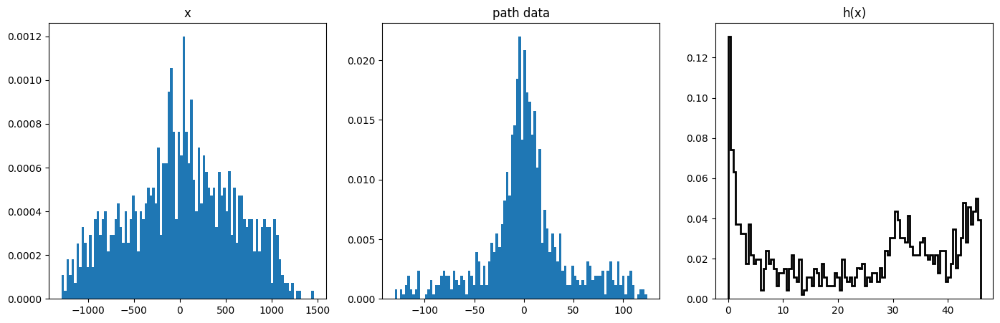

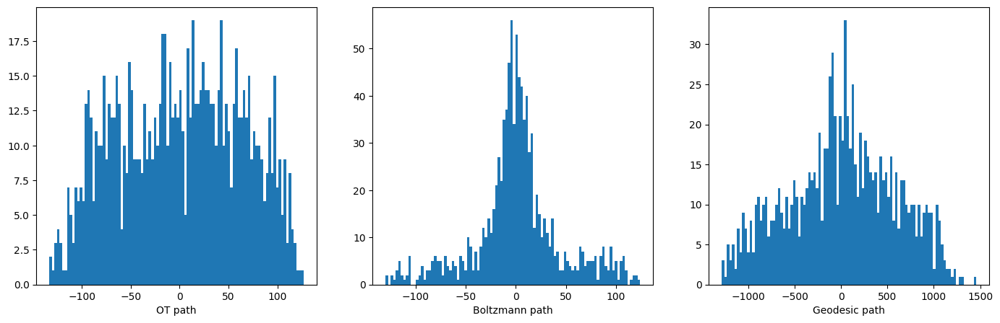

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6011 17593.056641 0.003000
    6021 16171.399414 0.003000
    6031 13999.920898 0.003000
    6041 12073.107422 0.003000
    6051 10616.365234 0.003000
[117, 154534368.0]


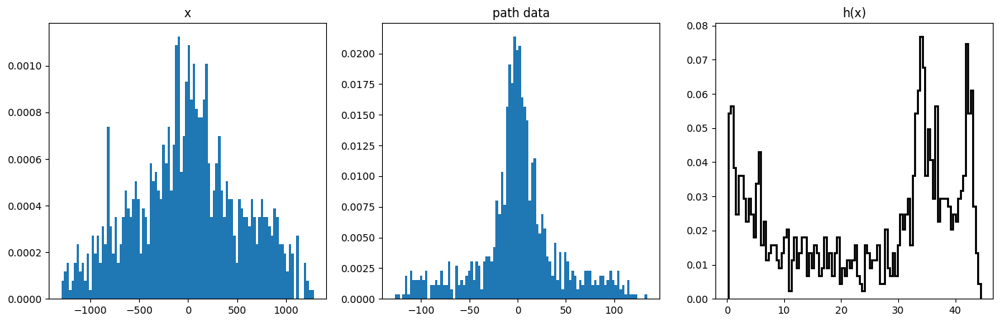

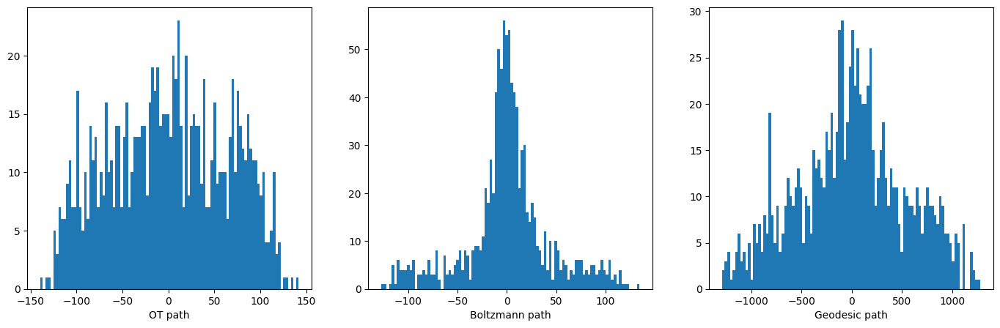

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6060 27386.365234 0.003000
    6070 17963.363281 0.001500
    6080 13594.146484 0.000750
    6090 13270.848633 0.000375
    6100 13122.754883 0.000188
[118, 348429728.0]


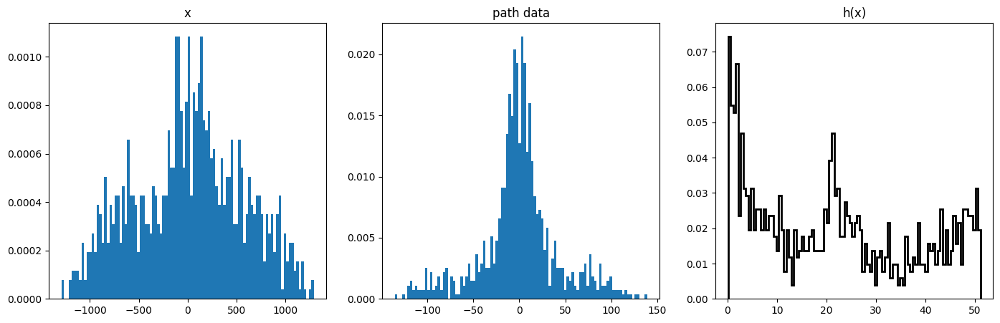

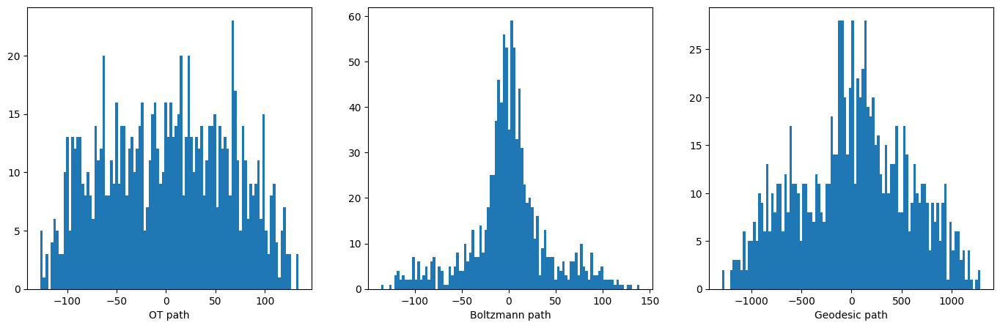

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6109 58594.773438 0.003000
    6119 26428.050781 0.001500
    6129 16976.142578 0.000375
[119, 86817488.0]


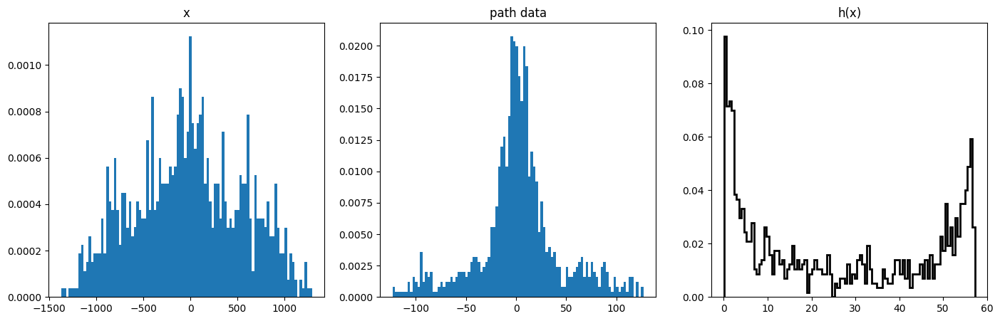

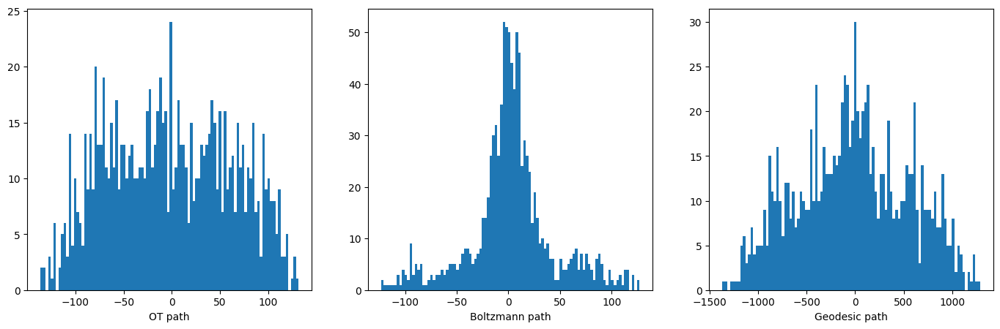

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6135 27232.376953 0.003000
    6145 20288.765625 0.001500
    6155 14298.728516 0.000375
    6165 13167.325195 0.000375
    6175 13043.254883 0.000375
[120, 124474736.0]


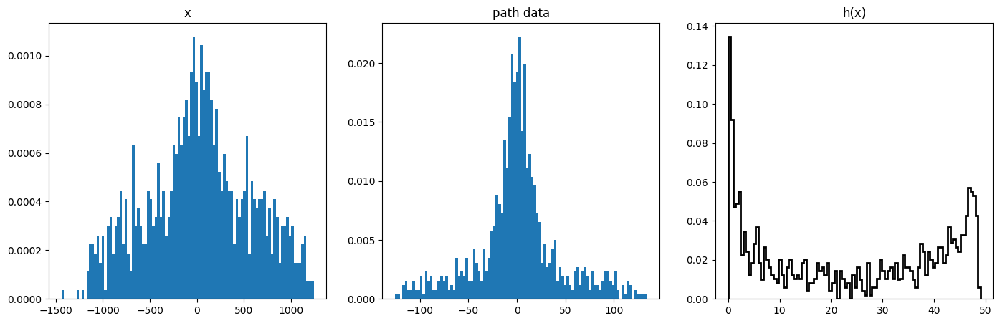

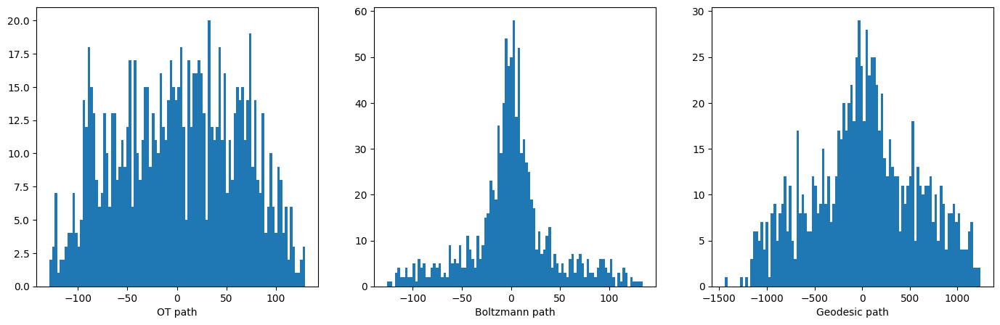

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6184 15772.597656 0.003000
    6194 13111.696289 0.001500
    6204 11768.452148 0.000750
    6214 11465.805664 0.000750
    6224 11163.098633 0.000750
[121, 368418368.0]


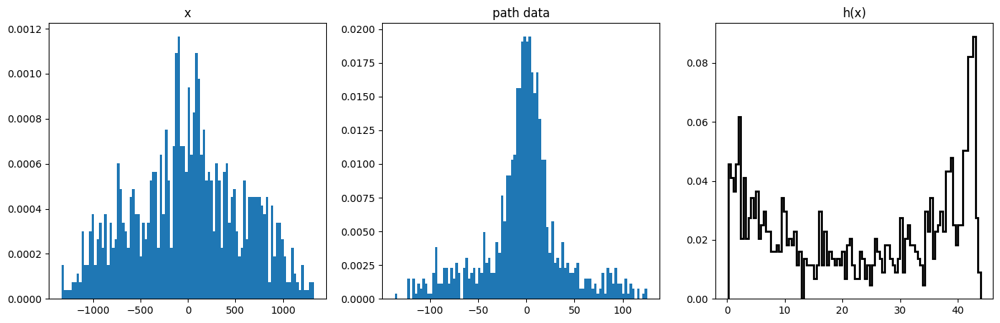

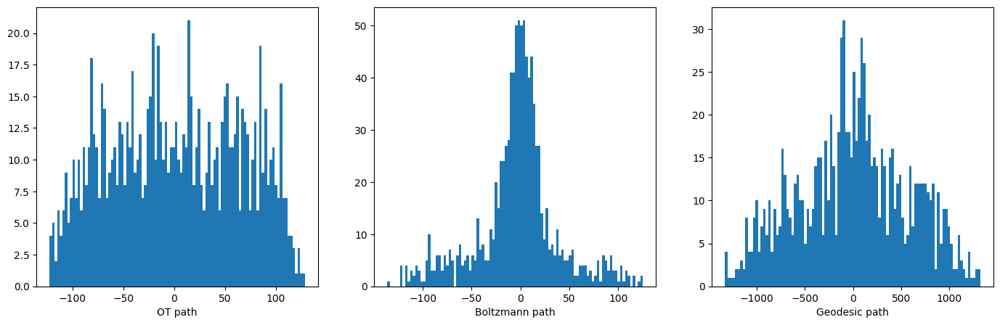

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6233 22850.828125 0.003000
    6243 20887.175781 0.003000
    6253 18148.164062 0.003000
    6263 15763.677734 0.003000
    6273 13964.006836 0.003000
[122, 221047184.0]


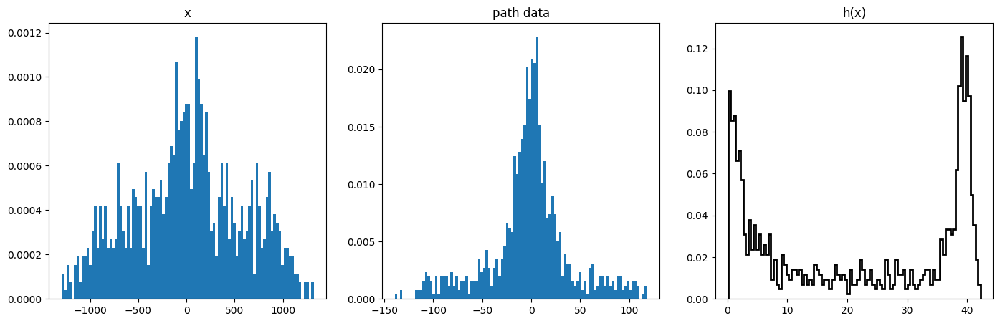

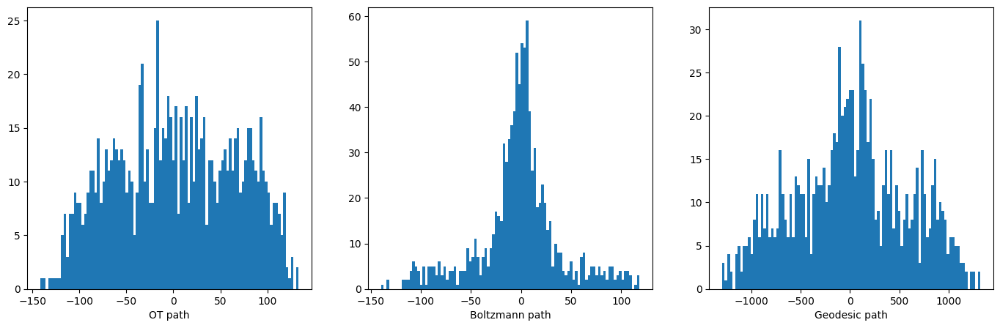

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6282 23611.472656 0.003000
    6292 18347.812500 0.001500
    6302 16445.820312 0.000750
    6312 15809.046875 0.000750
    6322 15454.773438 0.000750
[123, 210704544.0]


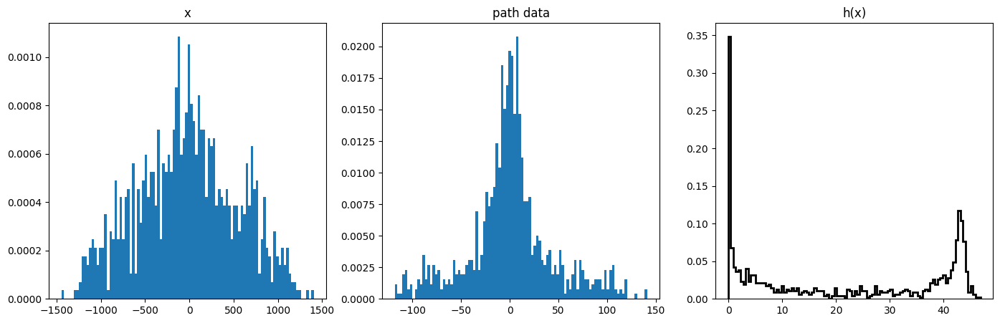

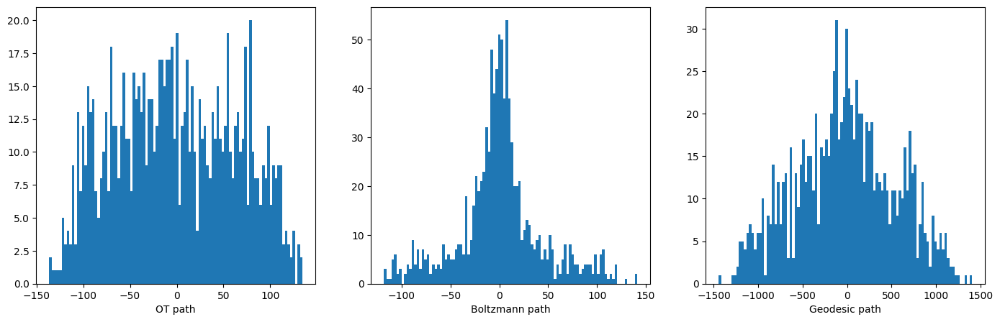

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6331 15289.543945 0.003000
    6341 13770.554688 0.003000
    6351 12450.161133 0.003000
    6361 11398.910156 0.003000
    6371 10594.867188 0.003000
[124, 223929856.0]


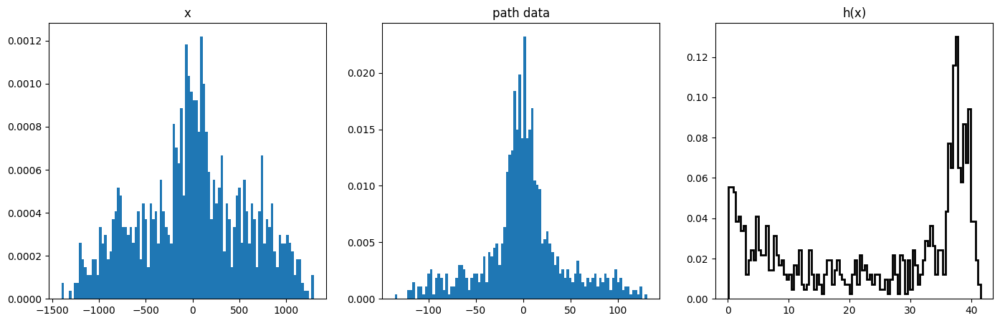

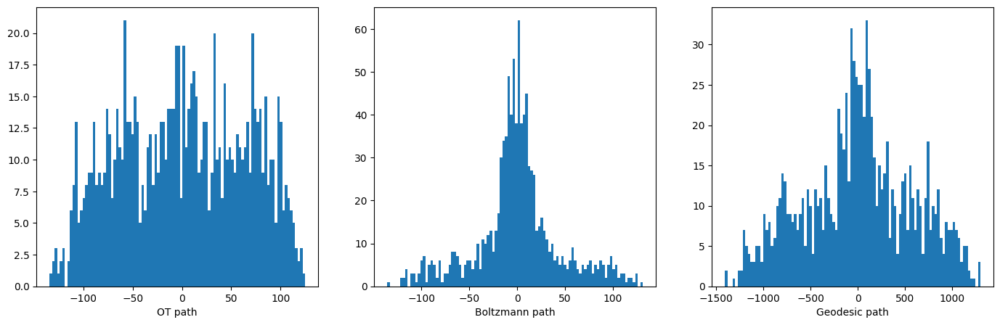

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6380 14833.525391 0.003000
    6390 13552.908203 0.003000
    6400 11599.019531 0.003000
    6410 8859.633789 0.003000
    6420 6632.369141 0.003000
[125, 330143424.0]


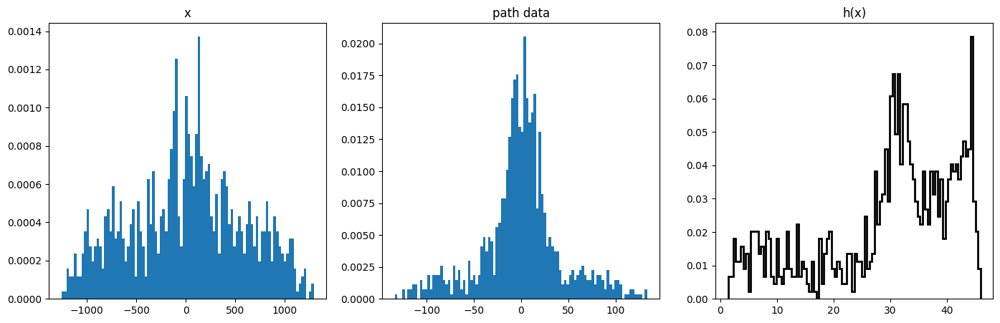

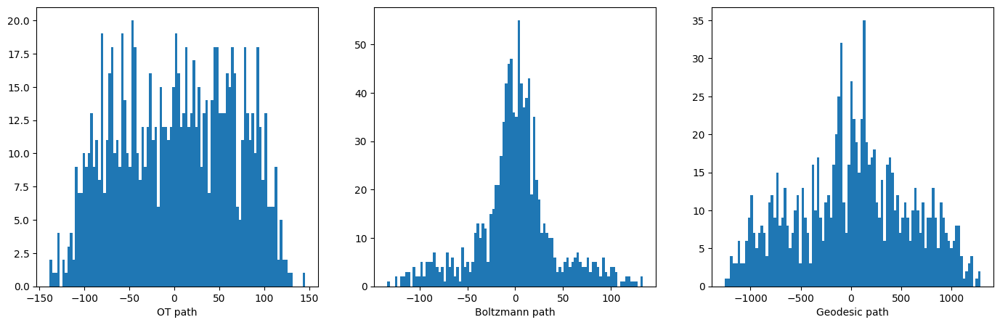

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6429 71205.210938 0.003000
    6439 24224.525391 0.003000
    6449 20603.037109 0.003000
    6459 17367.884766 0.003000
    6469 14946.932617 0.003000
[126, 347545120.0]


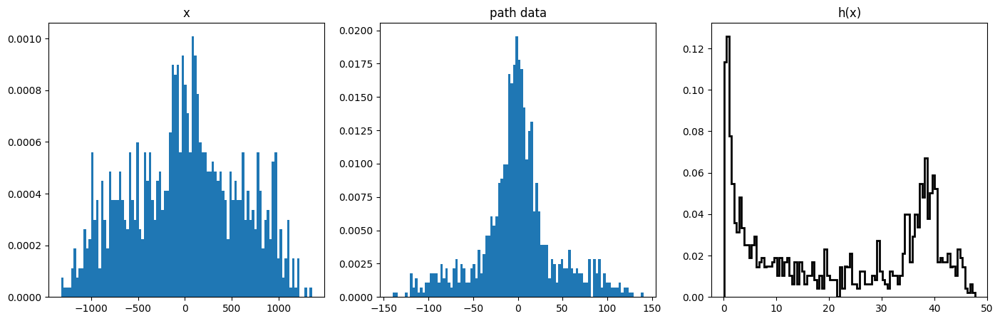

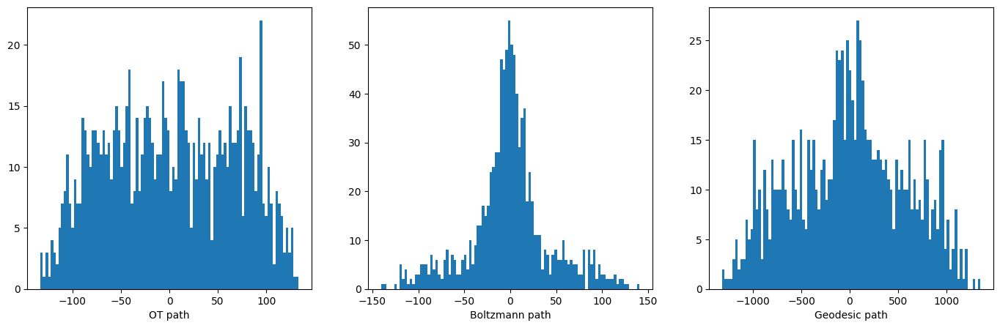

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6478 17373.308594 0.003000
    6488 14863.167969 0.001500
    6498 13756.792969 0.000750
    6508 13601.082031 0.000750
    6518 13432.760742 0.000750
[127, 290865792.0]


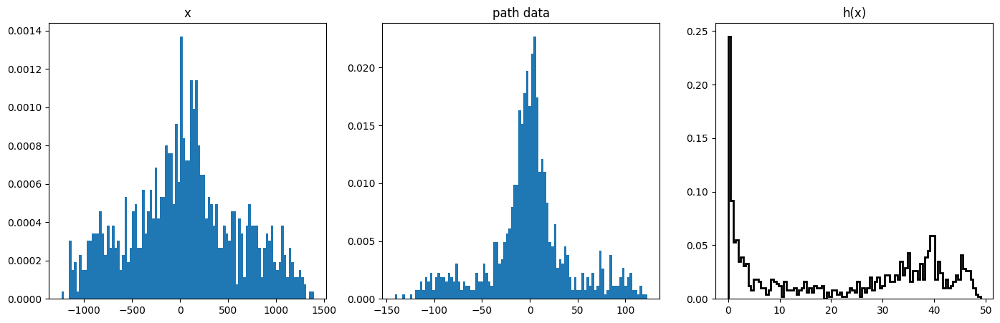

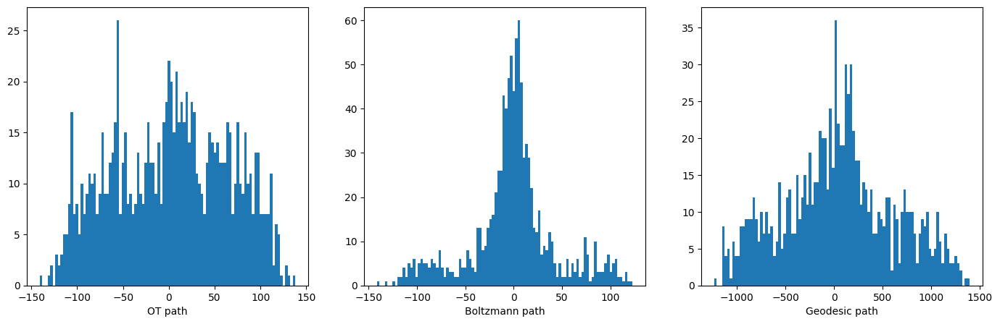

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6527 14285.123047 0.003000
    6537 13352.466797 0.003000
    6547 12132.590820 0.003000
    6557 10876.228516 0.003000
    6567 9229.578125 0.003000
[128, 406153088.0]


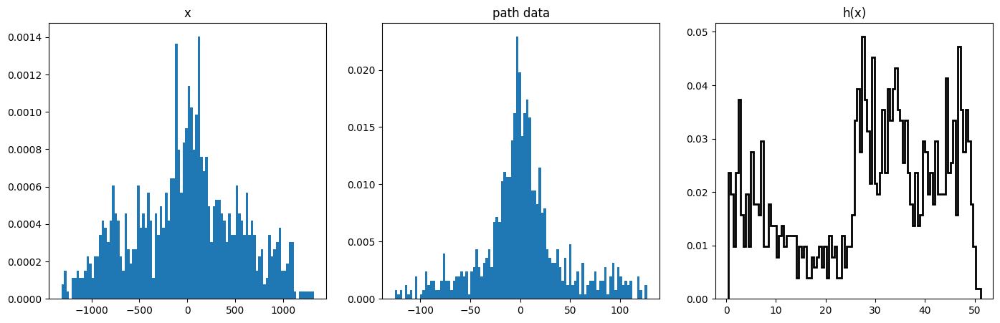

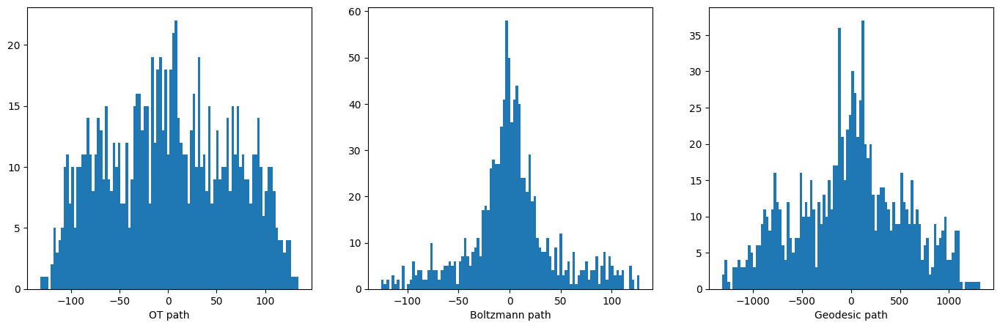

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6576 32681.644531 0.003000
    6586 18385.341797 0.003000
    6596 13690.005859 0.003000
    6606 10495.041016 0.003000
    6616 9172.709961 0.001500
[129, 157448768.0]


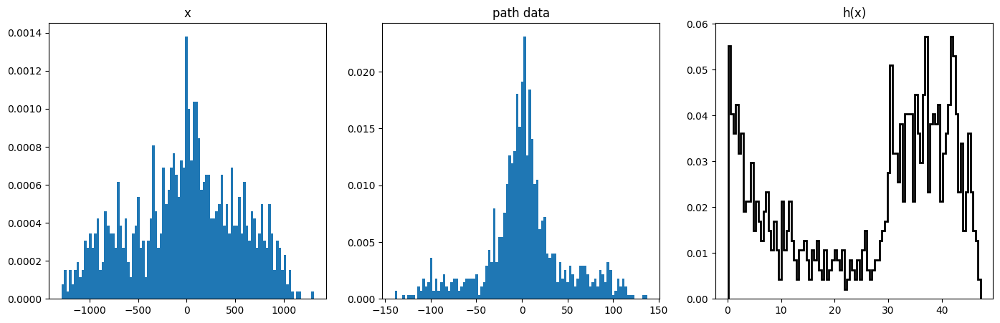

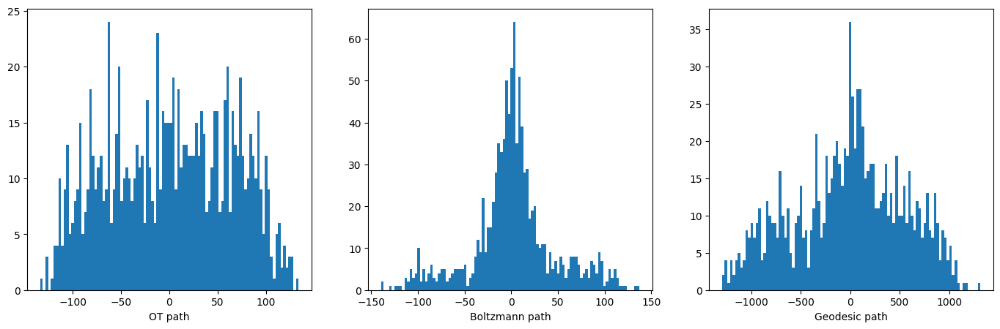

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6625 37587.867188 0.003000
    6635 15336.578125 0.001500
    6645 12984.404297 0.000750
    6655 12931.199219 0.000375
    6665 12653.083984 0.000375
[130, 283623136.0]


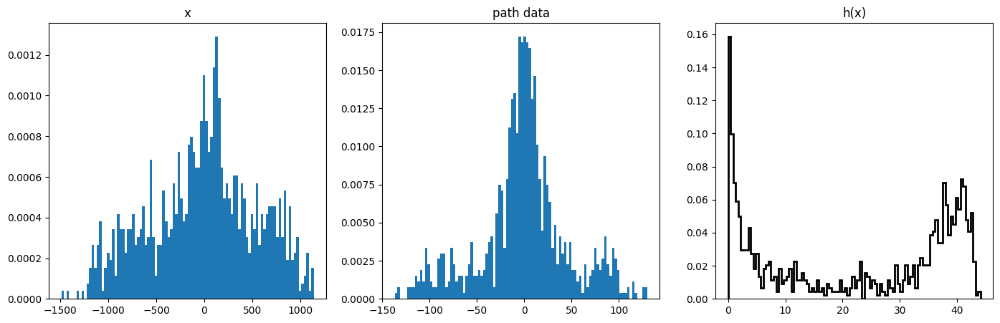

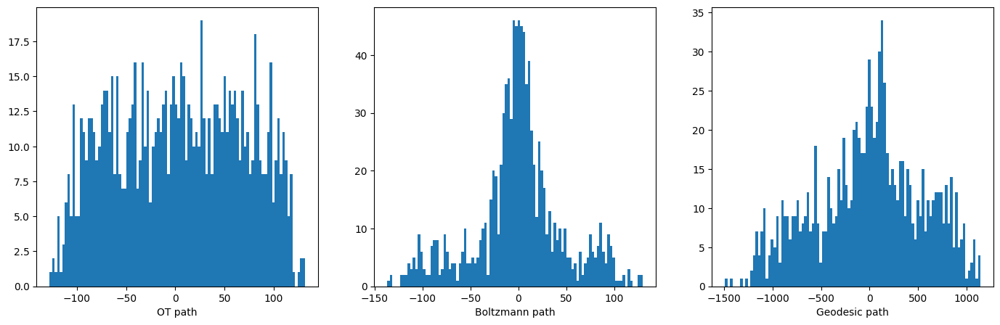

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6674 46946.882812 0.003000
    6684 21644.732422 0.001500
    6694 10721.244141 0.000375
    6704 9625.967773 0.000188
    6714 9434.156250 0.000188
[131, 362170656.0]


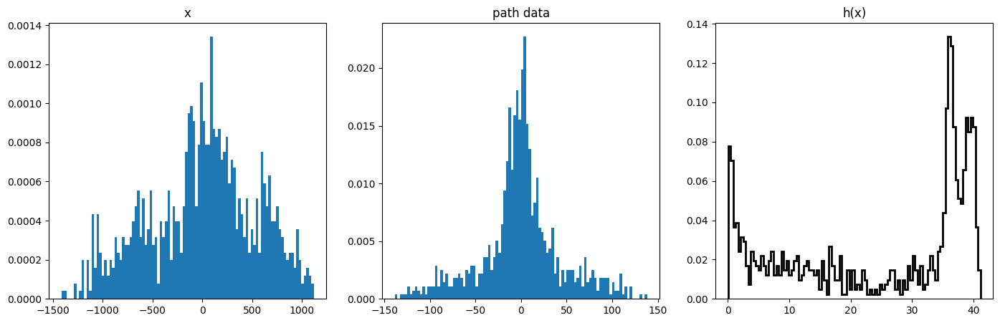

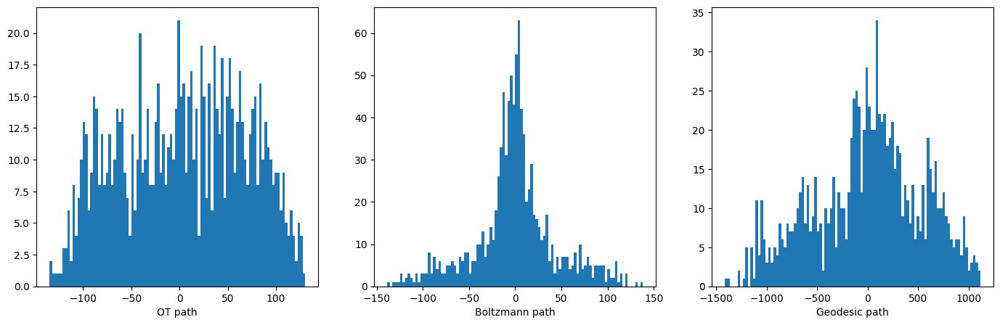

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6723 14657.623047 0.003000
    6733 13045.257812 0.003000
    6743 12135.645508 0.001500
    6753 11712.601562 0.001500
    6763 11246.242188 0.001500
[132, 375995168.0]


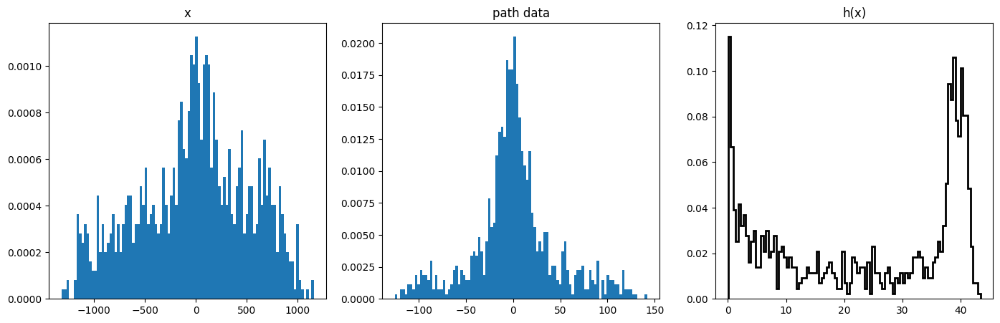

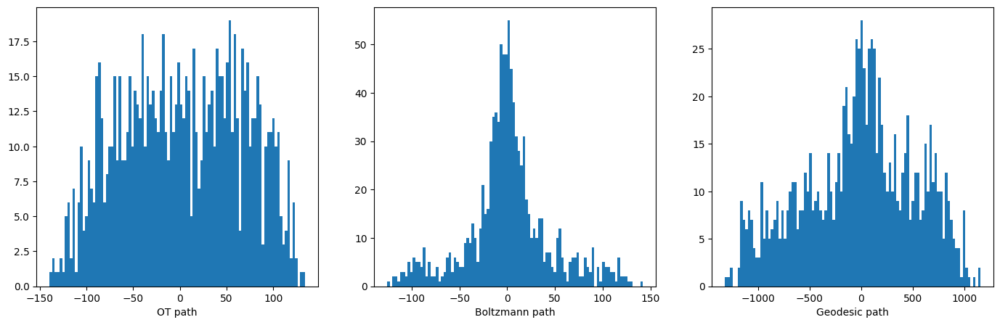

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6772 13920.051758 0.003000
    6782 12883.984375 0.003000
    6792 11793.581055 0.003000
    6802 10898.475586 0.003000
    6812 10224.664062 0.003000
[133, 221705504.0]


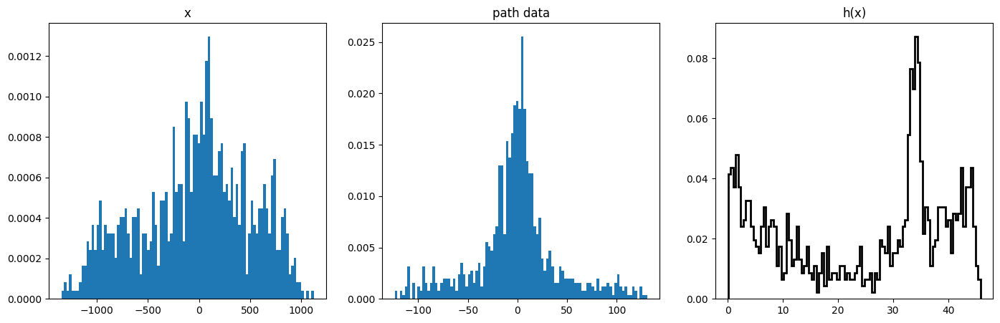

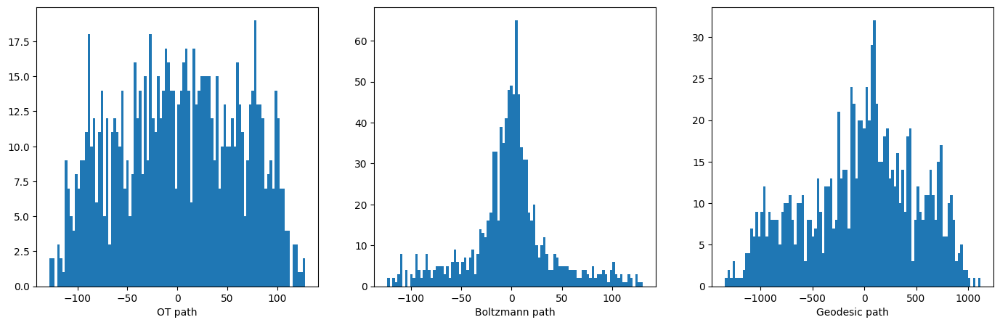

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6821 81002.843750 0.003000
    6831 40314.953125 0.001500
    6841 23463.427734 0.000750
    6851 22207.468750 0.000375
    6861 21534.953125 0.000375
[134, 160275200.0]


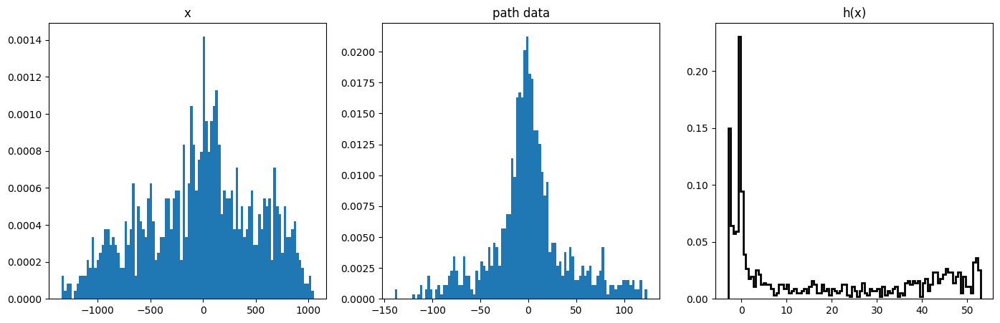

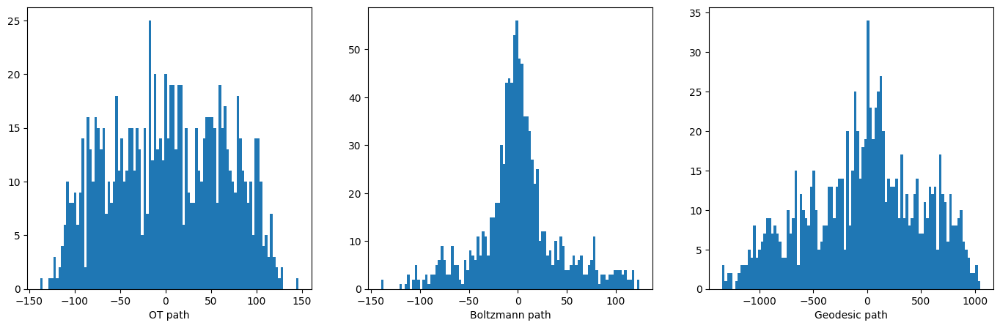

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6870 14960.276367 0.003000
    6880 12529.875000 0.003000
    6890 11441.920898 0.000750
    6900 11118.372070 0.000750
    6910 10855.607422 0.000750
[135, 237427888.0]


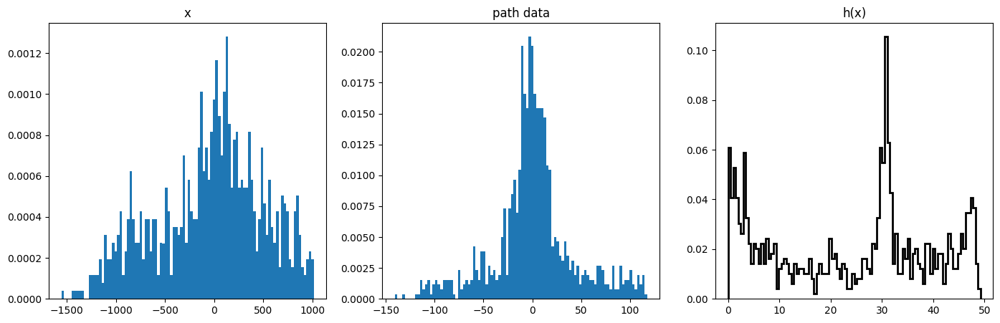

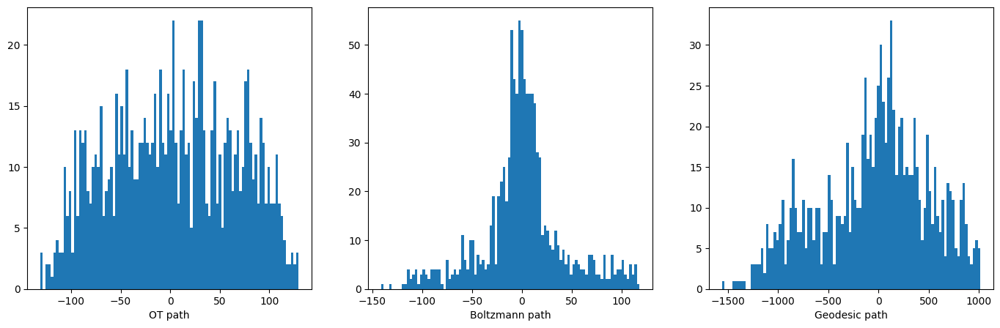

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6919 12947.979492 0.003000
    6929 11906.951172 0.001500
    6939 11175.760742 0.001500
    6949 10676.470703 0.001500
    6959 10236.531250 0.001500
[136, 171873632.0]


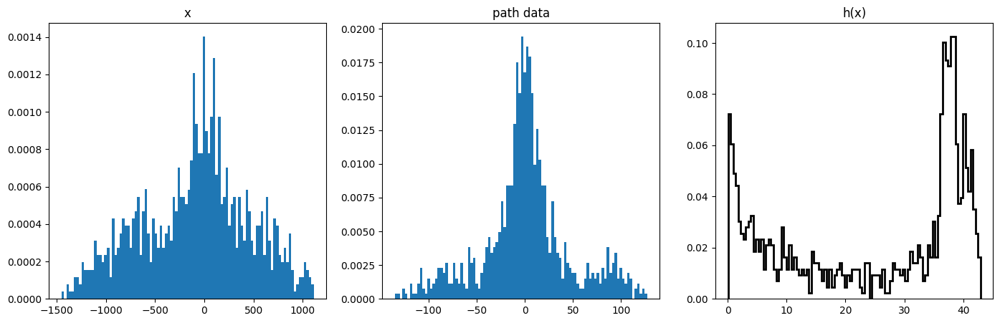

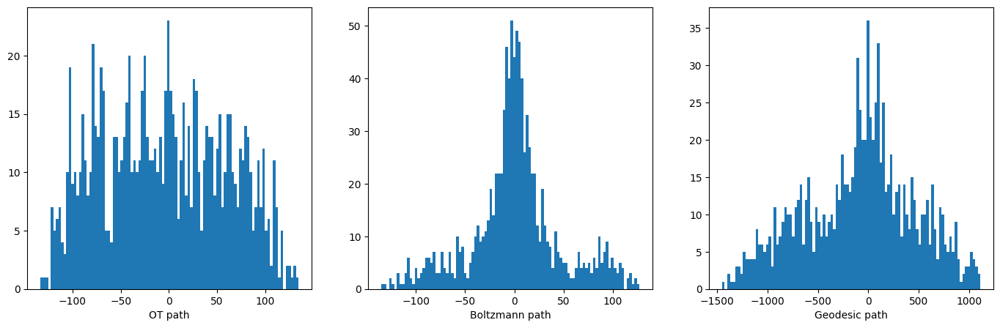

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    6968 12280.725586 0.003000
    6978 11343.376953 0.003000
    6988 10233.988281 0.003000
    6998 9303.492188 0.003000
    7008 8606.565430 0.003000
[137, 138853328.0]


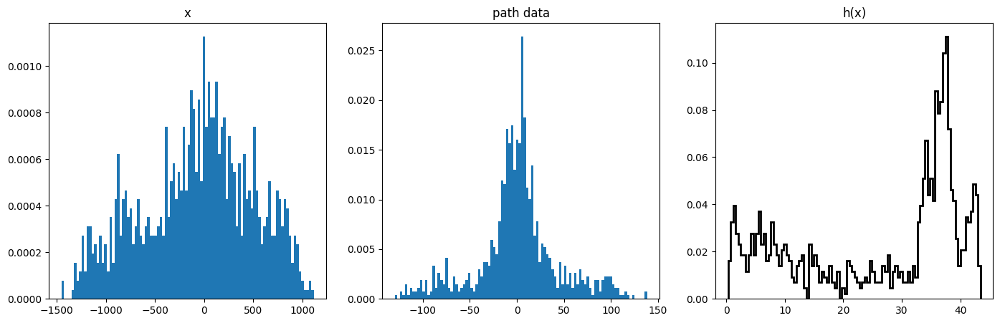

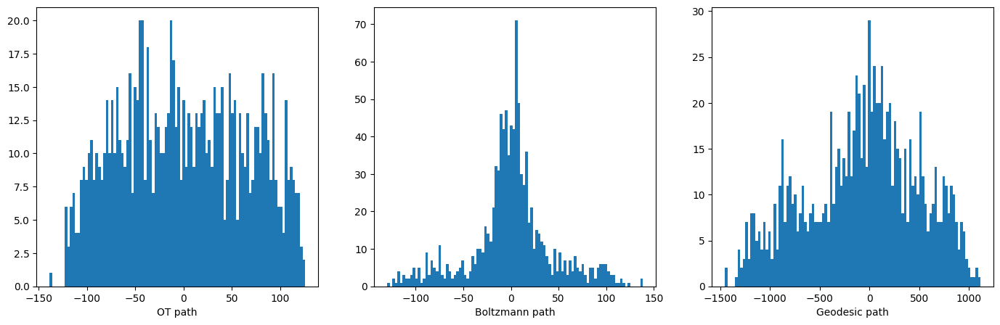

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7017 13689.514648 0.003000
    7027 12776.544922 0.003000
    7037 11612.058594 0.003000
    7047 10615.383789 0.003000
    7057 9867.581055 0.003000
[138, 157454064.0]


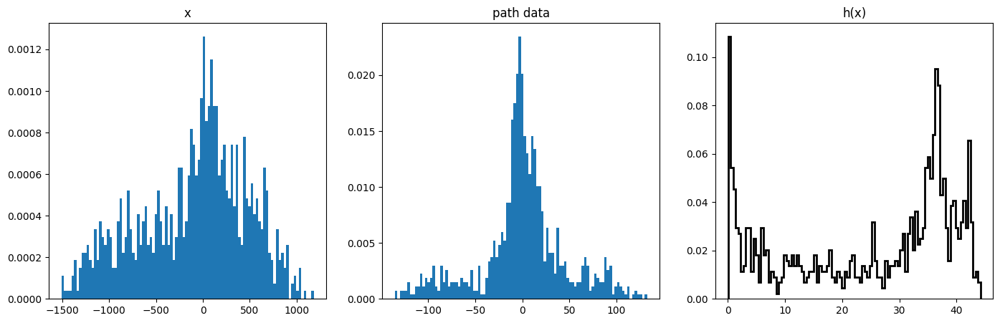

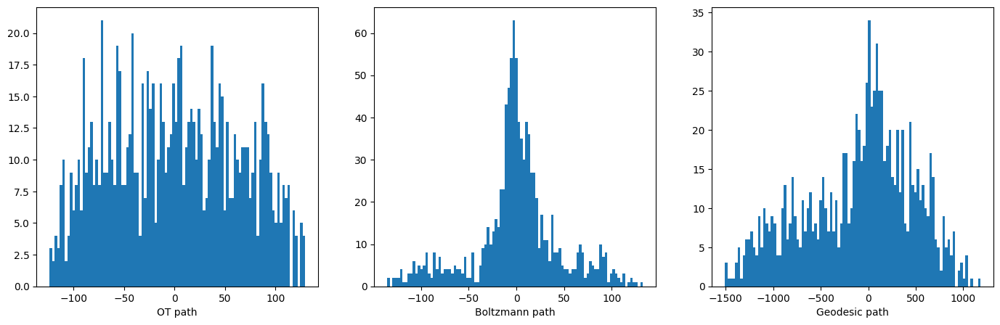

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7066 16542.623047 0.003000
    7076 14799.148438 0.003000
    7086 12987.462891 0.003000
    7096 11527.926758 0.003000
    7106 10457.817383 0.003000
[139, 239683264.0]


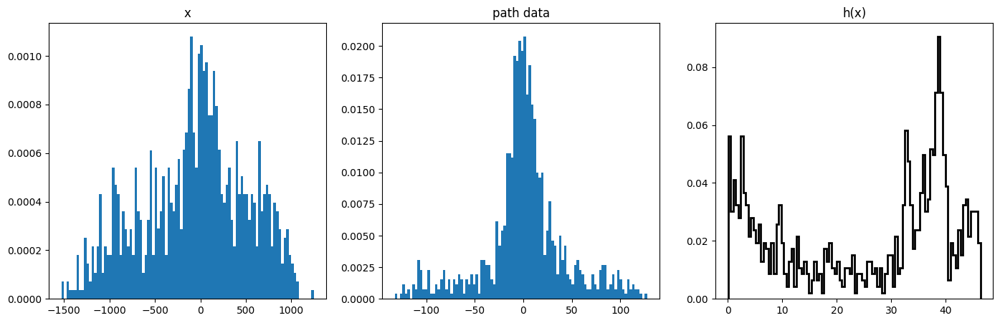

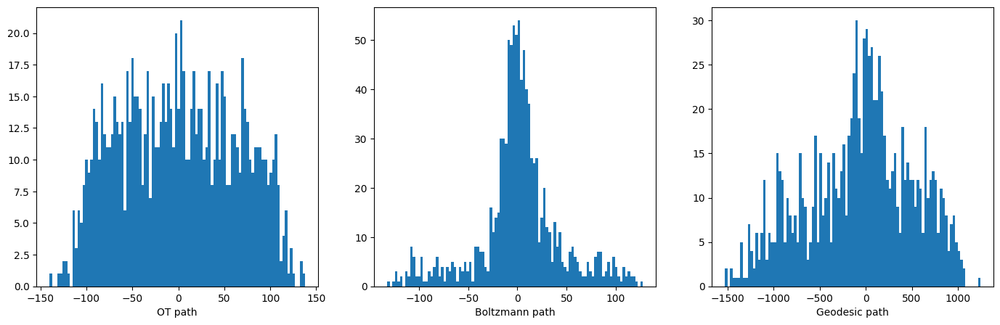

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7115 18868.570312 0.003000
    7125 13495.832031 0.001500
    7135 12158.845703 0.001500
    7145 11795.118164 0.000750
    7155 11517.599609 0.000750
[140, 364064448.0]


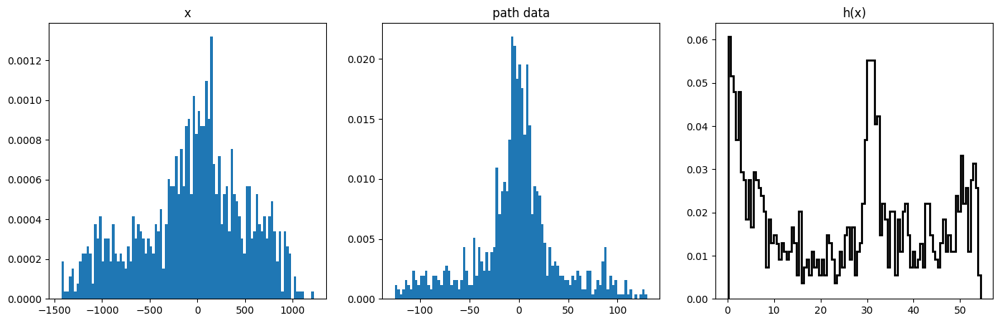

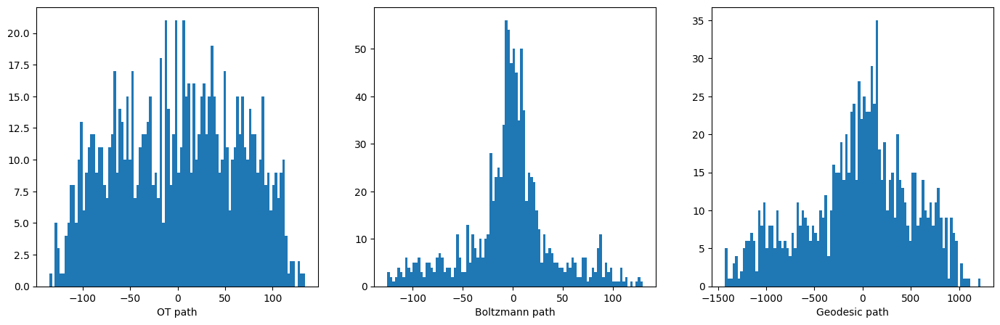

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7164 21860.812500 0.003000
    7174 16488.339844 0.001500
    7184 13758.312500 0.000750
    7194 13566.535156 0.000750
    7204 13177.065430 0.000750
[141, 350011168.0]


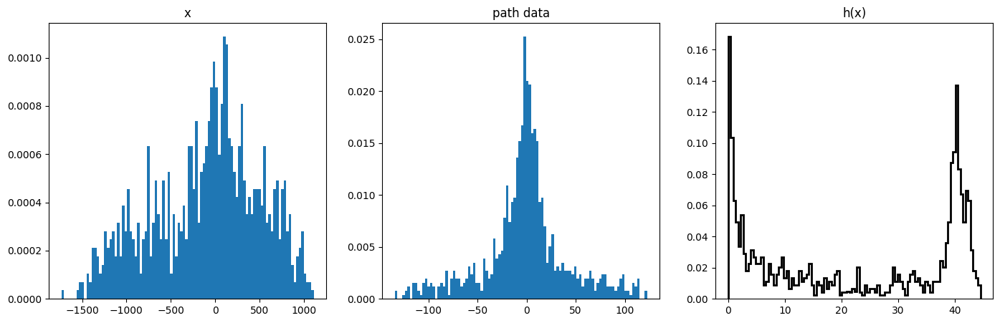

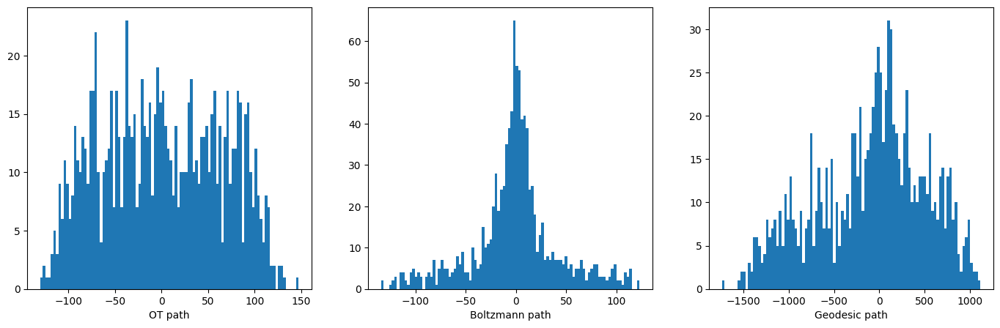

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7213 21379.044922 0.003000
    7223 18773.515625 0.003000
    7233 15997.389648 0.003000
    7243 13813.768555 0.003000
    7253 12275.616211 0.003000
[142, 304751392.0]


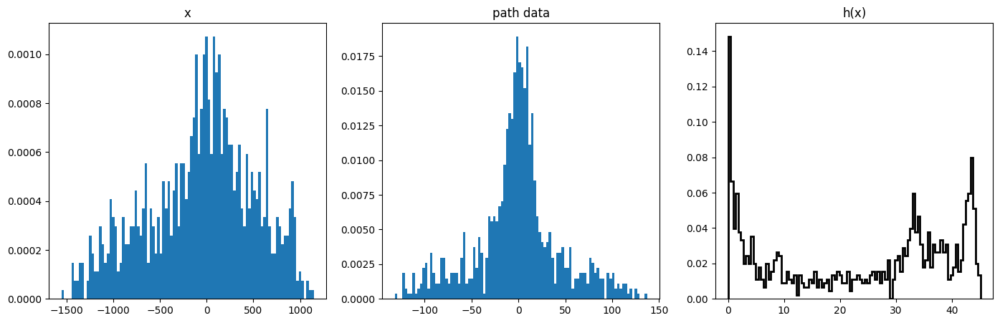

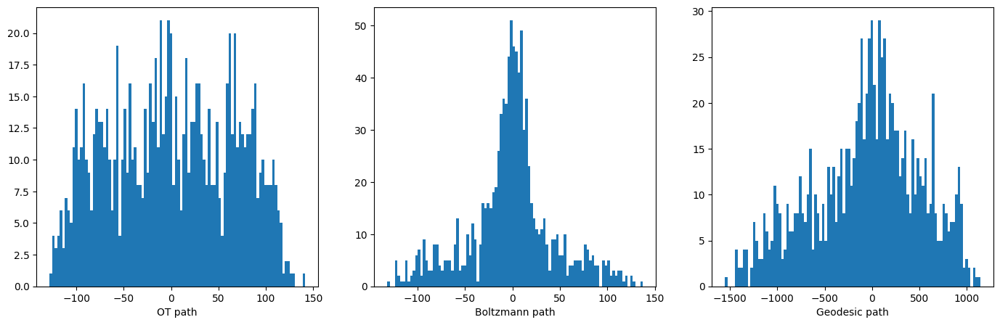

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7262 14712.496094 0.003000
    7272 12111.836914 0.001500
    7282 10777.349609 0.000750
    7292 10663.882812 0.000750
    7302 10463.810547 0.000750
[143, 306695424.0]


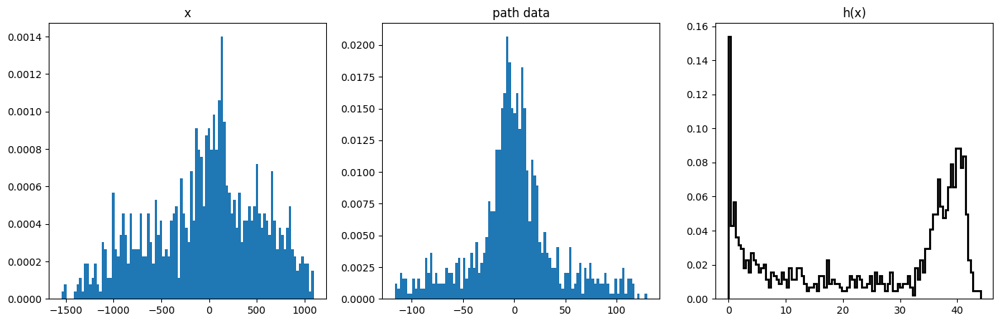

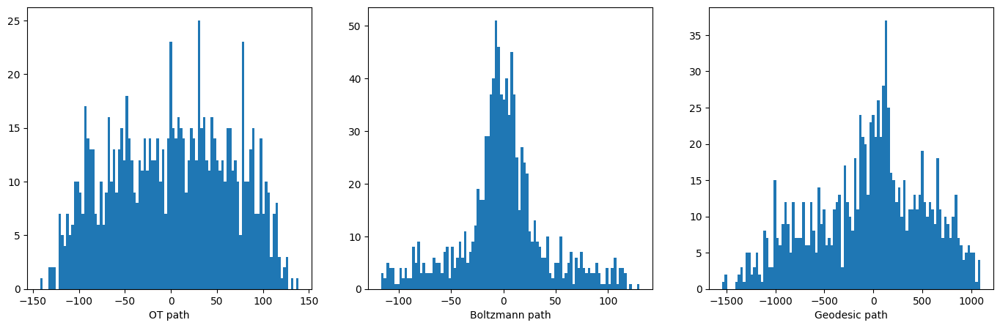

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7311 18794.152344 0.003000
    7321 12648.933594 0.001500
    7331 9426.498047 0.000750
    7341 9483.793945 0.000188
[144, 263873936.0]


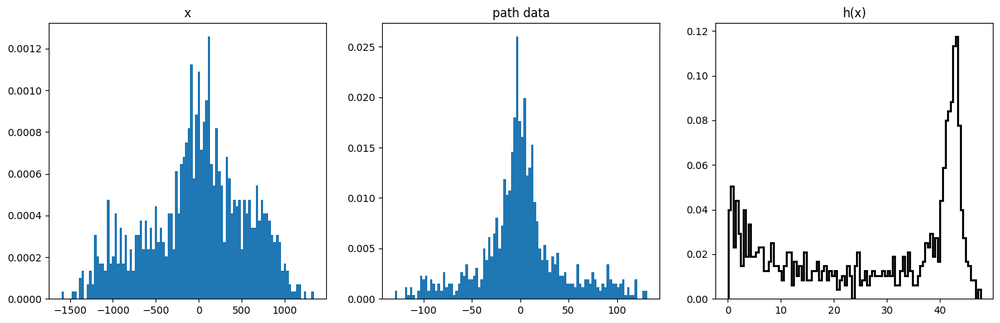

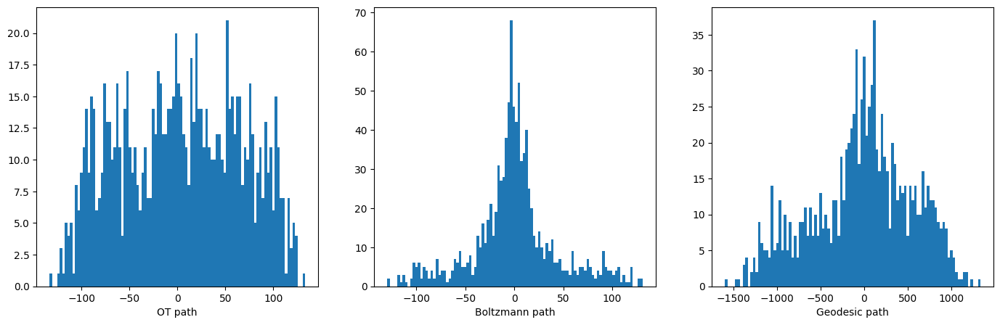

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7345 25070.175781 0.003000
    7355 16076.890625 0.001500
    7365 11315.574219 0.000750
    7375 11304.470703 0.000375
[145, 264944192.0]


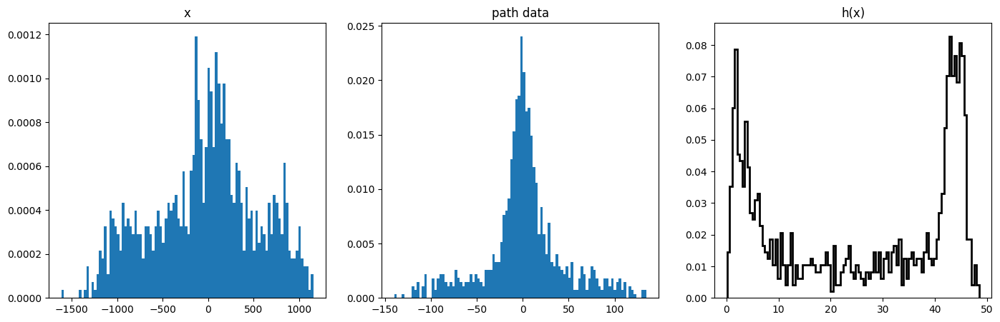

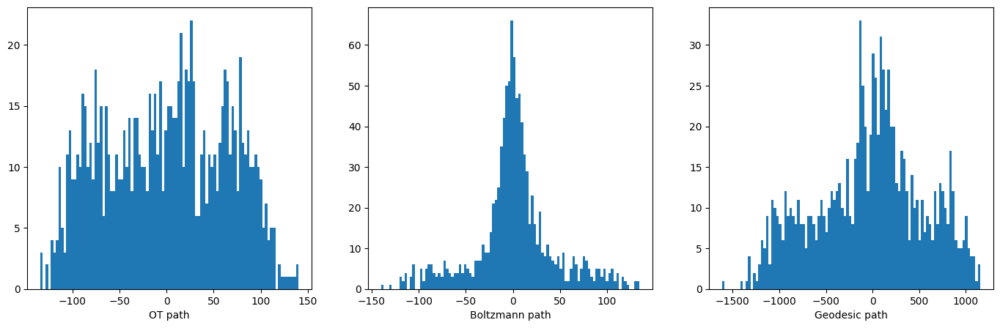

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7380 94639.828125 0.003000
    7390 39271.957031 0.001500
    7400 22584.951172 0.000375
[146, 139167424.0]


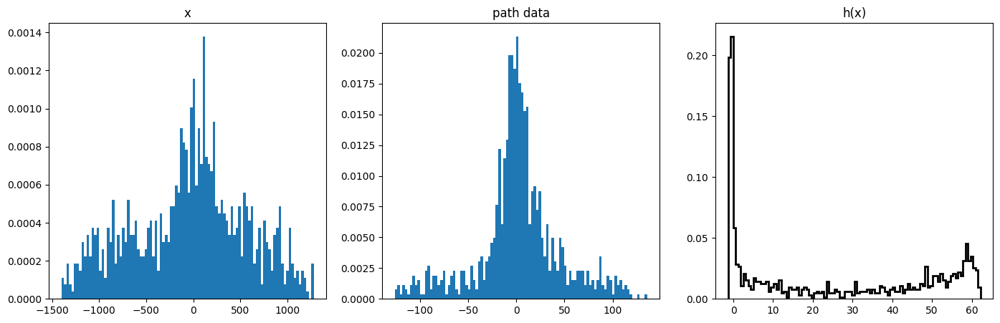

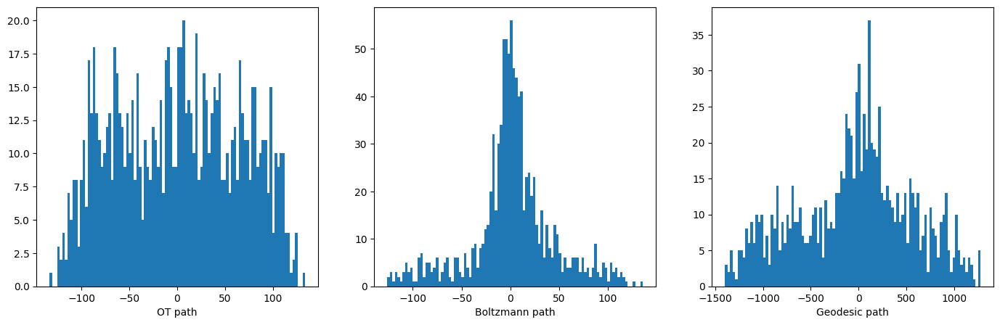

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7406 27450.382812 0.003000
    7416 28380.873047 0.000750
    7426 24029.800781 0.000750
    7436 23463.839844 0.000750
    7446 22220.009766 0.000750
[147, 369702656.0]


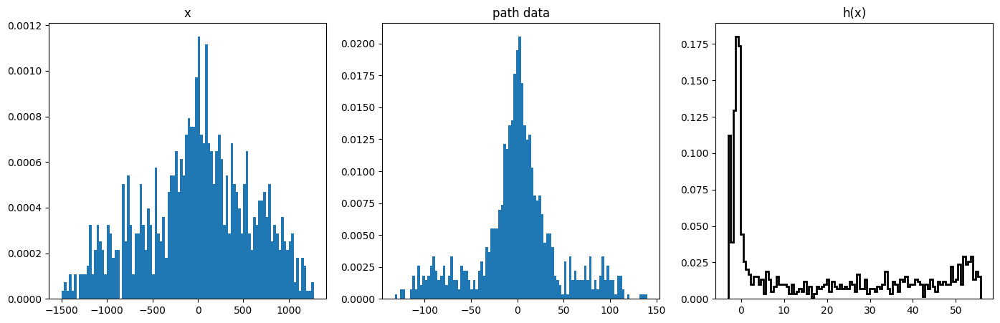

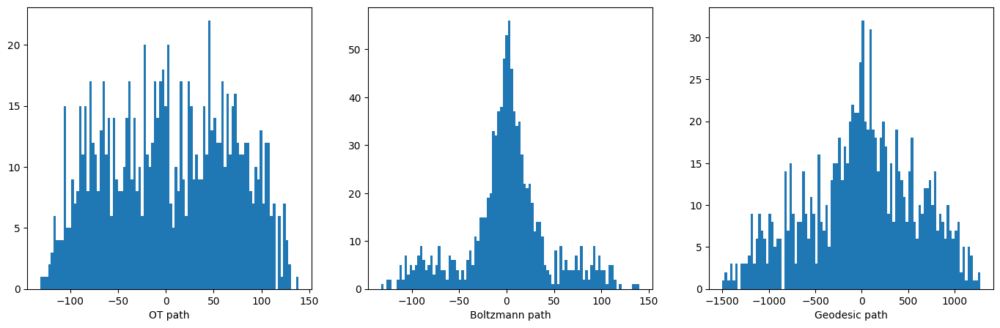

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7455 15265.291016 0.003000
    7465 14679.910156 0.003000
    7475 13843.749023 0.003000
    7485 13050.249023 0.003000
    7495 12385.144531 0.003000
[148, 229890960.0]


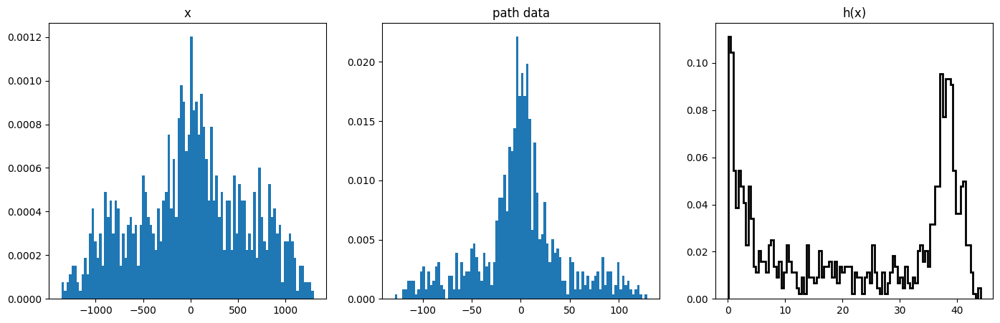

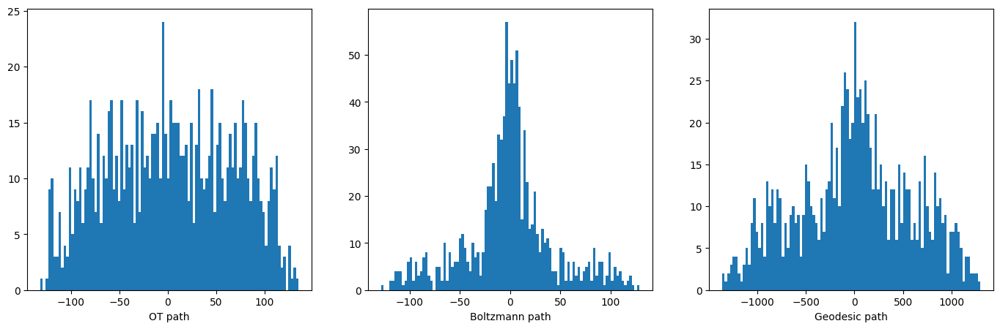

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7504 23127.355469 0.003000
    7514 19983.445312 0.003000
    7524 18489.935547 0.001500
    7534 17735.851562 0.001500
    7544 16830.335938 0.001500
[149, 216063088.0]


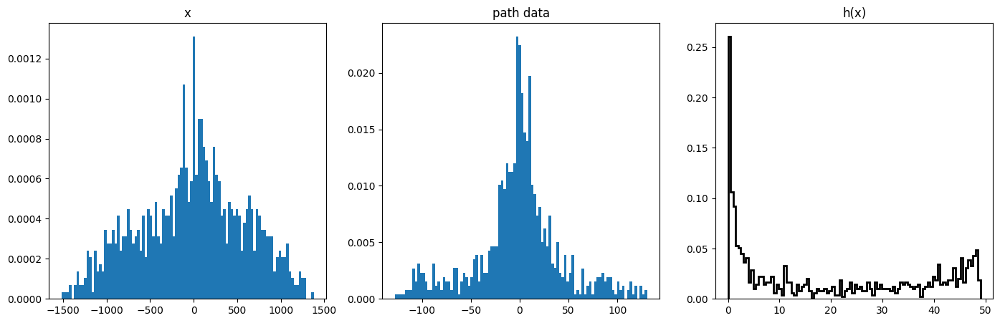

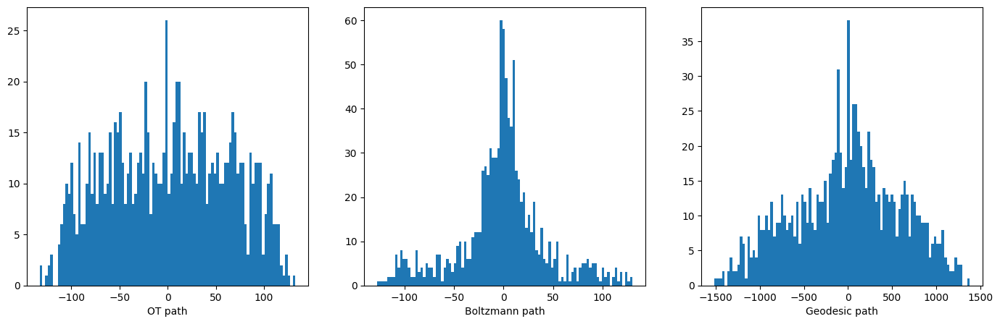

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7553 68259.250000 0.003000
    7563 33223.726562 0.001500
    7573 23170.193359 0.000375
    7583 20799.431641 0.000188
    7593 20040.152344 0.000188
[150, 231951696.0]


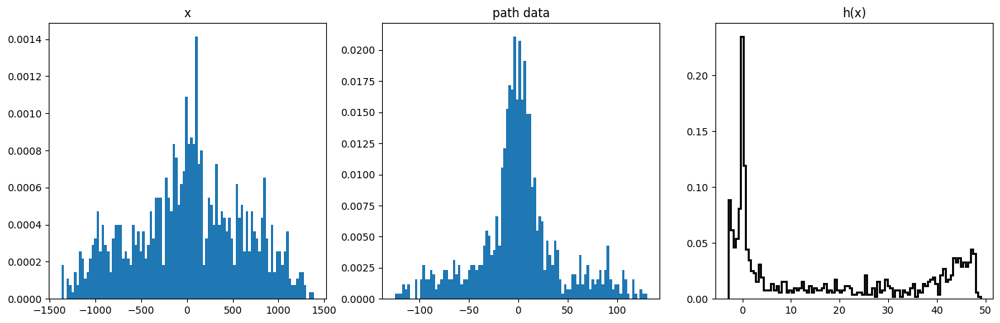

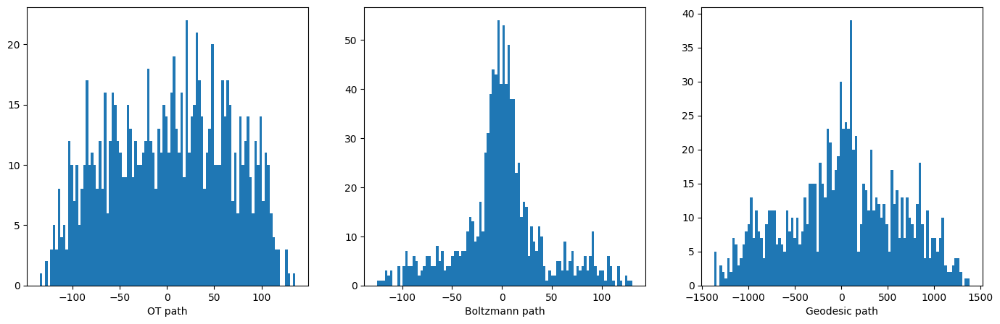

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7602 89131.304688 0.003000
    7612 39435.679688 0.001500
    7622 26750.664062 0.000375
[151, 177524880.0]


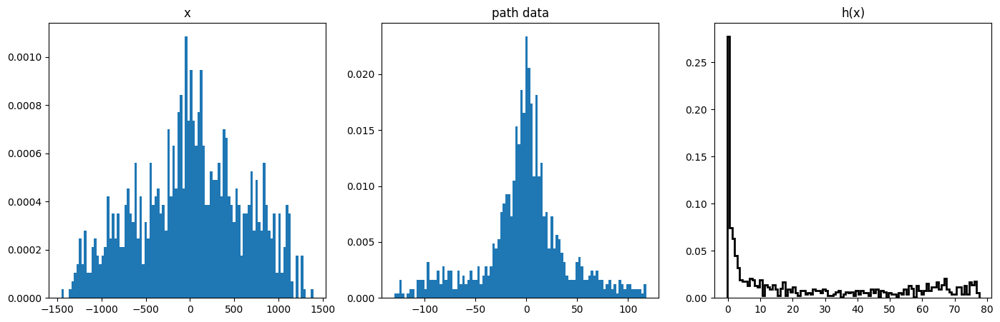

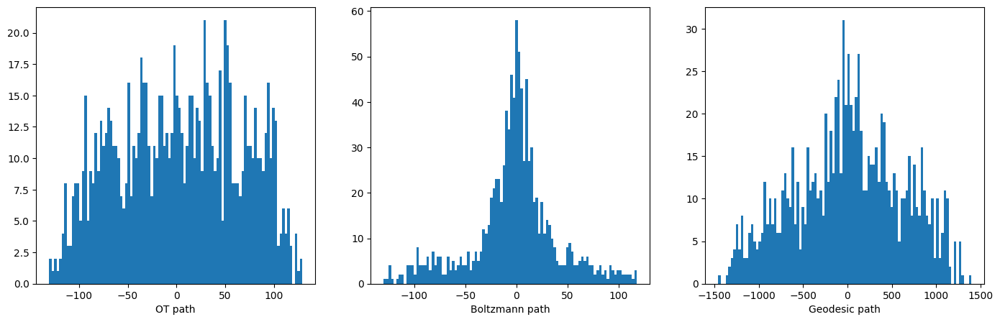

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7628 41638.355469 0.003000
    7638 26352.320312 0.001500
    7648 13448.423828 0.000188
[152, 167212832.0]


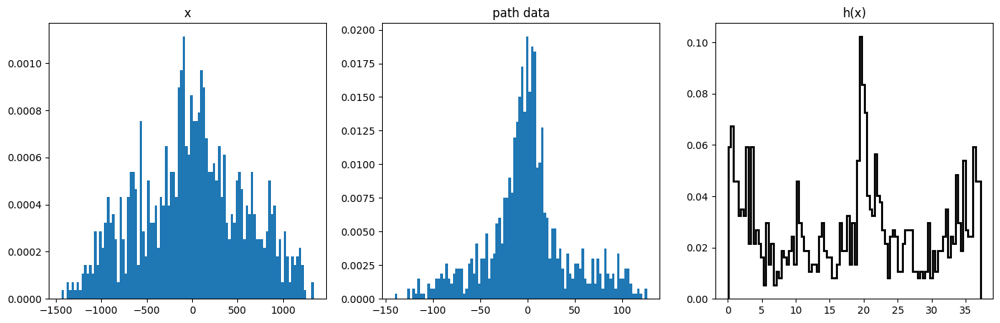

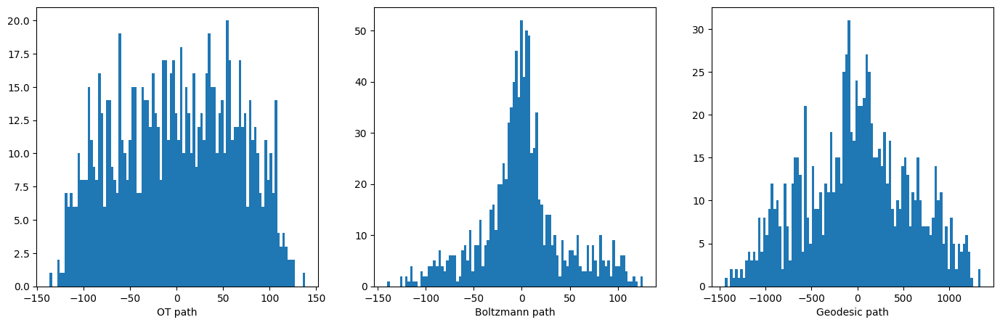

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7652 15020.708008 0.003000
    7662 16973.845703 0.000750
    7672 13055.301758 0.000188
[153, 241665616.0]


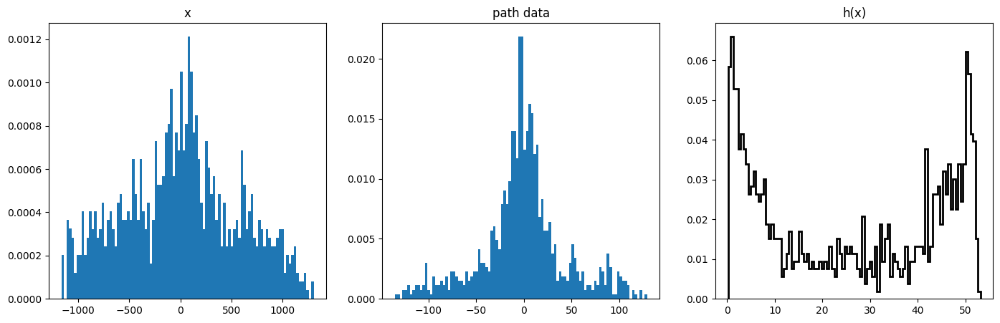

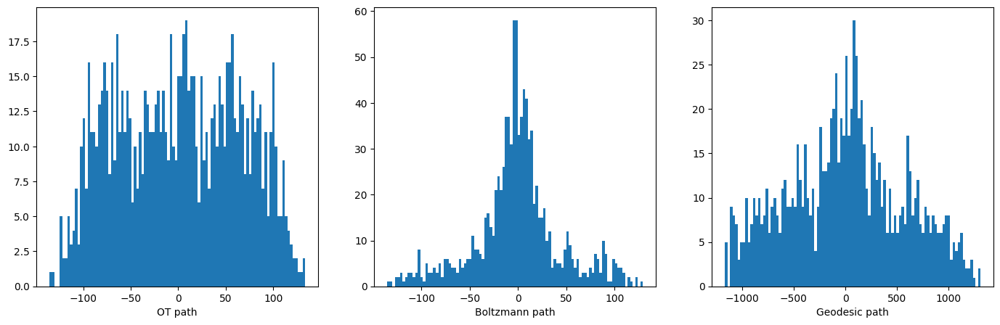

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7674 62162.515625 0.003000
    7684 20344.644531 0.003000
    7694 21281.402344 0.000375
[154, 176452736.0]


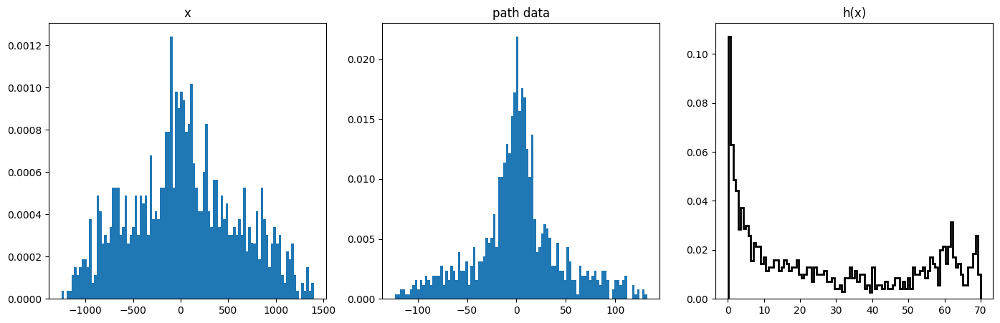

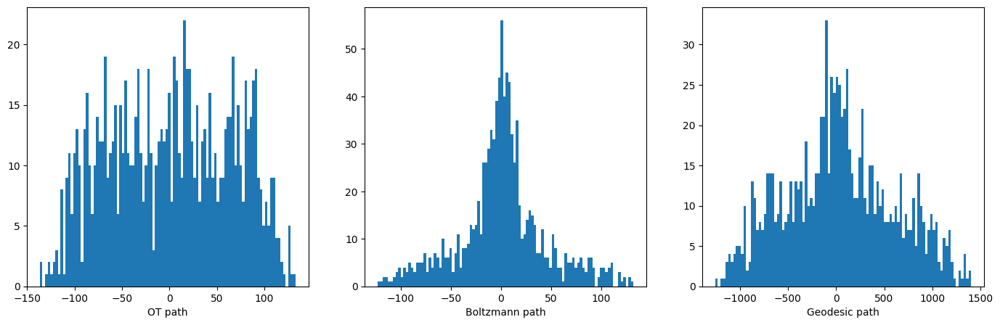

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7702 66599.437500 0.003000
    7712 31981.908203 0.001500
    7722 18864.996094 0.000375
[155, 407793792.0]


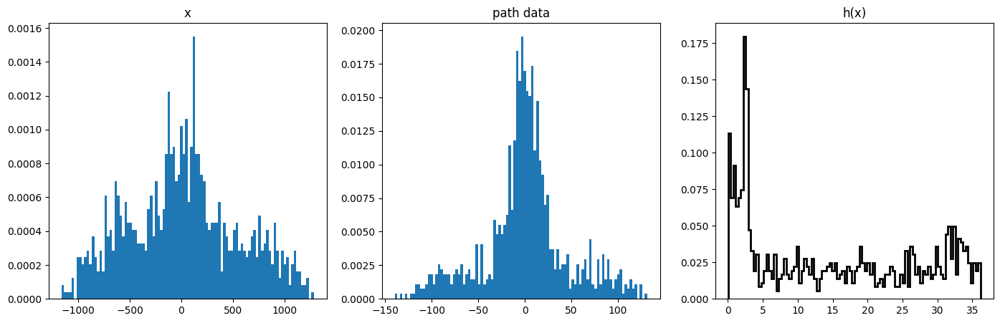

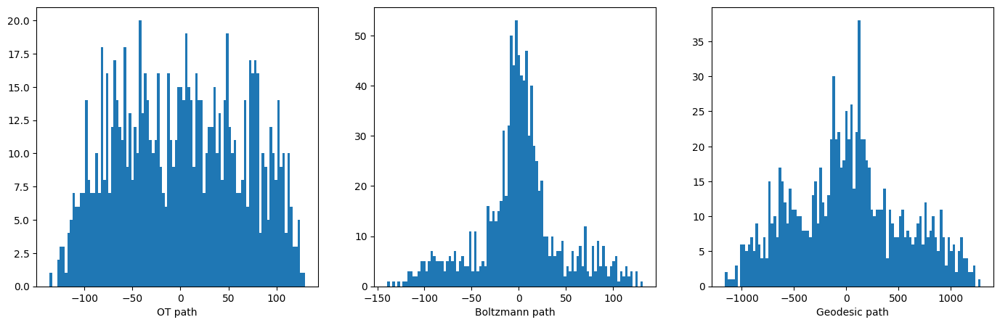

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7727 23215.025391 0.003000
    7737 19510.634766 0.001500
    7747 13524.592773 0.000188
[156, 200035632.0]


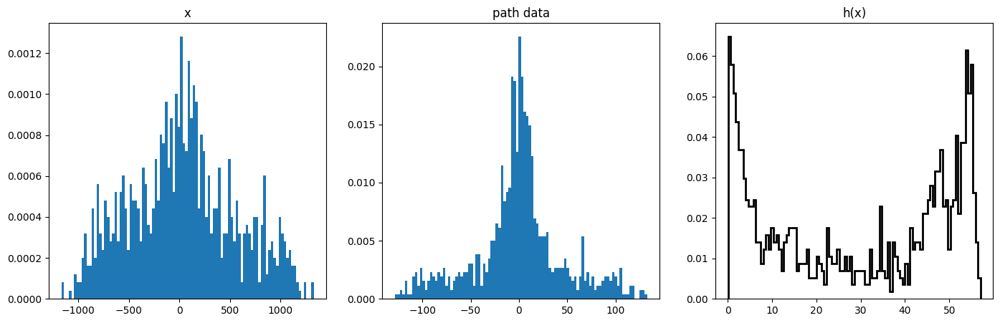

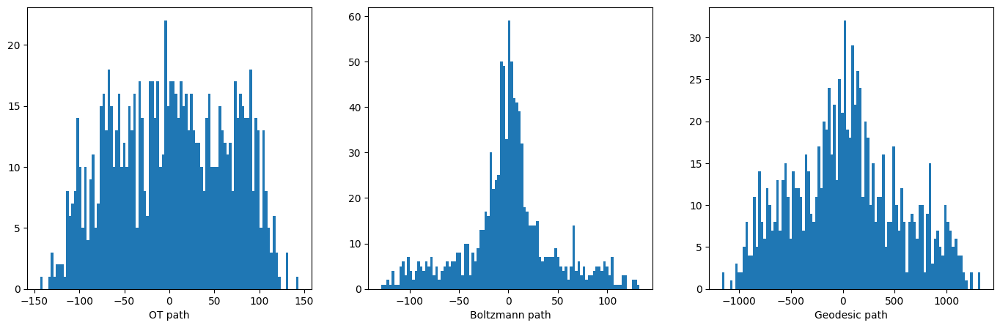

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7750 19010.919922 0.003000
    7760 17807.962891 0.001500
    7770 14628.527344 0.000188
    7780 13986.966797 0.000188
    7790 13615.300781 0.000188
[157, 388087520.0]


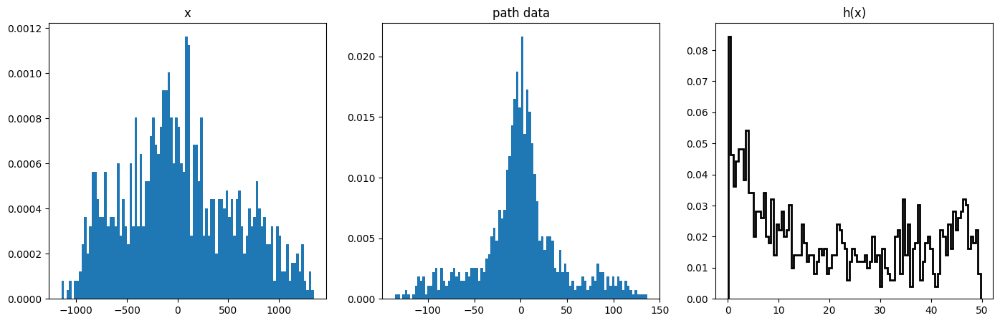

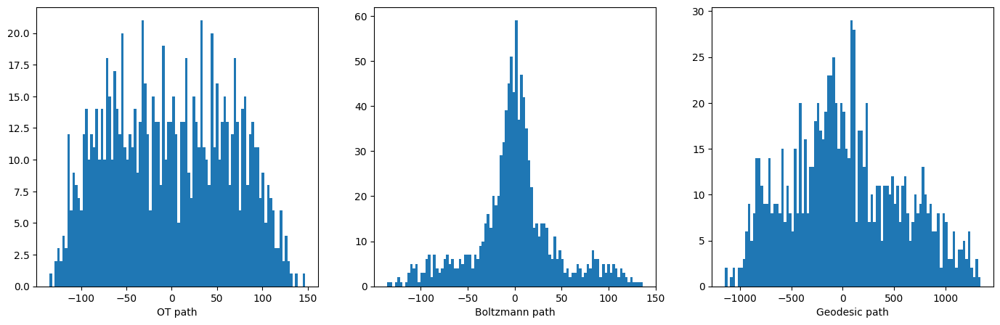

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7799 19965.542969 0.003000
    7809 16007.665039 0.001500
    7819 14832.497070 0.000375
    7829 14299.512695 0.000375
    7839 14070.672852 0.000375
[158, 232493856.0]


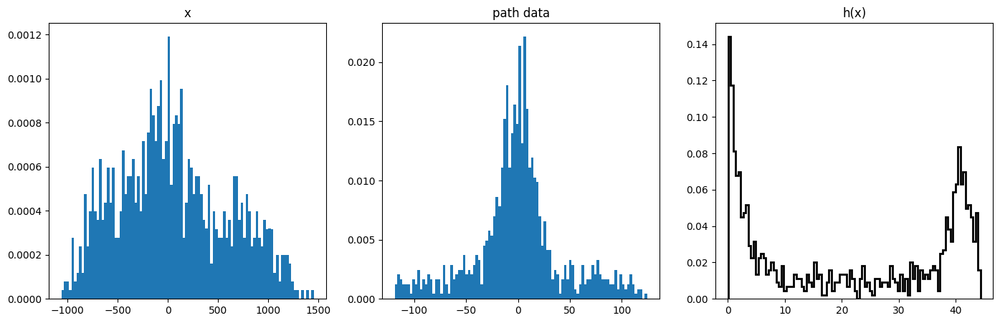

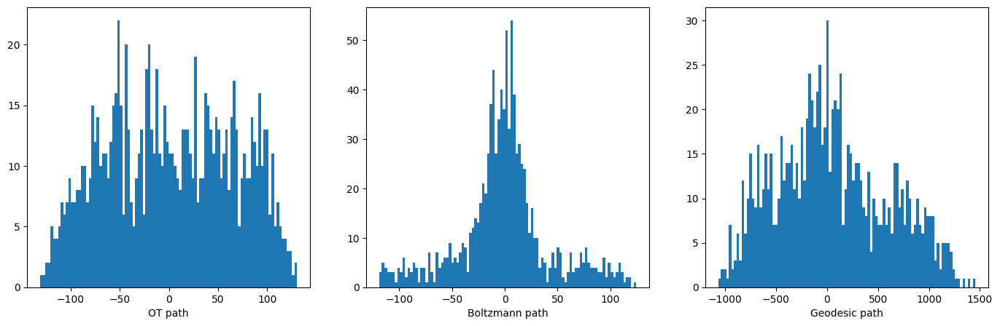

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7848 49397.613281 0.003000
    7858 17131.482422 0.003000
    7868 14802.803711 0.000375
[159, 314758528.0]


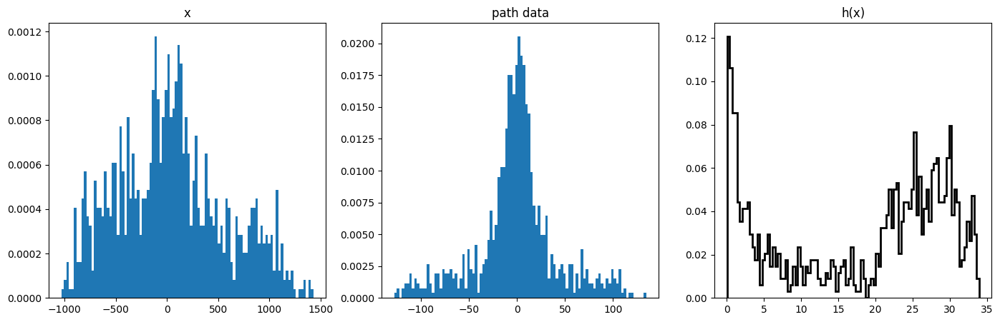

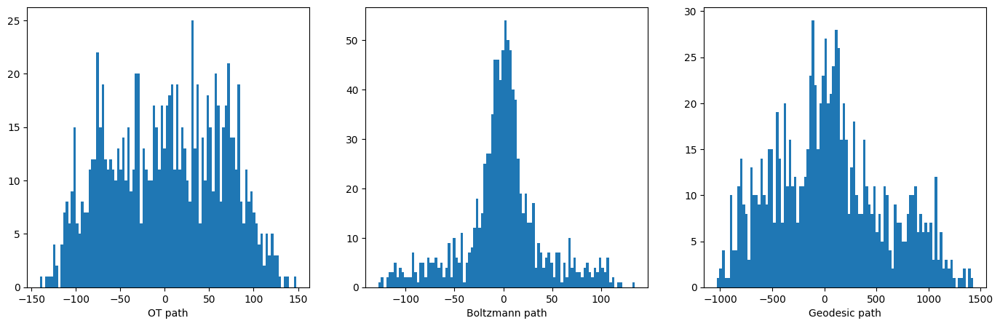

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7875 44232.527344 0.003000
    7885 24780.958984 0.001500
    7895 17870.746094 0.000375
[160, 128308608.0]


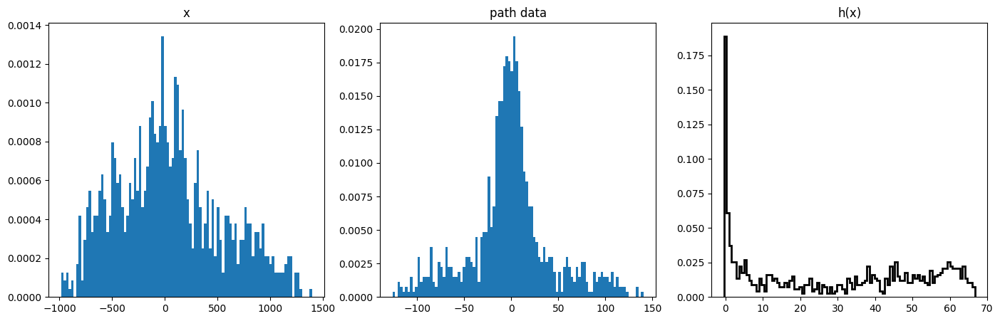

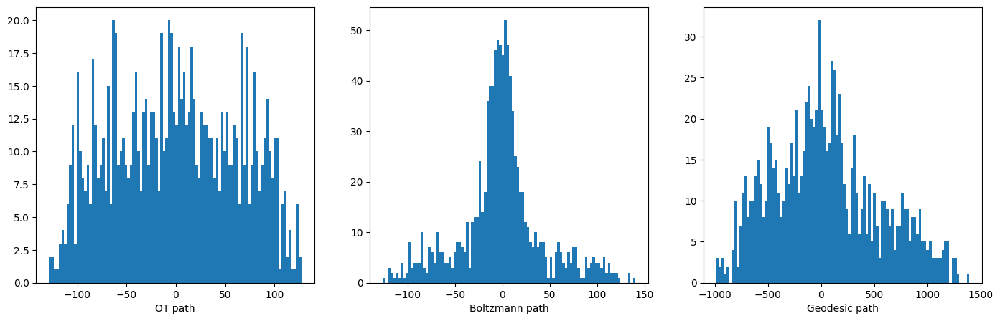

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7900 26035.275391 0.003000
    7910 24711.541016 0.000750
    7920 21219.207031 0.000750
    7930 20641.050781 0.000750
    7940 19905.699219 0.000750
[161, 108570120.0]


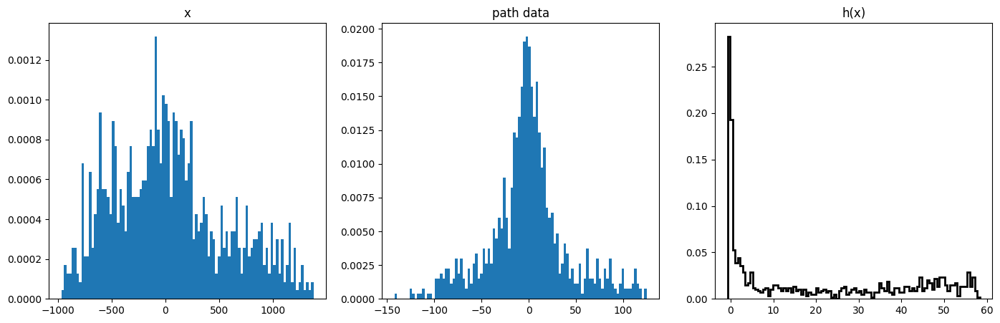

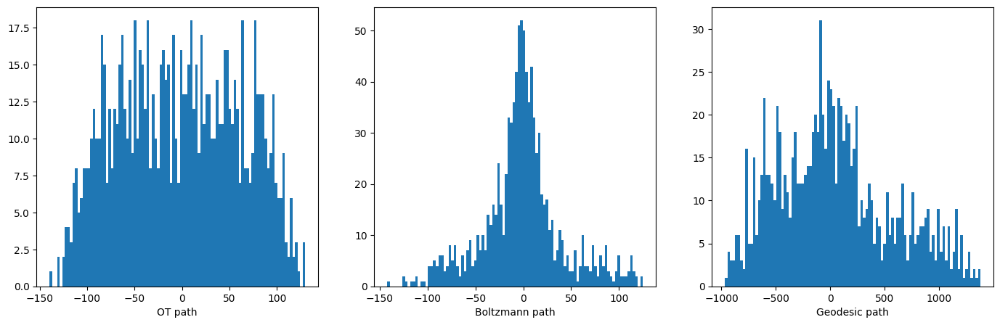

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7949 81306.320312 0.003000
    7959 21787.685547 0.003000
    7969 17445.105469 0.000375
[162, 358052576.0]


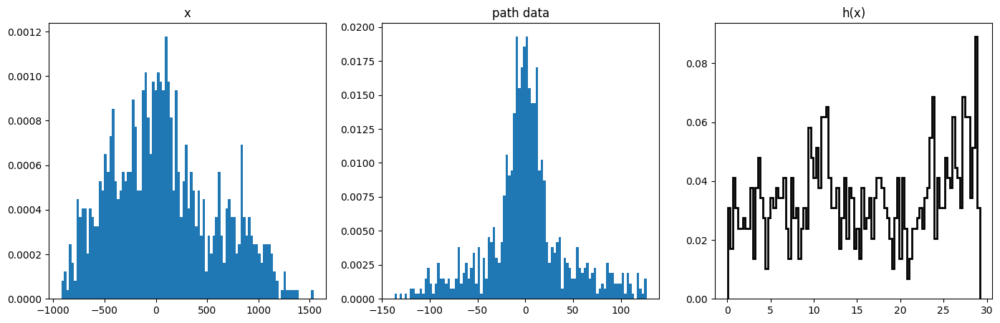

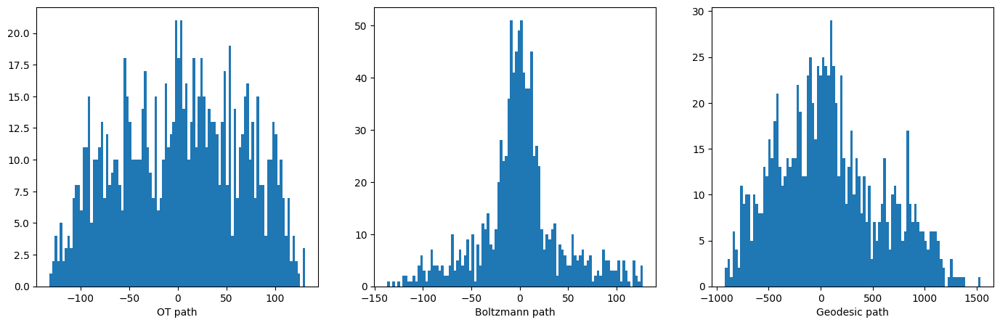

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    7976 33918.679688 0.003000
    7986 21160.093750 0.001500
    7996 14856.947266 0.000188
[163, 237888000.0]


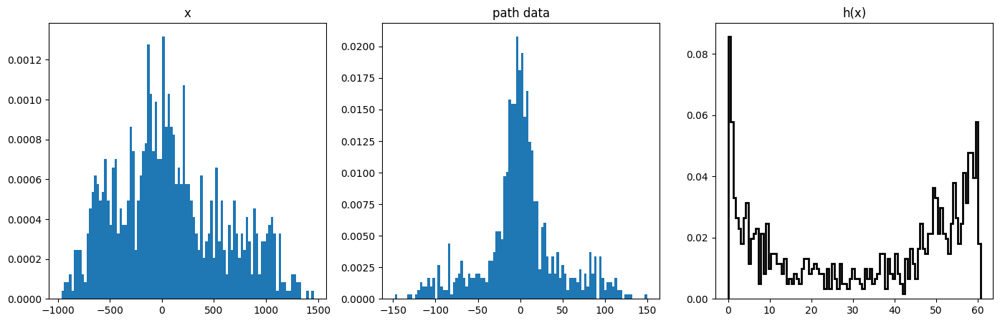

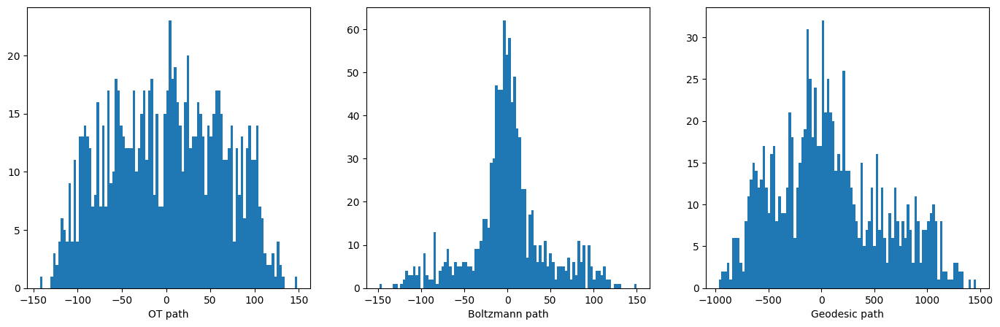

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8000 27124.841797 0.003000
    8010 12677.234375 0.001500
    8020 10975.305664 0.000750
    8030 10803.997070 0.000094
[164, 127529048.0]


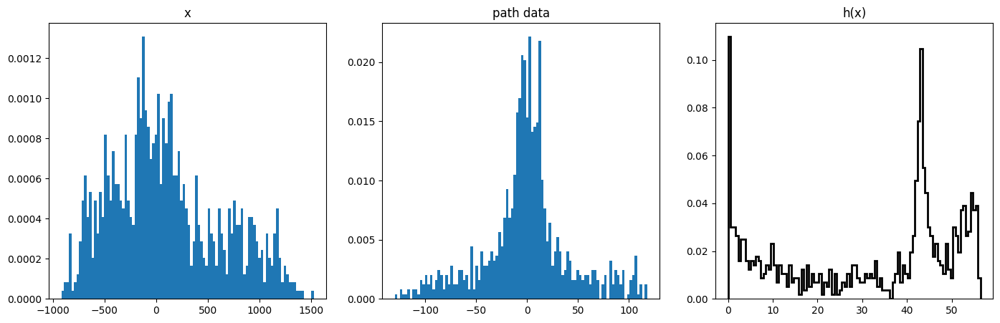

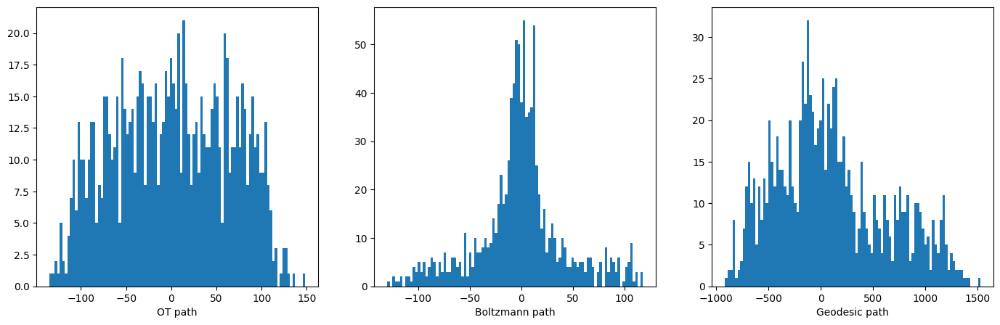

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8030 33591.718750 0.003000
    8040 18493.041016 0.001500
    8050 15699.566406 0.000375
[165, 681315584.0]


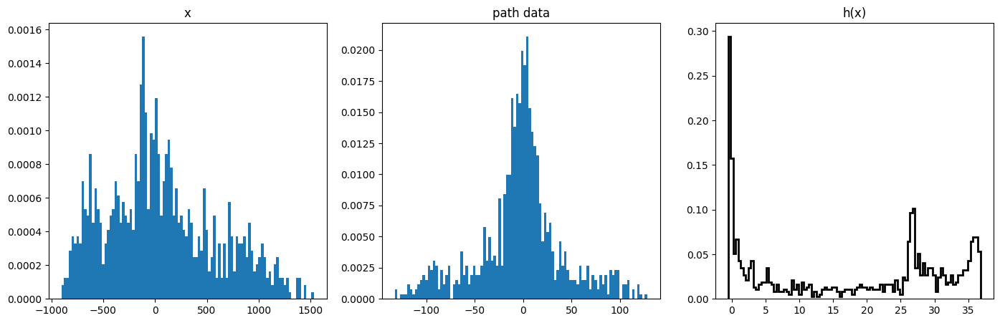

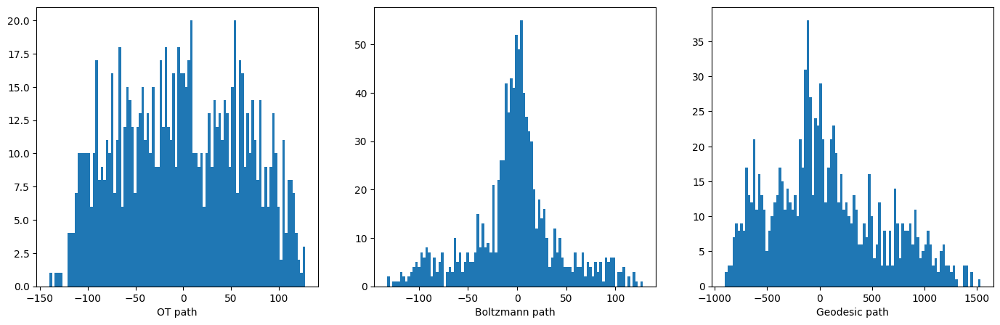

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8056 15612.007812 0.003000
    8066 12390.788086 0.001500
    8076 9932.681641 0.000188
[166, 230818496.0]


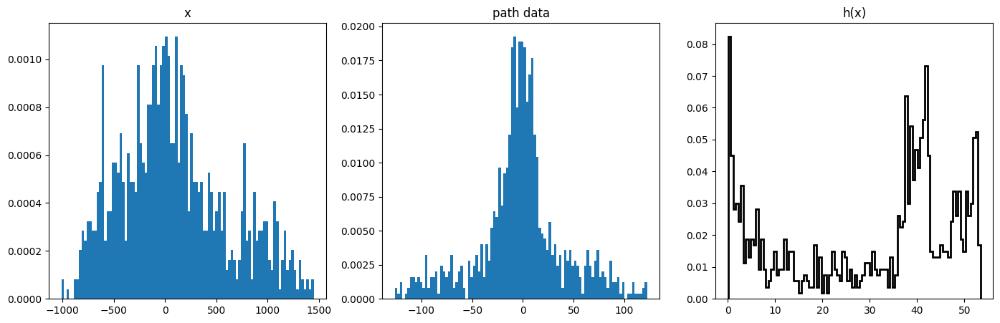

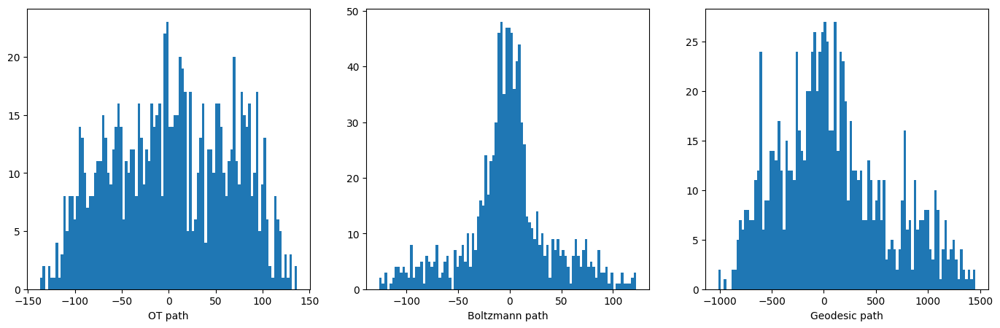

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8080 43665.171875 0.003000
    8090 31211.792969 0.003000
    8100 31075.326172 0.000750
    8110 28624.789062 0.000750
    8120 27663.214844 0.000750
[167, 145671136.0]


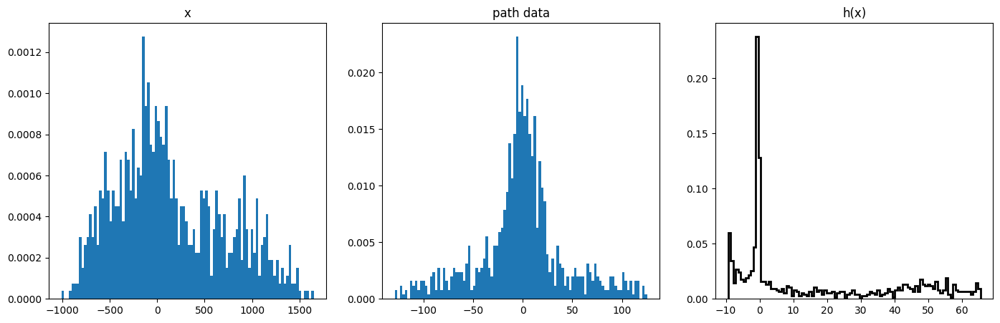

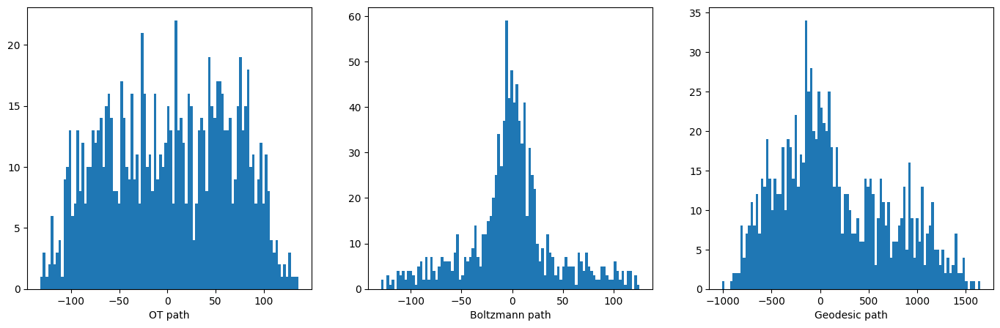

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8129 10200.104492 0.003000
    8139 9881.698242 0.003000
    8149 9654.771484 0.003000
    8159 9465.013672 0.003000
    8169 9290.161133 0.003000
[168, 342815584.0]


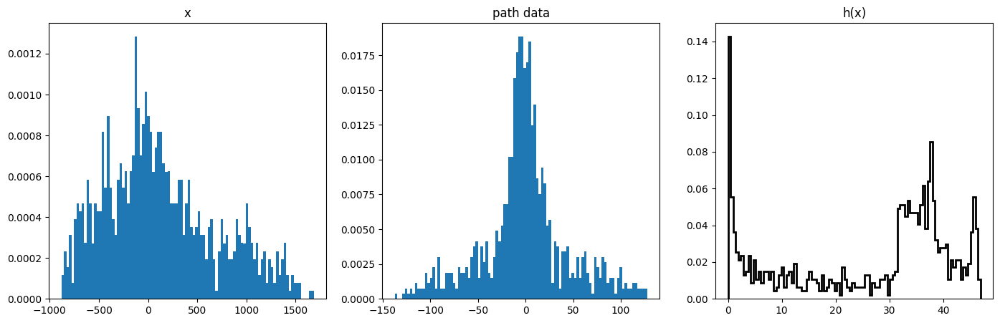

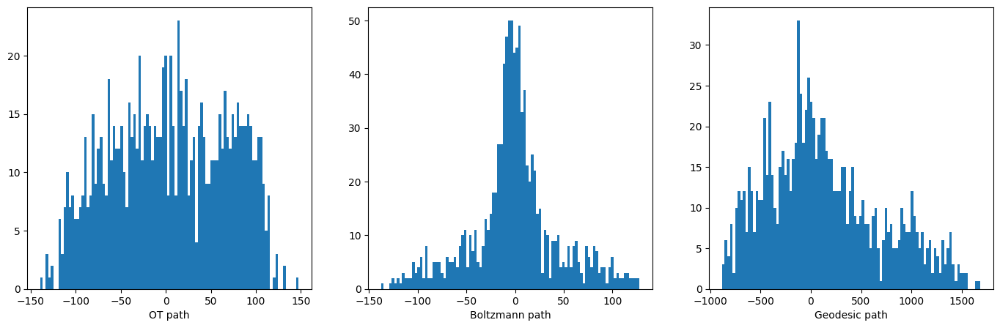

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8178 22544.947266 0.003000
    8188 20303.078125 0.003000
    8198 18055.097656 0.003000
    8208 16033.042969 0.003000
    8218 14262.513672 0.003000
[169, 240910432.0]


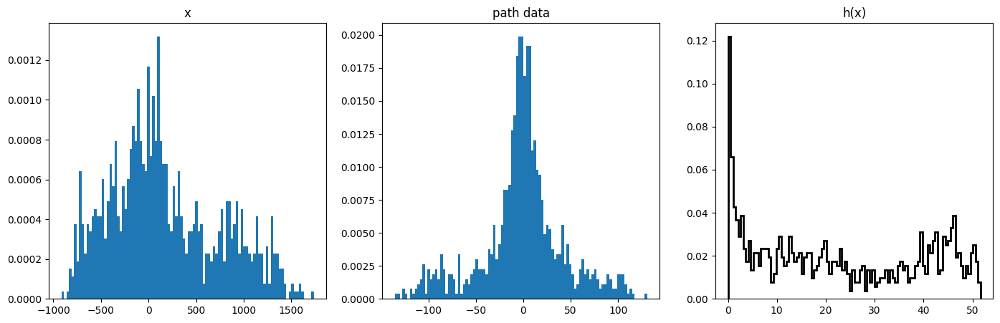

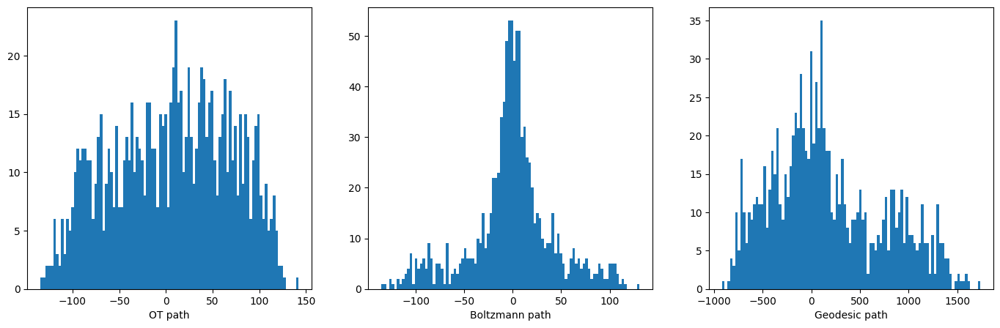

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8227 17305.128906 0.003000
    8237 12233.636719 0.003000
    8247 11882.112305 0.000375
    8257 11342.484375 0.000375
    8267 11098.253906 0.000375
[170, 404506976.0]


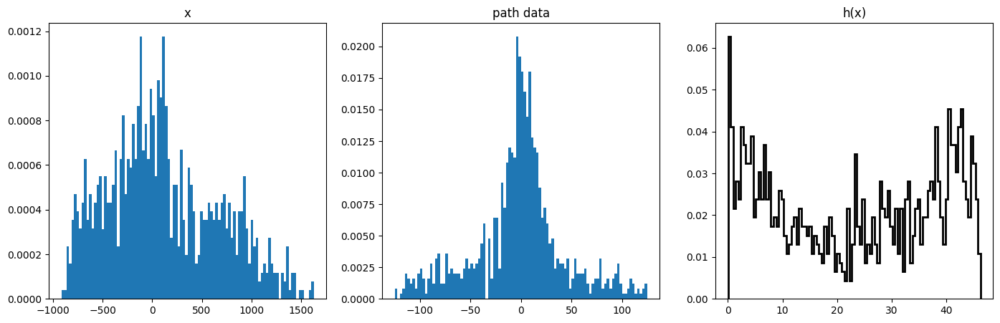

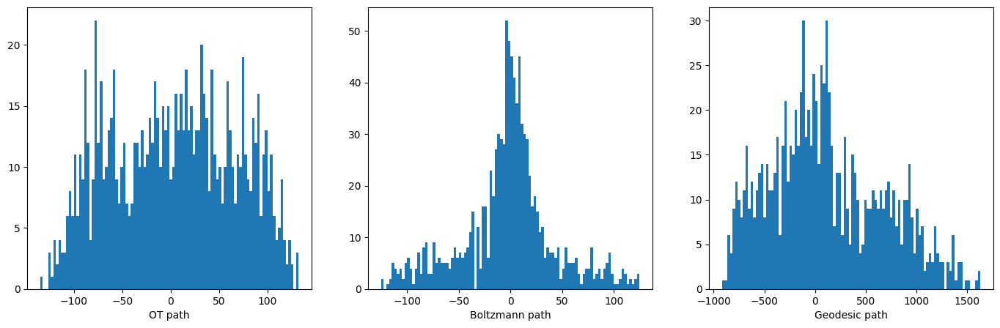

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8276 10686.349609 0.003000
    8286 9919.261719 0.003000
    8296 9898.838867 0.000750
    8306 9766.177734 0.000750
    8316 9724.254883 0.000750
[171, 369057024.0]


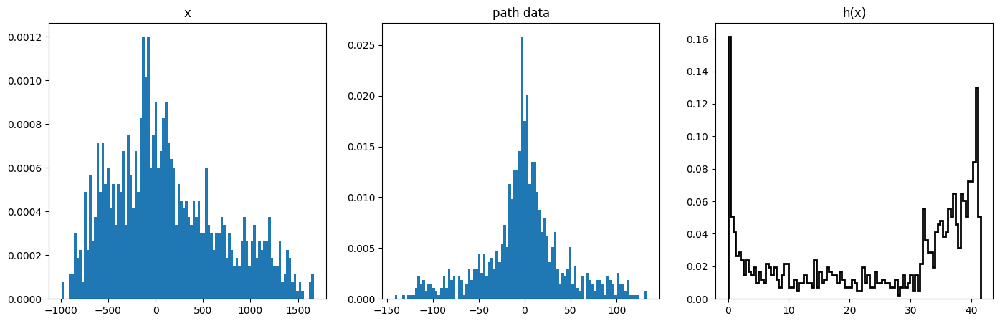

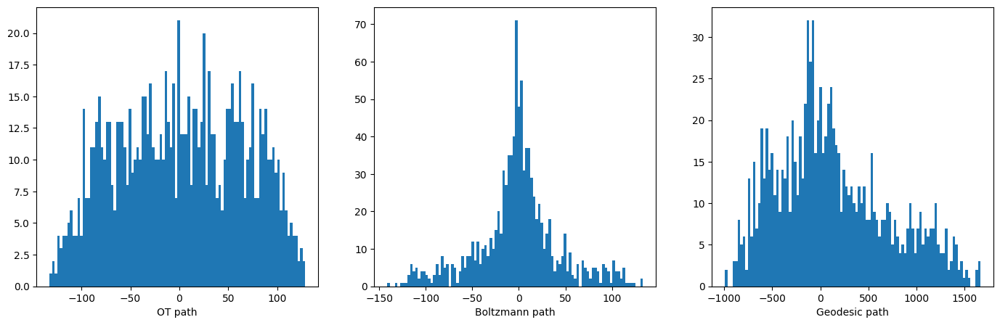

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8325 18097.068359 0.003000
    8335 12732.666016 0.003000
    8345 12461.914062 0.000375
    8355 12044.768555 0.000188
    8365 11840.895508 0.000188
[172, 261156656.0]


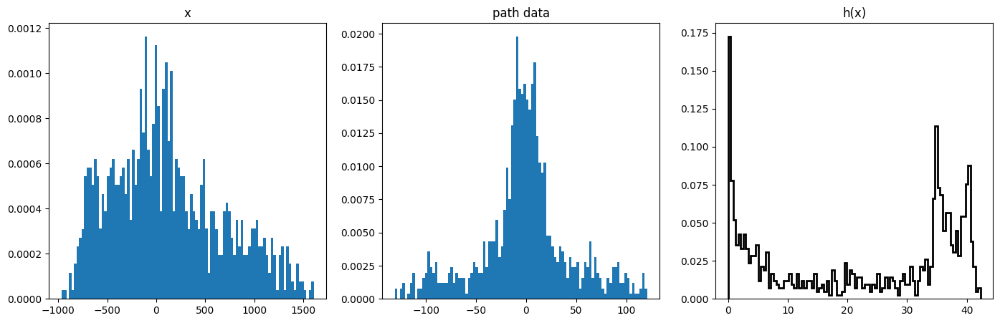

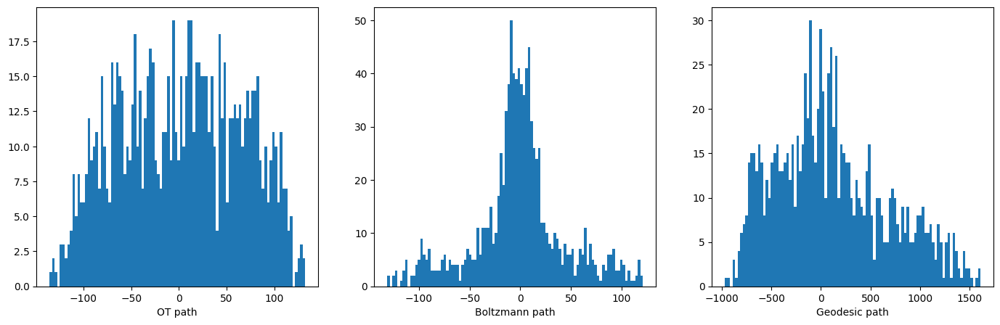

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8374 34838.058594 0.003000
    8384 17644.636719 0.003000
    8394 18175.558594 0.000375
[173, 164894768.0]


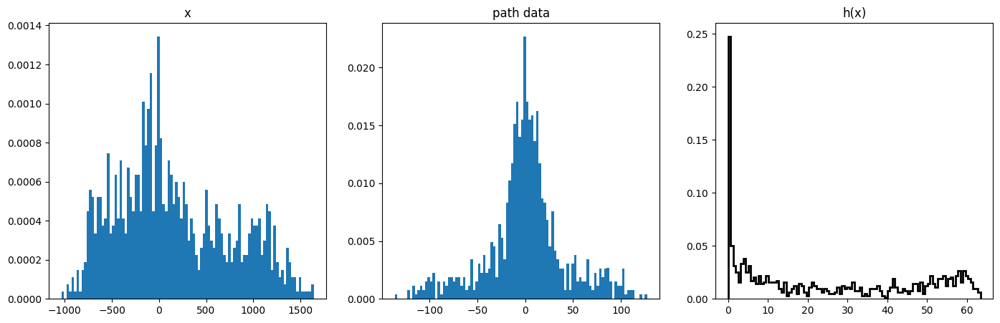

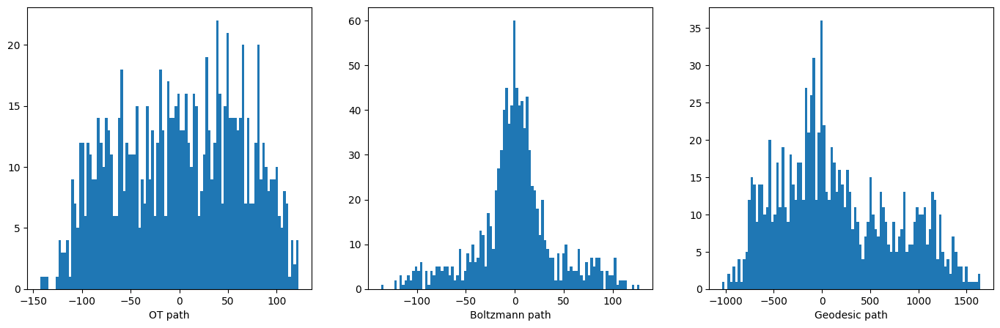

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8402 33270.835938 0.003000
    8412 19355.876953 0.001500
    8422 16342.008789 0.000375
[174, 221491840.0]


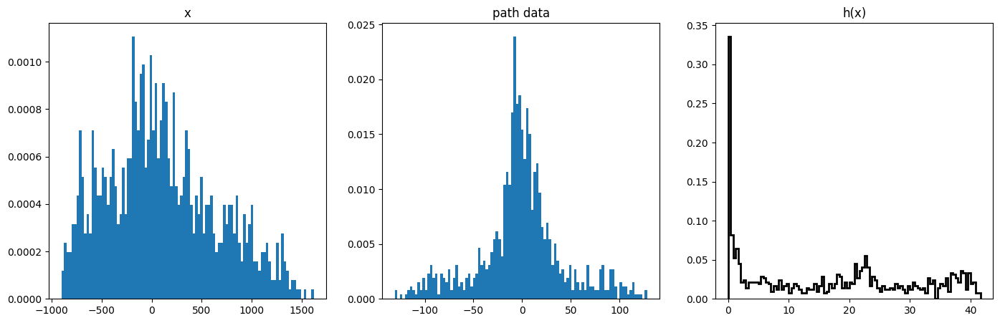

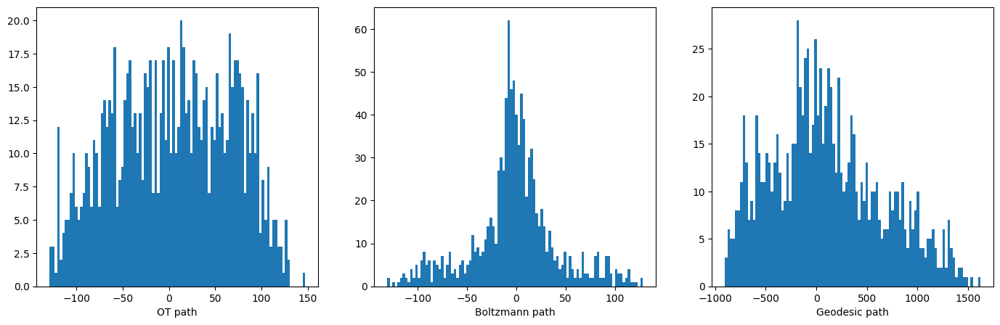

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8428 12200.119141 0.003000
    8438 12638.471680 0.000750
    8448 11602.781250 0.000375
    8458 11304.997070 0.000375
    8468 11205.651367 0.000375
[175, 288433120.0]


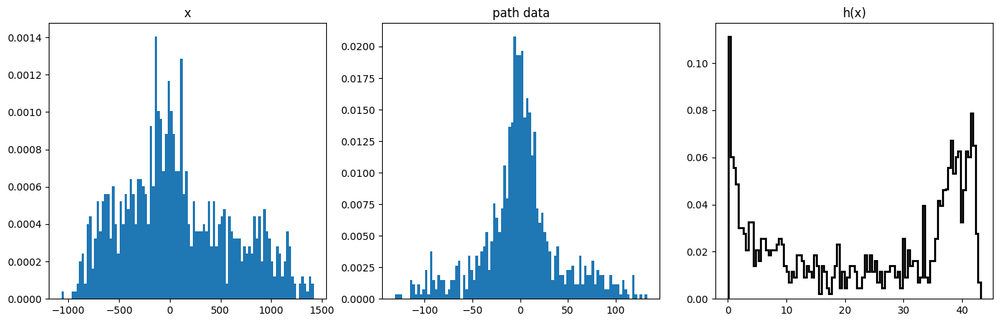

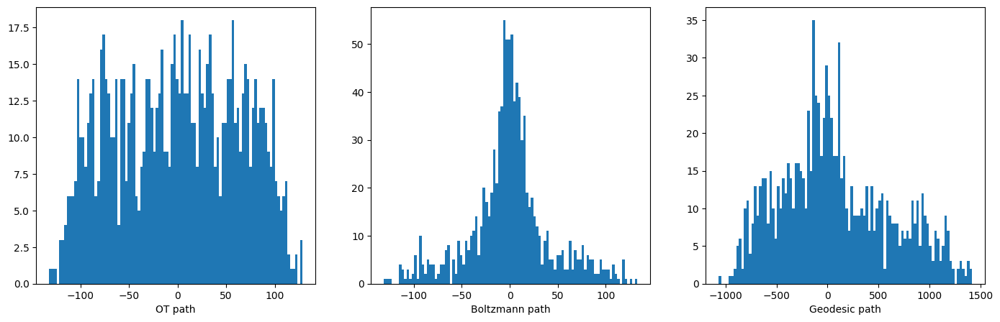

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8477 23519.914062 0.003000
    8487 17173.492188 0.003000
    8497 15584.859375 0.000750
    8507 14622.416016 0.000750
    8517 14280.716797 0.000750
[176, 233068672.0]


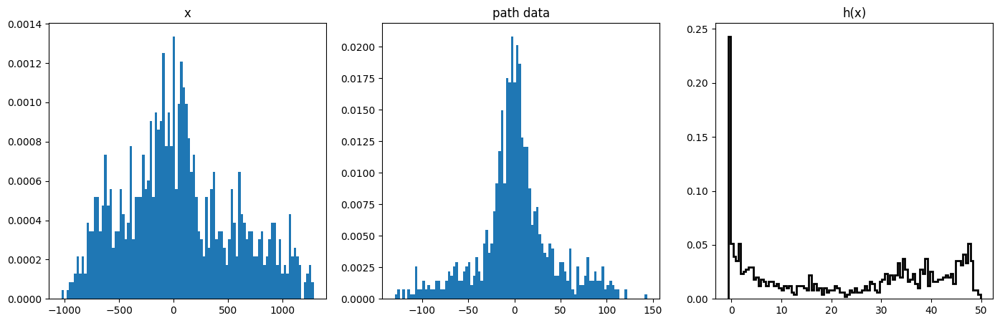

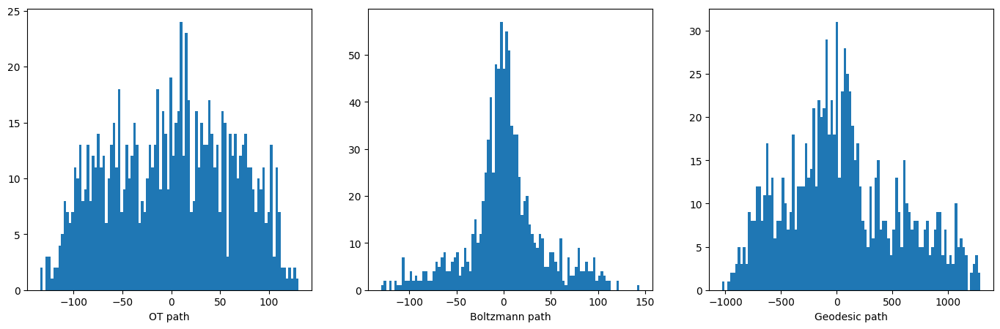

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8526 15872.152344 0.003000
    8536 14446.510742 0.003000
    8546 12730.853516 0.003000
    8556 11263.000000 0.003000
    8566 10083.009766 0.003000
[177, 233939808.0]


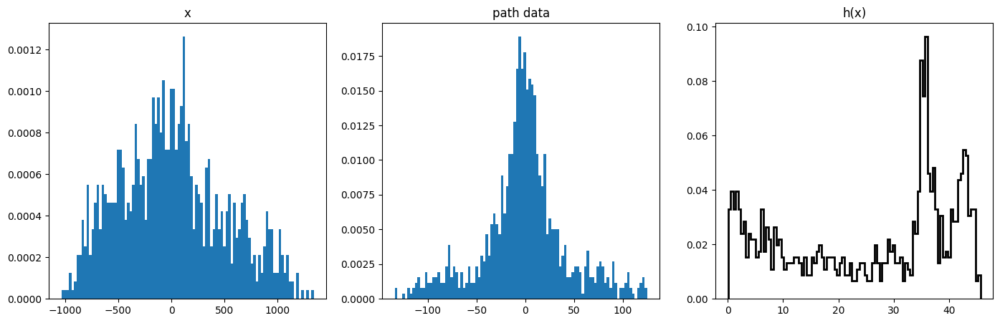

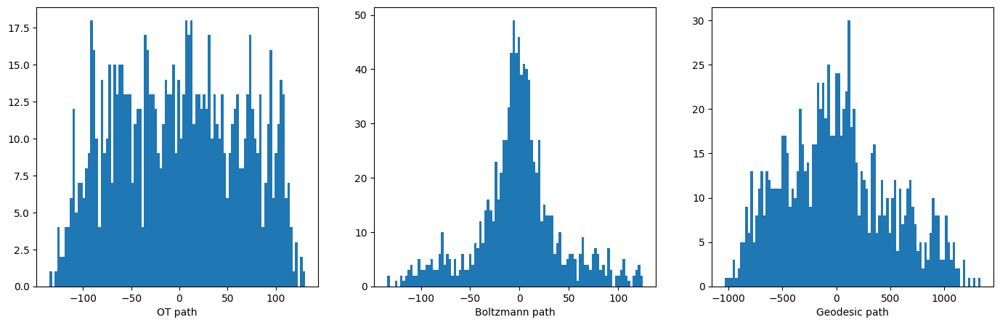

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8575 41992.195312 0.003000
    8585 22690.238281 0.003000
    8595 19359.890625 0.000375
    8605 17437.876953 0.000375
    8615 16734.660156 0.000375
[178, 196156960.0]


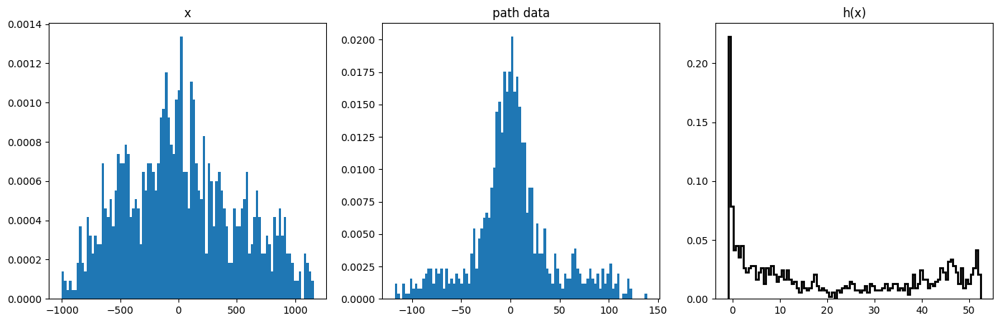

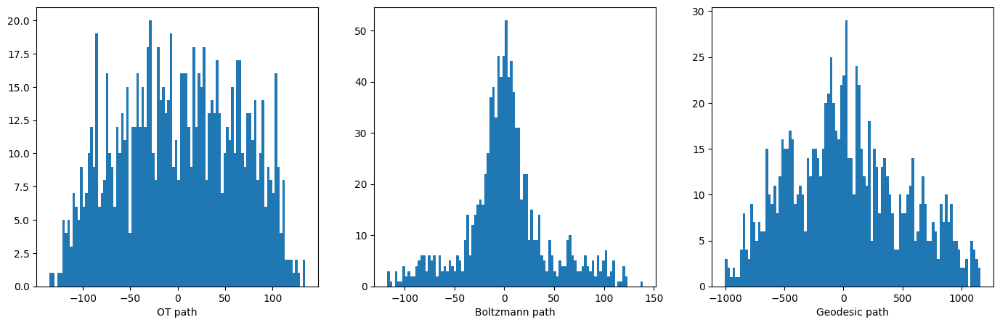

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8624 24579.798828 0.003000
    8634 21967.509766 0.003000
    8644 18711.642578 0.003000
    8654 15828.060547 0.003000
    8664 13463.768555 0.003000
[179, 119033624.0]


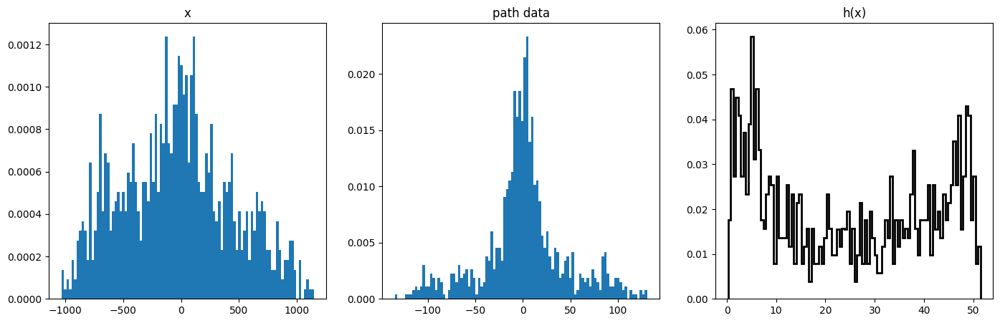

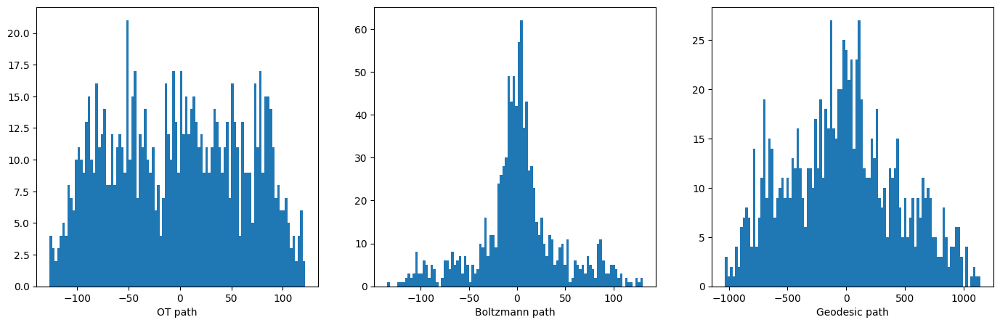

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8673 12287.014648 0.003000
    8683 9539.048828 0.001500
    8693 8564.833984 0.000750
    8703 8120.194824 0.000750
    8713 7890.801270 0.000750
[180, 163313744.0]


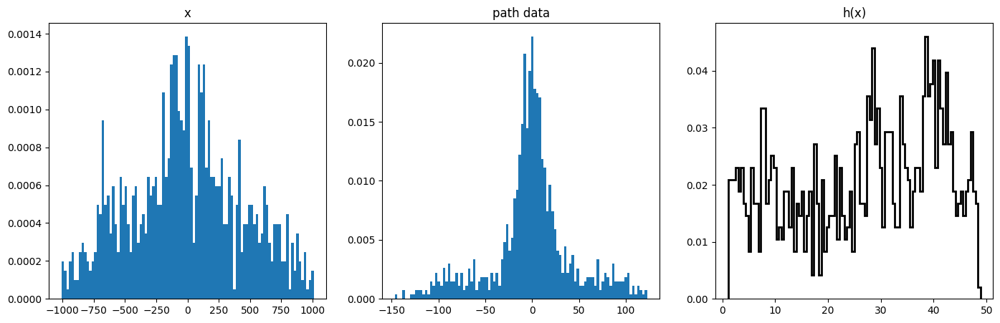

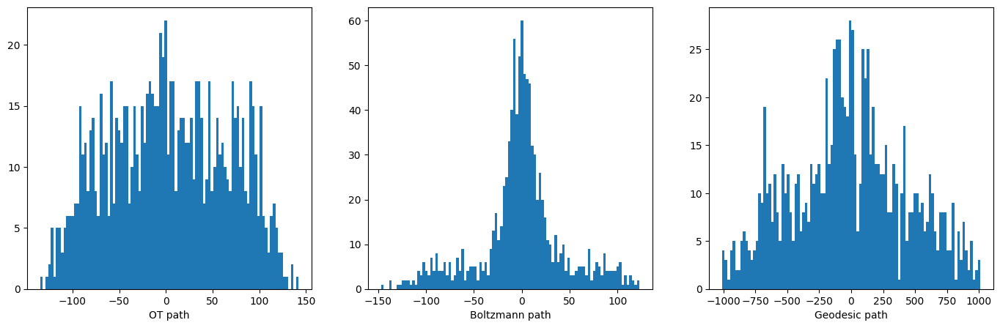

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8722 12986.647461 0.003000
    8732 10824.545898 0.003000
    8742 10476.624023 0.000750
    8752 10105.825195 0.000750
    8762 9972.904297 0.000750
[181, 360381728.0]


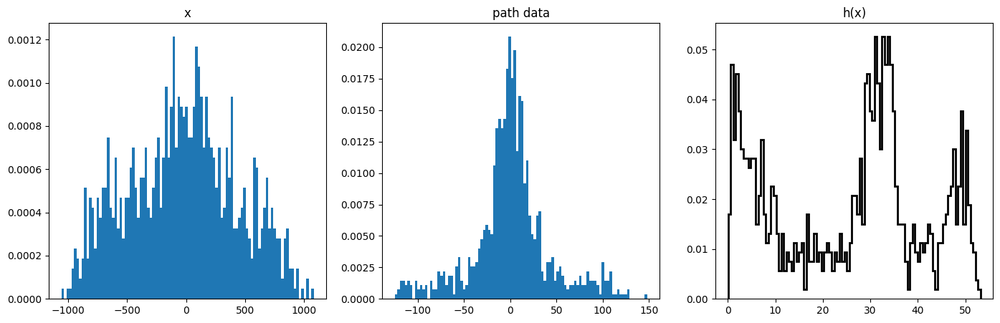

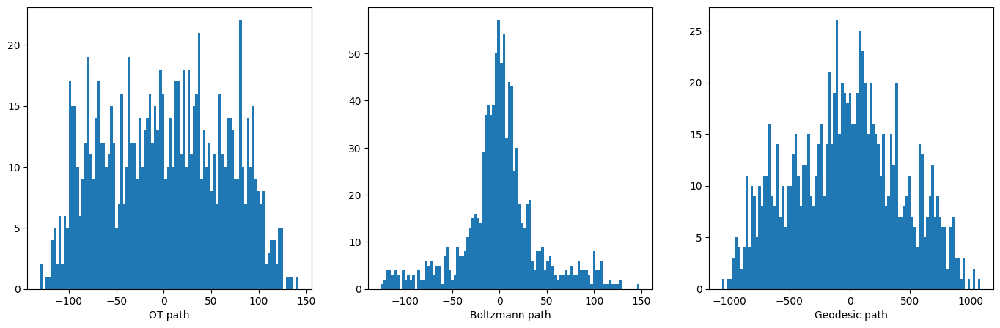

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8771 11337.868164 0.003000
    8781 8094.497070 0.003000
    8791 7222.357422 0.000750
    8801 6782.687500 0.000750
    8811 6627.553223 0.000750
[182, 276363552.0]


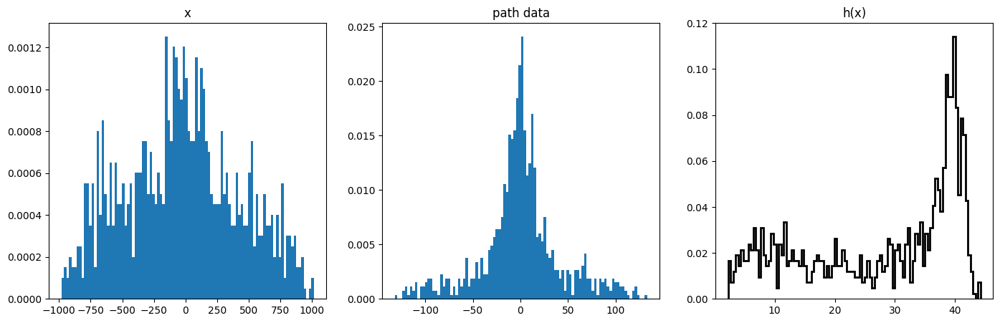

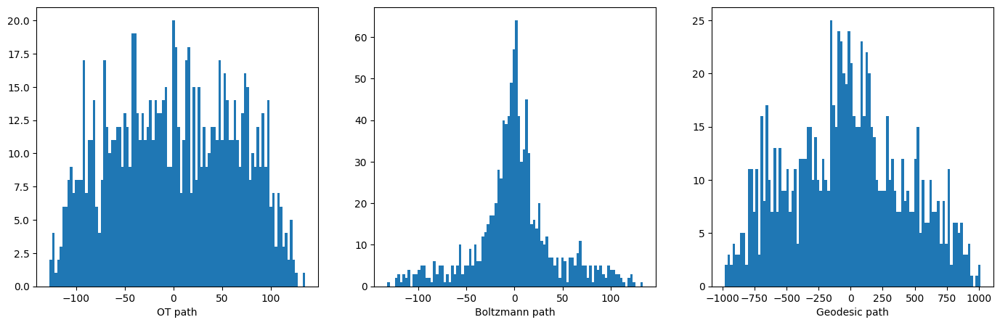

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8820 32411.117188 0.003000
    8830 14746.077148 0.003000
    8840 10939.593750 0.000375
    8850 9495.985352 0.000375
    8860 9206.718750 0.000375
[183, 247265776.0]


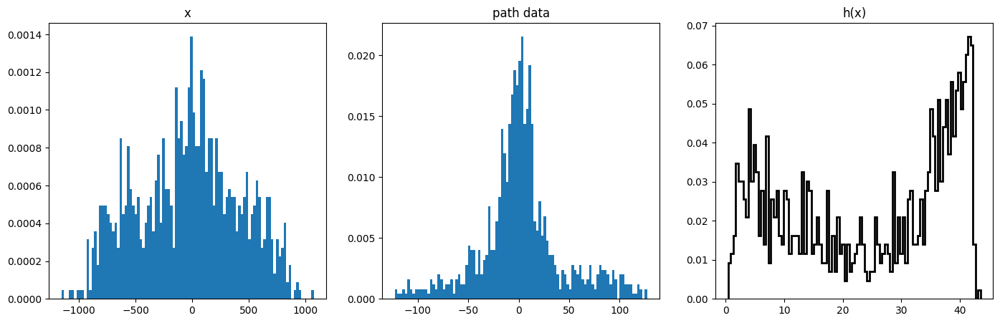

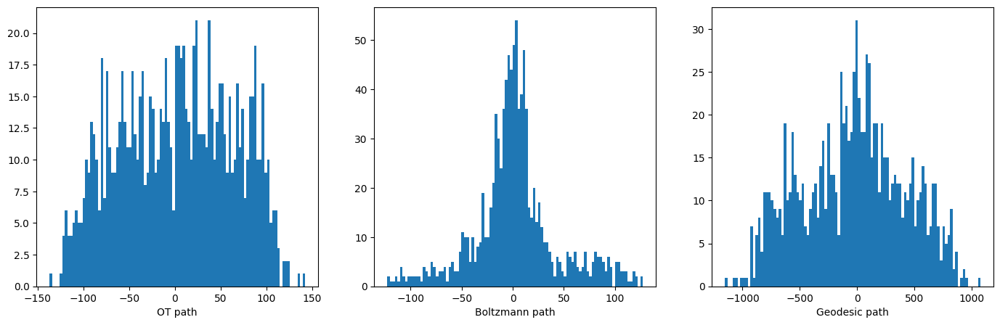

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8869 13367.167969 0.003000
    8879 11192.708008 0.003000
    8889 10106.610352 0.001500
    8899 9699.833008 0.001500
    8909 9150.742188 0.001500
[184, 243061088.0]


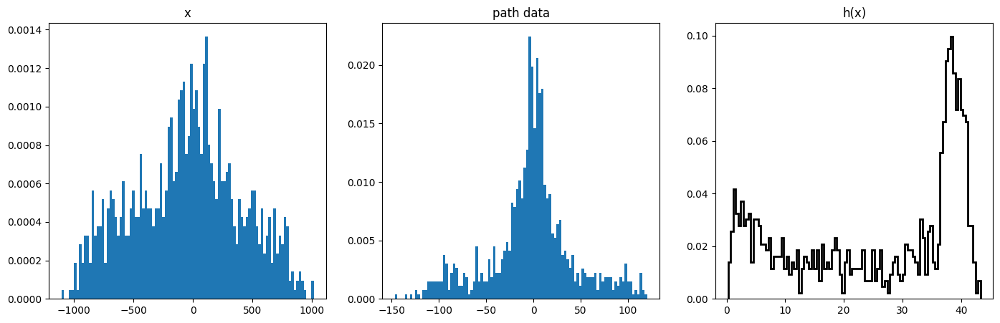

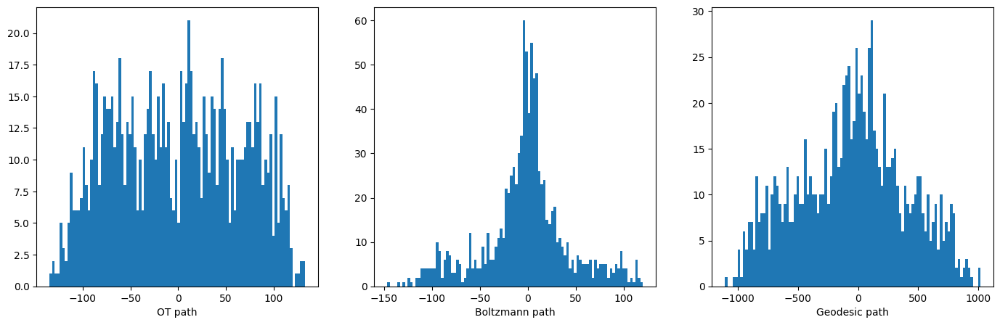

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8918 37688.718750 0.003000
    8928 25229.419922 0.001500
    8938 19857.226562 0.000750
    8948 18501.789062 0.000750
    8958 17483.080078 0.000750
[185, 313371872.0]


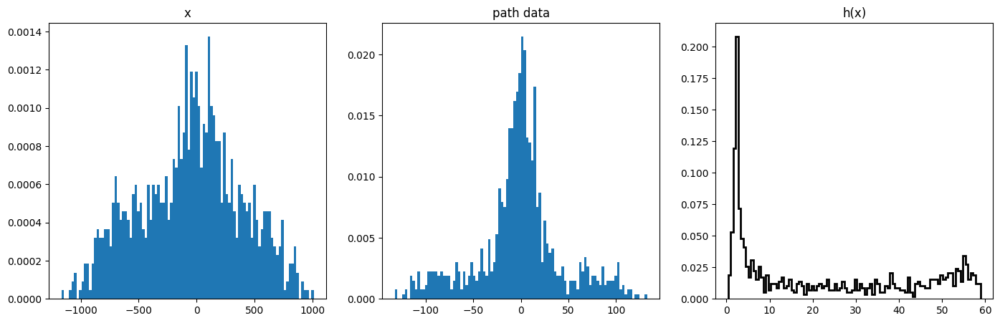

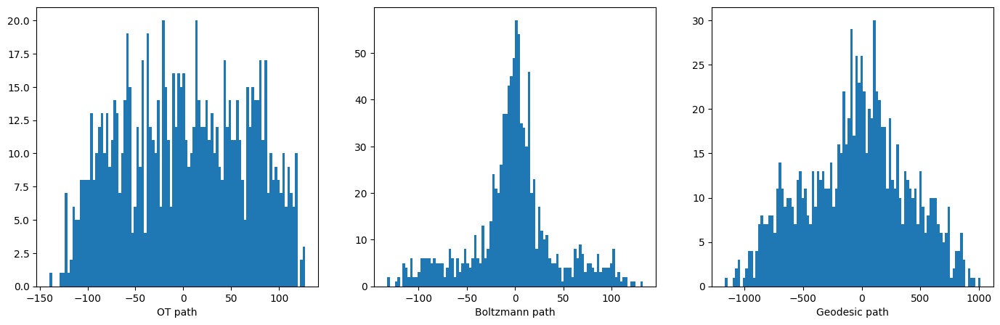

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    8967 12067.018555 0.003000
    8977 9297.353516 0.001500
    8987 8404.699219 0.000375
    8997 8163.301270 0.000375
    9007 8114.534180 0.000375
[186, 433842368.0]


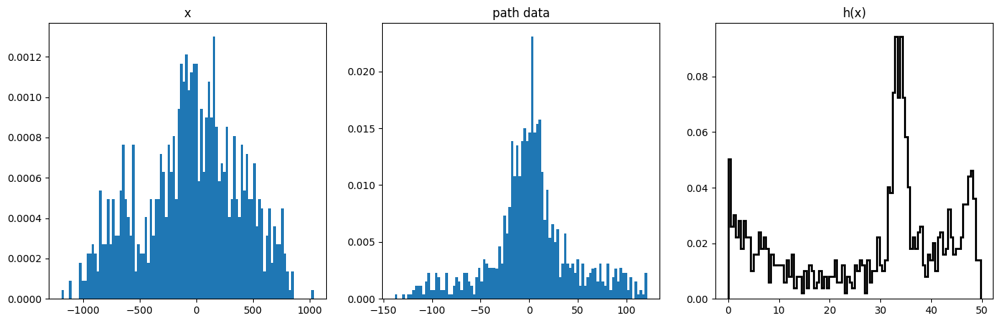

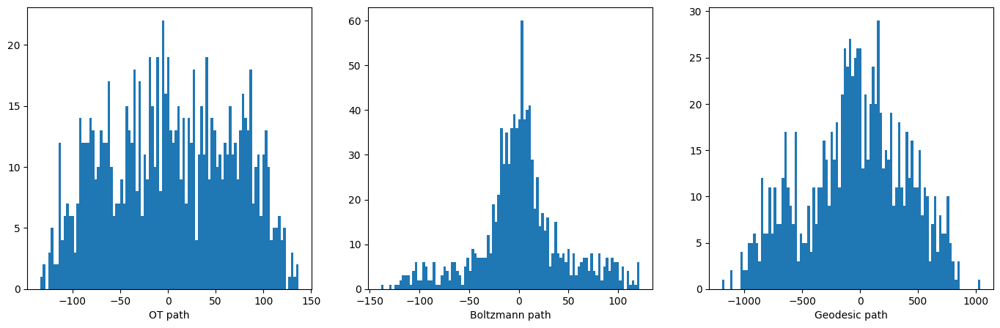

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9016 34598.250000 0.003000
    9026 21324.386719 0.001500
    9036 16823.300781 0.000750
    9046 15409.126953 0.000750
    9056 14804.669922 0.000750
[187, 252189472.0]


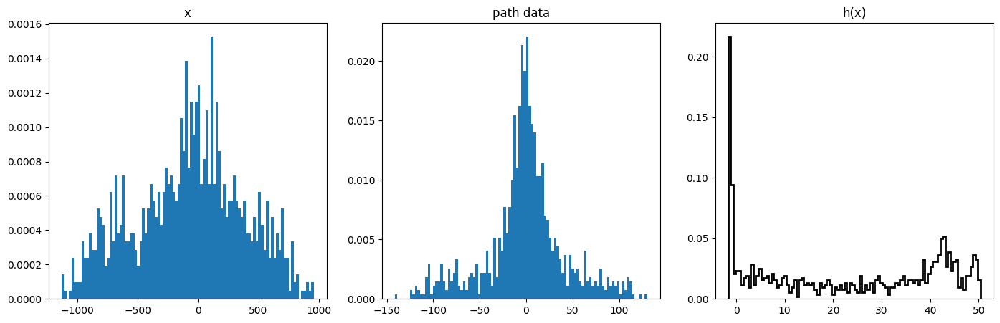

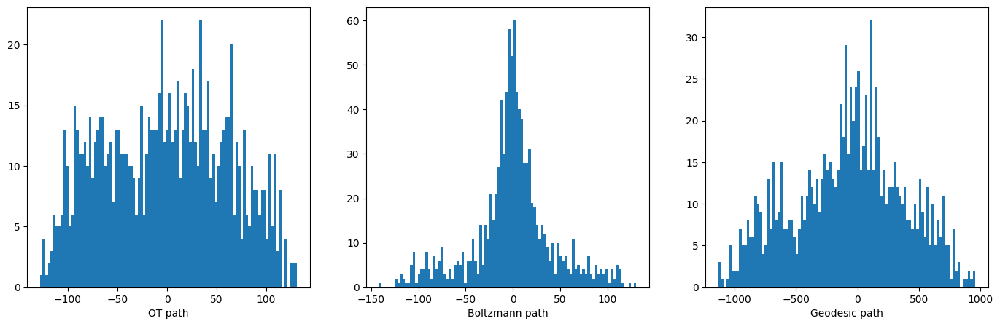

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9065 11184.544922 0.003000
    9075 10582.289062 0.003000
    9085 9811.291016 0.003000
    9095 9108.513672 0.003000
    9105 8539.442383 0.003000
[188, 369320032.0]


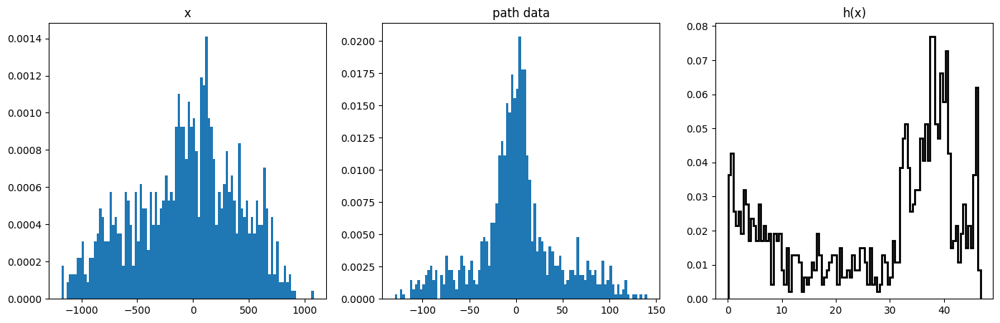

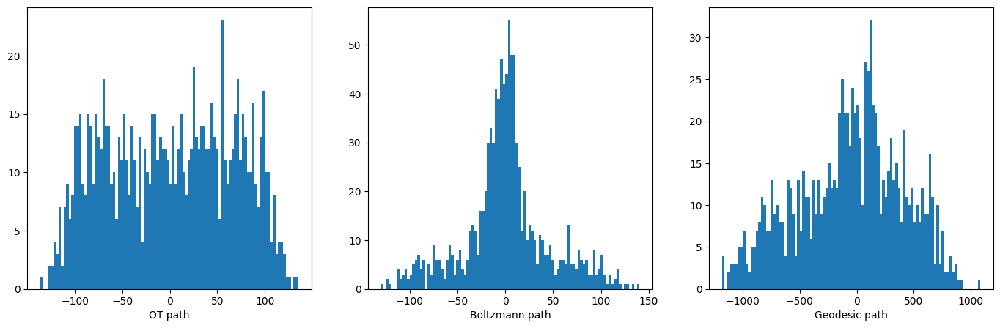

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9114 15040.326172 0.003000
    9124 13330.677734 0.003000
    9134 11750.737305 0.003000
    9144 10465.310547 0.003000
    9154 9463.330078 0.003000
[189, 279653600.0]


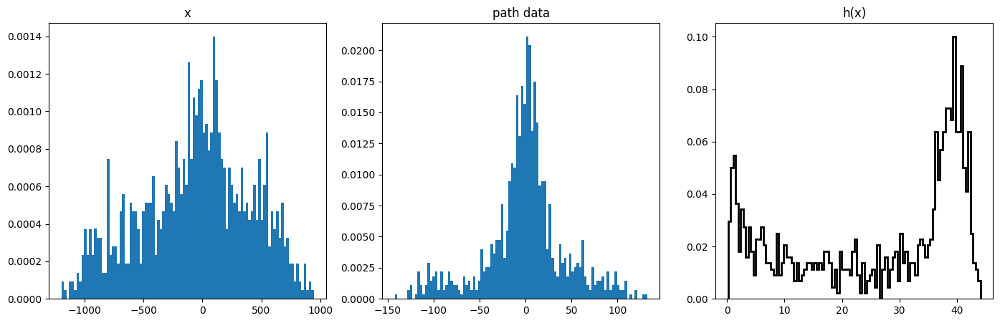

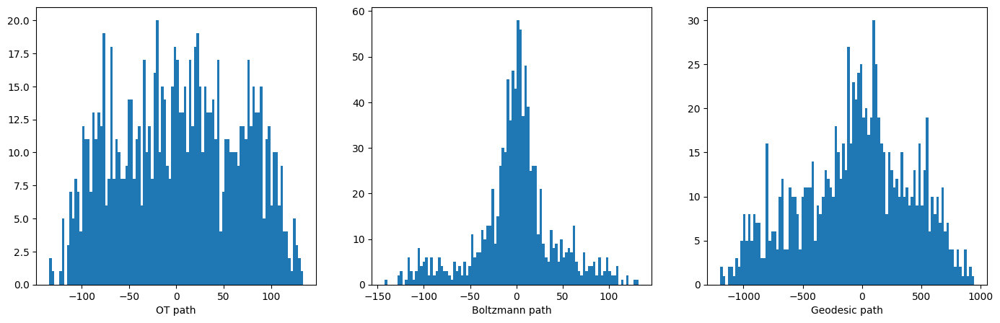

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9163 48096.644531 0.003000
    9173 15975.273438 0.001500
    9183 8979.742188 0.000375
[190, 373462432.0]


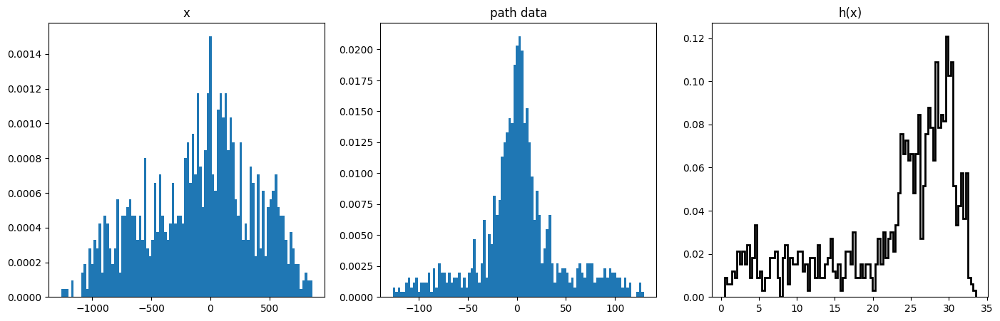

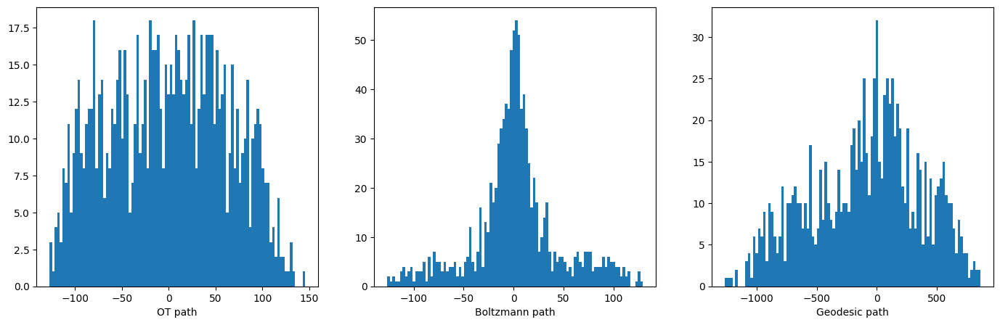

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9189 23101.673828 0.003000
    9199 17285.765625 0.001500
    9209 11163.687500 0.000188
[191, 232693440.0]


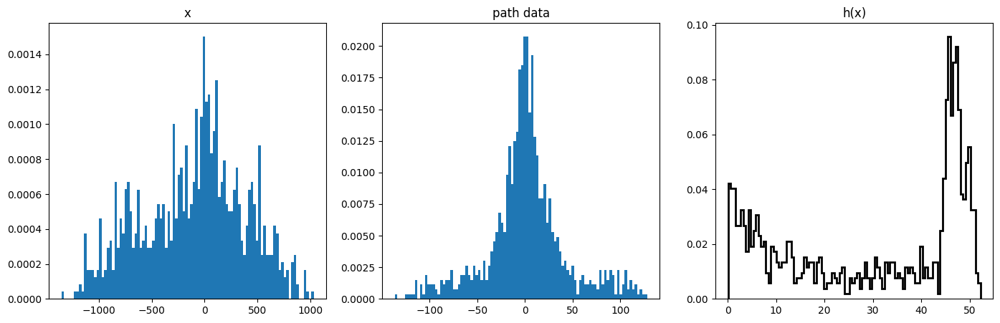

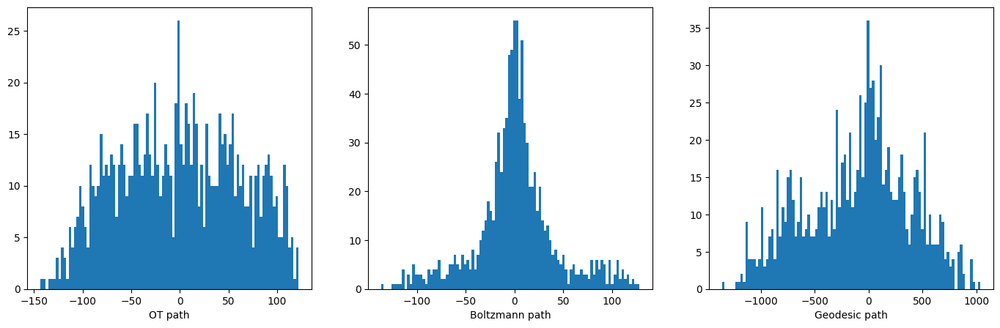

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9213 20916.050781 0.003000
    9223 16105.384766 0.001500
    9233 12396.223633 0.000188
    9243 11730.415039 0.000188
    9253 11433.838867 0.000188
[192, 140171040.0]


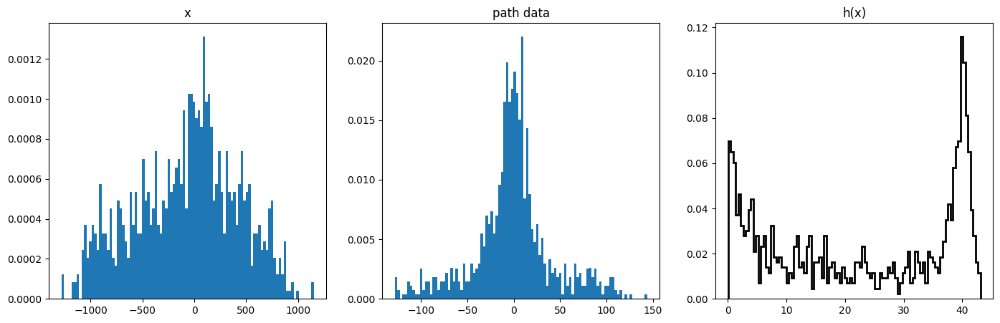

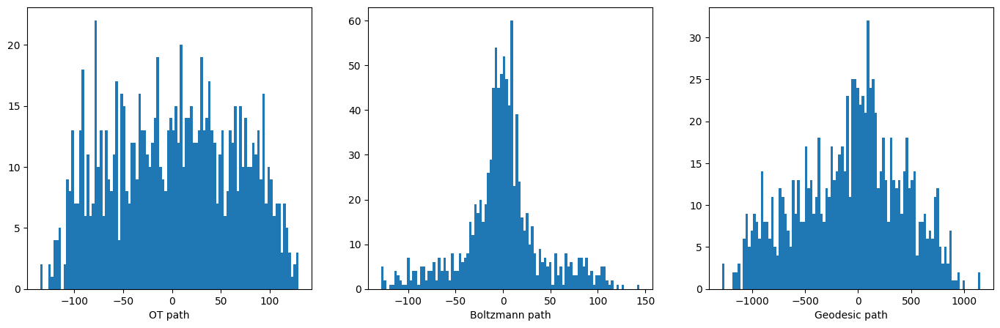

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9262 37822.312500 0.003000
    9272 20406.285156 0.001500
    9282 15723.310547 0.000375
    9292 14402.097656 0.000188
    9302 13919.300781 0.000188
[193, 287371072.0]


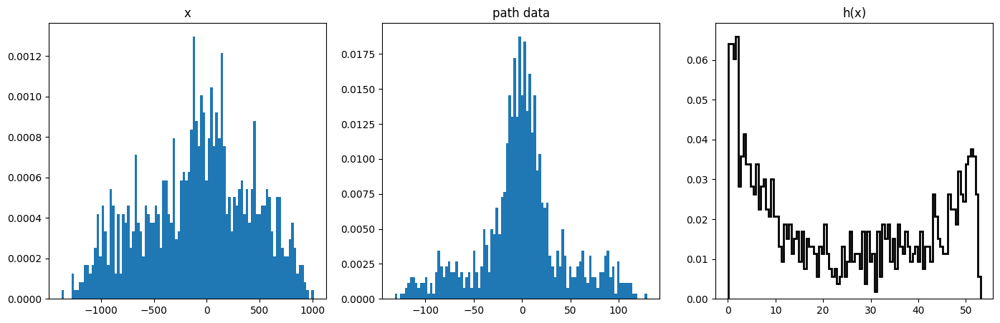

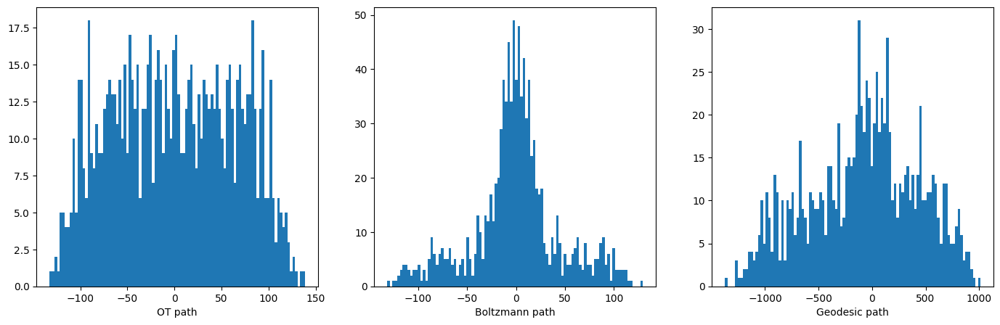

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9311 25003.888672 0.003000
    9321 21576.707031 0.003000
    9331 18815.914062 0.003000
    9341 16422.078125 0.003000
    9351 14396.746094 0.003000
[194, 303370208.0]


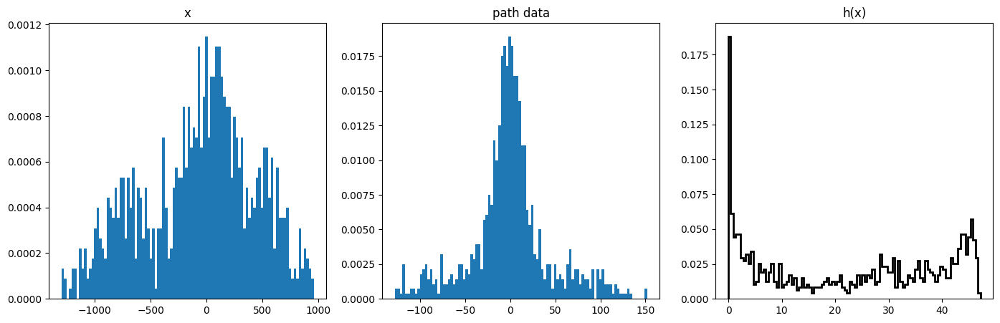

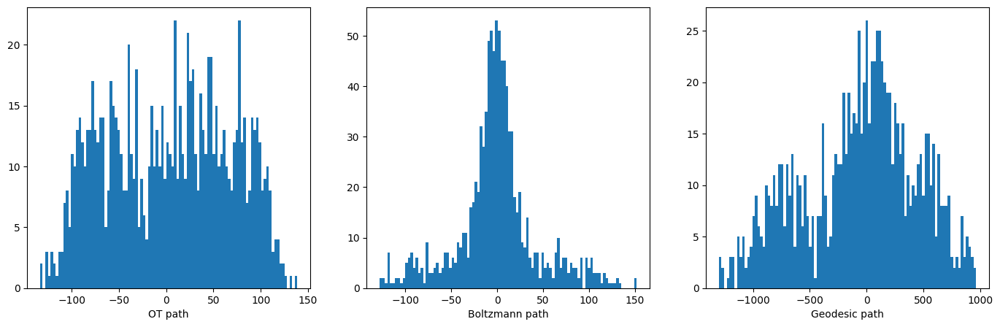

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9360 14145.286133 0.003000
    9370 10150.360352 0.001500
    9380 9064.677734 0.000375
    9390 8784.145508 0.000188
    9400 8694.536133 0.000188
[195, 302820800.0]


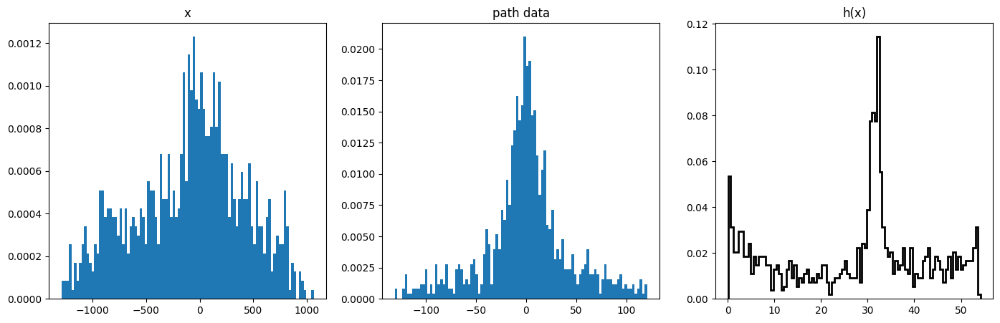

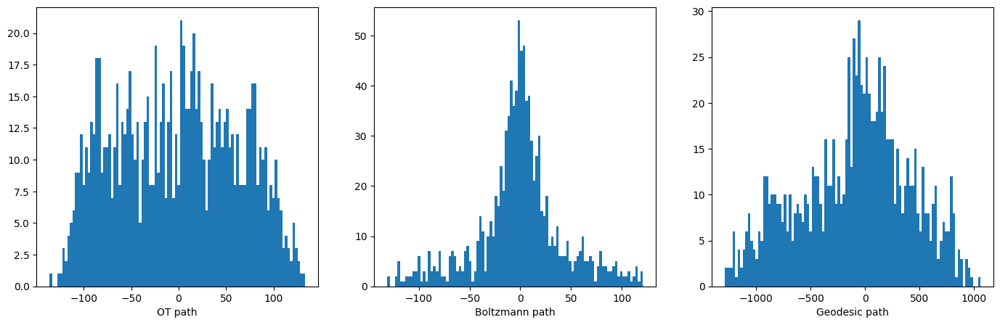

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9409 11141.312500 0.003000
    9419 10514.203125 0.003000
    9429 9684.578125 0.003000
    9439 8946.562500 0.003000
    9449 8357.639648 0.003000
[196, 182197456.0]


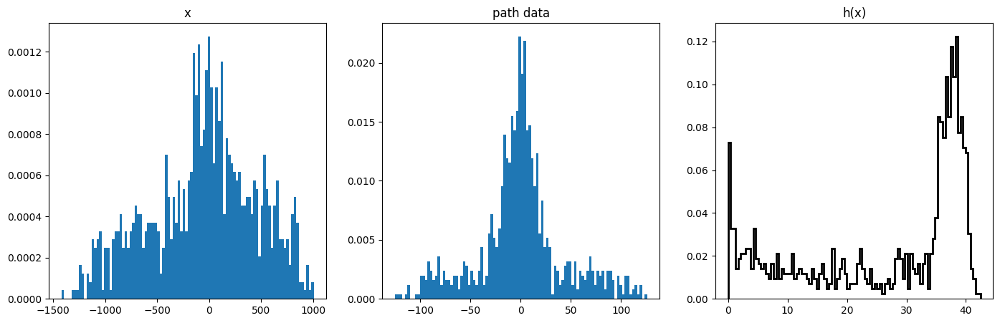

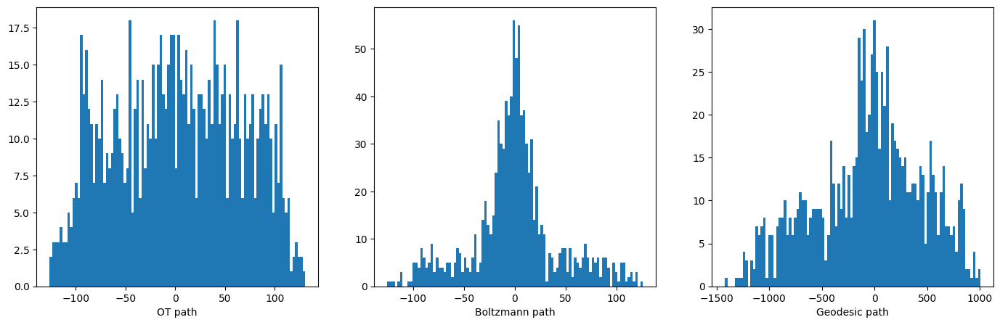

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9458 25113.894531 0.003000
    9468 22069.791016 0.003000
    9478 18955.292969 0.003000
    9488 16402.609375 0.003000
    9498 14391.096680 0.003000
[197, 254348704.0]


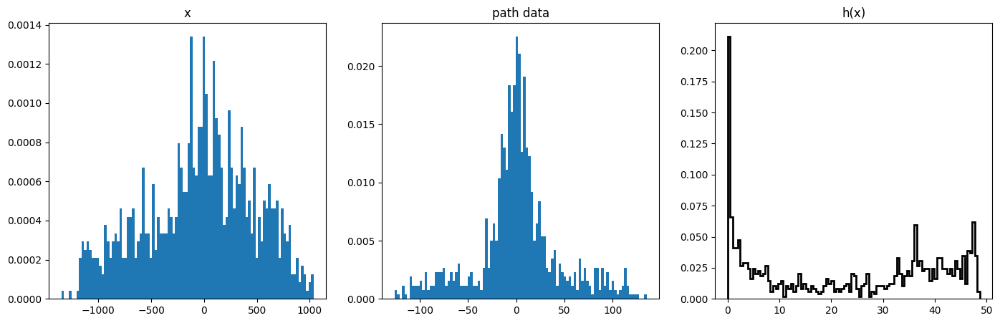

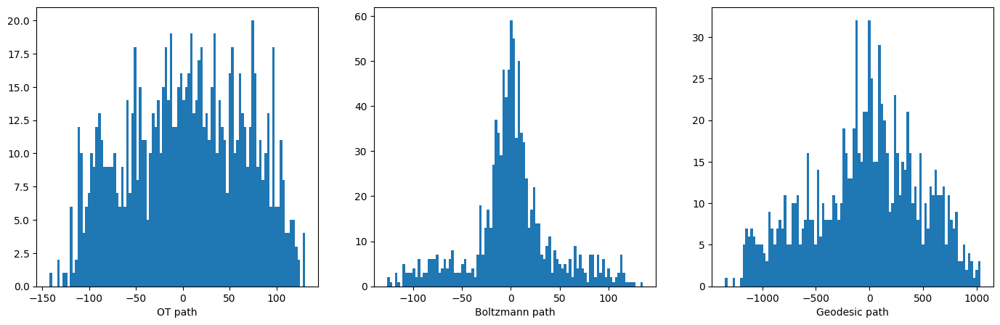

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9507 50185.972656 0.003000
    9517 24423.556641 0.001500
    9527 19279.320312 0.000375
    9537 17292.753906 0.000188
    9547 16534.738281 0.000188
[198, 160185504.0]


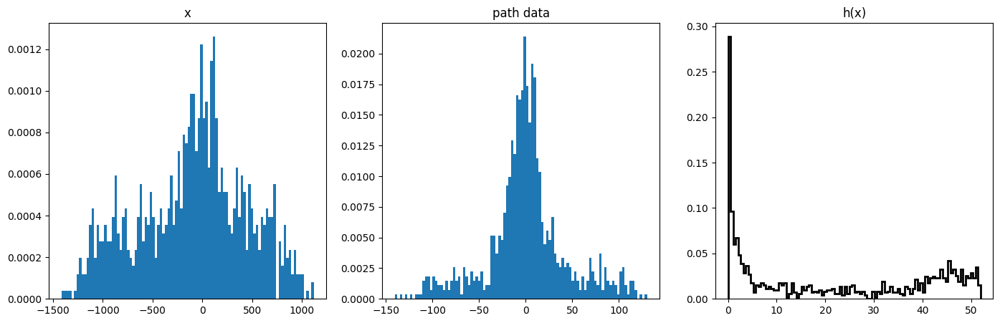

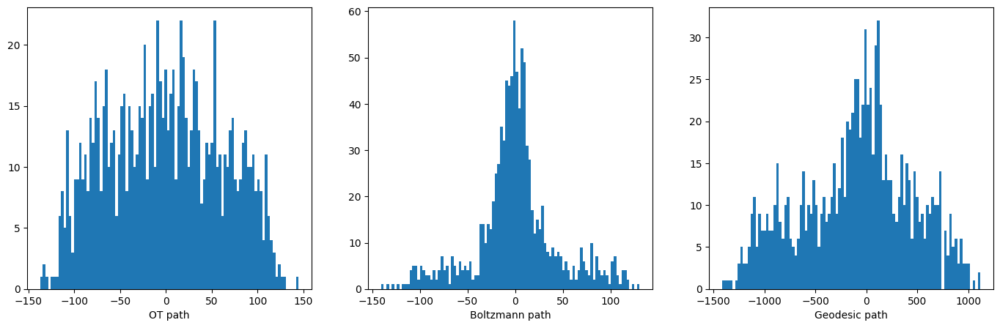

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9556 33523.675781 0.003000
    9566 19595.576172 0.001500
    9576 14413.605469 0.000375
[199, 327317504.0]


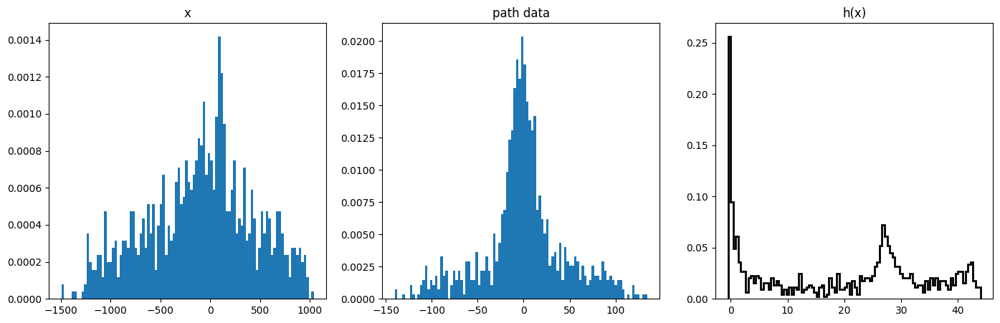

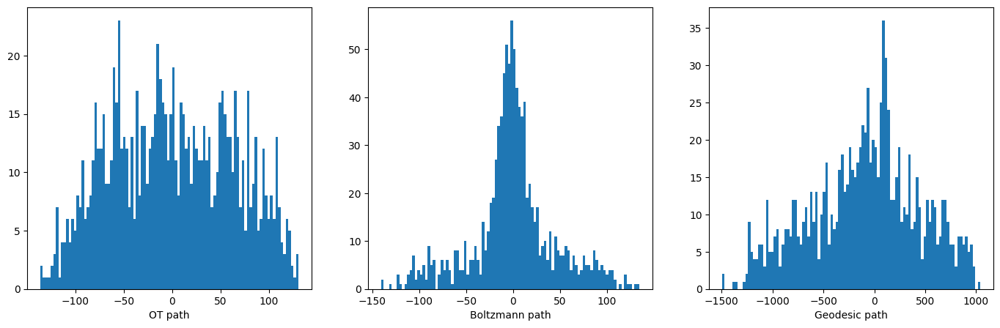

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9581 17060.560547 0.003000
    9591 15875.713867 0.001500
    9601 13830.875000 0.000188
[200, 318451680.0]


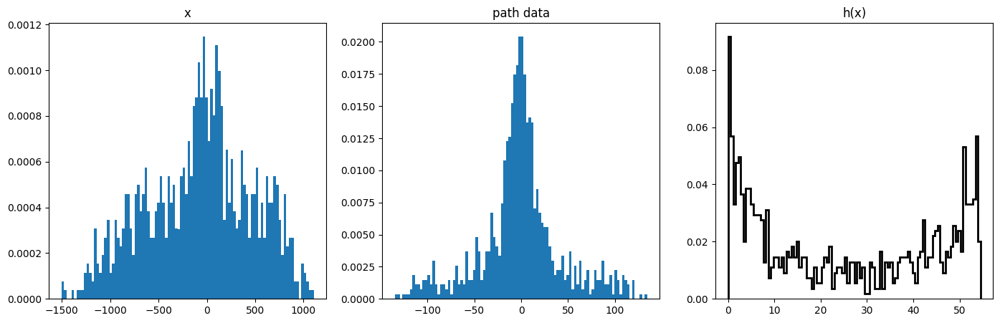

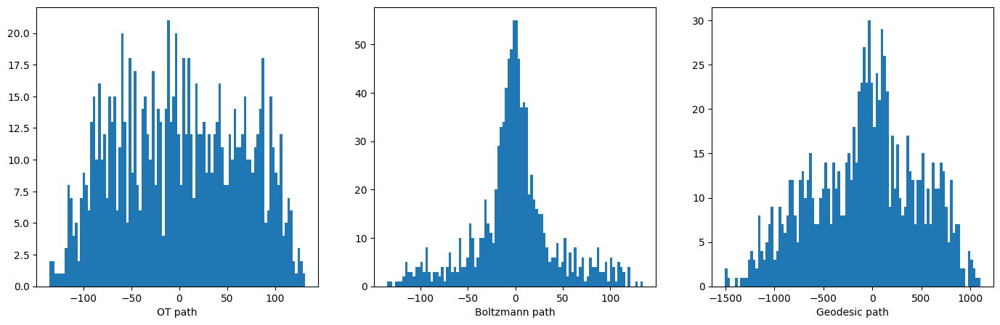

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9604 29894.701172 0.003000
    9614 19074.937500 0.001500
    9624 15020.021484 0.000375
    9634 14008.938477 0.000188
    9644 13570.845703 0.000188
[201, 315391008.0]


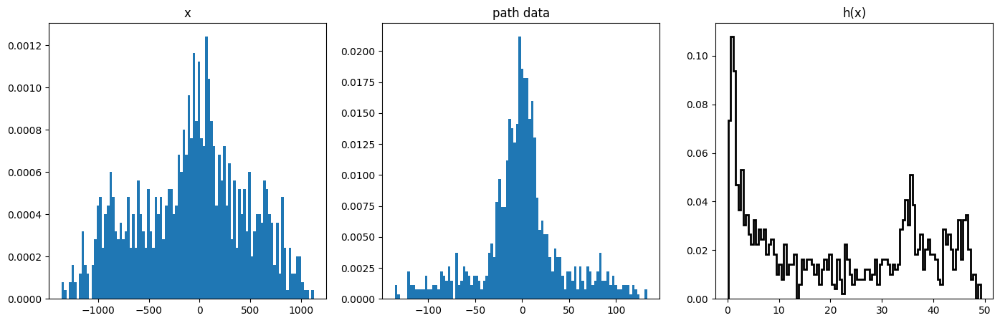

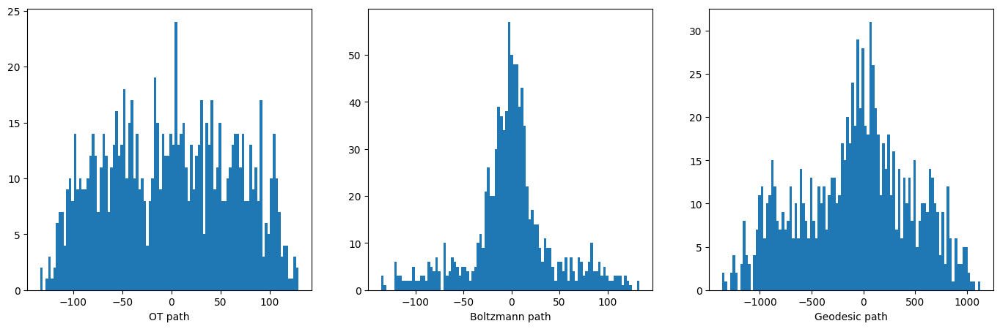

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9653 36497.367188 0.003000
    9663 18588.121094 0.001500
    9673 14699.283203 0.000375
[202, 196955584.0]


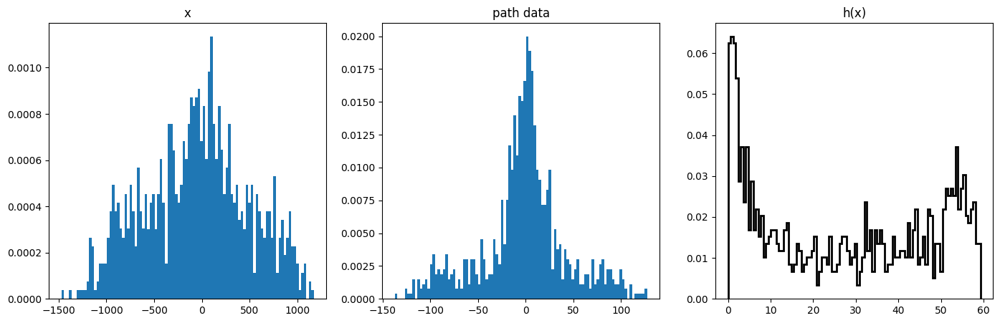

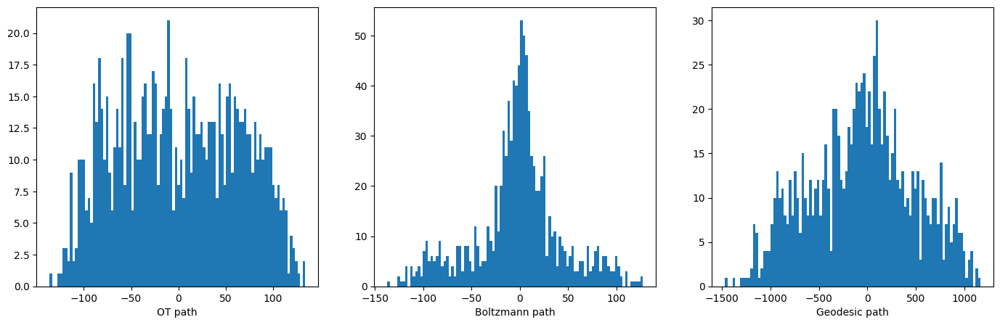

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9679 15436.486328 0.003000
    9689 16399.488281 0.000750
    9699 14767.857422 0.000375
    9709 14264.916016 0.000375
    9719 14094.268555 0.000375
[203, 201693264.0]


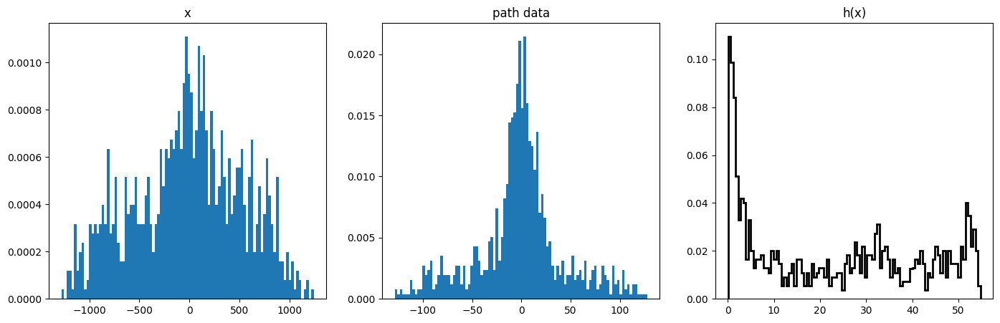

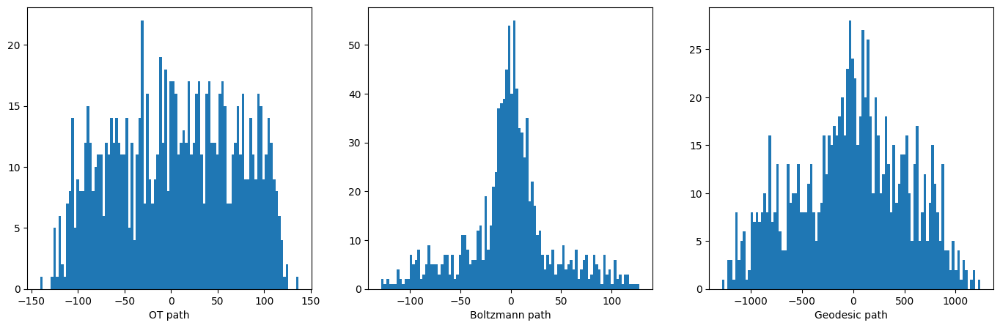

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9728 20818.285156 0.003000
    9738 18665.226562 0.003000
    9748 16746.878906 0.003000
    9758 15182.299805 0.003000
    9768 13924.483398 0.003000
[204, 227408272.0]


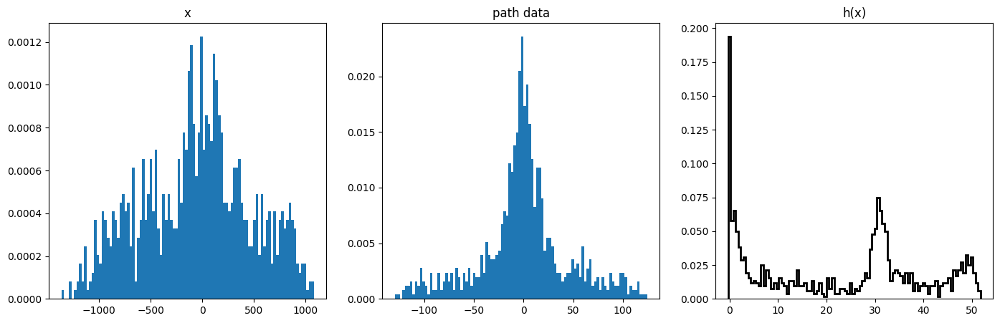

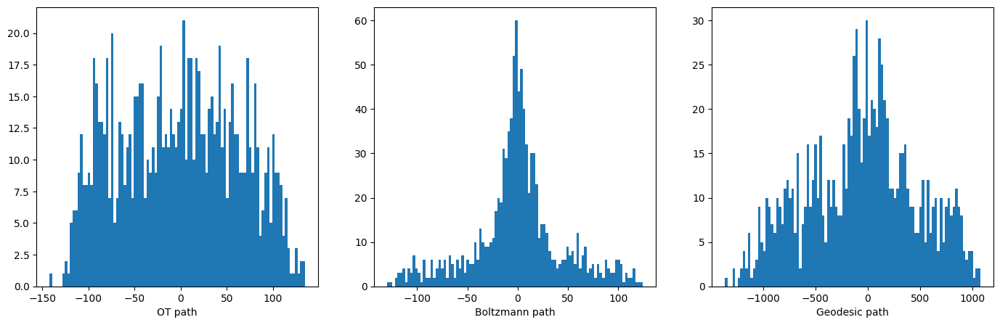

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9777 15277.148438 0.003000
    9787 13819.117188 0.003000
    9797 12536.892578 0.003000
    9807 11514.365234 0.003000
    9817 10680.156250 0.003000
[205, 224513664.0]


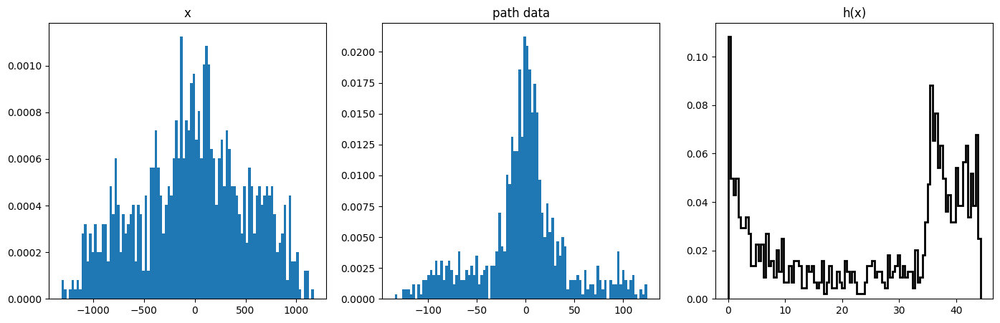

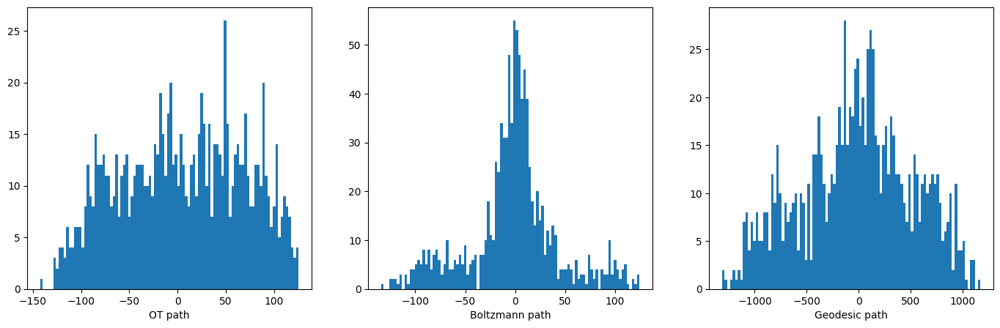

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9826 18340.037109 0.003000
    9836 17260.814453 0.003000
    9846 15734.247070 0.003000
    9856 14280.770508 0.003000
    9866 13040.530273 0.003000
[206, 321890848.0]


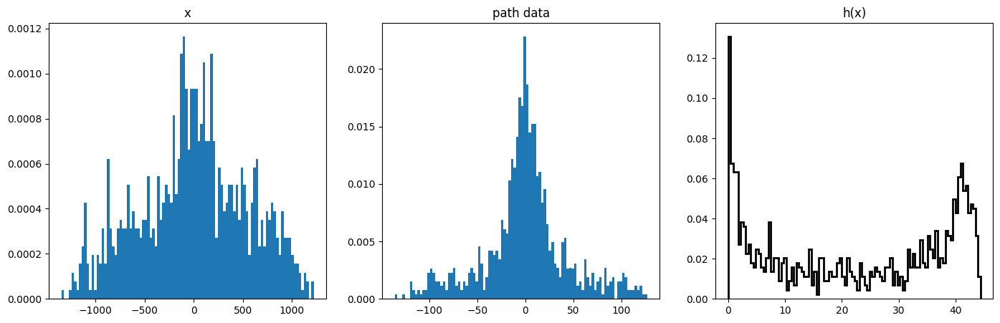

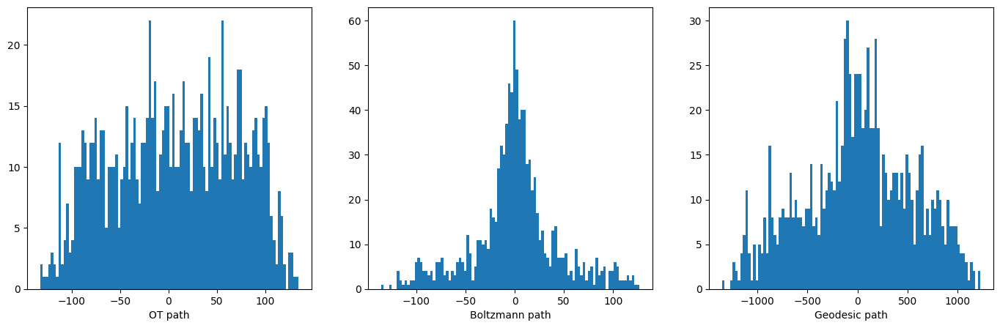

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9875 40093.578125 0.003000
    9885 19637.761719 0.001500
    9895 13975.361328 0.000375
[207, 196316560.0]


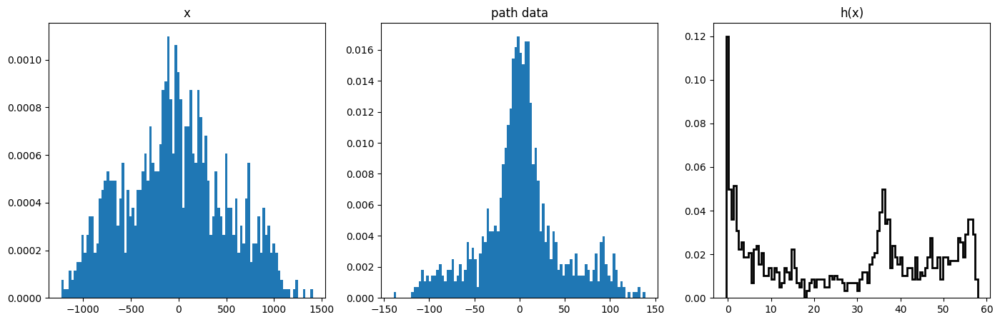

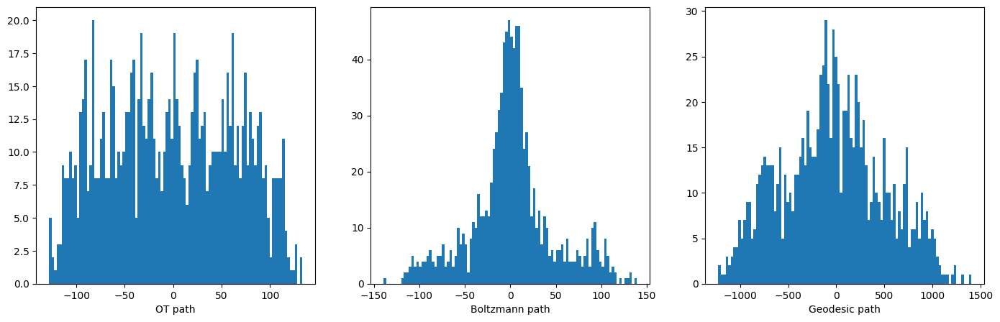

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9901 26266.134766 0.003000
    9911 25669.792969 0.000750
    9921 23187.300781 0.000750
    9931 22425.527344 0.000750
    9941 21395.931641 0.000750
[208, 264601920.0]


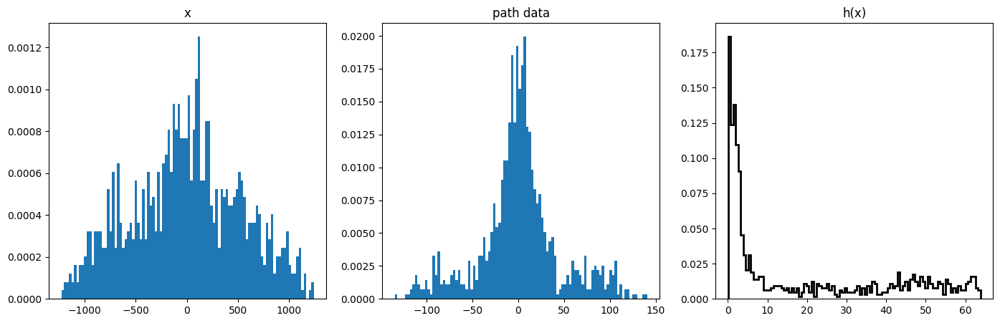

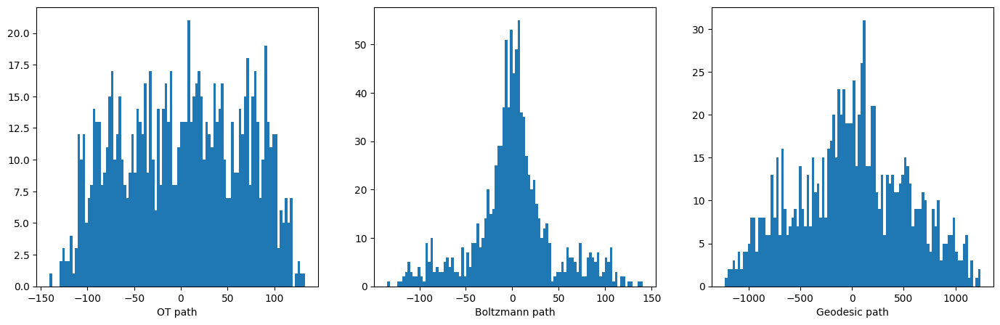

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9950 22861.324219 0.003000
    9960 17630.580078 0.001500
    9970 15344.446289 0.000750
    9980 14813.718750 0.000750
    9990 14407.933594 0.000750
[209, 332953632.0]


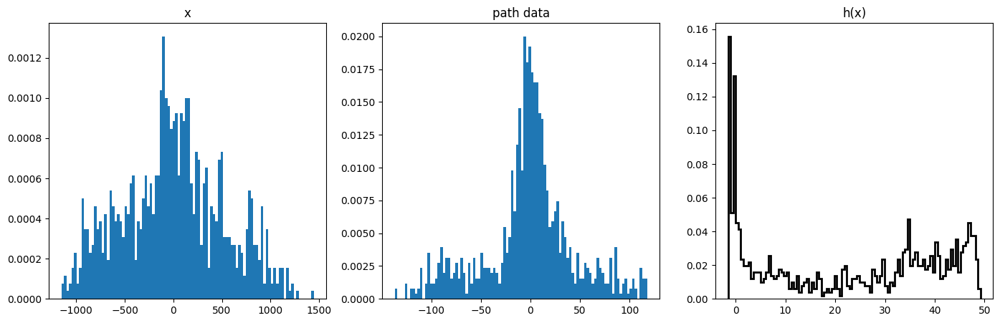

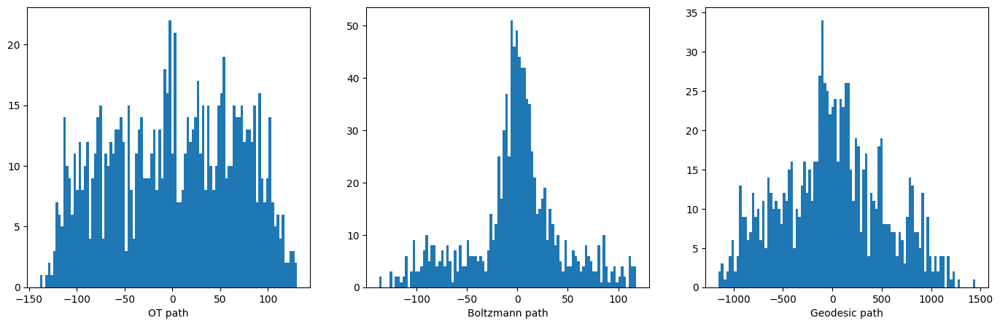

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    9999 32197.607422 0.003000
    10009 18952.861328 0.003000
    10019 15933.572266 0.000375
    10029 14784.780273 0.000375
    10039 14486.240234 0.000375
[210, 294803520.0]


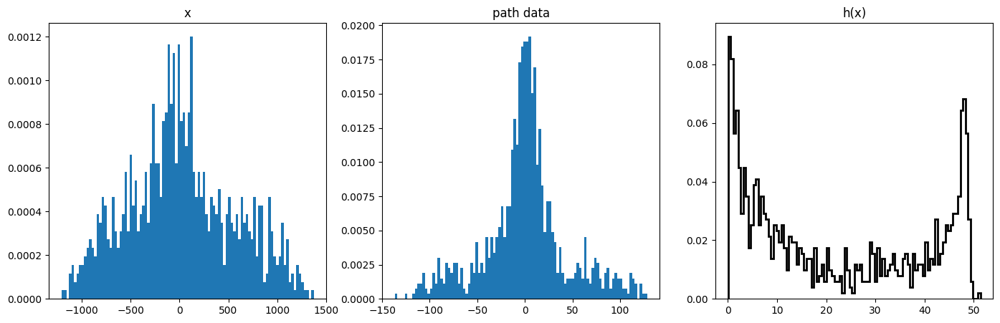

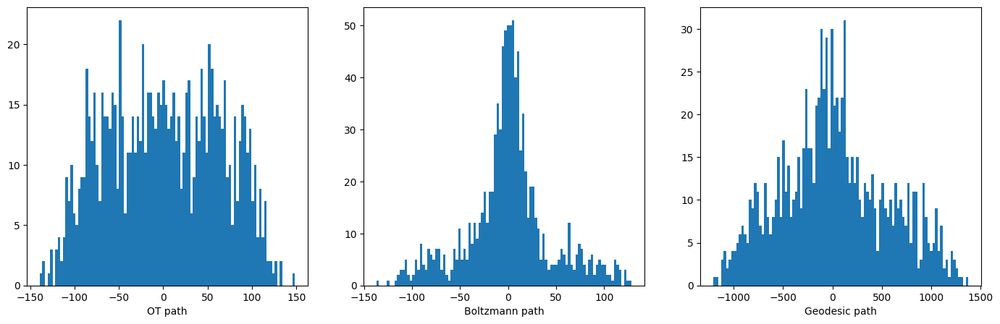

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10048 14609.815430 0.003000
    10058 13795.084961 0.003000
    10068 12799.195312 0.003000
    10078 11888.965820 0.003000
    10088 11131.478516 0.003000
[211, 230442608.0]


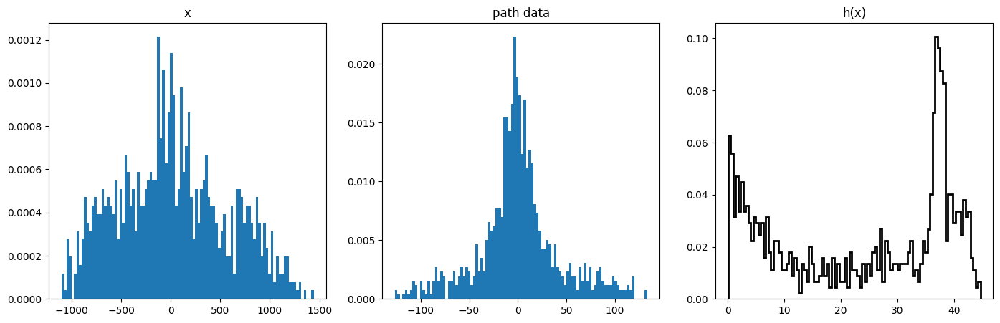

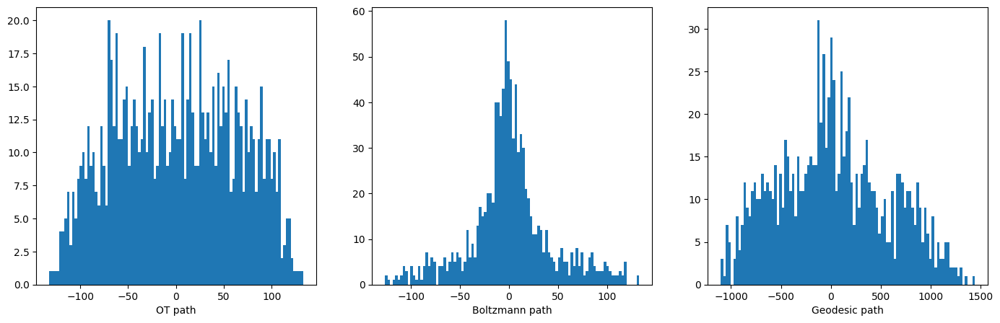

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10097 20167.695312 0.003000
    10107 17373.710938 0.003000
    10117 15725.271484 0.001500
    10127 14987.307617 0.001500
    10137 14096.903320 0.001500
[212, 290558752.0]


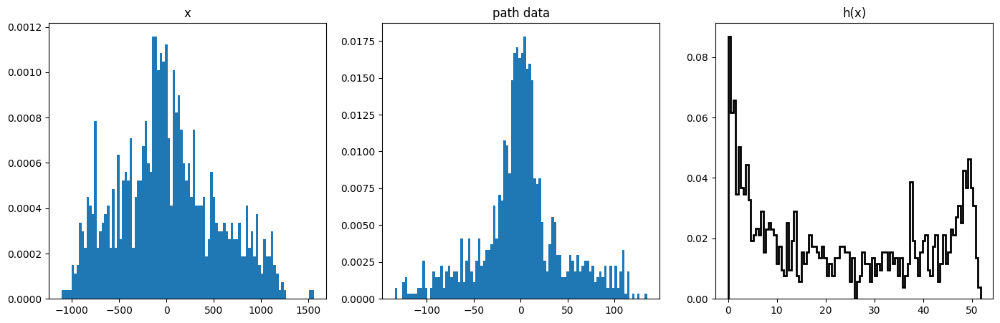

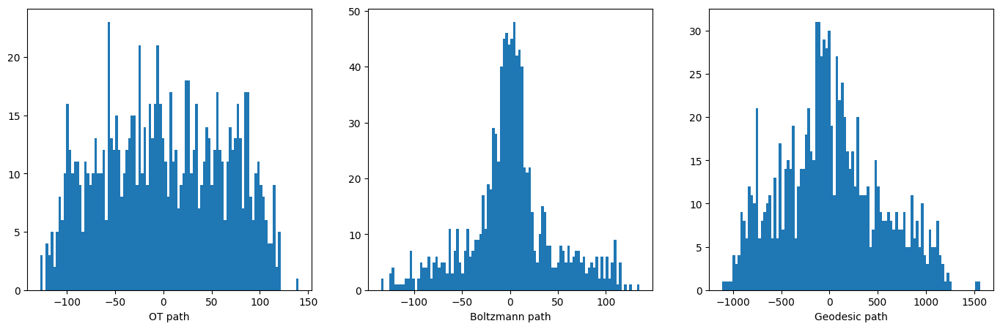

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10146 17583.533203 0.003000
    10156 11562.948242 0.001500
    10166 10230.170898 0.000375
    10176 9912.176758 0.000188
    10186 9803.938477 0.000188
[213, 477837056.0]


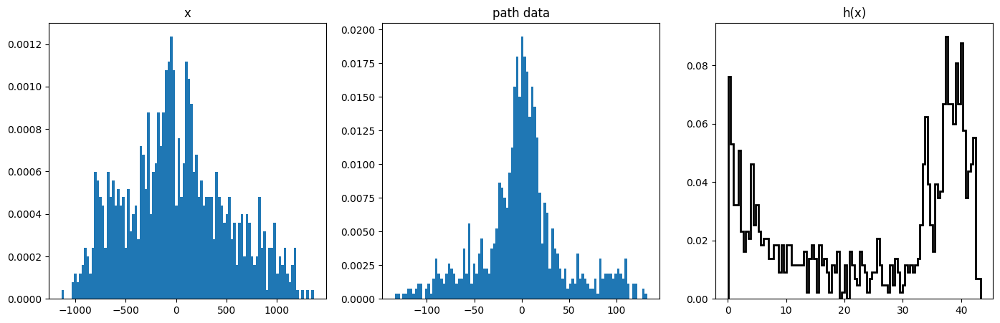

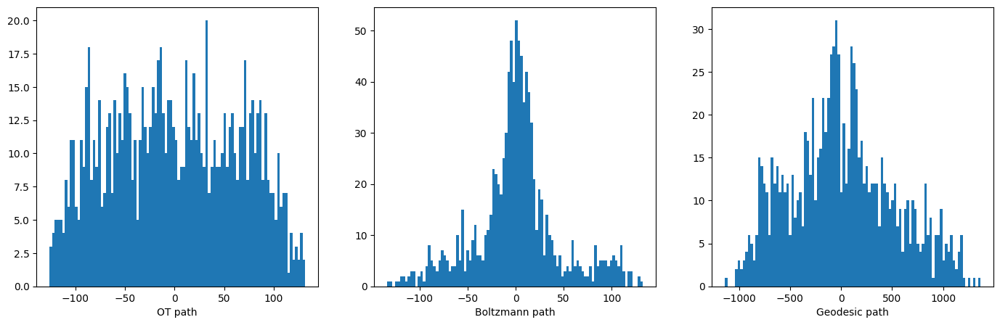

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10195 26994.208984 0.003000
    10205 17762.898438 0.001500
    10215 14708.783203 0.000375
    10225 13778.406250 0.000375
    10235 13495.025391 0.000375
[214, 296547488.0]


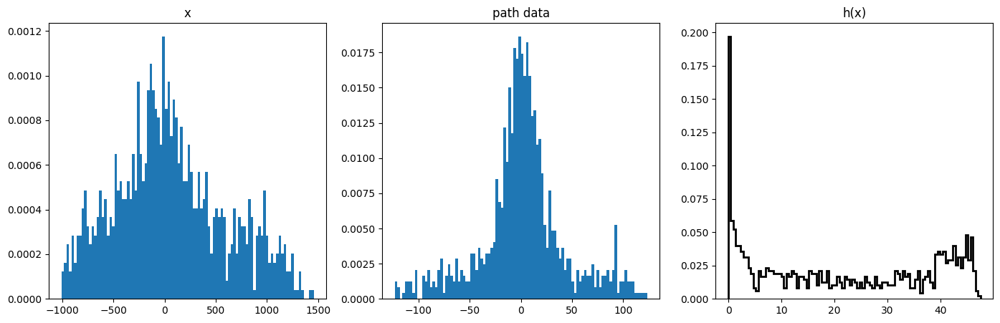

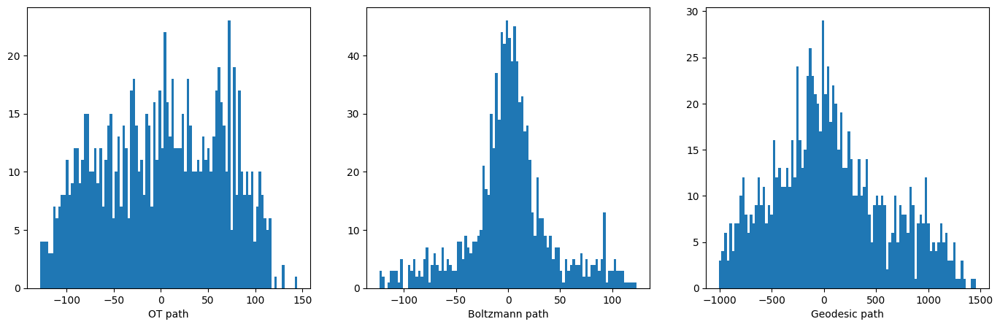

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10244 15174.358398 0.003000
    10254 11895.937500 0.001500
    10264 10537.747070 0.000750
    10274 10070.507812 0.000750
    10284 9737.595703 0.000750
[215, 190922112.0]


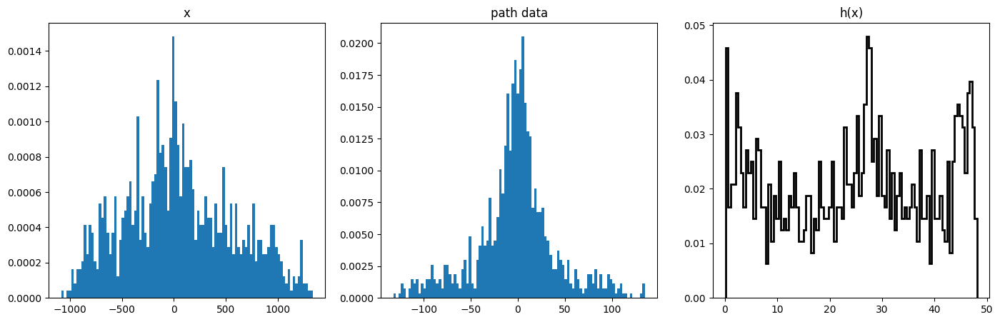

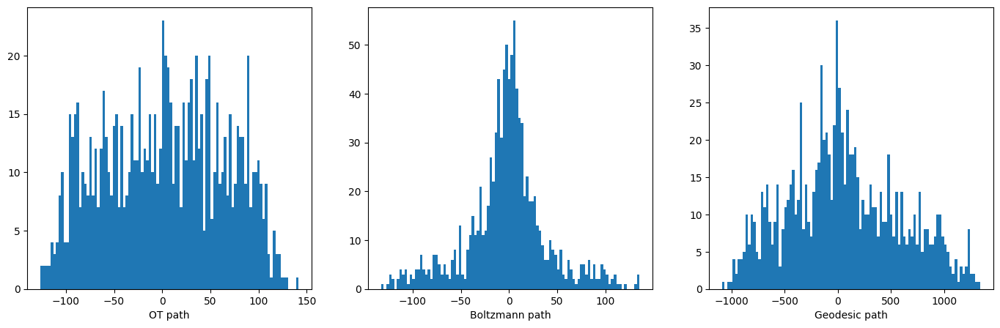

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10293 41828.398438 0.003000
    10303 21664.017578 0.001500
    10313 15318.899414 0.000375
    10323 14017.782227 0.000188
    10333 13648.296875 0.000188
[216, 293526240.0]


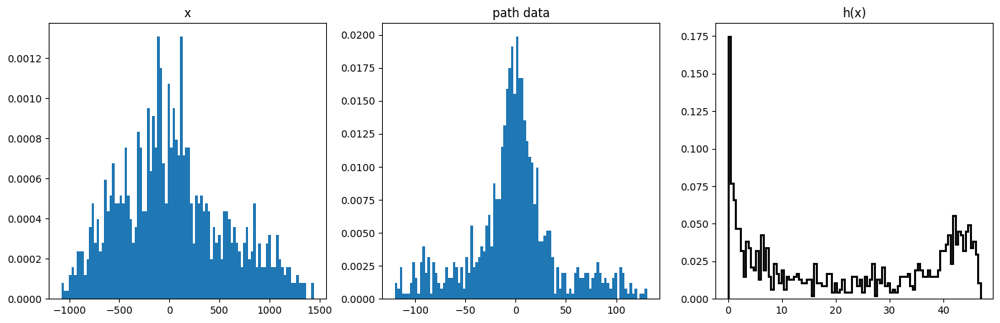

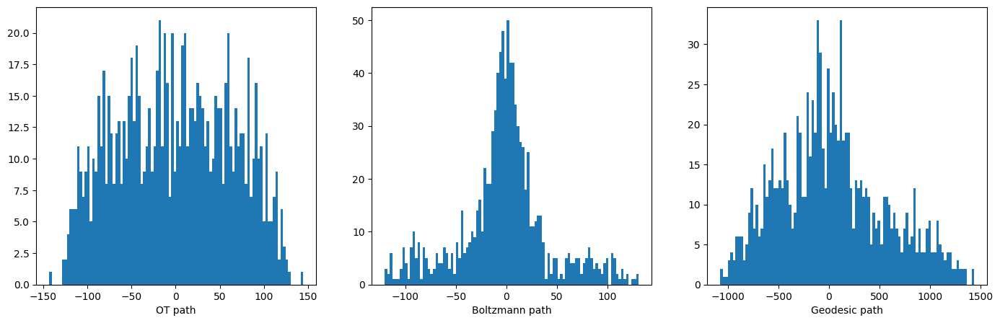

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10342 24423.904297 0.003000
    10352 18480.287109 0.001500
    10362 16389.152344 0.000750
    10372 15623.169922 0.000750
    10382 15362.787109 0.000750
[217, 577689280.0]


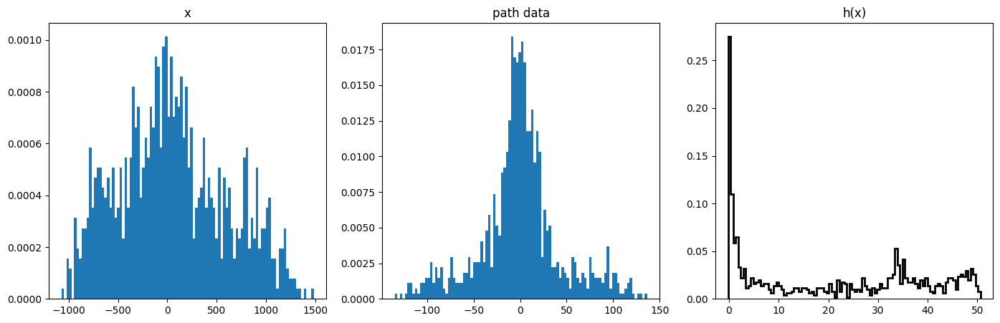

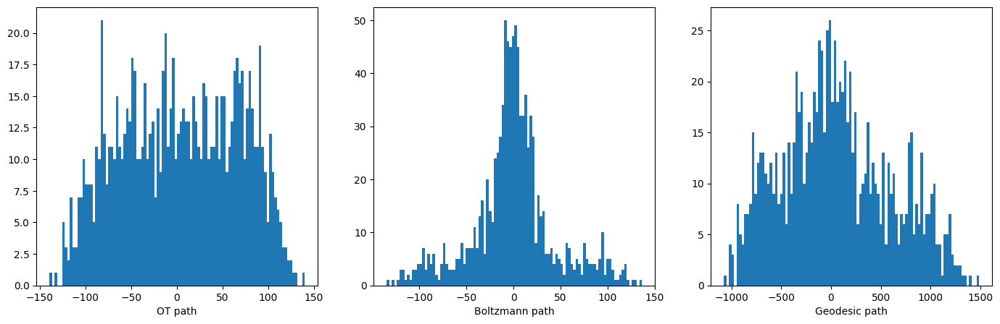

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10391 14197.639648 0.003000
    10401 13293.316406 0.003000
    10411 11856.594727 0.003000
    10421 10518.100586 0.003000
    10431 9448.443359 0.003000
[218, 321139648.0]


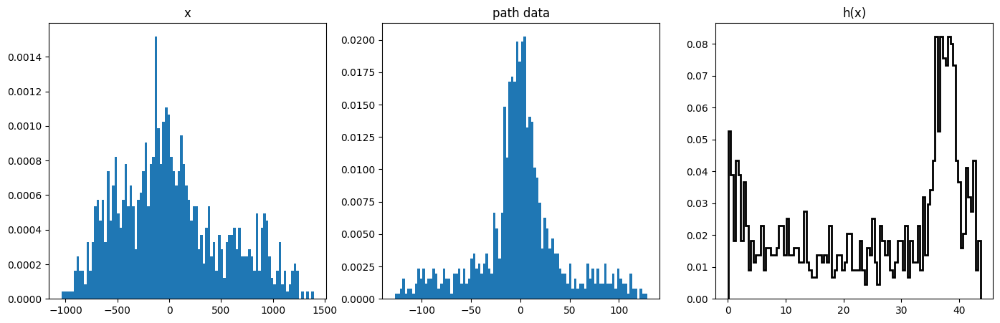

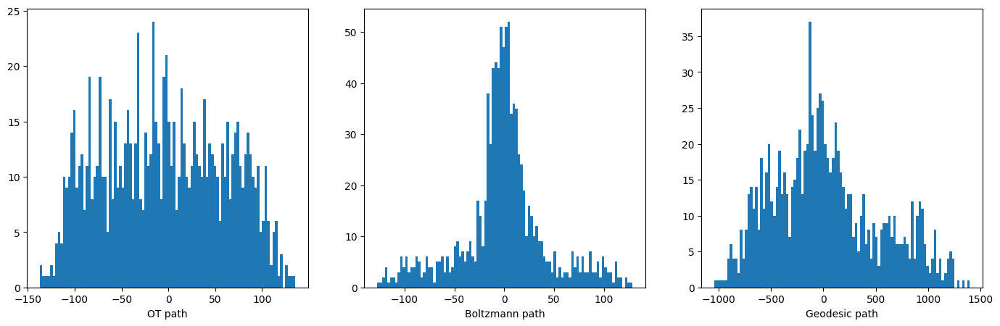

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10440 13334.651367 0.003000
    10450 10610.969727 0.001500
    10460 9062.270508 0.001500
    10470 8489.455078 0.001500
    10480 7851.615234 0.001500
[219, 294275392.0]


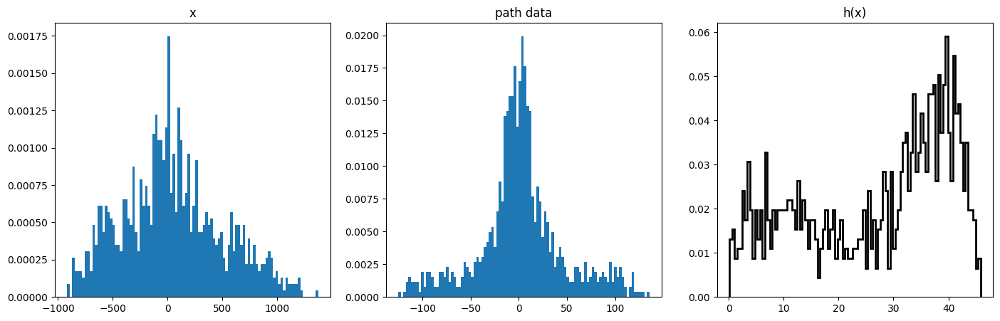

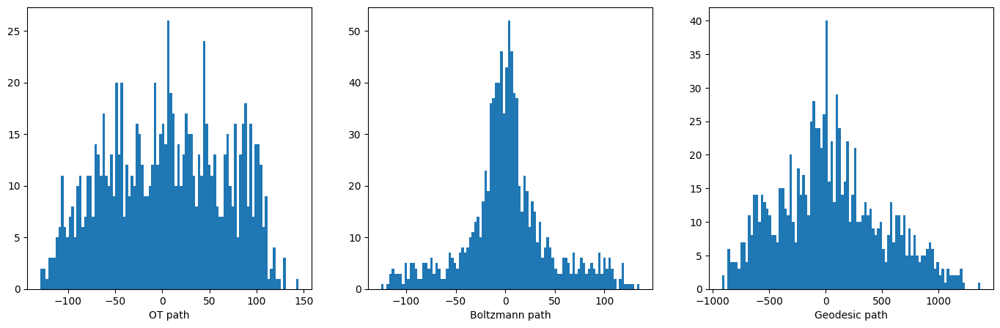

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10489 12874.178711 0.003000
    10499 10616.240234 0.001500
    10509 9226.929688 0.001500
    10519 8647.094727 0.001500
    10529 8041.081543 0.001500
[220, 153199776.0]


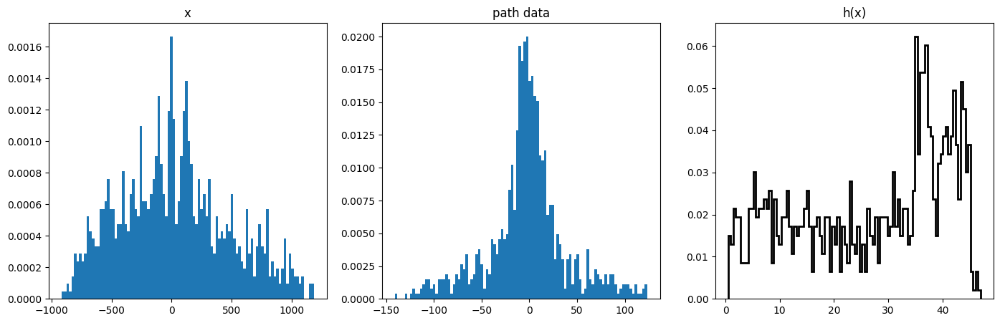

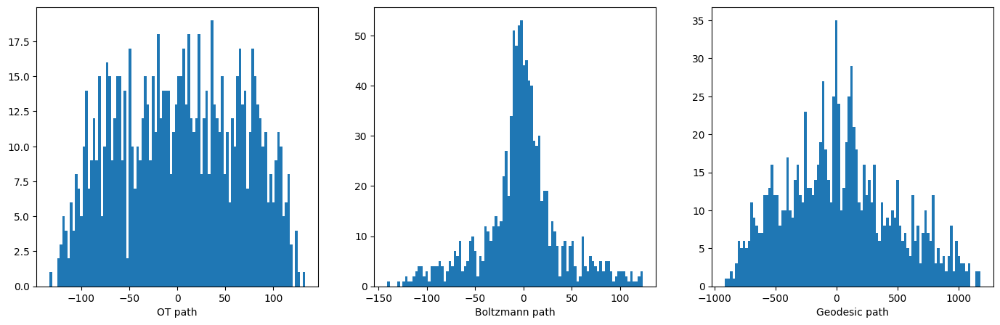

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10538 5948.069336 0.003000
    10548 4958.227051 0.001500
    10558 4762.816406 0.001500
    10568 4645.012207 0.001500
    10578 4562.947266 0.001500
[221, 343963776.0]


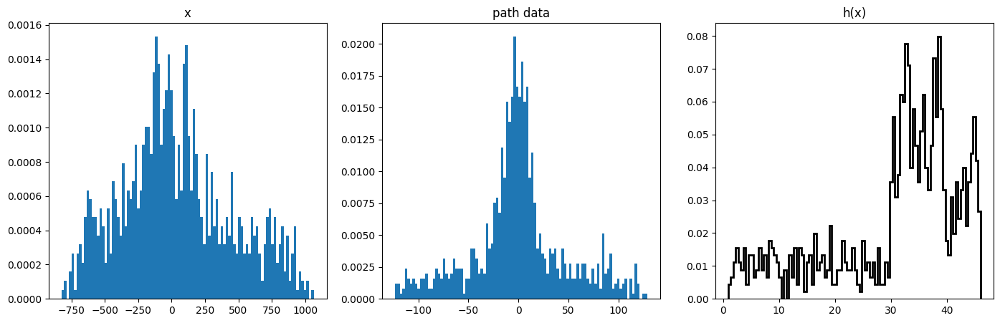

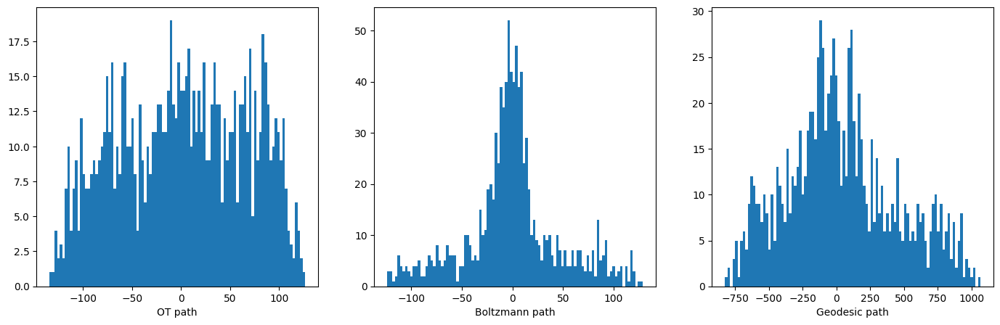

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10587 31484.134766 0.003000
    10597 21694.058594 0.001500
    10607 16547.699219 0.000750
    10617 15729.787109 0.000750
    10627 14498.829102 0.000750
[222, 307908896.0]


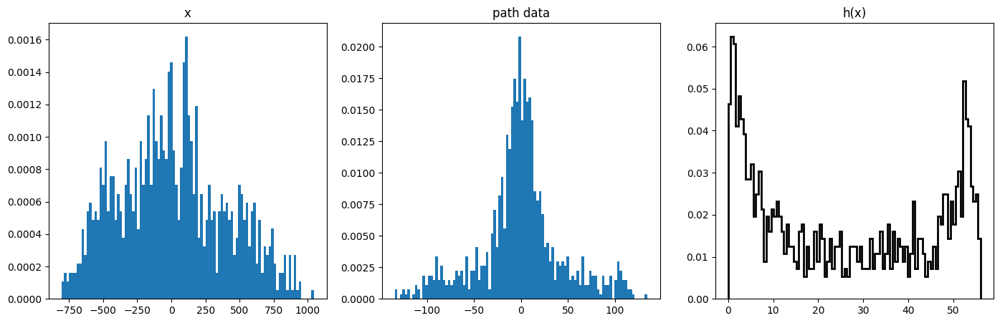

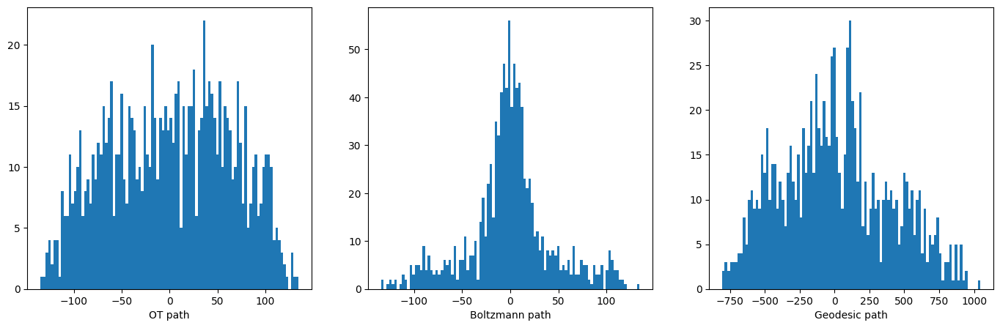

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10636 35931.148438 0.003000
    10646 21076.333984 0.001500
    10656 13948.032227 0.000750
    10666 13042.789062 0.000750
    10676 12013.340820 0.000750
[223, 381145440.0]


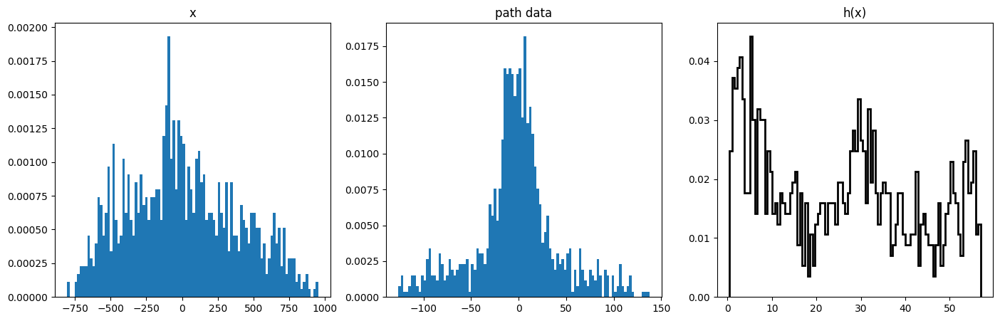

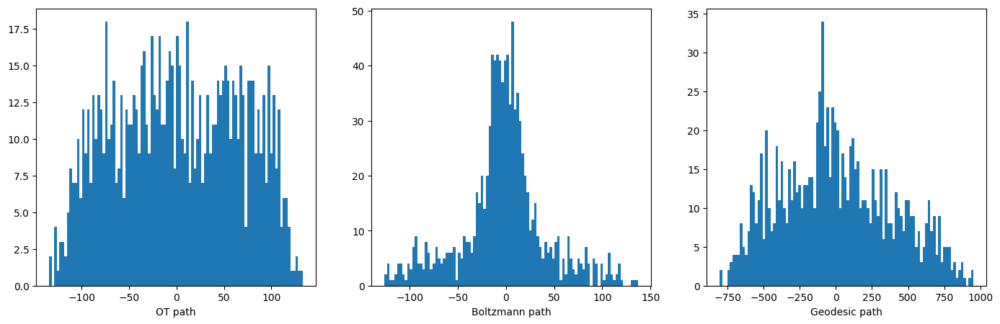

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10685 18307.433594 0.003000
    10695 9845.537109 0.001500
    10705 5466.126953 0.000750
    10715 5468.960938 0.000375
[224, 308482816.0]


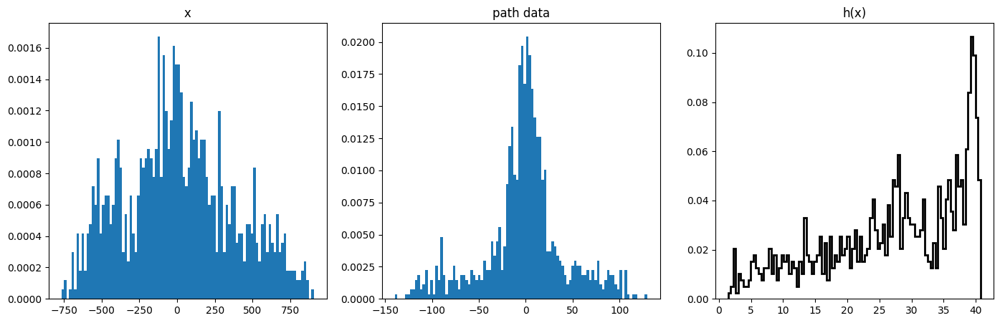

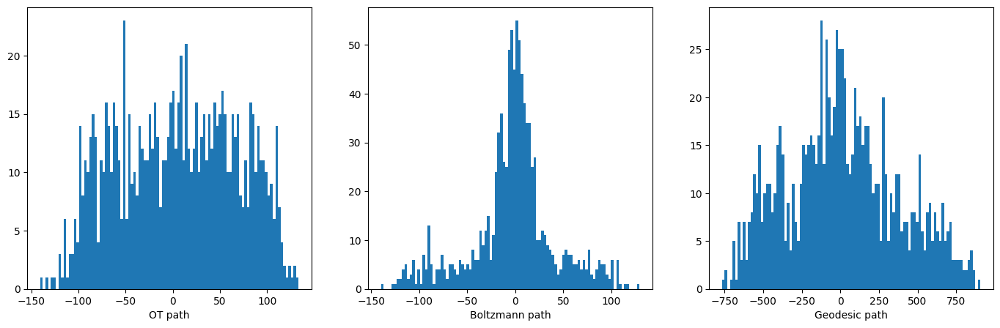

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10720 20426.765625 0.003000
    10730 17437.951172 0.003000
    10740 12639.412109 0.003000
    10750 9222.758789 0.003000
    10760 6468.676270 0.003000
[225, 334528096.0]


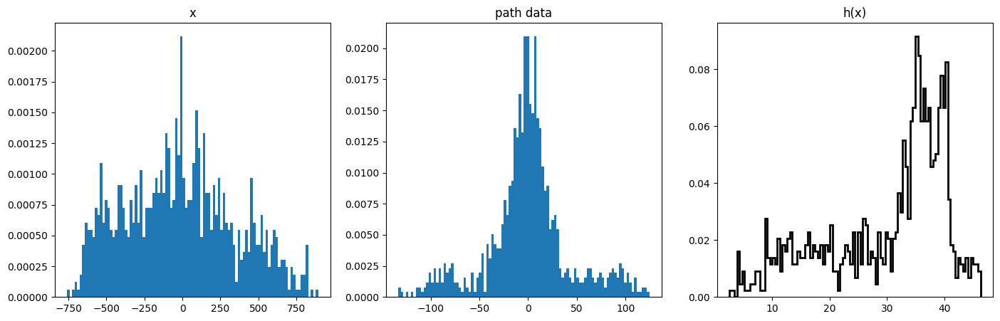

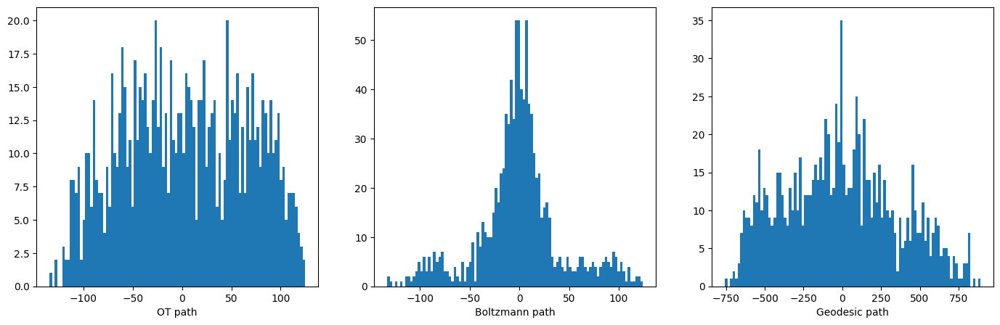

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10769 31446.210938 0.003000
    10779 8375.261719 0.001500
    10789 3751.404053 0.000375
    10799 3524.275879 0.000375
[226, 162689072.0]


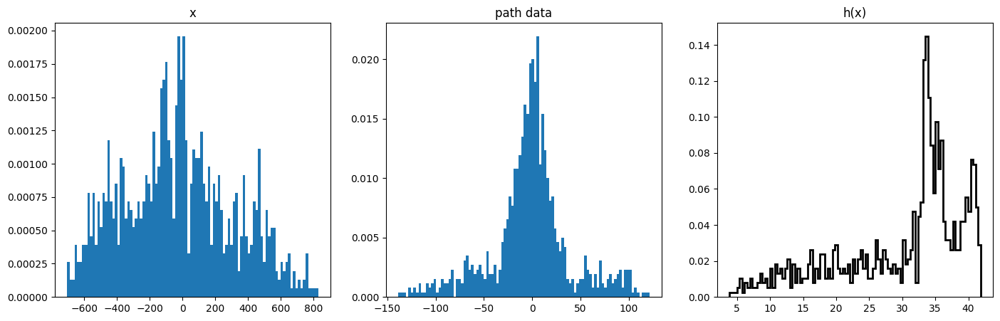

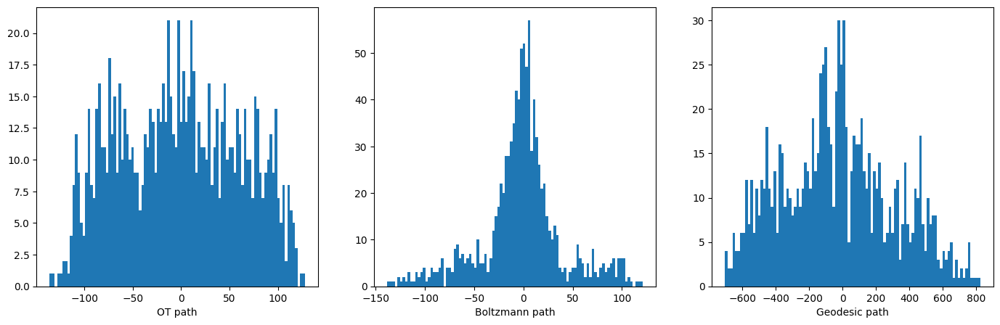

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10805 13047.508789 0.003000
    10815 11062.576172 0.003000
    10825 8415.968750 0.003000
    10835 6246.566895 0.003000
    10845 4738.437500 0.003000
[227, 192807056.0]


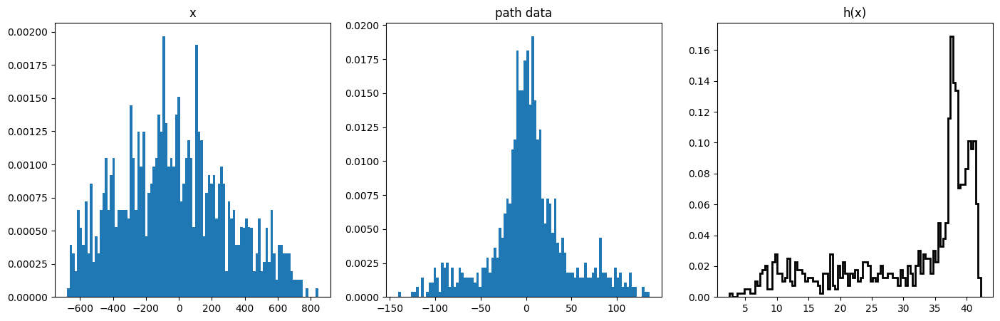

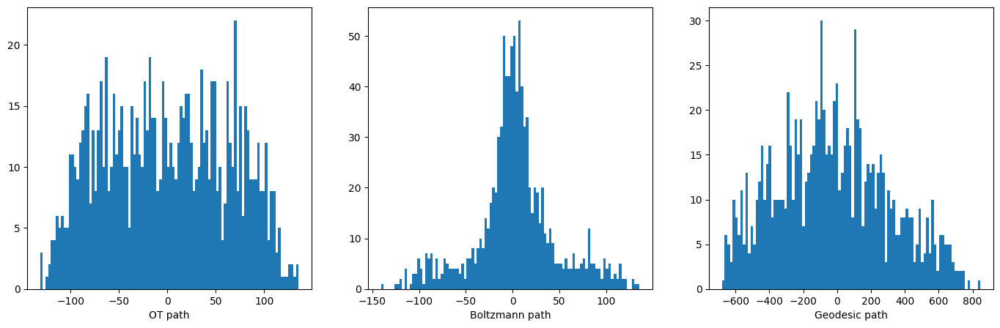

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10854 10241.580078 0.003000
    10864 8256.094727 0.003000
    10874 6196.941895 0.003000
    10884 4598.216309 0.003000
    10894 3499.271729 0.003000
[228, 240869728.0]


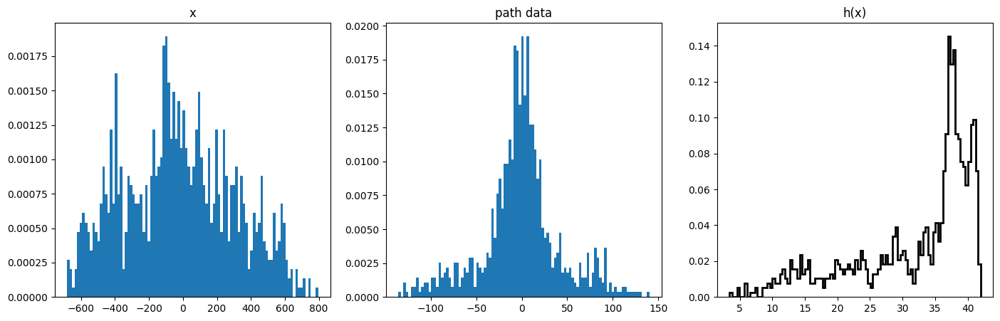

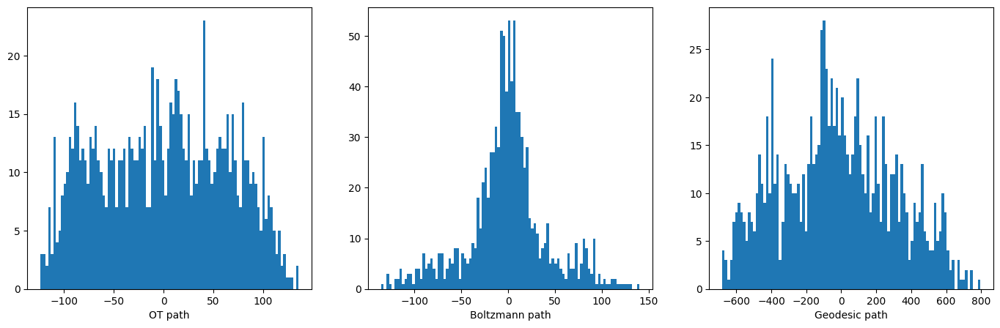

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10903 42557.460938 0.003000
    10913 18983.386719 0.001500
    10923 7227.028809 0.000375
    10933 6663.349609 0.000375
[229, 590133952.0]


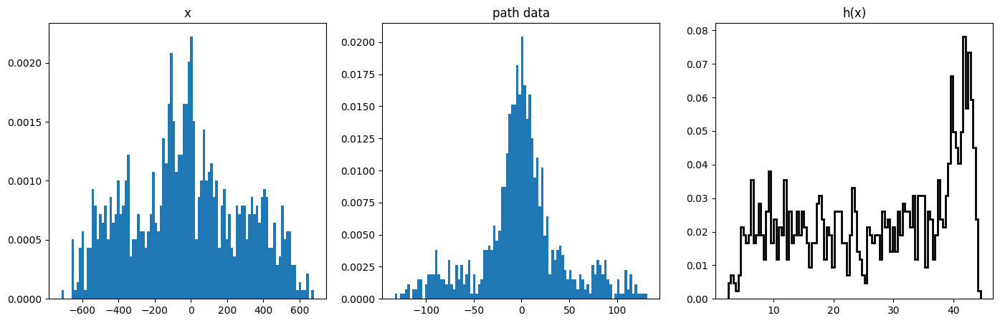

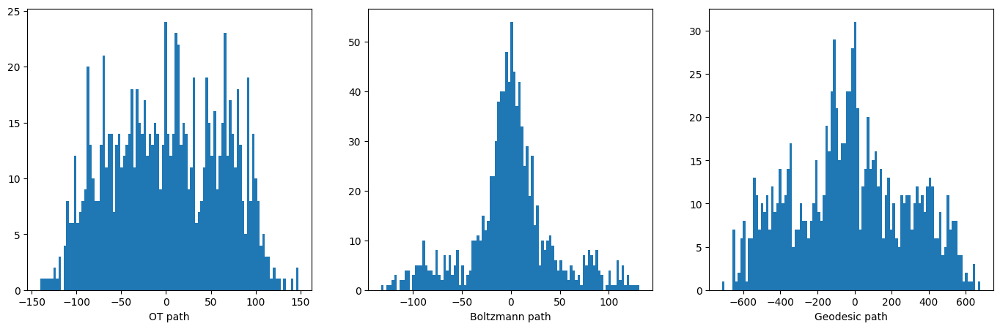

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10939 127746.468750 0.003000
    10949 45309.953125 0.001500
    10959 12821.916016 0.000375
[230, 418620640.0]


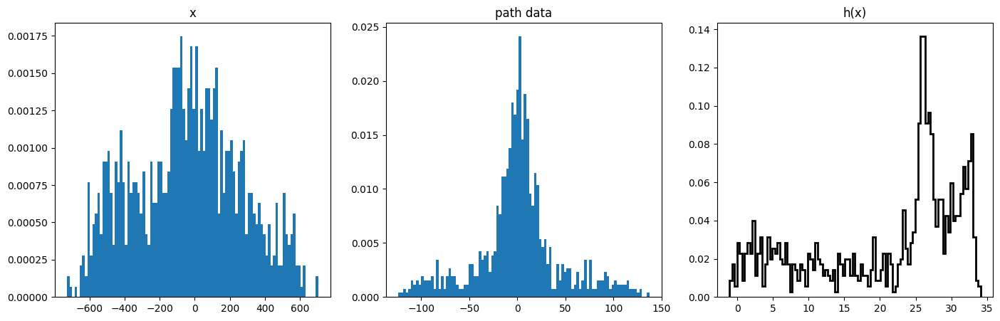

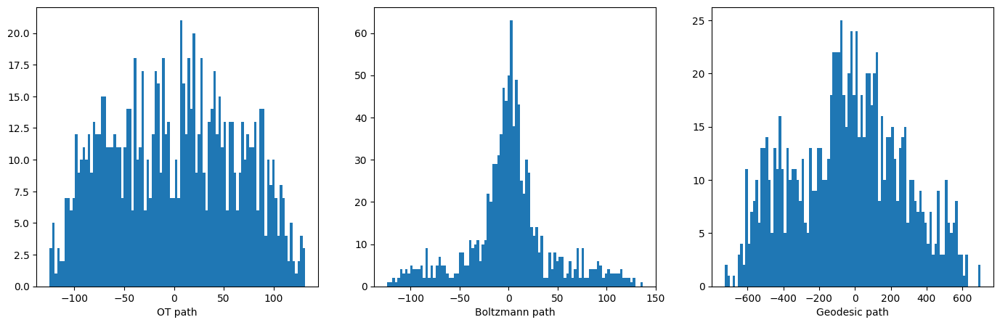

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10964 50891.257812 0.003000
    10974 25547.634766 0.001500
    10984 4016.377441 0.000188
[231, 229864336.0]


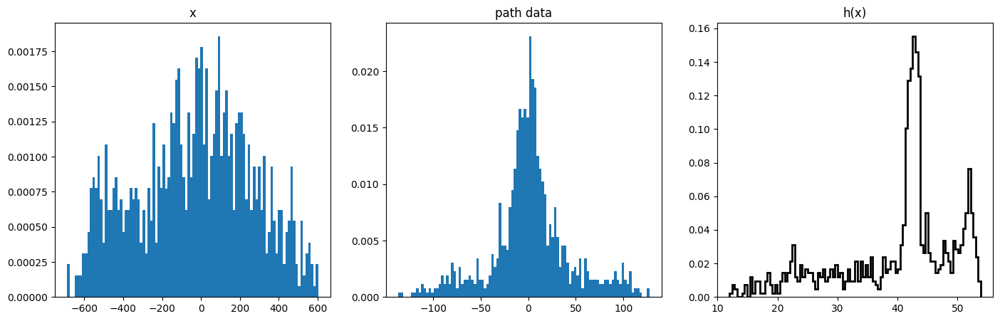

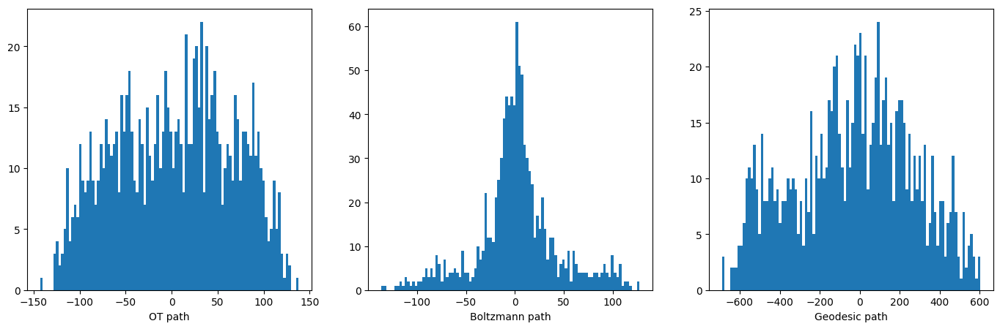

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    10987 6248.187500 0.003000
    10997 9901.205078 0.000750
    11007 5822.404297 0.000188
    11017 5257.383301 0.000188
    11027 5086.377441 0.000188
[232, 300544416.0]


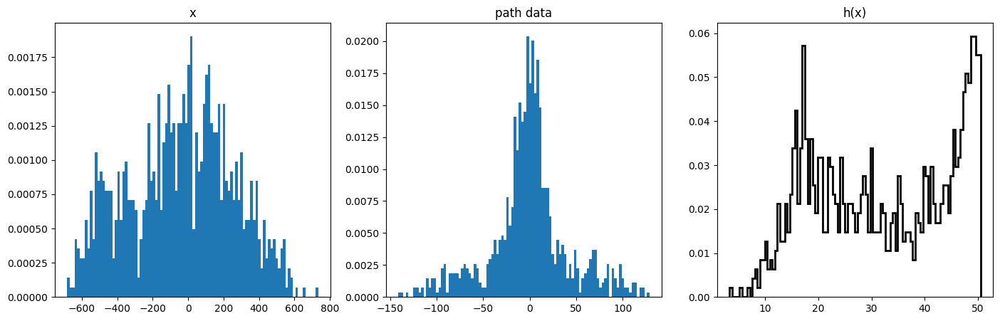

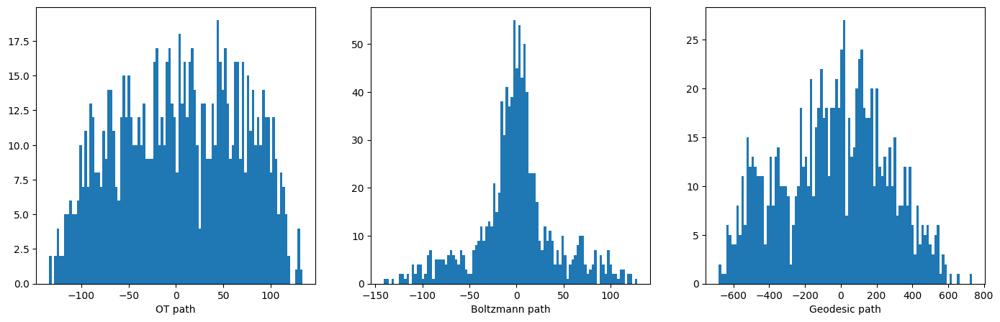

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    11036 5486.209473 0.003000
    11046 4423.320312 0.003000
    11056 3476.783447 0.003000
    11066 2739.711914 0.003000
    11076 2203.218994 0.003000
[233, 220763632.0]


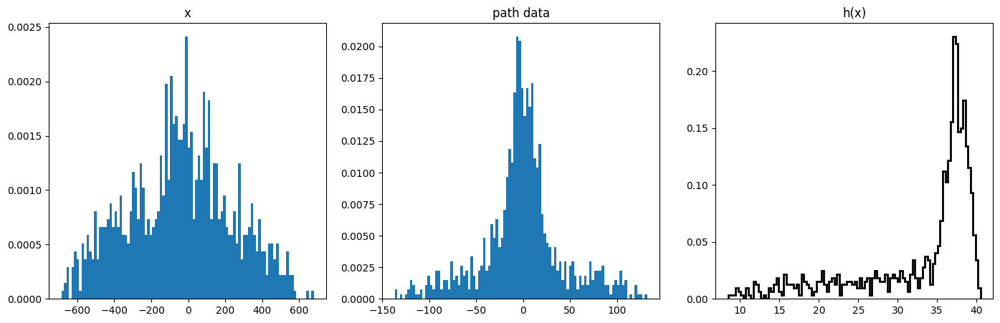

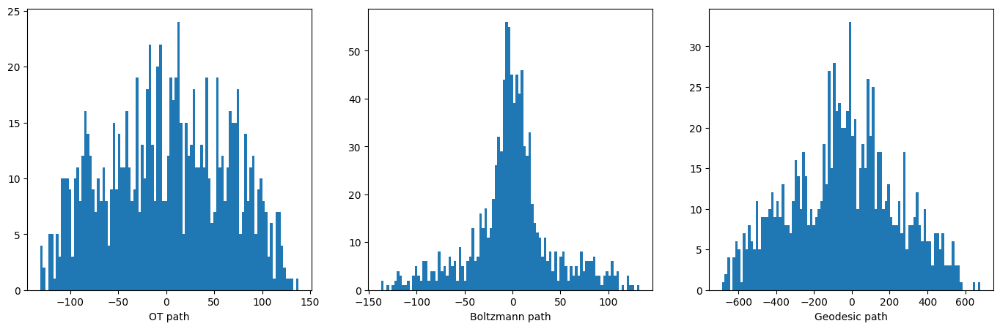

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    11085 87409.281250 0.003000
    11095 25885.519531 0.001500
    11105 12476.671875 0.000375
[234, 170051024.0]


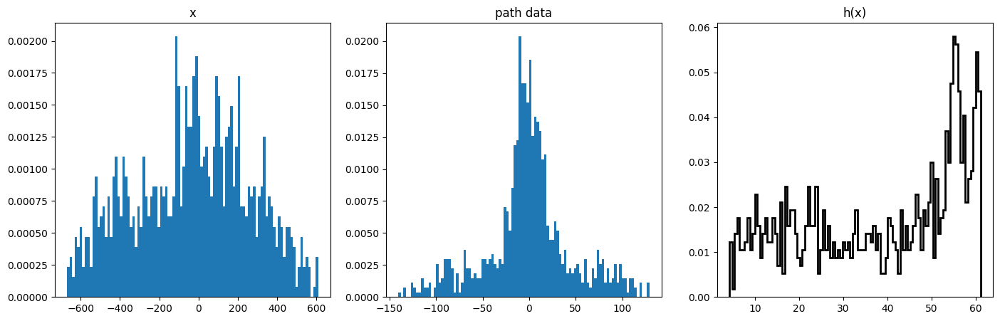

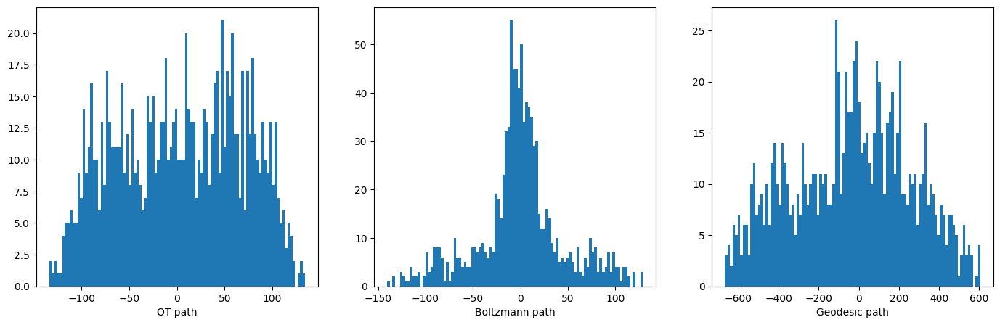

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    11111 50687.582031 0.003000
    11121 23613.382812 0.001500
    11131 5146.679688 0.000188
[235, 544857216.0]


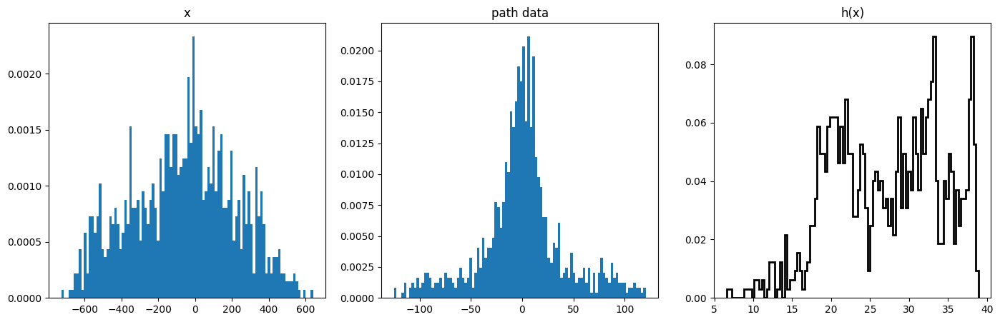

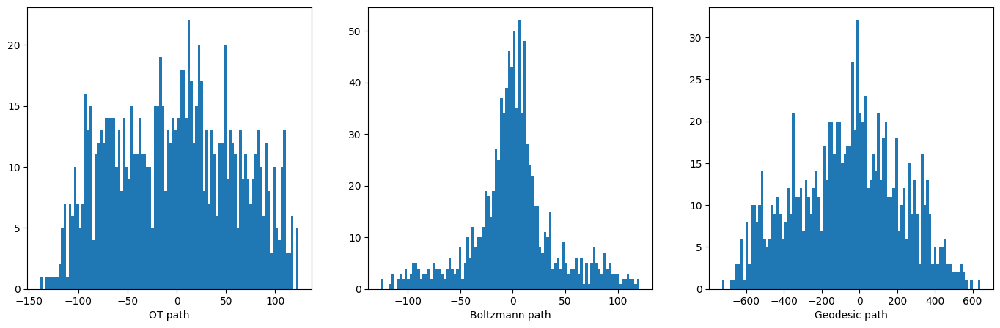

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    11135 7422.541504 0.003000
    11145 10197.208984 0.000750
    11155 6949.793945 0.000188
    11165 6422.242676 0.000188
    11175 6214.497559 0.000188
[236, 348633472.0]


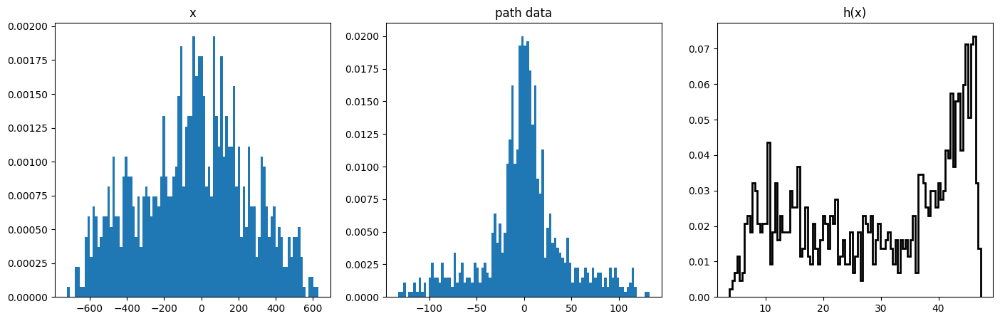

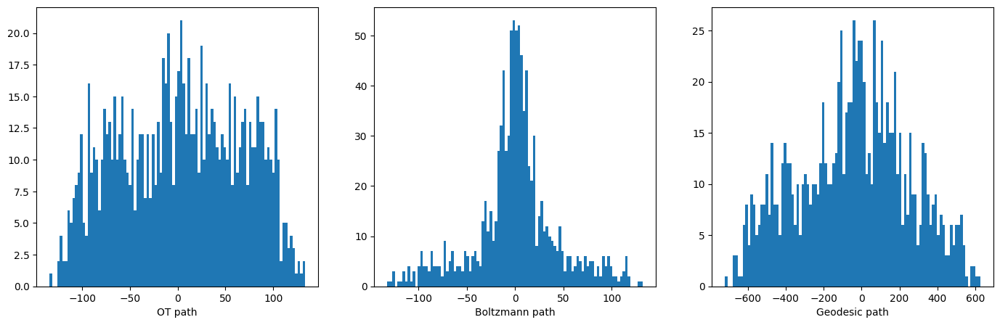

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    11184 11823.695312 0.003000
    11194 6235.574219 0.003000
    11204 4537.966797 0.000750
    11214 4122.010254 0.000750
    11224 4081.001953 0.000188
[237, 343412384.0]


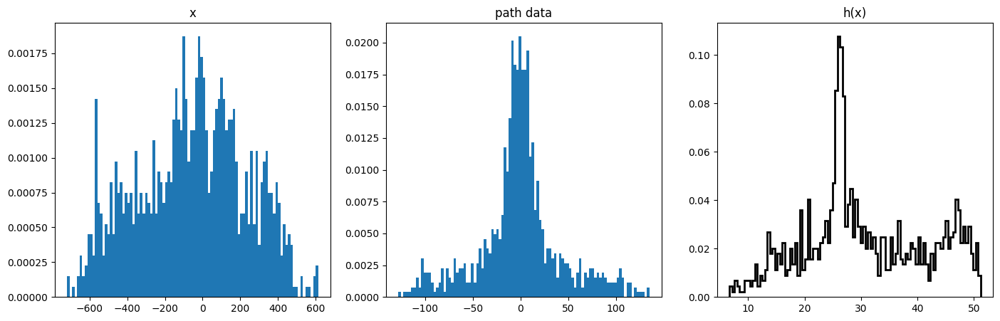

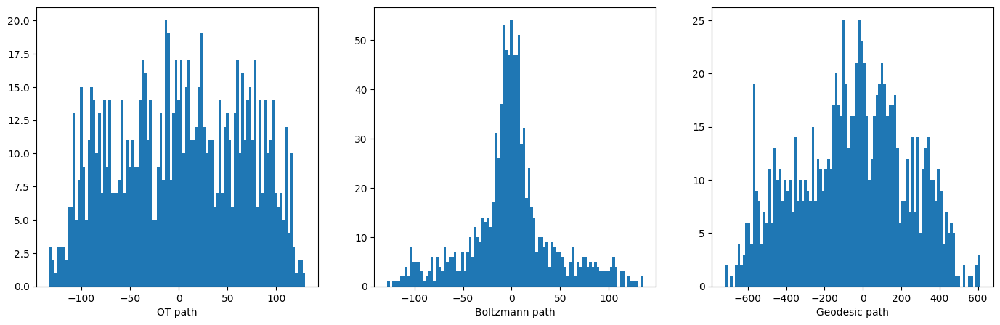

/nfs/scistore14/chenggrp/ptuo/pkgs/deepmd-kit/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


>>> Optimizing $\omega$ parameters of RBF
    step loss          LR
    11233 13169.717773 0.003000
    11243 9779.910156 0.003000


KeyboardInterrupt: 

In [53]:

sigma_min = 0.0001
sample_size = 10**3
l_curve_score_tune = []
print('[Time step, score_loss, otflow_loss]')
for training_step in range(10000):
    sample_t, sample_path, sample_ot = sample_batch_path(sample_size)
    sample_t = torch.from_numpy(sample_t).to(torch.float32).requires_grad_(True)
    sample_ot = torch.from_numpy(sample_ot).to(torch.float32)
    beta = 1./(10.-7.5/(1-sigma_min)*sample_t).sqrt()
    noise = torch.normal(mean=torch.zeros_like(sample_ot), std=beta)
    geo_interpolant = model_s_t(torch.cat([sample_t, sample_ot+noise], dim=1))
    sample_x = sample_ot + sample_t*(1-sample_t) * geo_interpolant
    geo_interpolant_tderiv = torch.autograd.grad(outputs=geo_interpolant, inputs=sample_t, 
                                                 grad_outputs=torch.ones_like(geo_interpolant),
                                                 create_graph=True)[0]
    
    sigma_t =  1 - (1-sigma_min) * sample_t 
    u_t_xx = sample_ot/sigma_t + sample_t*(1-sample_t) * geo_interpolant_tderiv + (1.-2.*sample_t)*geo_interpolant
    if ((training_step % 1) == 0):
        g_sample_x = g_land_rbf(sample_x, torch.from_numpy(sample_path), sample_t, plot_h = True)
    else:
        g_sample_x = g_land_rbf(sample_x, torch.from_numpy(sample_path), sample_t, plot_h = False)
    # score_loss = torch.bmm(u_t_xx.unsqueeze(1), torch.bmm(g_sample_x, u_t_xx.unsqueeze(2))).mean() + ((sample_x - torch.from_numpy(sample_path))**2).mean() # constraint by d(sample_x, sample_path)
    score_loss = torch.bmm(u_t_xx.unsqueeze(1), torch.bmm(g_sample_x, u_t_xx.unsqueeze(2))).mean() + ((sample_x.sum(-1) - torch.from_numpy(sample_path).sum(-1))**2).mean() # constraint by d(Magnetization_x, magnetization_path)


    # Before the backward pass, zero all of the network gradients
    optimizer_s.zero_grad()
    # Backward pass: compute gradient of the loss with respect to parameters
    score_loss.backward()
    # Calling the step function to update the parameters
    optimizer_s.step()
    
    if ((training_step % 1) == 0):
        l_curve_score_tune.append([training_step,score_loss.item()])
    if ((training_step % 1) == 0):
        print([training_step, score_loss.item()])

        plt.figure(figsize=(17,5))
        plt.subplot(131)
        plt.hist(sample_ot.sum(-1), bins=100)
        plt.xlabel("OT path")
        plt.subplot(132)
        plt.hist(sample_path.sum(-1), bins=100)
        plt.xlabel("Boltzmann path")
        plt.subplot(133)
        plt.hist(sample_x.detach().numpy().sum(-1), bins=100)
        plt.xlabel("Geodesic path")
        plt.show()
    if training_step % 5 == 0:
        torch.save(model_s_t.state_dict(), 'checkpoint_geointerpolant.pth')
        torch.save(optimizer_s.state_dict(), "checkpoint_geointerpolant_optimizer.pth")
        torch.save(model_s_t.state_dict(), f'checkpoint_geointerpolant-epoch{training_step+start_epoch}.pth')
        torch.save(optimizer_s.state_dict(), f"checkpoint_geointerpolant_optimizer-epoch{training_step+start_epoch}.pth")

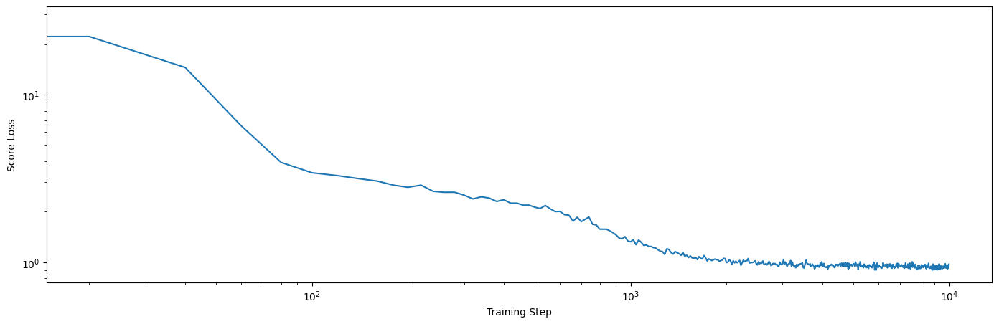

In [124]:

l_curve_score_tune = np.array(l_curve_score_tune)
plt.loglog(l_curve_score_tune[:,0], l_curve_score_tune[:,1])
plt.xlabel('Training Step')
plt.ylabel('Score Loss')
plt.show()

## OT flow

In [ ]:
num_steps=10
plot_Tflow_t = []
plot_Tflow_t.append(sample_batch_prior(size=sample_size))
print("t    beta    kBT")
for ii in range(1,11):
    beta = 1./(10.-7.5*ii*(num_steps//10)/num_steps)
    print(ii, beta, (10.-7.5*ii*(num_steps//10)/num_steps))
    ising_t = Ising(6,2,beta)
    xx = ising_t.sample(sample_size, thermalSteps=1000, initial=torch.from_numpy(plot_Tflow_t[-1]))
    plot_Tflow_t.append(xx.detach().numpy())
plot_Tflow_t = np.array(plot_Tflow_t)

In [120]:
def plot_ot_flow(model_u_t):
    num_steps=10
    sample_size = 10**4
    # xx =  torch.normal(0, 1, size=(sample_size ,36))
    xx = torch.from_numpy(sample_batch_prior(size=sample_size))
    xx_t = []
    xx_t.append(xx.detach().numpy())

    for ii in range(10):
        tt = ii / 10
        samples = torch.cat((torch.ones(sample_size, 1)*tt, xx), axis = 1)
        u_t = model_u_t(samples)
        xx = xx + u_t * 0.1
        xx_t.append(xx.detach().numpy())
    xx_t = np.array(xx_t)

    plt.figure()
    fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))

    for ii in range(1,11):
        ii_y = (ii-1) % 5
        ii_x = (ii-1) // 5
        axes[ii_x,ii_y].set_title('Step '+str(ii*(num_steps//10))+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
        axes[ii_x,ii_y].hist2d(xx_t[ii,:,0], xx_t[ii,:,1],bins=100, cmap='Blues',range=np.array([(-8, 8), (-8, 8)]))
        axes[ii_x,ii_y].set_xlim([-8,8])
        axes[ii_x,ii_y].set_ylim([-8,8])
    
    plt.show()

    return xx_t



<Figure size 1700x500 with 0 Axes>

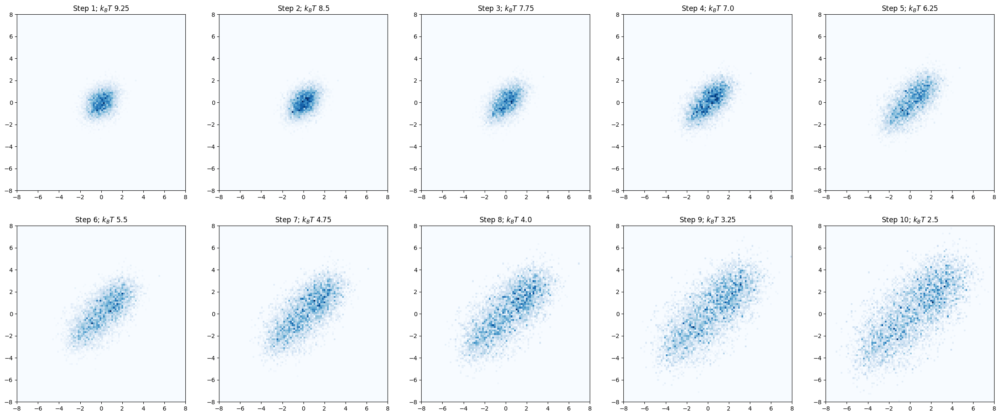

In [121]:
plot_xx_t = plot_ot_flow(model_u_t)

<Figure size 1700x500 with 0 Axes>

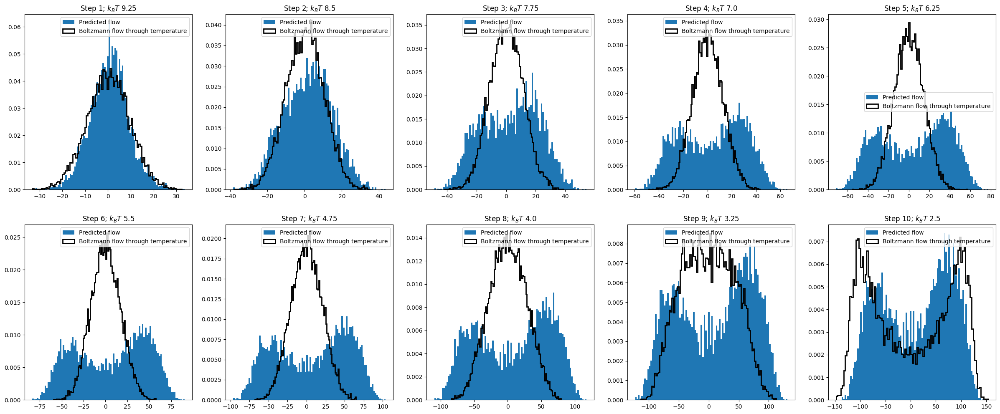

In [122]:
num_steps=10
plt.figure()
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))
for ii in range(1,11):
    ii_y = (ii-1) % 5
    ii_x = (ii-1) // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii)+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
    axes[ii_x,ii_y].hist(plot_xx_t[ii,:,:].sum(-1),bins=100, density=True, label="Predicted flow")
    axes[ii_x,ii_y].hist(plot_Tflow_t[ii,:,:].sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True, label="Boltzmann flow through temperature")
    axes[ii_x,ii_y].legend()
plt.show()

## Continuous time stochastic flow

In [91]:
def plot_flow(model_u_t, model_s_t, g=0.1, num_steps=10):
    sample_size = 10**5
    xx =  torch.normal(0, 1, size=(sample_size ,36))
    xx_t = []
    xx_t.append(xx.detach().numpy())

    for ii in range(num_steps):
        tt = ii / num_steps
        samples = torch.cat((torch.ones(sample_size, 1)*tt, xx), axis = 1)
        u_t = model_u_t(samples) + g**2/2*model_s_t(samples)
        xx = xx + u_t * 1./num_steps
        xx_t.append(xx.detach().numpy())
    xx_t = np.array(xx_t)
    plt.figure()
    fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))

    for ii in range(1,11):
        ii_y = (ii-1) % 5
        ii_x = (ii-1) // 5
        axes[ii_x,ii_y].set_title('Step '+str(ii*(num_steps//10))+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
        axes[ii_x,ii_y].hist2d(xx_t[ii*(num_steps//10),:,0], xx_t[ii*(num_steps//10),:,1],bins=100, cmap='Blues',range=np.array([(-8, 8), (-8, 8)]))
        axes[ii_x,ii_y].set_xlim([-8,8])
        axes[ii_x,ii_y].set_ylim([-8,8])
    
    plt.show()
    return xx_t


### g=0.1

<Figure size 1700x500 with 0 Axes>

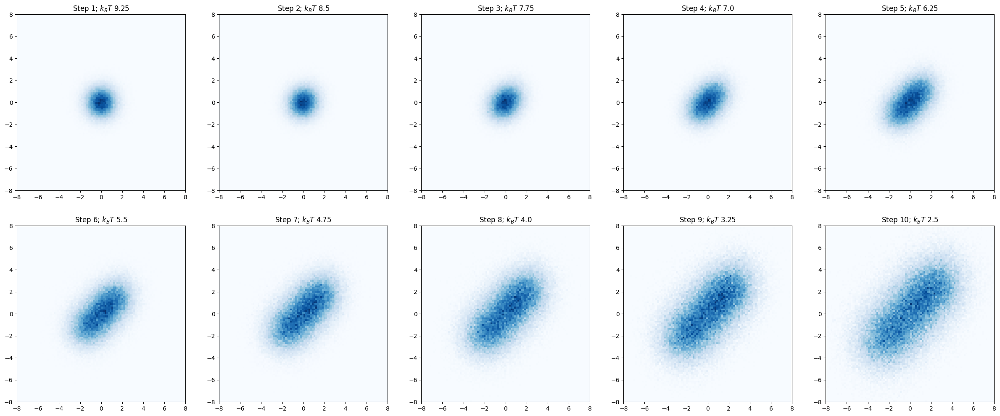

In [92]:
xx_t_g0 = plot_flow(model_u_t, model_s_t)

<Figure size 1700x500 with 0 Axes>

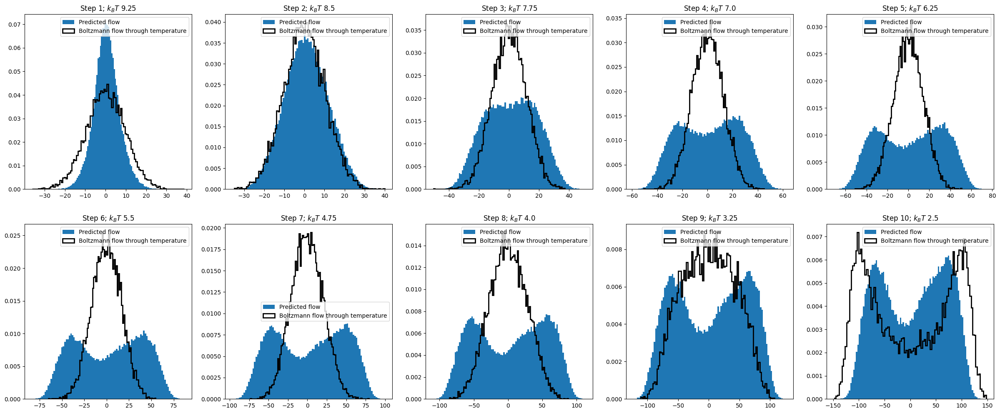

In [96]:
num_steps=10
plt.figure()
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))
for ii in range(1,11):
    ii_y = (ii-1) % 5
    ii_x = (ii-1) // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii)+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
    axes[ii_x,ii_y].hist(xx_t_g0[ii,:,:].sum(-1),bins=100, density=True, label="Predicted flow")
    axes[ii_x,ii_y].hist(plot_Tflow_t[ii,:,:].sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True, label="Boltzmann flow through temperature")
    axes[ii_x,ii_y].legend()
plt.show()

### g=1

<Figure size 1700x500 with 0 Axes>

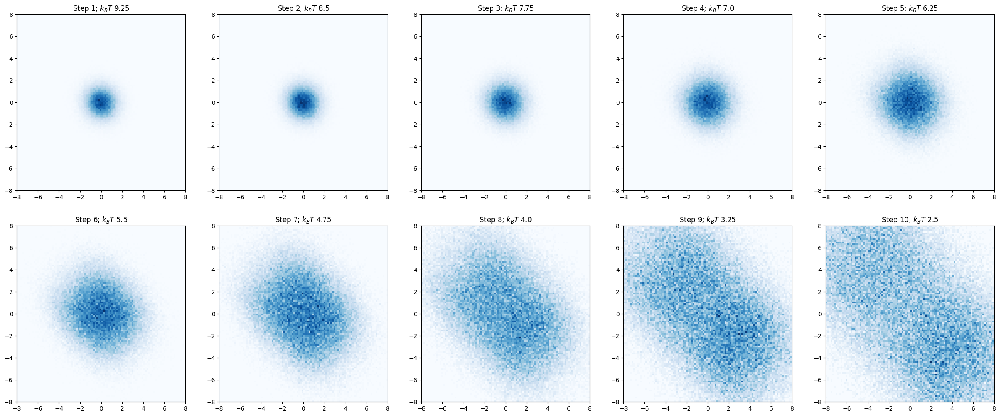

<Figure size 1700x500 with 0 Axes>

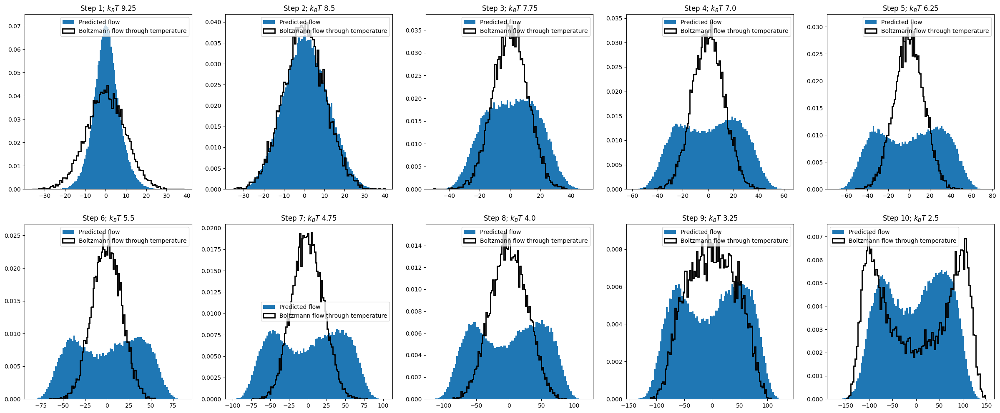

In [97]:
num_steps=10
xx_t_g1 = plot_flow(model_u_t, model_s_t, g=1.)
plt.figure()
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))
for ii in range(1,11):
    ii_y = (ii-1) % 5
    ii_x = (ii-1) // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii)+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
    axes[ii_x,ii_y].hist(xx_t_g1[ii,:,:].sum(-1),bins=100, density=True, label="Predicted flow")
    axes[ii_x,ii_y].hist(plot_Tflow_t[ii,:,:].sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True, label="Boltzmann flow through temperature")
    axes[ii_x,ii_y].legend()
plt.show()

### g=1.5

<Figure size 1700x500 with 0 Axes>

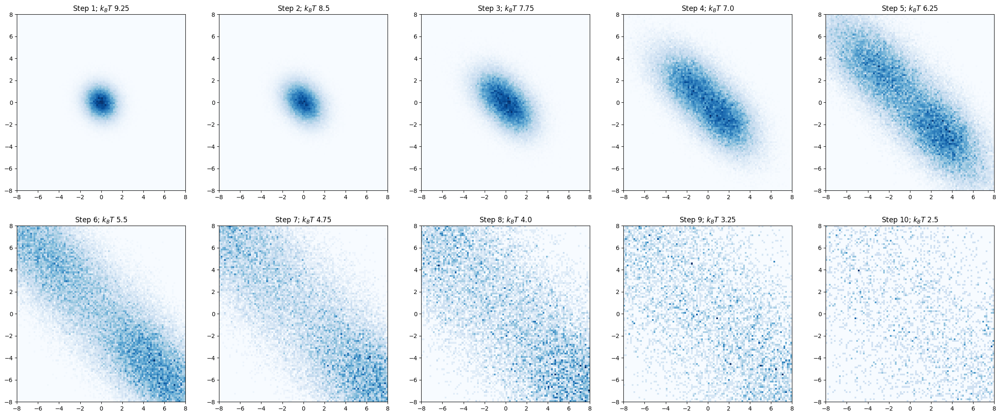

<Figure size 1700x500 with 0 Axes>

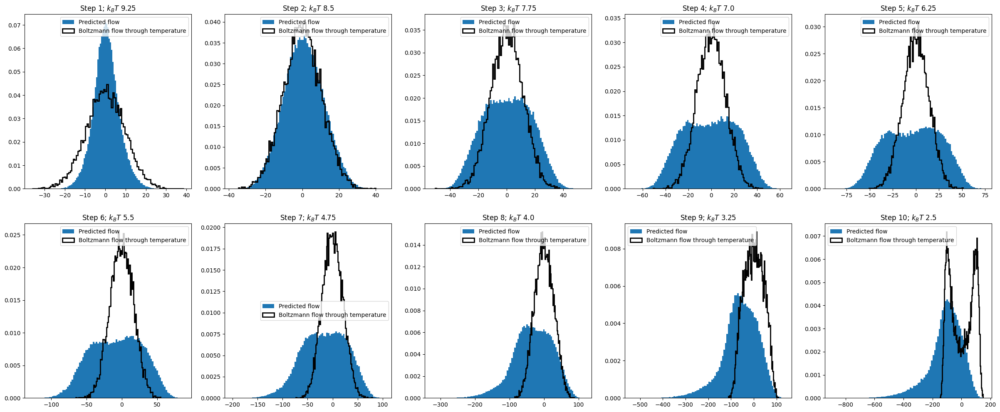

In [98]:
num_steps=10
xx_t_g2 = plot_flow(model_u_t, model_s_t, g=1.5)
plt.figure()
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))
for ii in range(1,11):
    ii_y = (ii-1) % 5
    ii_x = (ii-1) // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii)+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
    axes[ii_x,ii_y].hist(xx_t_g2[ii,:,:].sum(-1),bins=100, density=True, label="Predicted flow")
    axes[ii_x,ii_y].hist(plot_Tflow_t[ii,:,:].sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True, label="Boltzmann flow through temperature")
    axes[ii_x,ii_y].legend()
plt.show()

## Continuous time stochastic flow with score model trained by Ising data

### g=0.1

In [ ]:
num_steps=20
xx_t_g0_t1 = plot_flow(model_u_t, model_s_t, g=0.1, num_steps=20)
plt.figure()
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))
for ii in range(1,11):
    ii_y = (ii-1) % 5
    ii_x = (ii-1) // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii*2)+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
    axes[ii_x,ii_y].hist(xx_t_g0_t1[ii*2,:,:].sum(-1),bins=100, density=True, label="Predicted flow")
    axes[ii_x,ii_y].hist(plot_Tflow_t[ii,:,:].sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True, label="Boltzmann flow through temperature")
    axes[ii_x,ii_y].legend()
plt.show()

In [ ]:
num_steps=20
xx_t_g1_t1 = plot_flow(model_u_t, model_s_t, g=1., num_steps=20)


<Figure size 1700x500 with 0 Axes>

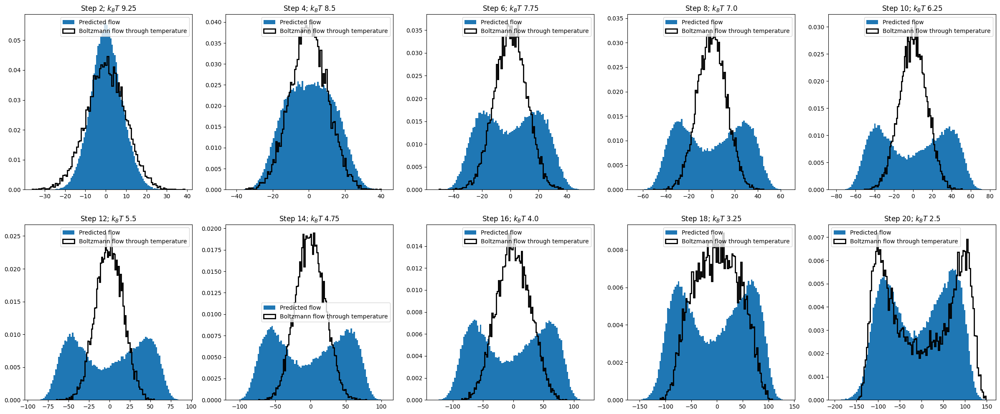

In [104]:
plt.figure()
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))
for ii in range(1,11):
    ii_y = (ii-1) % 5
    ii_x = (ii-1) // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii*2)+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
    axes[ii_x,ii_y].hist(xx_t_g1_t1[ii*2,:,:].sum(-1),bins=100, density=True, label="Predicted flow")
    axes[ii_x,ii_y].hist(plot_Tflow_t[ii,:,:].sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True, label="Boltzmann flow through temperature")
    axes[ii_x,ii_y].legend()
plt.show()

<Figure size 1700x500 with 0 Axes>

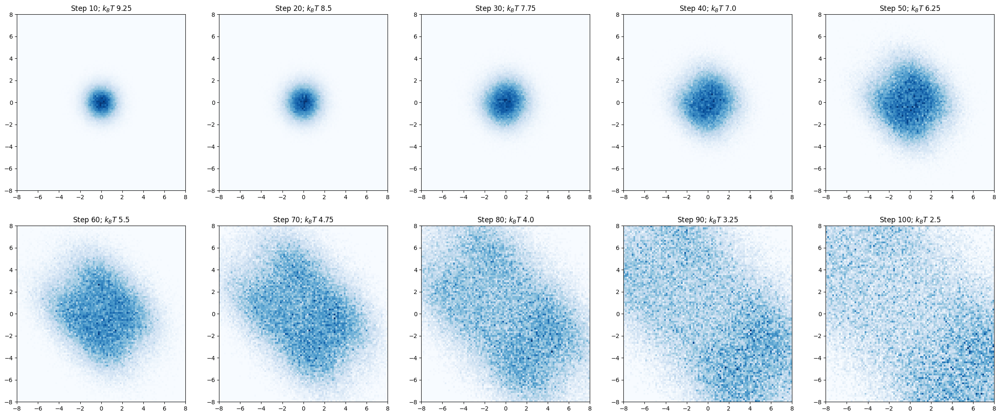

In [107]:
num_steps=100
xx_t_g1_t3 = plot_flow(model_u_t, model_s_t, g=1., num_steps=100)

<Figure size 1700x500 with 0 Axes>

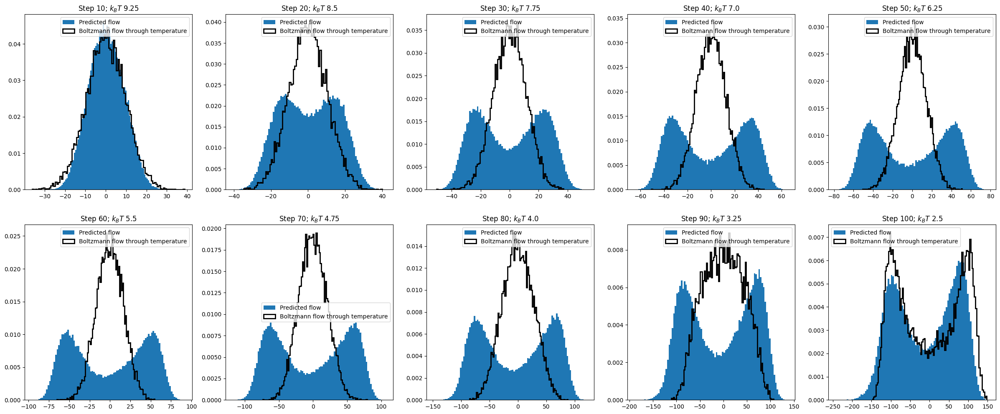

In [109]:
plt.figure()
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))
for ii in range(1,11):
    ii_y = (ii-1) % 5
    ii_x = (ii-1) // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii*10)+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
    axes[ii_x,ii_y].hist(xx_t_g1_t3[ii*10,:,:].sum(-1),bins=100, density=True, label="Predicted flow")
    axes[ii_x,ii_y].hist(plot_Tflow_t[ii,:,:].sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True, label="Boltzmann flow through temperature")
    axes[ii_x,ii_y].legend()
plt.show()

In [ ]:
num_steps=20
xx_t_g2_t1 = plot_flow(model_u_t, model_s_t, g=1.5, num_steps=20)


<Figure size 1700x500 with 0 Axes>

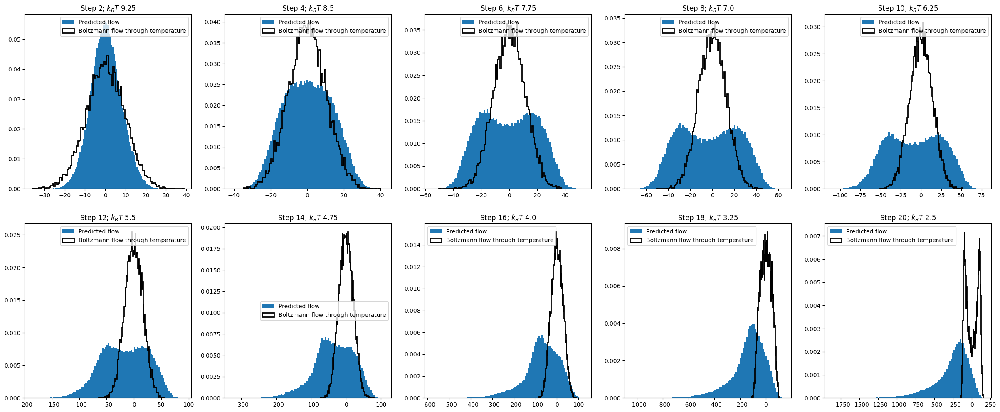

In [106]:
plt.figure()
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))
for ii in range(1,11):
    ii_y = (ii-1) % 5
    ii_x = (ii-1) // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii*2)+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
    axes[ii_x,ii_y].hist(xx_t_g2_t1[ii*2,:,:].sum(-1),bins=100, density=True, label="Predicted flow")
    axes[ii_x,ii_y].hist(plot_Tflow_t[ii,:,:].sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True, label="Boltzmann flow through temperature")
    axes[ii_x,ii_y].legend()
plt.show()

<Figure size 1700x500 with 0 Axes>

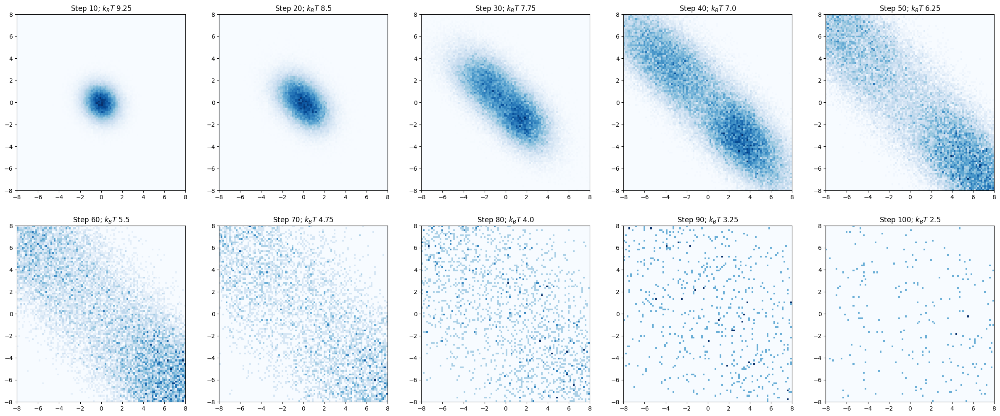

In [110]:
num_steps=100
xx_t_g2_t3 = plot_flow(model_u_t, model_s_t, g=1.5, num_steps=100)

<Figure size 1700x500 with 0 Axes>

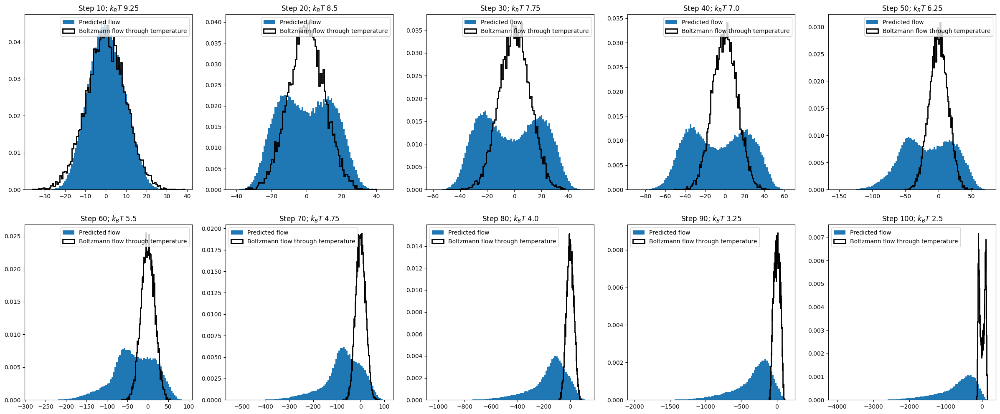

In [111]:
plt.figure()
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))
for ii in range(1,11):
    ii_y = (ii-1) % 5
    ii_x = (ii-1) // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii*10)+"; $k_BT$ "+str(10.-7.5*ii*(num_steps//10)/num_steps))
    axes[ii_x,ii_y].hist(xx_t_g2_t3[ii*10,:,:].sum(-1),bins=100, density=True, label="Predicted flow")
    axes[ii_x,ii_y].hist(plot_Tflow_t[ii,:,:].sum(-1), bins=100, edgecolor='black', histtype='step', linewidth=2, density=True, label="Boltzmann flow through temperature")
    axes[ii_x,ii_y].legend()
plt.show()

# Flow matching with temperature reweighted probability path

In [ ]:
dataset = xx3.detach().numpy()
def sample_batch(size):
    # idx = torch.randint(0, len(dataset), (size,))
    # return dataset[idx]
    idx = np.random.choice(np.arange(len(dataset)), size=size)
    return dataset[idx]

In [ ]:
from torch.autograd.functional import jacobian

sigma_0 = 1
mu_0 = 0
sigma_min = 0.0001

#在格点上产生数据
NT = 10
NS = 5000
NS_xxtilde = 5000
xx_t = np.zeros((NT+1, NS, 36))
# xx_t[0,:,:] = np.random.normal(loc=0.0, scale=1.0, size=(NS,36))
xx_t[0,:,:] = sample_batch(NS)
xxtilde_prev = xx_t[0,:,:]
p_t_xx_xxtilde = np.zeros((NT, NS, NS_xxtilde))
logp_t_xx_xxtilde = np.zeros((NT, NS, NS_xxtilde))
p_t_xx = np.zeros((NT, NS))
u_t_xx_xxtilde = np.zeros((NT, NS, NS_xxtilde, 36))
u_t_xx = np.zeros((NT, NS, 36))
ising_t = Ising(6,2,0.25)
for tt in range(NT):
    beta_tt = 0.25-((0.25-0.1)*(tt+1)/NT)
    print('Step: ' + str(tt) + "; Beta: "+str(beta_tt))
    # ising_t = Ising(6,2,0.1+Delta_beta-sigma_tt*Delta_beta)
    
    # xxtilde = sample_batch(NS_xxtilde)
    if tt == 0:
        xxtilde = ising_t.sample(NS_xxtilde, thermalSteps=1000, initial=torch.from_numpy(xxtilde_prev).to(torch.float32)).detach().numpy()
    else:
        xxtilde = ising_t.sample(NS_xxtilde, thermalSteps=500, initial=torch.from_numpy(xxtilde_prev).to(torch.float32)).detach().numpy()
    xxtilde_prev = xxtilde

    e_xxtilde = ising_t.energy(torch.from_numpy(xxtilde).to(torch.float32).reshape(NS_xxtilde,36)).detach().numpy()
    # lnZ = ising_t.lnZ(torch.from_numpy(xxtilde).reshape(NS_xxtilde,36)).detach().numpy()
    # print(lnZ)
    e_xx_list = []
    for ii in range(NS):
        e_xx = ising_t.energy(torch.from_numpy(xx_t[tt,ii,:]).to(torch.float32).reshape(1,36)).detach().numpy()
        e_xx_list.append(e_xx[0])
        # p_t_xx_xxtilde[tt,ii,:] = np.exp(-(e_xx-e_xxtilde))/np.exp(lnZ)
        logp_t_xx_xxtilde[tt,ii,:] = -(e_xx-e_xxtilde) # -lnZ
        u_t_xx_xxtilde[tt,ii,:,:] = (xxtilde - (1-sigma_min)*xx_t[tt,ii,:].reshape(-1, 36))

    p_t_xx_xxtilde[tt] = np.exp(logp_t_xx_xxtilde[tt].reshape(NS,NS_xxtilde)-logp_t_xx_xxtilde[tt].max())
    p_t_xx[tt, :] = np.mean(p_t_xx_xxtilde[tt, :, :], axis = 1)

    plt.figure(figsize=(29,5))
    plt.subplot(151)
    plt.hist((p_t_xx_xxtilde[tt]/p_t_xx[tt, :]).reshape(-1), bins=100)
    plt.xlabel("p_t_xx_xxtilde[tt]")
    plt.subplot(152)
    plt.hist(e_xx-e_xxtilde, bins=100)
    plt.xlabel(r"(exx-e_xxtilde)/$\beta_t$")
    plt.subplot(153)
    plt.hist(xx_t[tt,:,:].sum(-1),bins=100, range=(xxtilde.sum(-1).min(), xxtilde.sum(-1).max()))
    plt.xlabel("xx_t[tt]")
    plt.subplot(154)
    plt.hist(xxtilde.sum(-1),bins=100)
    plt.xlabel("xxtilde")

    # plt.figure(figsize=(11,5))
    # plt.subplot(121)
    # plt.hist(xx_t[tt,:,:].sum(-1),bins=100, range=(xxtilde.sum(-1).min(), xxtilde.sum(-1).max()))
    # plt.xlabel("xx_t[tt]")
    # plt.subplot(122)
    # plt.hist(xxtilde.sum(-1),bins=100)
    # plt.xlabel("xxtilde")
    # plt.show()

    for ii in range(NS):
        for jj in range(36):
            u_t_xx[tt,ii,jj] = np.mean(p_t_xx_xxtilde[tt,ii,:] * u_t_xx_xxtilde[tt,ii,:,jj] / p_t_xx[tt,ii])

    plt.subplot(155)
    # plt.hist(u_t_xx[tt].sum(-1) * Delta_beta/NT,bins=100)
    # plt.xlabel("u_t[tt]")
    plt.scatter(xx_t[tt].sum(-1).reshape(-1), u_t_xx[tt].sum(-1) * 1./NT, s=3)
    plt.xlabel("xx_t[tt]")
    plt.ylabel("u_t[tt]")
    plt.show()

    xx_t[tt+1,:,:] = xx_t[tt,:,:] + u_t_xx[tt,:,:]

In [ ]:
torch.exp(torch.tensor(-80.))

tensor(1.8049e-35)

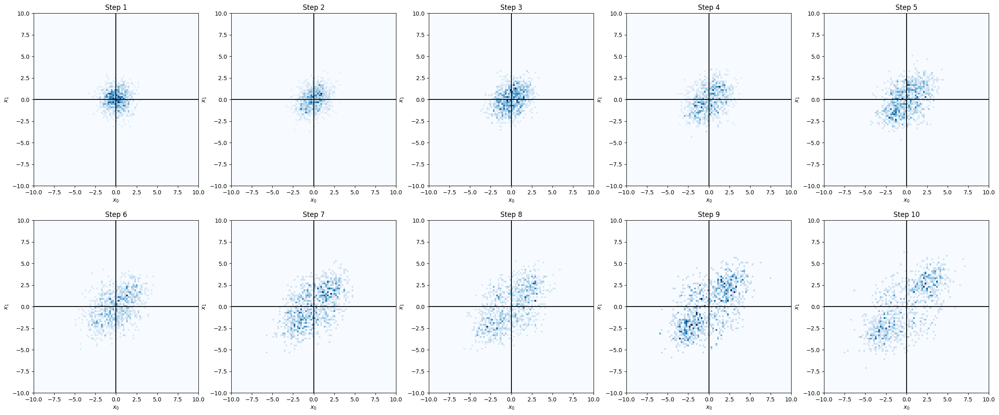

In [ ]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))

for ii in range(10):
    ii_y = ii % 5
    ii_x = ii // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii+1))
    axes[ii_x,ii_y].hist2d(xx_t[ii*5,:,0], xx_t[ii*5,:,1],bins=100, cmap='Blues',range=np.array([(-10, 10), (-10, 10)]))
    axes[ii_x,ii_y].axhline(0, c="k")
    axes[ii_x,ii_y].axvline(0, c="k")
    axes[ii_x,ii_y].set_xlabel("$x_{0}$")
    axes[ii_x,ii_y].set_ylabel("$x_{1}$")
plt.show()

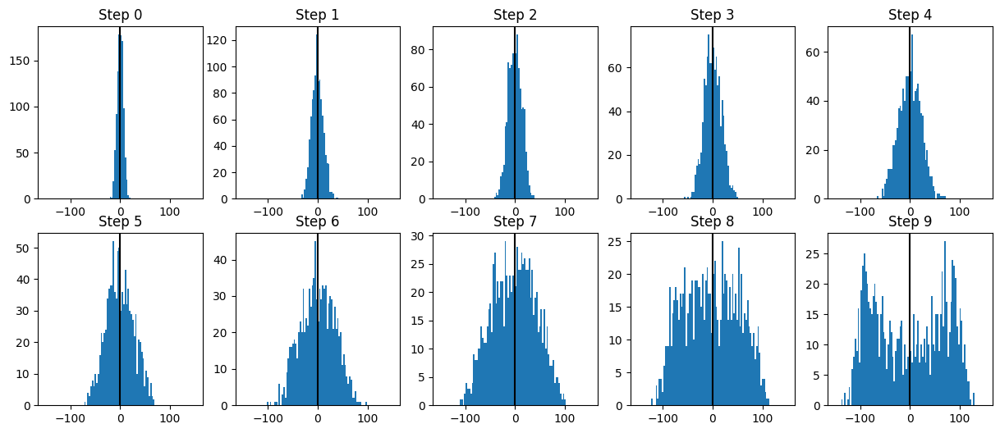

In [ ]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(15, 6))

for ii in range(10):
    ii_y = ii % 5
    ii_x = ii // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii))
    axes[ii_x,ii_y].hist(xx_t[(ii)*5,:,:].sum(-1),bins=100, range=(-150,150))
    axes[ii_x,ii_y].axvline(0, c="k")
plt.show()

In [ ]:
def fm_loss(model, samples, u_t_label):
    samples.requires_grad_(True)
    u_t_model = model(samples)
    # Compute the norm loss
    norm_loss = torch.norm(u_t_label - u_t_model, dim = -1) ** 2 / 2.
    return norm_loss.mean(-1)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

model_u_t = nn.Sequential(
    nn.Linear(37, 128), nn.Softplus(),
    nn.Linear(128, 128), nn.Softplus(),
    nn.Linear(128, 36)
)

optimizer = optim.Adam(model_u_t.parameters(), lr=3e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=1000, gamma=0.9)

l_curve = []
batch_size = 256
samples = np.zeros((batch_size, 37))
print('[Time step, loss value, lr]')
for t in range(20000):
    idx = np.random.choice(NS * NT, batch_size)
    t_idx = idx // NS
    x_idx = idx % NS
    samples[:,0] = t_idx / 10 
    samples[:,1:] = xx_t[t_idx, x_idx, :]
    u_t_label = torch.tensor(u_t_xx[t_idx, x_idx, :]).float()
    loss = fm_loss(model_u_t, torch.tensor(samples).float(), u_t_label)
    # Before the backward pass, zero all of the network gradients
    optimizer.zero_grad()
    # Backward pass: compute gradient of the loss with respect to parameters
    loss.backward()
    # Calling the step function to update the parameters
    scheduler.step()
    optimizer.step()
    if ((t % 20) == 0):
        l_curve.append([t,loss.item()])
    if ((t % 1000) == 0):
        print([t,loss.item(),scheduler.get_last_lr()])

[Time step, loss value, lr]
[0, 3339550.0, [0.003]]
[1000, 2048643.625, [0.0027]]
[2000, 1758384.0, [0.0024300000000000003]]
[3000, 1929806.375, [0.002187]]
[4000, 1695513.375, [0.0019683]]
[5000, 1716151.75, [0.00177147]]
[6000, 1774280.5, [0.0015943230000000001]]
[7000, 1850370.5, [0.0014348907]]
[8000, 1767070.625, [0.00129140163]]
[9000, 1702445.875, [0.001162261467]]
[10000, 1763267.75, [0.0010460353203000001]]
[11000, 1791267.375, [0.0009414317882700001]]
[12000, 1810621.625, [0.0008472886094430002]]
[13000, 1804188.25, [0.0007625597484987002]]
[14000, 1838576.5, [0.0006863037736488302]]
[15000, 1794693.75, [0.0006176733962839472]]
[16000, 1661607.375, [0.0005559060566555524]]
[17000, 1854034.75, [0.0005003154509899972]]
[18000, 1658527.375, [0.00045028390589099747]]
[19000, 1613891.875, [0.0004052555153018977]]


In [ ]:
print('[Time step, loss value, lr]')
for t in range(20000, 30000):
    idx = np.random.choice(NS * NT, batch_size)
    t_idx = idx // NS
    x_idx = idx % NS
    samples[:,0] = t_idx / 10 
    samples[:,1:] = xx_t[t_idx, x_idx, :]
    u_t_label = torch.tensor(u_t_xx[t_idx, x_idx, :]).float()
    loss = fm_loss(model_u_t, torch.tensor(samples).float(), u_t_label)
    # Before the backward pass, zero all of the network gradients
    optimizer.zero_grad()
    # Backward pass: compute gradient of the loss with respect to parameters
    loss.backward()
    # Calling the step function to update the parameters
    scheduler.step()
    optimizer.step()
    if ((t % 20) == 0):
        l_curve.append([t,loss.item()])
    if ((t % 1000) == 0):
        print([t,loss.item(),scheduler.get_last_lr()])

[Time step, loss value, lr]
[20000, 1708818.5, [0.00036472996377170795]]
[21000, 1633993.25, [0.00032825696739453717]]
[22000, 1684556.625, [0.00029543127065508344]]
[23000, 1630271.625, [0.0002658881435895751]]
[24000, 1527097.25, [0.0002392993292306176]]
[25000, 1745271.375, [0.00021536939630755584]]
[26000, 1794781.0, [0.00019383245667680025]]
[27000, 1631388.0, [0.00017444921100912022]]
[28000, 1701325.75, [0.0001570042899082082]]
[29000, 1713442.125, [0.0001413038609173874]]


In [ ]:
def plot_flow(model):
    sample_size = 10**3
    xx =  torch.normal(0, 1, size=(sample_size ,36))
    xx_t = []
    xx_t.append(xx.detach().numpy())
    plt.figure(figsize=(11,5))
    for ii in range(50):
        tt = ii / 50
        samples = torch.cat((torch.ones(sample_size, 1)*tt, xx), axis = 1)
        u_t = model(samples)
        print("Step = "+str(ii))
        plt.figure(figsize=(11,5))
        plt.subplot(121)
        plt.hist2d(u_t[:,0].detach().numpy(), u_t[:,1].detach().numpy(), bins=100, range=[[u_t_xx[ii].min(),u_t_xx[ii].max()], [u_t_xx[ii].min(), u_t_xx[ii].max()]])
        plt.subplot(122)
        plt.hist2d(u_t_xx[ii][:,0], u_t_xx[ii][:,1], bins=100, range=[[u_t_xx[ii].min(),u_t_xx[ii].max()], [u_t_xx[ii].min(), u_t_xx[ii].max()]])
        plt.show()
        xx = xx + u_t * 1./50
        xx_t.append(xx.detach().numpy())
    xx_t = np.array(xx_t)

    # fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))

    # for ii in range(1,11):
    #     ii_y = (ii-1) % 5
    #     ii_x = (ii-1) // 5
    #     axes[ii_x,ii_y].set_title('Step '+str(ii))
    #     axes[ii_x,ii_y].hist2d(xx_t[ii*5,:,0], xx_t[ii*5,:,1],bins=100, cmap='Blues',range=np.array([(-10, 10.0), (-10, 10.0)]))
    #     axes[ii_x,ii_y].set_xlim([-1.5,2])
    #     axes[ii_x,ii_y].set_ylim([-1.5,2])
    
    # plt.show()

# print(u_t_xx.shape)
plot_flow(model_u_t)

# Flow matching with dirichlet path

In [ ]:

def pbc(i,L):
    assert i>=-1 and i<=L
    if i-L == 0:
        return 0
    elif i == -1:
        return L-1
    else:
        return i

def ising_boltzman_prob(logits, J=1):
    assert logits.shape[-1] == 2
    B,H,W,K = logits.shape
    spins = torch.sum(logits*torch.tensor([-1,1], device=logits.device)[None,None,None,:], dim=-1)

    E = torch.zeros(B, device=logits.device)
    for i in range(H):
            E += -(spins[:,i,:]*spins[:,pbc(i-1,L=H),:]*J).sum(dim=-1)
            E += -(spins[:,i,:]*spins[:,pbc(i+1,L=H),:]*J).sum(dim=-1)
    for j in range(W):
            E += -(spins[:,:,j]*spins[:,:,pbc(j-1,L=H)]*J).sum(dim=1)
            E += -(spins[:,:,j]*spins[:,:,pbc(j+1,L=H)]*J).sum(dim=1)

    # for i in range(H):
    #     for j in range(W):
    #         E += -spins[:,i,j]*spins[:,pbc(i-1,L=H),j]*J
    #         E += -spins[:,i,j]*spins[:,pbc(i+1,L=H),j]*J
    #         E += -spins[:,i,j]*spins[:,i,pbc(j-1,L=H)]*J
    #         E += -spins[:,i,j]*spins[:,i,pbc(j+1,L=H)]*J

    E /= 2
    return E

In [ ]:
dataset = np.load("data/ising-latt6x6-T4.0/latt6x6/buffer-S4.00.npy")
dataset[np.where(dataset==-1)]=0
def sample_batch(size):
    # idx = torch.randint(0, len(dataset), (size,))
    # return dataset[idx]
    idx = np.random.choice(np.arange(len(dataset)), size)
    return dataset[idx]

In [ ]:
sigma_0 = 1
mu_0 = 0
sigma_min = 0.0001

#在格点上产生数据
NT = 50
NS = 1000
NS_xxtilde = 1000
xx_t = torch.zeros((NT+1, NS, 36))
# xx_t[0,:,:] = np.random.normal(size=(NS,36))
alphas = torch.ones([NS, 36, 2])
xx_t[0,:,:] = torch.distributions.Dirichlet(alphas).sample()[:,:,0]

p_t_xx_xxtilde = torch.zeros((NT, NS, NS_xxtilde))
p_t_xx = torch.zeros((NT, NS))
u_t_xx_xxtilde = torch.zeros((NT, NS, NS_xxtilde, 36))
u_t_xx = torch.zeros((NT, NS, 36))

for tt in range(NT):
    print('Step: ' + str(tt))
    sigma_tt = (1 - (1-sigma_min) * tt / NT)
    xxtilde = torch.from_numpy(sample_batch(NS_xxtilde)).to(torch.int64)
    e_xxtilde = ising_boltzman_prob(torch.nn.functional.one_hot(xxtilde.reshape(-1), num_classes=2).reshape(NS_xxtilde, 6,6, 2))
    Z = torch.exp(-e_xxtilde*sigma_tt).sum()

    rand_indices = torch.randint(0, 2, (NS, NS, 36))
    rand_onehot = torch.zeros([NS, NS, 36, 2])
    rand_onehot.scatter_(-1, rand_indices.unsqueeze(-1), 1)
    alphas = torch.ones([NS, NS, 36, 2])
    alphas = alphas + sigma_tt*rand_onehot.reshape(NS, NS, 36, 2)
    xx = torch.distributions.Dirichlet(alphas).sample()
    e_xx = ising_boltzman_prob(rand_onehot.reshape(-1,6,6,2)).reshape(NS,NS)
    for ii in range(NS):
        p_xx_xxtilde = torch.exp(-(e_xx[ii,:]-e_xxtilde)*sigma_tt)/Z
        u_t_xx_xxtilde[tt,ii,:,:] = (xxtilde - (1-sigma_min)*xx_t[tt,ii,:].reshape(-1, 36)) / sigma_tt
    p_t_xx[tt, :] = torch.mean(p_t_xx_xxtilde[tt, :, :], axis = 1)
    for ii in range(NS):
        for jj in range(36):
            u_t_xx[tt,ii,jj] = torch.mean(p_t_xx_xxtilde[tt,ii,:] * u_t_xx_xxtilde[tt,ii,:,jj] / p_t_xx[tt,ii])
    xx_t[tt+1,:,:] = xx_t[tt,:,:] + u_t_xx[tt,:,:] * 0.02

In [ ]:
spins = xx_t*(-1.)+(1-xx_t)*1

In [ ]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(30, 12))

for ii in range(10):
    ii_y = ii % 5
    ii_x = ii // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii+1))
    axes[ii_x,ii_y].hist2d(spins[(ii)*5,:,0], spins[ii+1,:,1],bins=100, cmap='Blues',range=np.array([(-3.5, 3.5), (-3.5, 3.5)]))
    axes[ii_x,ii_y].set_xlim([-1.5,2])
    axes[ii_x,ii_y].set_ylim([-1.5,2]) 
    axes[ii_x,ii_y].axhline(0, c="k")
    axes[ii_x,ii_y].axvline(0, c="k")
    axes[ii_x,ii_y].set_xlabel("$x_{0}$")
    axes[ii_x,ii_y].set_ylabel("$x_{1}$")
plt.show()

In [ ]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(15, 6))

for ii in range(10):
    ii_y = ii % 5
    ii_x = ii // 5
    axes[ii_x,ii_y].set_title('Step '+str(ii))
    axes[ii_x,ii_y].hist(spins[(ii)*5,:,:].sum(-1),bins=100)
    axes[ii_x,ii_y].axvline(0, c="k")
    axes[ii_x,ii_y].set_xlim((-50,50))
plt.show()

In [ ]:
raise RuntimeError

# Test Harmonic oscillator

In [ ]:
class Harmonic_Oscillator:
    def __init__(self,T):
        self.T = T
        self.kappa = 1.0/T
        self.nvars=[36]

    def energy(self, x):
        return ((x)**2*self.kappa).sum(axis=1)


    def sample(self, batchSize, thermalSteps = 50, interSteps=5, epsilon=0.1, initial = None):
        return self._sampleWithHMC(batchSize,thermalSteps,interSteps, epsilon, initial)

    def _sampleWithHMC(self,batchSize,thermalSteps = 50, interSteps = 5, epsilon=0.1, initial = None):
        if initial is None:
            initial = torch.randn([batchSize]+self.nvars,requires_grad=True)
        initial = HMC(self.energy,initial,thermalSteps,interSteps,epsilon)
        return initial.detach()

        

In [ ]:


plt.rcParams['figure.figsize'] = (17, 5)
harmonic_oscillator = Harmonic_Oscillator(10)
xx0 = harmonic_oscillator.sample(10000)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx0.reshape(-1,36)[:,0], xx0.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
setfigform_simple("$x_{00}$", "$x_{01}$")
plt.subplot(132)
_ = plt.hist(xx0.reshape(-1), bins=100)
setfigform_simple("$x$", "", yticks=[])
plt.subplot(133)
_ = plt.hist(xx0.reshape(-1,36).sum(-1), bins=100)
setfigform_simple("$\sum_{ij}x_{ij}$", "", yticks=[])

In [ ]:
harmonic_oscillator = Harmonic_Oscillator(5)
xx1 = harmonic_oscillator.sample(10000, thermalSteps = 1000, interSteps=50, initial=xx0)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx1.reshape(-1,36)[:,0], xx1.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
plt.subplot(132)
_ = plt.hist(xx1.reshape(-1), bins=100)
plt.subplot(133)
_ = plt.hist(xx1.reshape(-1,36).sum(-1), bins=100)

In [ ]:
harmonic_oscillator = Harmonic_Oscillator(4)
xx2 = harmonic_oscillator.sample(10000, thermalSteps = 1000, interSteps=50, initial=xx1)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx2.reshape(-1,36)[:,0], xx2.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
plt.subplot(132)
_ = plt.hist(xx2.reshape(-1), bins=100)
plt.subplot(133)
_ = plt.hist(xx2.reshape(-1,36).sum(-1), bins=100)

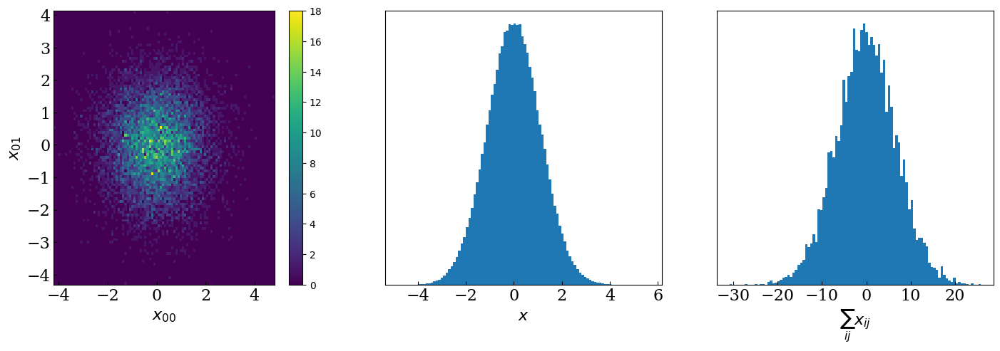

In [ ]:
harmonic_oscillator = Harmonic_Oscillator(2.5)
xx3 = harmonic_oscillator.sample(10000, thermalSteps = 1000, interSteps=50, initial=xx2)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx3.reshape(-1,36)[:,0], xx3.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
setfigform_simple("$x_{00}$", "$x_{01}$")
plt.subplot(132)
_ = plt.hist(xx3.reshape(-1), bins=100)
setfigform_simple("$x$", "", yticks=[])
plt.subplot(133)
_ = plt.hist(xx3.reshape(-1,36).sum(-1), bins=100)
setfigform_simple("$\sum_{ij}x_{ij}$", "", yticks=[])

# Test continous x with nearest neighbor interactions

In [ ]:
class nn_harmonic_oscillator:
    def __init__(self,L,d,beta,name = None):
        if name is None:
            name = "Ising_l"+str(L)+"_d" +str(d)+"_beta"+str(beta)
        self.beta = beta
        self.lattice = Hypercube(L, d, 'periodic')
        K = self.lattice.Adj*beta
        self.K = torch.from_numpy(K).to(torch.float32)
        # w, v = eigh(self.K)    
        # offset = 0.1-w.min()
        # print("offset", offset)
        # self.K += np.eye(w.size)*offset
        # sign, logdet = np.linalg.slogdet(self.K)
        # self.Kinv = torch.from_numpy(inv(self.K)).to(torch.float32)
        self.nvars = [L**d]

    def energy(self,x):
        return -0.5*(torch.mm(x.reshape(-1, self.nvars[0]),self.K) * x.reshape(-1, self.nvars[0])).sum(dim=1)

    def sample(self, batchSize, thermalSteps = 50, interSteps=5, epsilon=0.1, initial = None):
        return self._sampleWithHMC(batchSize,thermalSteps,interSteps, epsilon, initial)


    def _sampleWithHMC(self,batchSize,thermalSteps = 50, interSteps = 5, epsilon=0.1, initial = None):
        if initial is None:
            initial = torch.randn([batchSize]+self.nvars,requires_grad=True)
        initial = HMC(self.energy,initial,thermalSteps,interSteps,epsilon)
        return initial.detach()


In [ ]:


plt.rcParams['figure.figsize'] = (17, 5)
nn_oscillator = nn_harmonic_oscillator(6,2,0.1)
xx0 = nn_oscillator.sample(10000)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx0.reshape(-1,36)[:,0], xx0.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
setfigform_simple("$x_{00}$", "$x_{01}$")
plt.subplot(132)
_ = plt.hist(xx0.reshape(-1), bins=100)
setfigform_simple("$x$", "", yticks=[])
plt.subplot(133)
_ = plt.hist(xx0.reshape(-1,36).sum(-1), bins=100)
setfigform_simple("$\sum_{ij}x_{ij}$", "", yticks=[])

In [ ]:
nn_oscillator = nn_harmonic_oscillator(6,2,0.2)
xx1 = nn_oscillator.sample(10000, thermalSteps = 1000, interSteps=50, initial=xx0)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx1.reshape(-1,36)[:,0], xx1.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
plt.subplot(132)
_ = plt.hist(xx1.reshape(-1), bins=100)
plt.subplot(133)
_ = plt.hist(xx1.reshape(-1,36).sum(-1), bins=100)

In [ ]:
nn_oscillator = nn_harmonic_oscillator(6,2,0.25)
xx2 = nn_oscillator.sample(10000, thermalSteps = 1000, interSteps=50, initial=xx1)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx2.reshape(-1,36)[:,0], xx2.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
plt.subplot(132)
_ = plt.hist(xx2.reshape(-1), bins=100)
plt.subplot(133)
_ = plt.hist(xx2.reshape(-1,36).sum(-1), bins=100)

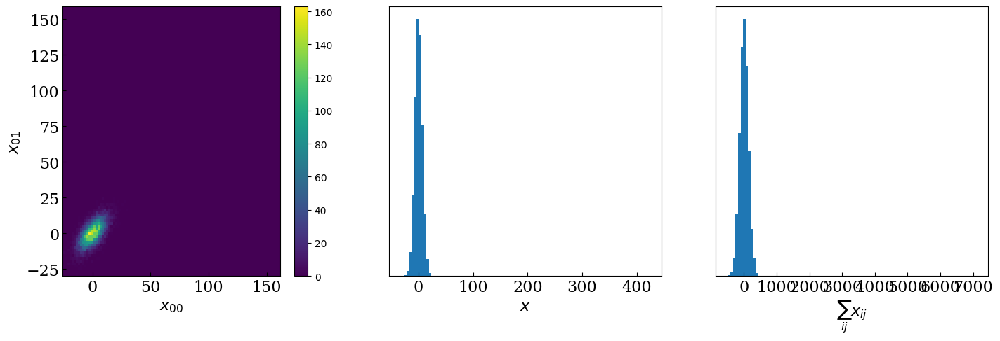

In [ ]:
nn_oscillator = nn_harmonic_oscillator(6,2,0.4)
xx3 = nn_oscillator.sample(10000, thermalSteps = 1000, interSteps=50, initial=xx2)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx3.reshape(-1,36)[:,0], xx3.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
setfigform_simple("$x_{00}$", "$x_{01}$")
plt.subplot(132)
_ = plt.hist(xx3.reshape(-1), bins=100)
setfigform_simple("$x$", "", yticks=[])
plt.subplot(133)
_ = plt.hist(xx3.reshape(-1,36).sum(-1), bins=100)
setfigform_simple("$\sum_{ij}x_{ij}$", "", yticks=[])

# Test the gaussian integral continuous Ising model
## Sample by annealing
$k_BT=\infty \rightarrow 10J\rightarrow 5J\rightarrow 4J\rightarrow 2.5J$

### $k_BT=\infty \rightarrow 10J$

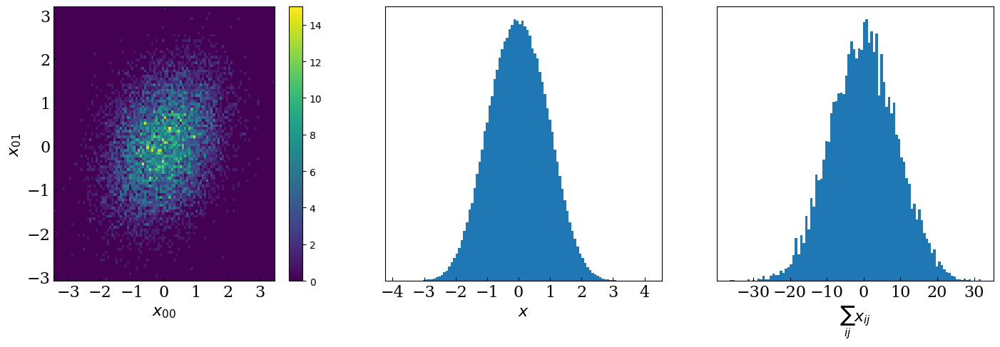

In [8]:
import torch

plt.rcParams['figure.figsize'] = (17, 5)
ising = Ising(6,2,0.1)
xx0 = ising.sample(10000)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx0.reshape(-1,36)[:,0], xx0.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
setfigform_simple("$x_{00}$", "$x_{01}$")
plt.subplot(132)
_ = plt.hist(xx0.reshape(-1), bins=100)
setfigform_simple("$x$", "", yticks=[])
plt.subplot(133)
_ = plt.hist(xx0.reshape(-1,36).sum(-1), bins=100)
setfigform_simple("$\sum_{ij}x_{ij}$", "", yticks=[])

#### MSD

In [ ]:
x_t_list = []
x_t = xx0
ising = Ising(6,2,0.1)
for t in range(1000):
    x_t = ising.sample(1000, thermalSteps = 1, interSteps=10, initial=x_t)
    x_t_list.append(x_t.detach().numpy())
x_t_list = np.array(x_t_list)
MSD_t_list = []
for j in range(1, x_t_list.shape[0]):
    MSD_t_list.append(((x_t_list[j]-x_t_list[0])**2).mean(axis=1))
MSD_t_list = np.array(MSD_t_list)
plt.plot(MSD_t_list[::1,0])

In [ ]:
plt.plot(MSD_t_list[::10,0])

### $k_BT=10J \rightarrow 5J$

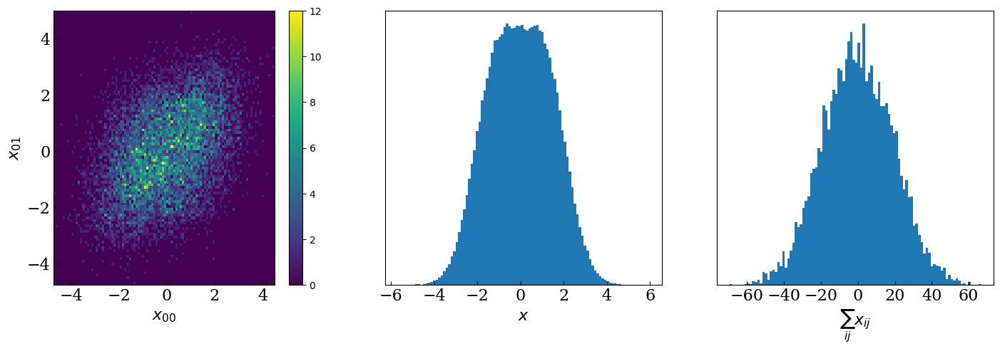

In [9]:
ising = Ising(6,2,0.2)
xx1 = ising.sample(10000, thermalSteps = 1000, interSteps=50, initial=xx0)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx1.reshape(-1,36)[:,0], xx1.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
setfigform_simple("$x_{00}$", "$x_{01}$")
plt.subplot(132)
_ = plt.hist(xx1.reshape(-1), bins=100)
setfigform_simple("$x$", "", yticks=[])
plt.subplot(133)
_ = plt.hist(xx1.reshape(-1,36).sum(-1), bins=100)
setfigform_simple("$\sum_{ij}x_{ij}$", "", yticks=[])

### $k_BT=5J \rightarrow 4J$

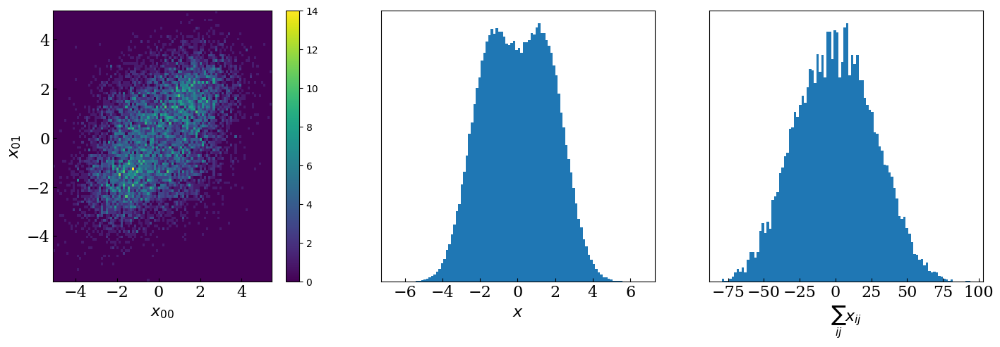

In [10]:
ising = Ising(6,2,0.25)
xx2 = ising.sample(10000, thermalSteps = 1000, interSteps=50, initial=xx1)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx2.reshape(-1,36)[:,0], xx2.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
setfigform_simple("$x_{00}$", "$x_{01}$")
plt.subplot(132)
_ = plt.hist(xx2.reshape(-1), bins=100)
setfigform_simple("$x$", "", yticks=[])
plt.subplot(133)
_ = plt.hist(xx2.reshape(-1,36).sum(-1), bins=100)
setfigform_simple("$\sum_{ij}x_{ij}$", "", yticks=[])

### $k_BT=4J \rightarrow 2.5J$

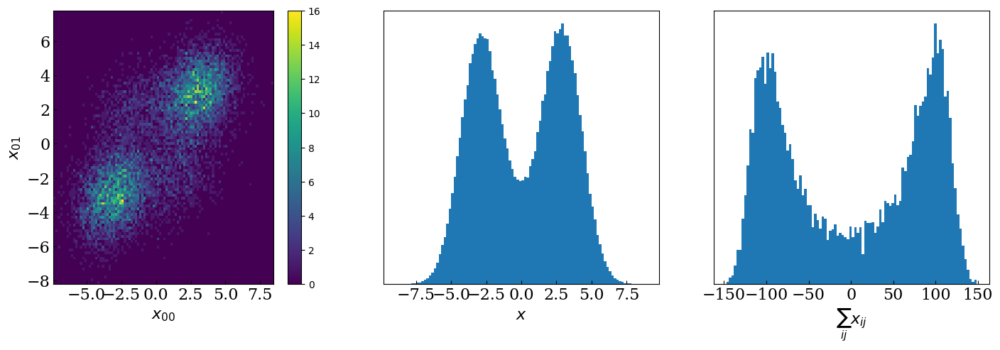

In [11]:
ising = Ising(6,2,0.4)
xx3 = ising.sample(10000, thermalSteps = 1000, interSteps=50, initial=xx2)
plt.figure()
plt.subplot(131)
_ = plt.hist2d(xx3.reshape(-1,36)[:,0], xx3.reshape(-1,36)[:,1], bins=100)
plt.colorbar()
setfigform_simple("$x_{00}$", "$x_{01}$")
plt.subplot(132)
_ = plt.hist(xx3.reshape(-1), bins=100)
setfigform_simple("$x$", "", yticks=[])
plt.subplot(133)
_ = plt.hist(xx3.reshape(-1,36).sum(-1), bins=100)
setfigform_simple("$\sum_{ij}x_{ij}$", "", yticks=[])

#### MSD

In [ ]:
x_t_list = []
x_t = xx3
ising = Ising(6,2,0.4)
for t in range(20000):
    x_t = ising.sample(1000, thermalSteps = 1, interSteps=1, initial=x_t)
    x_t_list.append(x_t.detach().numpy())
x_t_list = np.array(x_t_list)
MSD_t_list = []
for j in range(1, x_t_list.shape[0]):
    MSD_t_list.append(((x_t_list[j]-x_t_list[0])**2).mean(axis=0))
MSD_t_list = np.array(MSD_t_list)


In [ ]:
print(MSD_t_list.shape)

In [ ]:
from scipy.optimize import curve_fit
def slope(t,s,d0):
    return d0+s*t
popt_list = []
pcov_list = []
for i in range(36):
    trange = np.arange(5001,20000)
    popt, pcov = curve_fit(slope, trange, MSD_t_list[5000:,i])
    popt_list.append(popt)
    pcov_list.append(pcov)
    plt.figure()
    plt.plot(MSD_t_list[:,i])
    plt.plot(trange, slope(trange,*popt))
    plt.title("Site %d"%i)

In [ ]:
popt_list = np.array(popt_list)
D = popt_list.T[0]/0.1/2
print(popt_list.shape)
print(D)

In [ ]:
plt.figure()
plt.subplot(131)
_ = plt.hist2d(x_t_list[100].reshape(-1,36)[:,0], x_t_list[100].reshape(-1,36)[:,1], bins=100)
plt.colorbar()
plt.subplot(132)
_ = plt.hist(x_t_list[100].reshape(-1), bins=100)
plt.subplot(133)
_ = plt.hist(x_t_list[100].reshape(-1,36).sum(-1), bins=100)

In [ ]:
plt.figure()
plt.subplot(131)
_ = plt.hist2d(x_t_list[-1].reshape(-1,36)[:,0], x_t_list[-1].reshape(-1,36)[:,1], bins=100)
plt.colorbar()
plt.subplot(132)
_ = plt.hist(x_t_list[-1].reshape(-1), bins=100)
plt.subplot(133)
_ = plt.hist(x_t_list[-1].reshape(-1,36).sum(-1), bins=100)